In [23]:
%load_ext autoreload
%autoreload 2

# 3rd party imports
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np
import pandas as pd
np.set_printoptions(linewidth=1000)
from pprint import pprint
from scipy.optimize import minimize, LinearConstraint, NonlinearConstraint


# Local imports
import modules.laplacian as laplacian
import modules.jacobian as jacobian
import modules.correspondences as correspondences

import time

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
# Define global var
list_dev = []
num_neg_jac_init = []
num_neg_jac = []
time_taken = []
full_start = time.time()

In [38]:
# define global booleans
threshold = 0.01
max_iterations = 10000  # Max times it will move around the image / max number of times it will check for negative jacobians
max_per_index_iter = 50  # Max number of iterations per index, increasing the index, if at 5x5, stops at 105x105
max_minimize_iter = 1000

## Iterative SLSQP

In [4]:
# Define the objective function
def objectiveEuc(phi, phi_init):
    return np.linalg.norm(phi - phi_init)

def objectiveManh(phi, phi_init):
    return np.linalg.norm(phi - phi_init, ord=1)

In [5]:
# jacobian functions

def jacobian_det2D(phi_xy):
    deformation = np.zeros((3,1, *phi_xy.shape[-2:])    )
    deformation[2] = phi_xy[1]
    deformation[1] = phi_xy[0]
    return jacobian.sitk_jacobian_determinant(deformation)

def jacobian_constraint(phi_xy, submatrix_size, exclude_boundaries=True):
    """
    Sets nonlinear constraints and boundary constraints
    """
    deformation = np.zeros((3,1, submatrix_size, submatrix_size))
    pixels = submatrix_size*submatrix_size
    deformation[2] = phi_xy[:pixels].reshape((submatrix_size, submatrix_size))
    deformation[1] = phi_xy[pixels:].reshape((submatrix_size, submatrix_size))
    jacobian_mat = jacobian.sitk_jacobian_determinant(deformation)
    if exclude_boundaries:  # If true, only return pos Jacobian values inside the submatrix, excluding the boundaries required to be positive
        return jacobian_mat[0, 1:-1, 1:-1].flatten()
    else:
        return jacobian_mat.flatten()

In [6]:
# helper functions

def nearest_center(shape, n):
    """
    If submatrix cannot be built around the center, it will return the nearest center
    """
    near_cent = {}
    for z in range(shape[0]):
        for y in range(shape[1]):
            for x in range(shape[2]):
                l_idx = laplacian.get_laplacian_index(z, y, x, shape)
                z_cent = z
                y_cent = y
                x_cent = x
                if (x-n < 0):
                    x_cent = n
                elif (shape[2]-x < n+1):
                    x_cent = shape[2]-n-1

                if (y-n < 0):
                    y_cent = n
                elif (shape[1]-y < n+1):
                    y_cent = shape[1]-n-1
                center_indices = [z, y_cent, x_cent]
                near_cent[(z,y,x)] = center_indices
                # print("Nearest center values for index ", l_idx, center_indices)
    return near_cent


def get_nearest_center(neg_index, slice_shape, submatrix_size, near_cent_dict):
    """
    Uses the nearest center dictionary to find the nearest center for a given index
    Each pixel has its own nearest center, so it is stored in a dictionary
    """
    if submatrix_size in near_cent_dict:
        return near_cent_dict[submatrix_size][(0, *neg_index)]
    else:
        near_cent = nearest_center(slice_shape, submatrix_size // 2)
        near_cent_dict[submatrix_size] = near_cent
        return near_cent[(0, *neg_index)]
    

def argmin_excluding_edges(jacobian_matrix):
    """
    Find pixel with least highest jacobian determinant, excluding the edges
    """
    # Exclude edges: take submatrix excluding first/last row and column
    inner = jacobian_matrix[0, 1:-1, 1:-1]

    # Find index of the minimum in the inner matrix
    flat_index = np.argmin(inner)
    inner_idx = np.unravel_index(flat_index, inner.shape)

    # Map back to original matrix index
    return (inner_idx[0] + 1, inner_idx[1] + 1)

def get_phi_sub_flat(phi, cz, cy, cx, shape, d):
    """
    Flattens grid and gives it back
    """
    phix = phi[1, cy-d:cy+d+1, cx-d:cx+d+1]
    phiy = phi[0, cy-d:cy+d+1, cx-d:cx+d+1]
    # print(f'phi sub flat shapes are {phix.shape, phiy.shape, phi[1].shape, phi[0].shape} with limits being {cx-d}, {cx+d+1}, {cy-d}, {cy+d+1}')
    return np.concatenate([phix.flatten(), phiy.flatten()])


In [36]:
def iterative_with_jacobians2(deformation_i, methodName='SLSQP'):
    '''perform SLSQP on submatrices iteratively'''
    
    def plot_submatrix_callback(phi1):
        # phi1 is the current flat parameter vector for the submatrix
        phi_x_res = phi1[:len(phi1) // 2].reshape((submatrix_size, submatrix_size))
        phi_y_res = phi1[len(phi1) // 2:].reshape((submatrix_size, submatrix_size))
        deformation = np.zeros((3,1,submatrix_size,submatrix_size))
        deformation[2] = phi_x_res
        deformation[1] = phi_y_res
        J = np.squeeze(jacobian.sitk_jacobian_determinant(deformation))
        norm = mcolors.TwoSlopeNorm(vmin=min(J.min(), J.min(), -1), vcenter=0, vmax=max(J.max(), J.max(), 1))
        min_jdet = J.min()
        num_neg_jdet = (J <= 0).sum()
        plt.clf()
        plt.imshow(J, cmap='seismic', interpolation='nearest', norm=norm)
        
        # Add jacobian value to each tile
        for i in range(J.shape[0]):
            for j in range(J.shape[1]):
                plt.text(j, i, f"{J[i, j]:.3f}", ha="center", va="center", color="black", fontsize=8)
        
        plt.title(f'Submatrix Jacobian, size={submatrix_size}, min={min_jdet:.3f}\nnum neg jdet={num_neg_jdet}')
        plt.colorbar()
        plt.pause(0.01)

    
    slice_shape = (1, *deformation_i.shape[-2:])
    near_cent_dict = {}

    # this phi will be updated iteratively
    phi = np.zeros((2, *deformation_i.shape[-2:]))
    phi[1] = deformation_i[-1]
    phi[0] = deformation_i[-2]
    print(f'deformation_i shape: {deformation_i.shape}, phi_init shape: {phi.shape}')
    phi_init = phi.copy()

    # set threshold for Jacobian and store results
    jacobians = []
    indi_times = []
    tot_start = time.time()

    # compute jacobian matrix 
    jacobian_matrix = jacobian_det2D(phi)
    jacobians.append(jacobian_matrix)

    num_neg_jac_init.append((jacobian_matrix<=0).sum())

    iter = 0
    phi_temp = deformation_i.copy()
    while iter < max_iterations and (jacobian_matrix[0, 1:-1, 1:-1] <= threshold).any():
        iter += 1
        window_reached_max = False
        
        neg_index_tuple = argmin_excluding_edges(jacobian_matrix) # find a pixel with -ve jacobian to fix
        print(f'\n\n\nIter {iter}: Fixing index {neg_index_tuple}')

        submatrix_size = 3

        per_index_iter = 0

        # This while loop is for increasing the window, keep increasing the window size until it reaches the max size or all pixels in the submatrix have +ve jacobian
        while submatrix_size==3 or ((not window_reached_max) and per_index_iter < max_per_index_iter and (jacobian_matrix[0, cy-center_distance+1:cy+center_distance, cx-center_distance+1:cx+center_distance] < threshold - 1e-5).any()): # any pixel in the submatrix has -ve jacobian
            
            
            per_index_iter += 1

            # For 20x20, this gives 19
            if submatrix_size < min(slice_shape[1:])-1:
                submatrix_size += 2
                sub_shape = (1,submatrix_size, submatrix_size)
                cz, cy, cx = get_nearest_center(neg_index_tuple, slice_shape, submatrix_size, near_cent_dict)
                

                phi_init_sub_flat = get_phi_sub_flat(phi_init, cz, cy, cx, slice_shape, submatrix_size//2)
                phi_sub_flat = get_phi_sub_flat(phi, cz, cy, cx, slice_shape, submatrix_size//2)

                if (submatrix_size > 5):
                    print(f'Iter {iter}: For index {neg_index_tuple}, window size increased to {submatrix_size} at iter {per_index_iter}')

            # If it hits 19 just run once
            if submatrix_size >= min(slice_shape[1:])-1:
                window_reached_max = True
                # +ve jac constraint everywhere, threshold 
                nonlinear_constraints = NonlinearConstraint(lambda phi1: jacobian_constraint(phi1, submatrix_size, False), threshold, np.inf)
                constraints = [nonlinear_constraints]
            # 
            else:
                # +ve jac constraint only inside the ring
                nonlinear_constraints = NonlinearConstraint(lambda phi1: jacobian_constraint(phi1, submatrix_size, True), threshold, np.inf)

                # Create equality constraints to fix edge values in ring
                edge_mask = np.zeros((submatrix_size, submatrix_size), dtype=bool)
                edge_mask[[0, -1], :] = True
                edge_mask[:, [0, -1]] = True

                edge_indices = np.argwhere(edge_mask)
                fixed_indices = []
                y_offset_sub = submatrix_size*submatrix_size
                for y, x in edge_indices:
                    idx = y*submatrix_size + x
                    fixed_indices.extend([idx, idx + y_offset_sub])

                print(phi_sub_flat.shape, fixed_indices)
                fixed_values = phi_sub_flat[fixed_indices]

                A_eq = np.zeros((len(fixed_indices), phi_sub_flat.size))
                for row, idx in enumerate(fixed_indices):
                    A_eq[row, idx] = 1

                linear_constraint = LinearConstraint(A_eq, fixed_values, fixed_values)
                constraints=[nonlinear_constraints, linear_constraint]
            
            # run the actual optimisation, maxiter is how many times the optimisation will run
            result = minimize(lambda phi1: objectiveEuc(phi1, phi_init_sub_flat), phi_sub_flat, constraints=constraints, options={'maxiter': max_minimize_iter, 'disp': True}, method=methodName) #, callback=plot_submatrix_callback)

            phi_x_res = result.x[:len(result.x) // 2].reshape(sub_shape[-2:])
            phi_y_res = result.x[len(result.x) // 2:].reshape(sub_shape[-2:])
            
            
            center_distance = submatrix_size//2
            
            # Update phi_temp for plotting
            #phi_temp[2, 0, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1] = phi[1, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1]
            #phi_temp[1, 0, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1] = phi[0, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1]

            
            # Replace deformation
            phi[1, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1] = phi_x_res
            phi[0, cy-center_distance:cy+center_distance+1, cx-center_distance:cx+center_distance+1] = phi_y_res
            
            

            jacobian_matrix = jacobian_det2D(phi)
            
            # show the result
            
            #print(phi_temp.shape, deformation_i.shape)
            
            pprint(jacobian_matrix[0, cy-center_distance+1:cy+center_distance, cx-center_distance+1:cx+center_distance])
            
            plot_deformations(np.array([[0, 0, 0]]), np.array([[0, 0, 0]]), deformation_i, phi)

        jacobians.append(jacobian_matrix)
        print(f'Iter {iter} with {(jacobian_matrix <= 0).sum()} -ve jacs')
    
    deviation = np.sqrt(np.sum((phi - phi_init)**2))

    print(f'Deviation from initial = {deviation}')
    print(f'Changed number of -ve jacobians from {num_neg_jac_init[-1]} to {(jacobian_matrix<=0).sum()}')

    tot_end = time.time()
    print(f'Time taken for iter SLSQP optimisation: {tot_end-tot_start}s')

    # add to global var list
    list_dev.append(deviation)
    num_neg_jac.append((jacobian_matrix<=0).sum())
    time_taken.append(tot_end-tot_start)

    return phi, jacobians

## preprocessing and plotting methods

In [8]:
def plot_deformations(msample, fsample, deformation_i, phi_corrected, figsize=(10,10)):
    jacobian_initial = jacobian_det2D(deformation_i[1:])
    jacobian_final = jacobian_det2D(phi_corrected)

    # Create DataFrame
    data = {
        ("x-def", "min"): [np.min(deformation_i[2,0]), np.min(phi_corrected[1])],
        ("x-def", "max"): [np.max(deformation_i[2,0]), np.max(phi_corrected[1])],
        ("y-def", "min"): [np.min(deformation_i[1,0]), np.min(phi_corrected[0])],
        ("y-def", "max"): [np.max(deformation_i[1,0]), np.max(phi_corrected[0])],
        ("jacobian", "min"): [np.min(jacobian_initial), np.min(jacobian_final)],
        ("jacobian", "max"): [np.max(jacobian_initial), np.max(jacobian_final)]
    }

    row_names = ["initial", "final"]
    df = pd.DataFrame(data, index=row_names)

    # Print table
    print(df)


    # plot initial vs final Jacobian
    norm = mcolors.TwoSlopeNorm(vmin=min(jacobian_initial.min(), jacobian_final.min(), -1), vcenter=0, vmax=max(jacobian_initial.max(), jacobian_final.max(), 1))


    fig, axs = plt.subplots(nrows=2, ncols=2, figsize=figsize)

    # jacobians are of shape (1,5,5). Use index [0] for 2D plots
    im0 = axs[0,0].imshow(jacobian_initial[0], cmap='seismic', norm=norm, interpolation='nearest')
    im1 = axs[0,1].imshow(jacobian_final[0], cmap='seismic', norm=norm, interpolation='nearest')

    for i in range(len(msample)):  # Draw lines connecting the points
        axs[0,0].annotate(
            '', 
            xy=(fsample[i][2], fsample[i][1]), 
            xytext=(msample[i][2], msample[i][1]), 
            arrowprops=dict(facecolor='black', shrink=0.045, headwidth=8, headlength=10, width=3)
        )
    
    # Create a grid of points
    x, y = np.meshgrid(range(deformation_i.shape[3]), range(deformation_i.shape[2]), indexing='xy')
    print(f'meshgrid shape for plot: {x.shape}')
    
    axs[0,0].set_title('Initial J det')
    axs[0,0].scatter(msample[:, 2], msample[:, 1], c='g', label='Moving')
    axs[0,0].scatter(fsample[:, 2], fsample[:, 1], c='violet', label='Fixed')
    axs[0,0].legend()

    axs[0,1].set_title('final J det')

    axs[1,0].set_title('Initial deformation')
    axs[1,0].quiver(x, y, -deformation_i[2,0], deformation_i[1,0])

    axs[1,1].set_title('final deformation')
    axs[1,1].quiver(x, y, -phi_corrected[1], phi_corrected[0])

    for i in range(2):
        axs[1,i].invert_yaxis()
    
    #fig.subplots_adjust(right=0.8)
    cax = fig.add_axes([0.95, 0.5, 0.02, 0.4])
    fig.colorbar(im1, cax=cax)
    plt.show()

In [9]:
def plot_jacobians_iteratively(jacobians, msample, fsample, methodName='SLSQP'):
    # assume jacobians is a list of numpy arrays of shape (1, 5, 5)
    # assume msample and fsample are (N, 3) arrays

    num_jacobians = len(jacobians)
    ncols = min(2, num_jacobians)  # wrap at 2 columns
    nrows = (num_jacobians + ncols - 1) // ncols  # ceiling division

    # Compute color normalization
    all_vals = [j[0] for j in jacobians]  # extract 2D arrays from (1,5,5)
    vmin = min(j.min() for j in all_vals)
    vmax = max(j.max() for j in all_vals)
    norm = mcolors.TwoSlopeNorm(vmin=min(vmin, -1), vcenter=0, vmax=max(vmax, 1))

    # Create subplots
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(4 * ncols, 4 * nrows))
    axs = axs.flatten()

    for i, jac in enumerate(jacobians):
        im = axs[i].imshow(jac[0], cmap='seismic', norm=norm, interpolation='nearest')
        num_negs = np.sum(jac <= 0)
        axs[i].set_title(f'Jacobian #{i}, {num_negs} -ves' if i > 0 else f'Initial J det: {num_negs} -ves')

        if i == 0:
            axs[i].scatter(msample[:, 2], msample[:, 1], c='g', label='Moving', s=10)
            axs[i].scatter(fsample[:, 2], fsample[:, 1], c='violet', label='Fixed', s=10)
            axs[i].legend()

    for i in range(len(msample)):  # Draw lines connecting the points
        axs[0].annotate(
            '', 
            xy=(fsample[i][2], fsample[i][1]), 
            xytext=(msample[i][2], msample[i][1]), 
            arrowprops=dict(facecolor='black', shrink=0.1, headwidth=3, headlength=5, width=1)
        )

    # Hide any extra axes
    for j in range(len(jacobians), len(axs)):
        axs[j].axis('off')

    # Add colorbar
    fig.colorbar(im, ax=axs, orientation='vertical', fraction=0.046, pad=0.04)

    plt.tight_layout(rect=[0, 0, 0.9, 1])
    plt.show()

def run_lapl_and_correction(fixed_sample, msample, fsample, methodName='SLSQP'):
    '''plot each Jacobian matrix'''
    deformation_i, A, Zd, Yd, Xd = laplacian.sliceToSlice3DLaplacian(fixed_sample, msample, fsample)
    print(f'deformation shape: {deformation_i.shape}')
    phi_corrected, jacobians = iterative_with_jacobians2(deformation_i, methodName)
    # plot_jacobians_iteratively(jacobians, msample, fsample, methodName='SLSQP')
    plot_deformations(msample, fsample, deformation_i, phi_corrected, figsize=(10,10))

## Testcases

## Standard run

deformation shape: (3, 1, 10, 10)
deformation_i shape: (3, 1, 10, 10), phi_init shape: (2, 10, 10)



Iter 1: Fixing index (2, 4)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


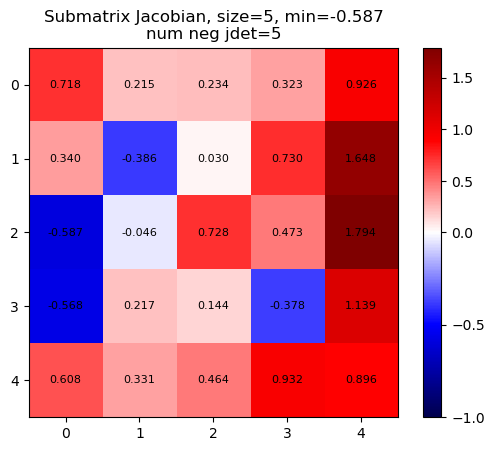

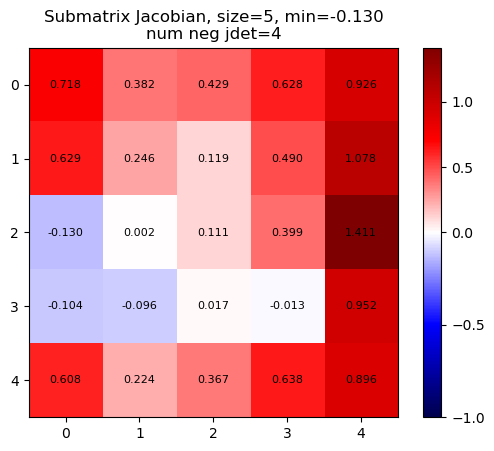

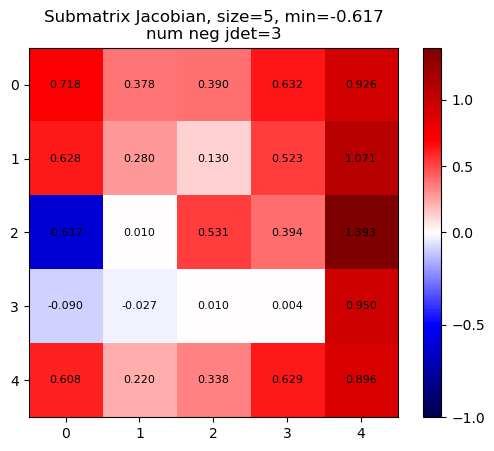

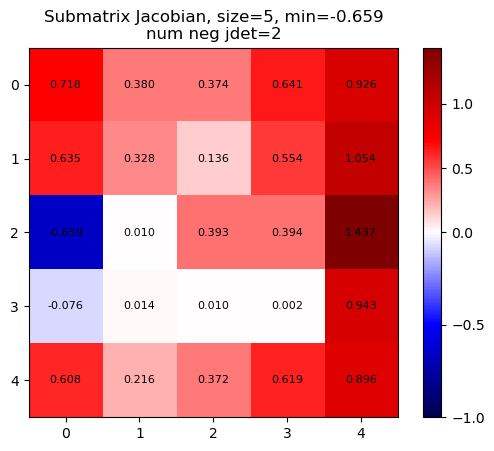

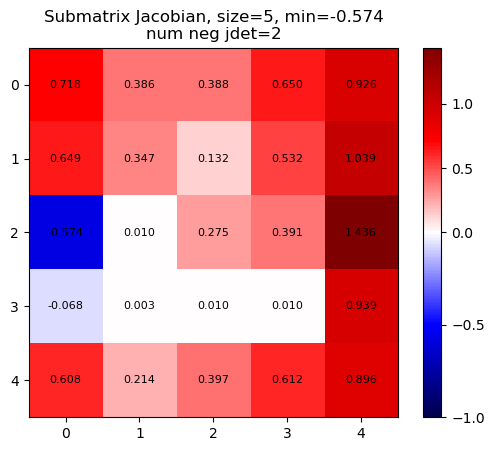

...

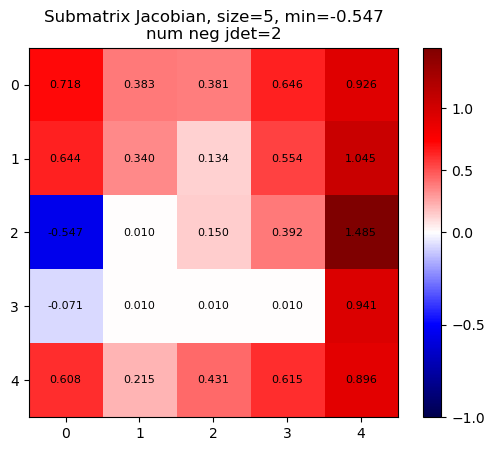

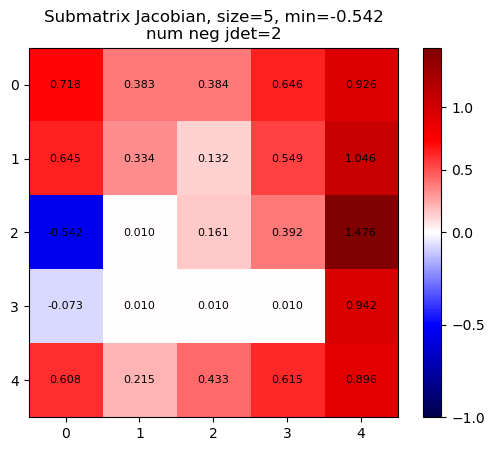

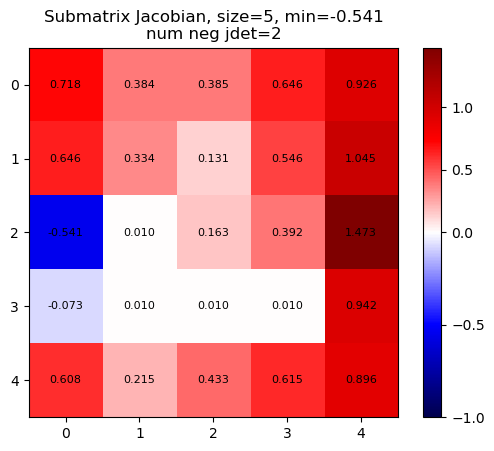

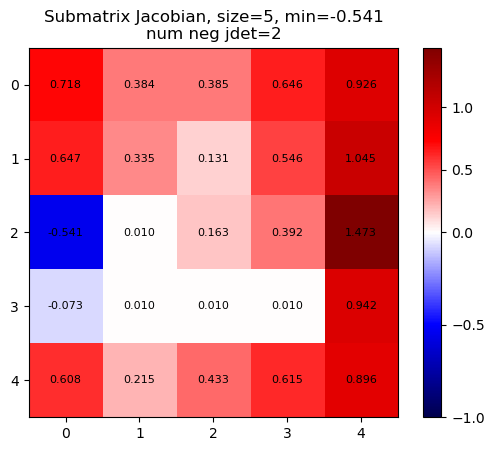

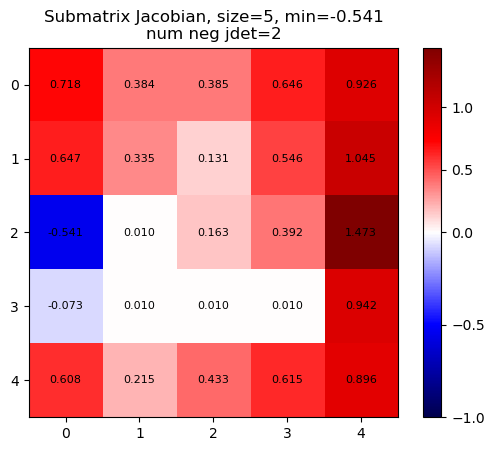

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.6777445902461874
            Iterations: 23
            Function evaluations: 1183
            Gradient evaluations: 23
            x-def               y-def           jacobian          
              min       max       min      max       min       max
initial -2.999704  2.999704  0.000000  0.00000 -0.693885  1.809693
final   -2.774946  2.999704 -0.731668  1.11732 -0.556470  1.722864
meshgrid shape for plot: (10, 10)


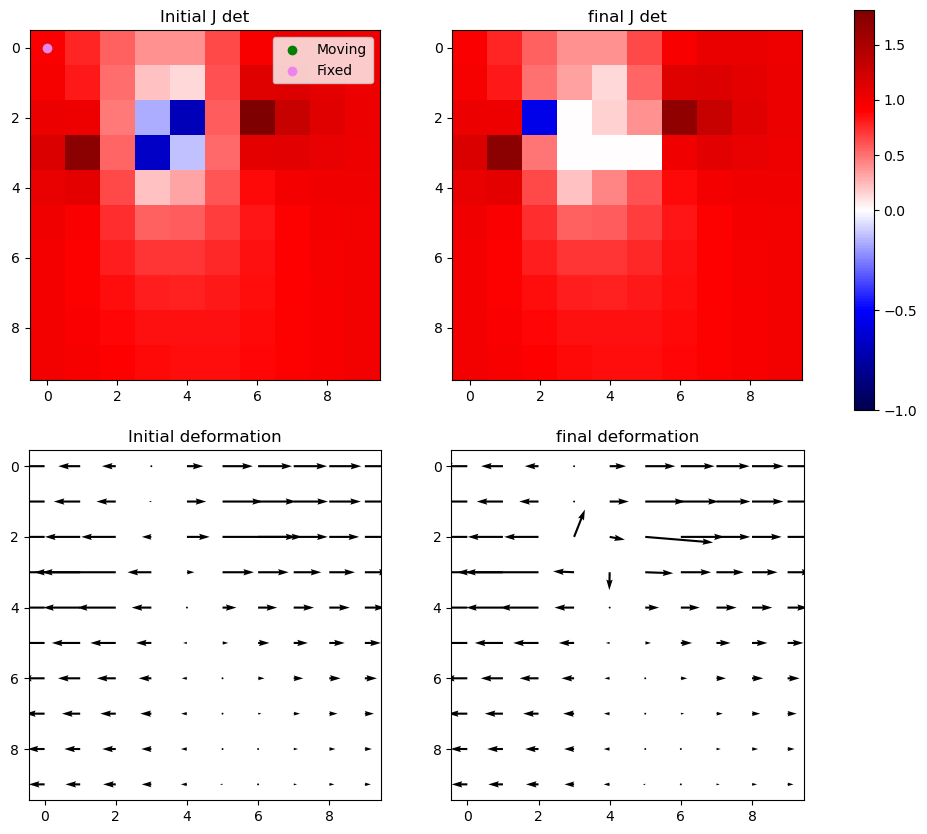

Iter 1: For index (2, 4), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


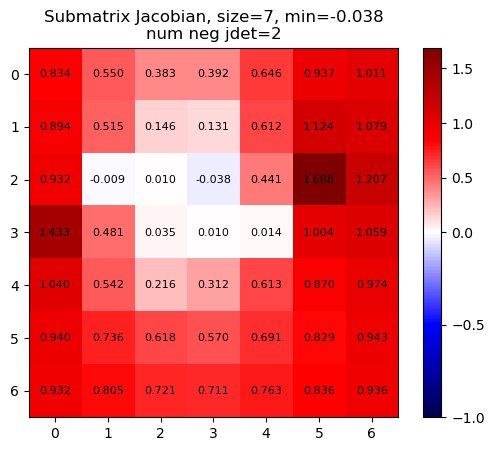

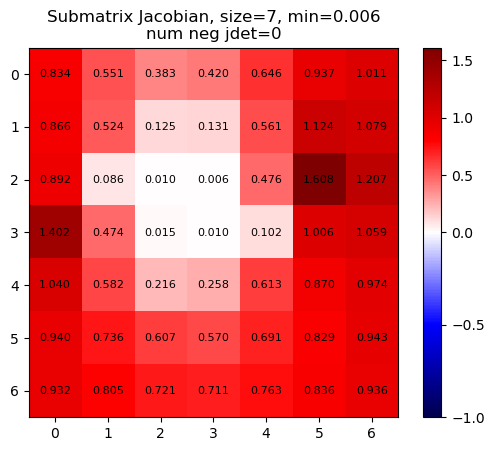

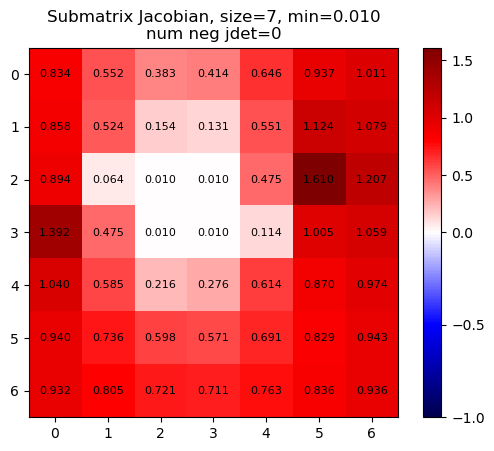

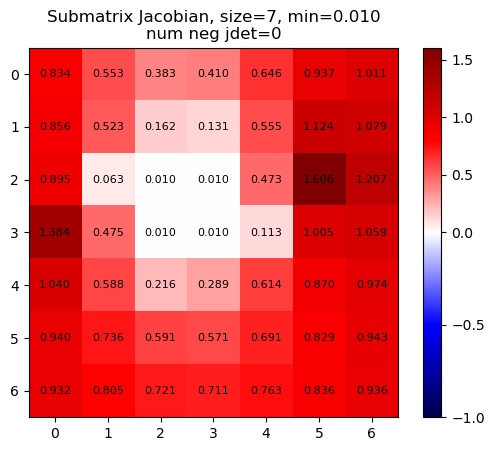

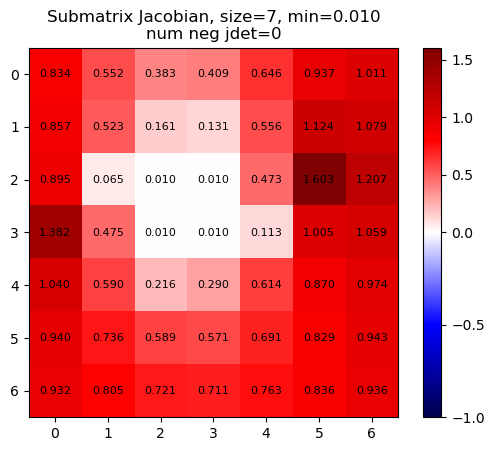

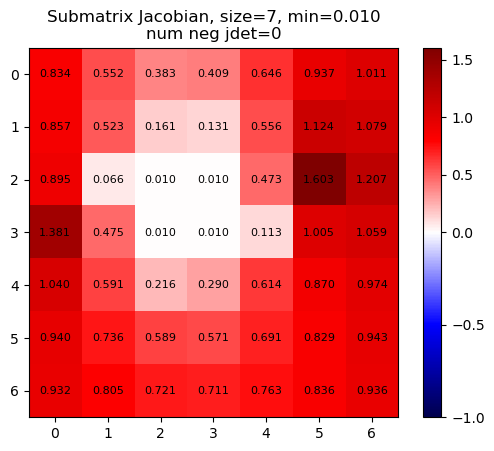

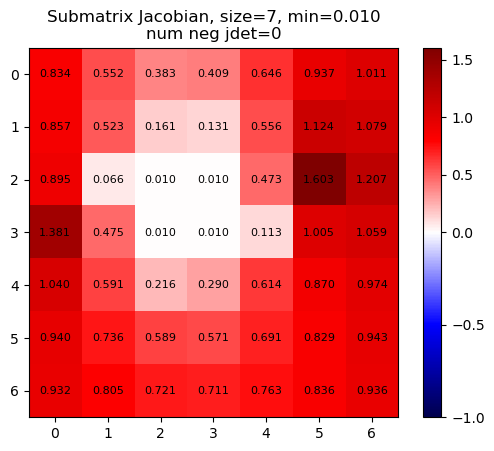

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.1844034755435475
            Iterations: 7
            Function evaluations: 693
            Gradient evaluations: 7
            x-def               y-def           jacobian          
              min       max       min       max      min       max
initial -2.774946  2.999704 -0.731668  1.117320 -0.55647  1.722864
final   -2.630866  2.643654 -0.377210  0.387919  0.01000  1.602945
meshgrid shape for plot: (10, 10)


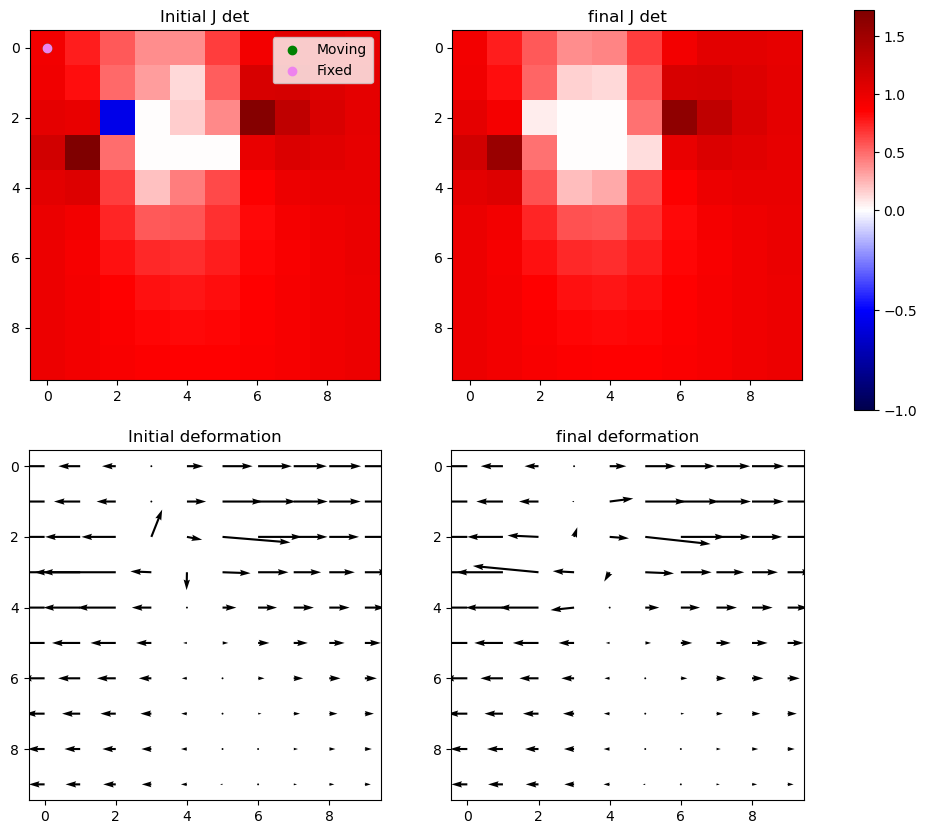

Iter 1 with 0 -ve jacs
Deviation from initial = 1.1844034755435475
Changed number of -ve jacobians from 4 to 0
Time taken for iter SLSQP optimisation: 10.803565263748169s
            x-def              y-def            jacobian          
              min       max      min       max       min       max
initial -2.999704  2.999704  0.00000  0.000000 -0.693885  1.809693
final   -2.630866  2.643654 -0.37721  0.387919  0.010000  1.602945
meshgrid shape for plot: (10, 10)


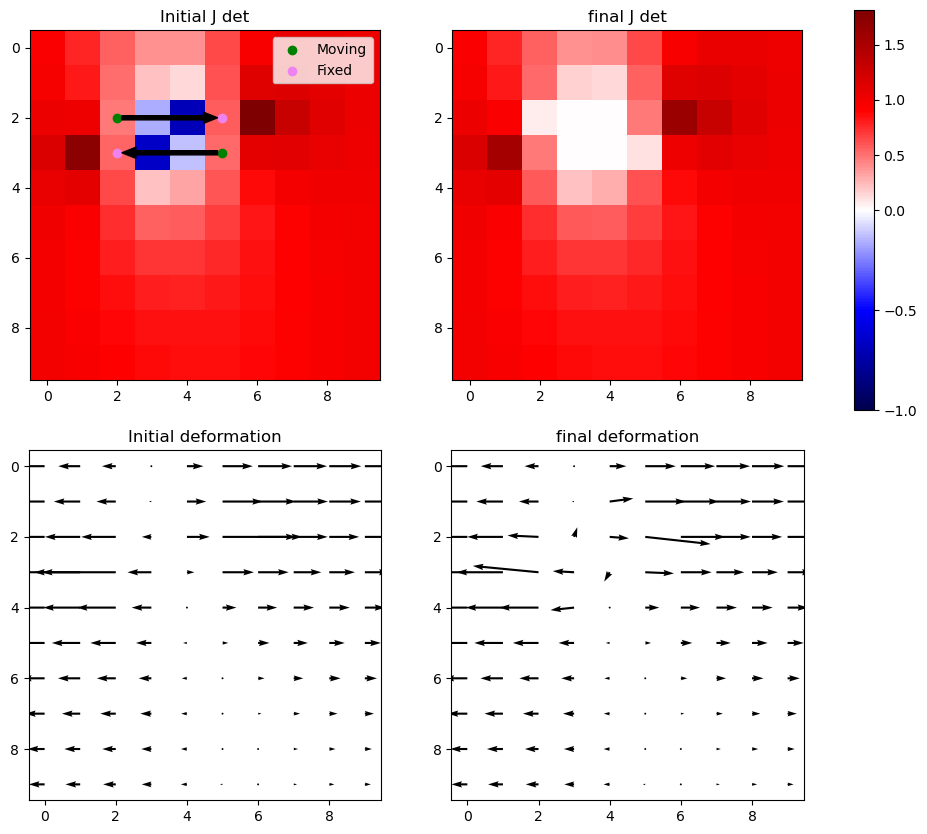

In [114]:
msample = np.array([
    [0, 2, 2],
    [0, 3, 5],
])
fsample = np.array([
    [0, 2, 5],
    [0, 3, 2],
])

fixed_sample = np.zeros((1, 10, 10)) # depth, rows, cols

run_lapl_and_correction(fixed_sample, msample, fsample)

# takes 15 mins and does not conclude on full 20x40 constraints
# 1.5mins on 10x10 constraints
# reduce constraints
# (10,5) - 50 vs 5 - 3.9s vs 0.15s
# (5,5) - 25 vs 5 - 0.35s vs 0.0645s
# (10, 10) - 100 vs 5 - 50s vs 0.46s
# (20, 20) - 400 vs 5 - waited for full one to run for 20min vs 1.5min

# 20x40 with 5 random constraints - 10.5 mins
# 20x40 run over the full thing - 174 min does not finish

## Long runtime

deformation shape: (3, 1, 10, 10)
deformation_i shape: (3, 1, 10, 10), phi_init shape: (2, 10, 10)



Iter 1: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


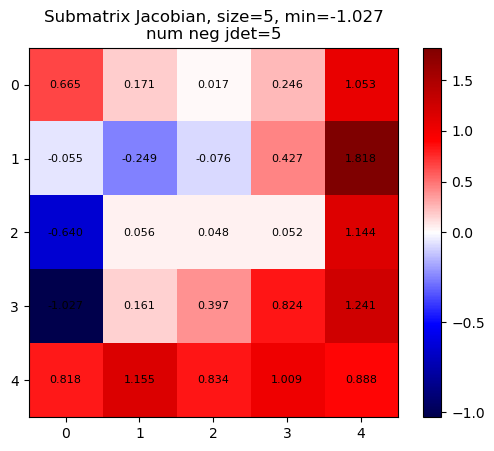

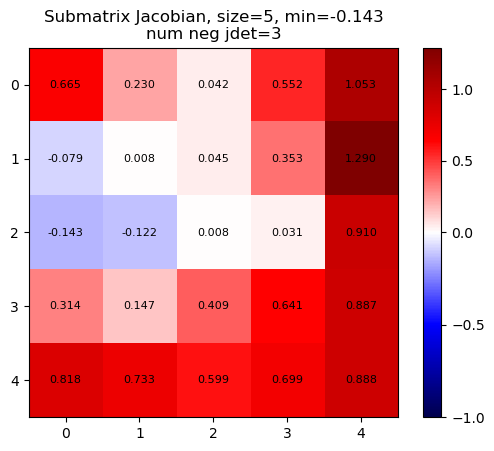

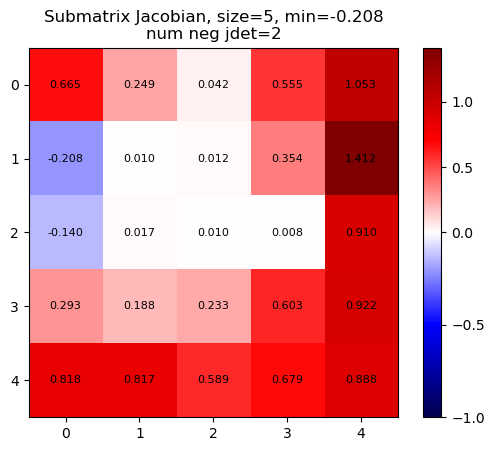

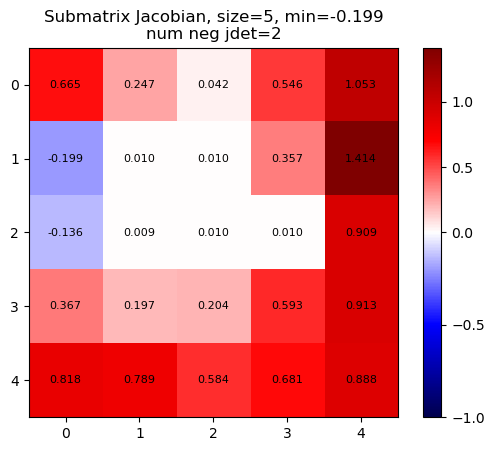

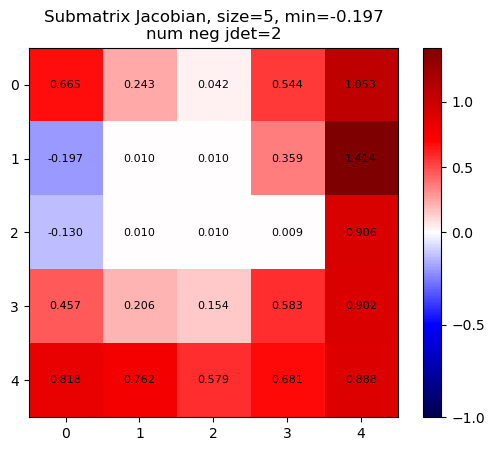

...

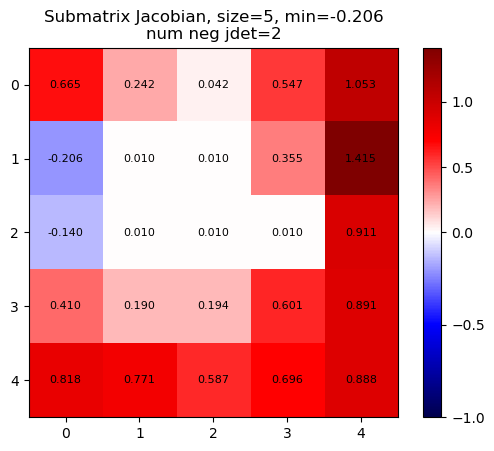

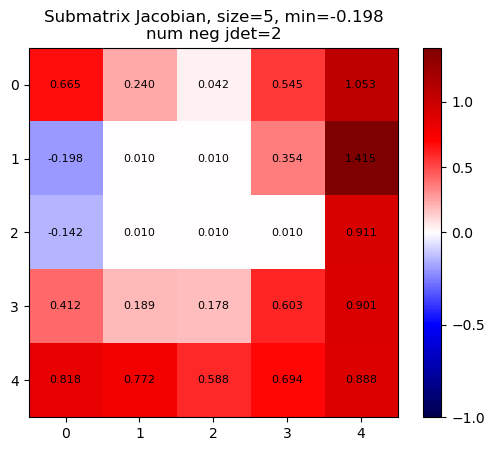

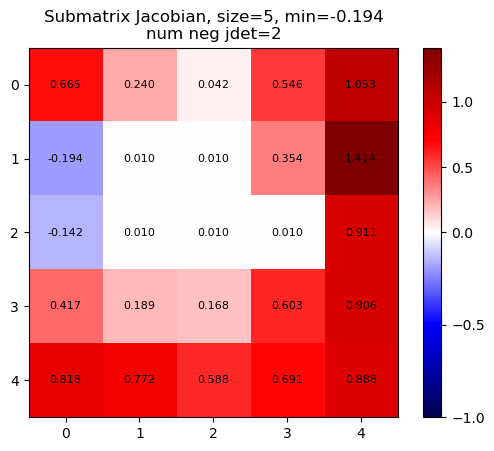

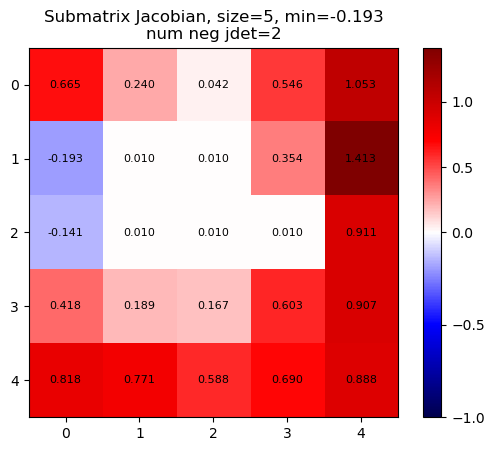

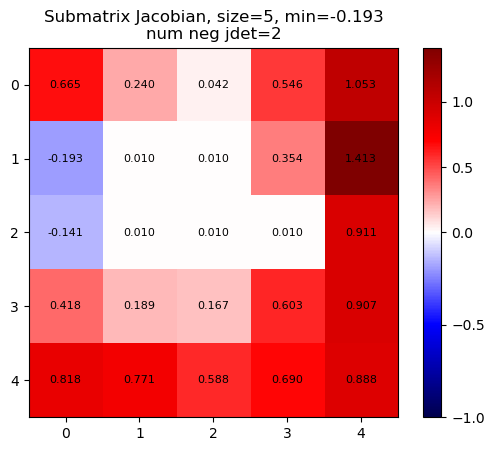

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.4308420092166065
            Iterations: 21
            Function evaluations: 1081
            Gradient evaluations: 21
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -2.999822  2.999822  0.000000  0.000000 -0.730373  1.709059
final   -2.821565  2.999822 -0.654628  0.702138 -0.192925  1.606286
meshgrid shape for plot: (10, 10)


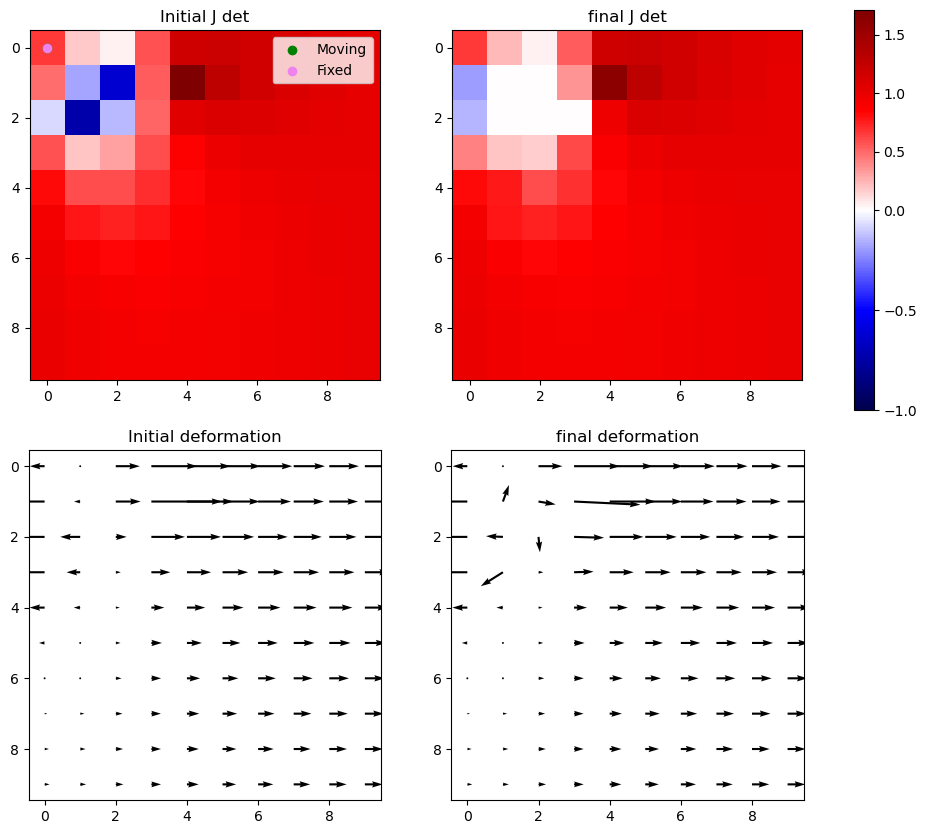

Iter 1: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


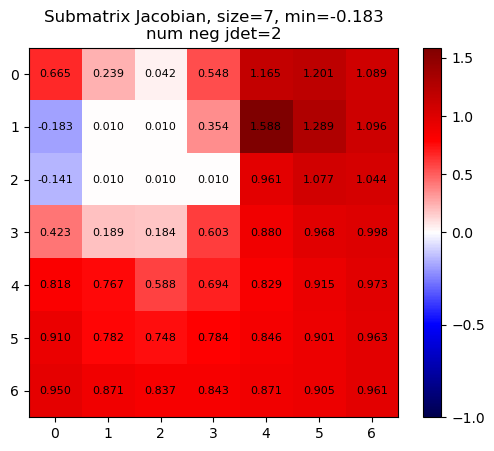

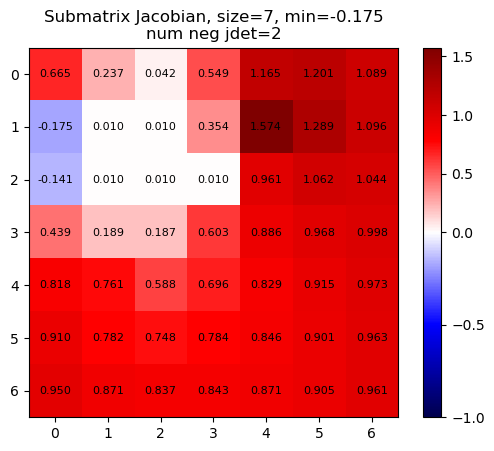

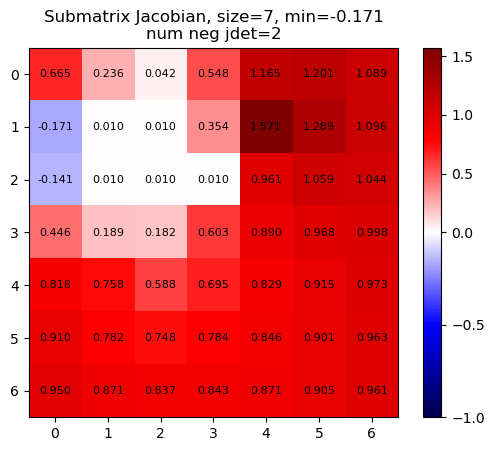

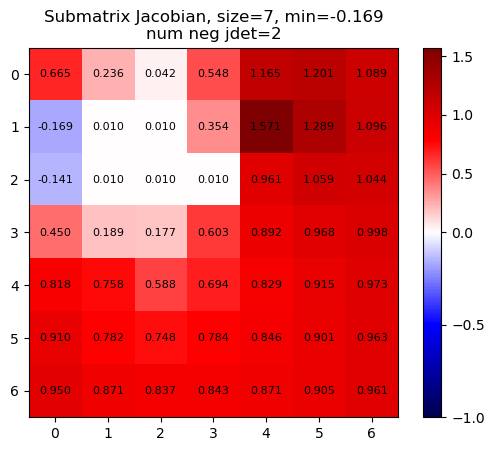

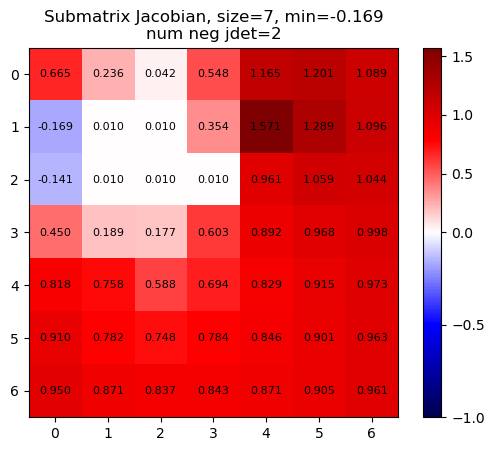

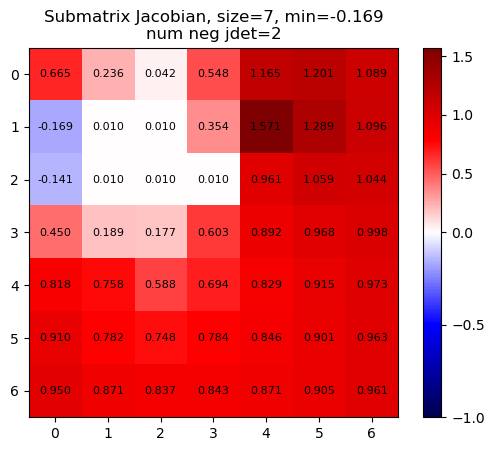

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.4275850554024634
            Iterations: 6
            Function evaluations: 594
            Gradient evaluations: 6
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -2.821565  2.999822 -0.654628  0.702138 -0.192925  1.606286
final   -2.840009  2.999822 -0.680641  0.660818 -0.169126  1.571461
meshgrid shape for plot: (10, 10)


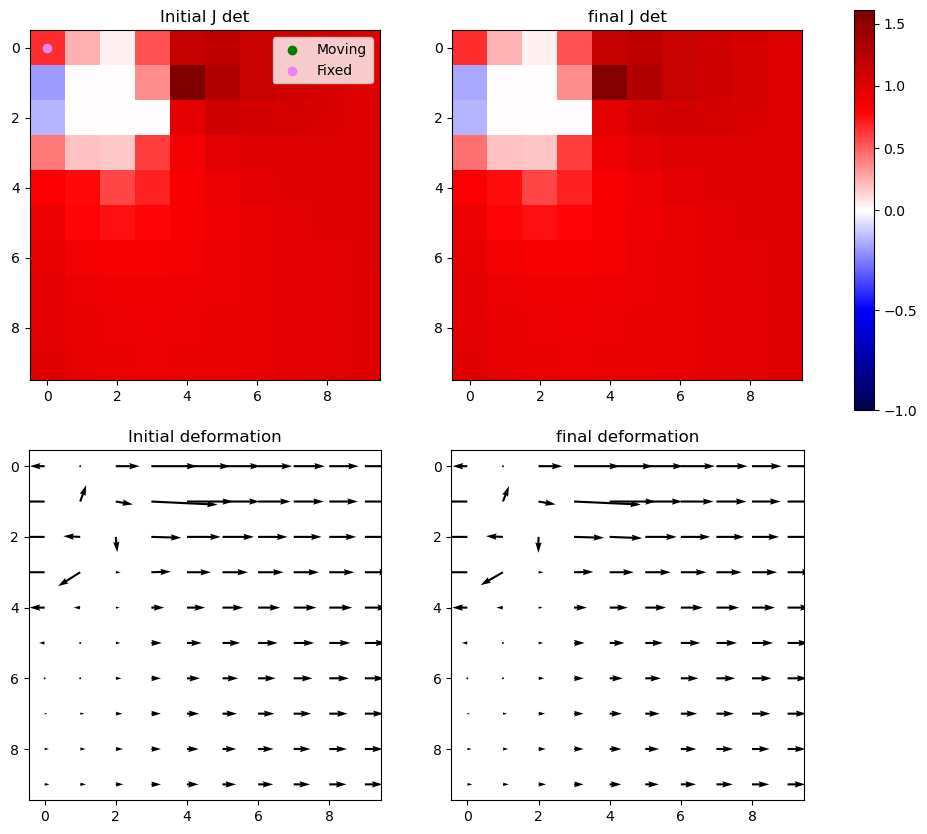

Iter 1: For index (2, 1), window size increased to 9 at iter 3


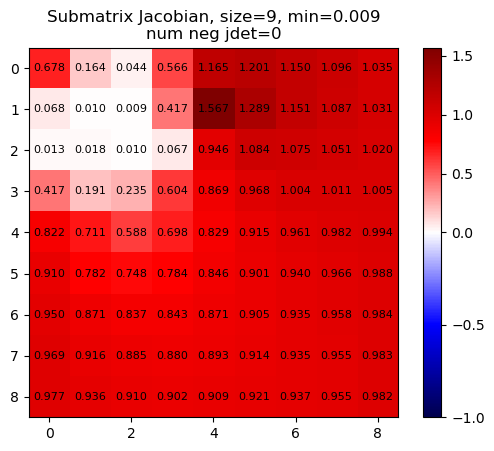

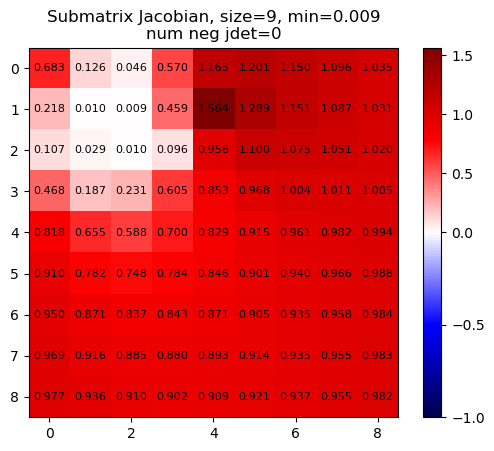

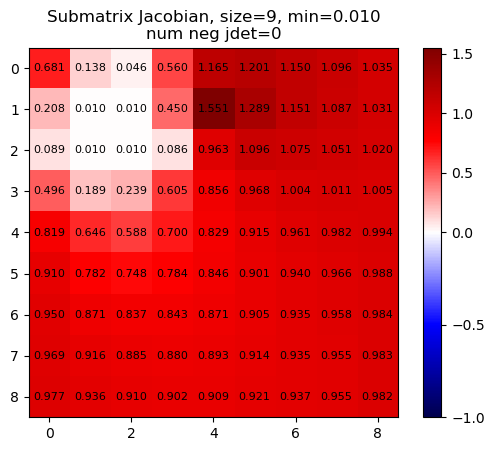

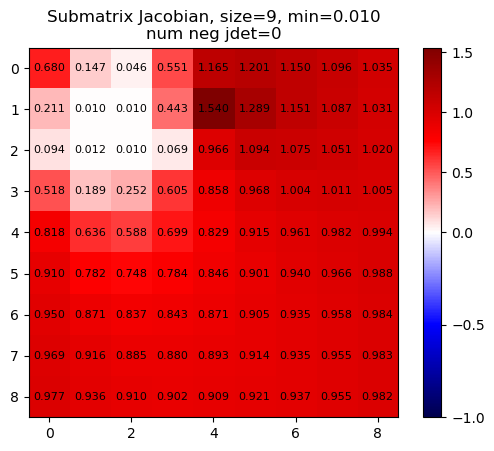

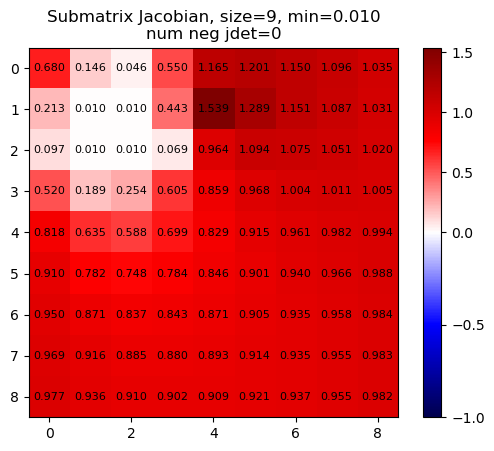

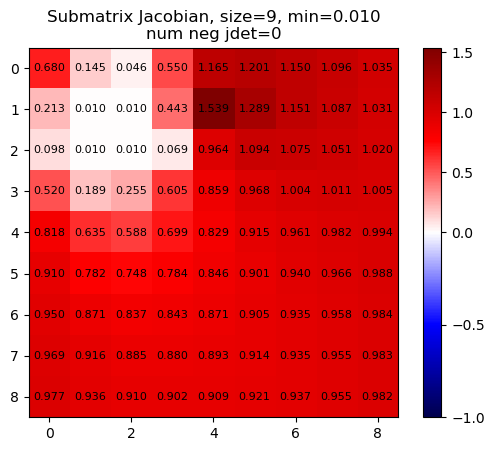

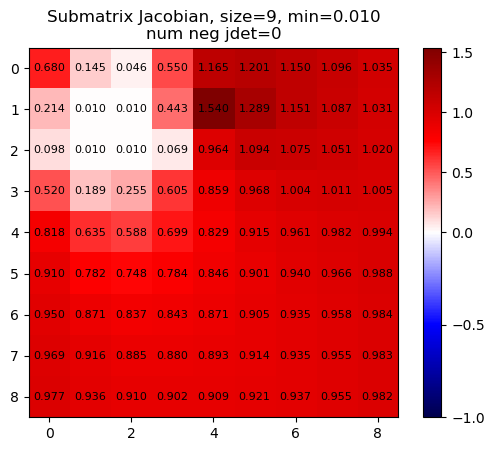

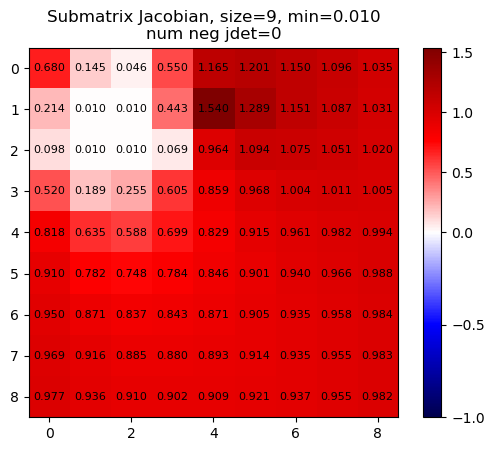

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 8
            Function evaluations: 1304
            Gradient evaluations: 8
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -2.840009  2.999822 -0.680641  0.660818 -0.169126  1.571461
final   -2.709375  2.555239 -0.395733  0.372456  0.010000  1.539590
meshgrid shape for plot: (10, 10)


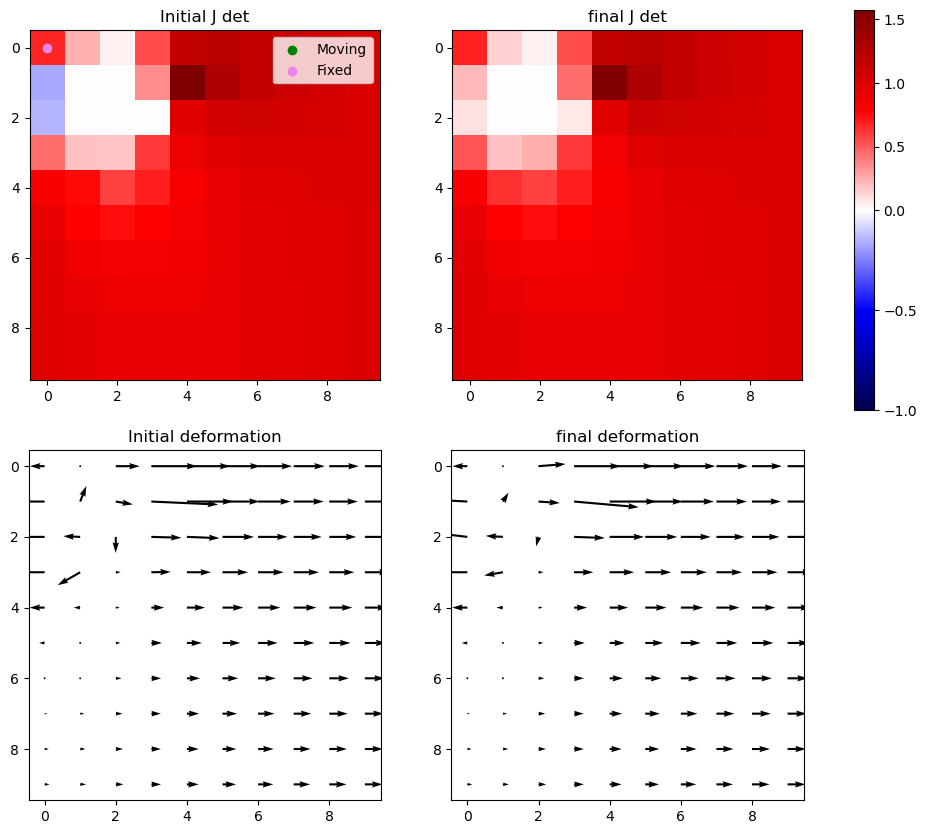

Iter 1 with 0 -ve jacs



Iter 2: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


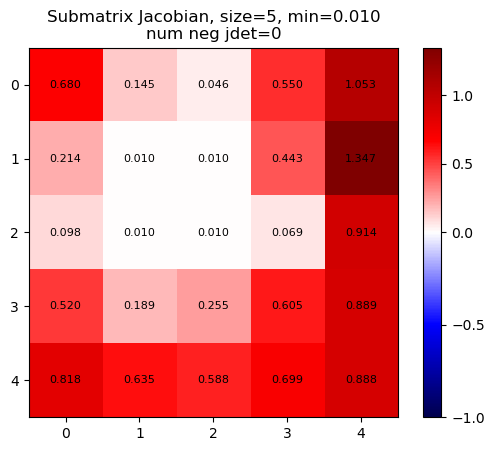

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


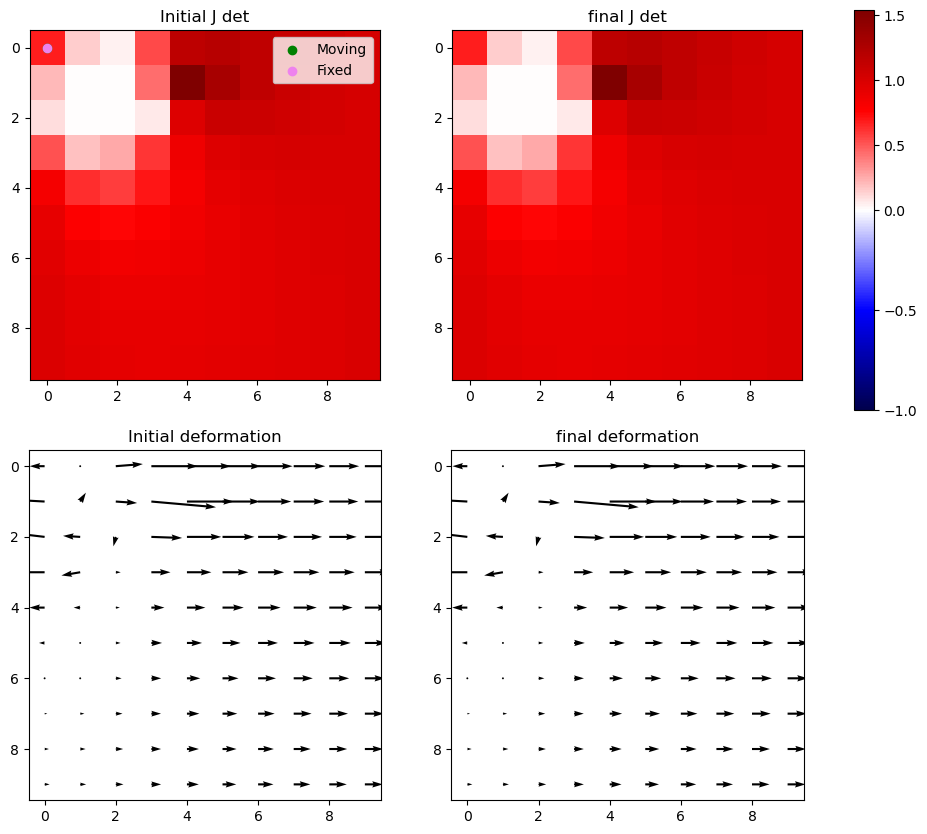

Iter 2: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


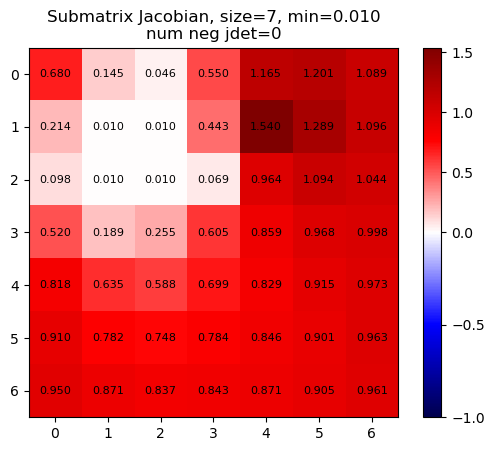

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


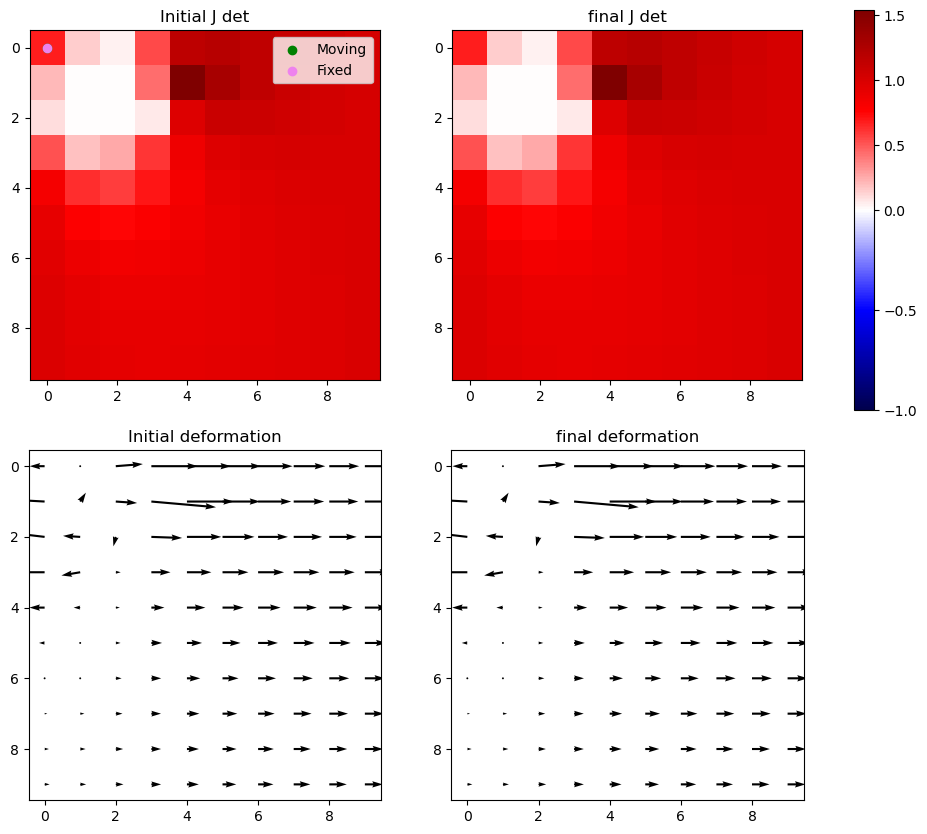

Iter 2: For index (2, 1), window size increased to 9 at iter 3


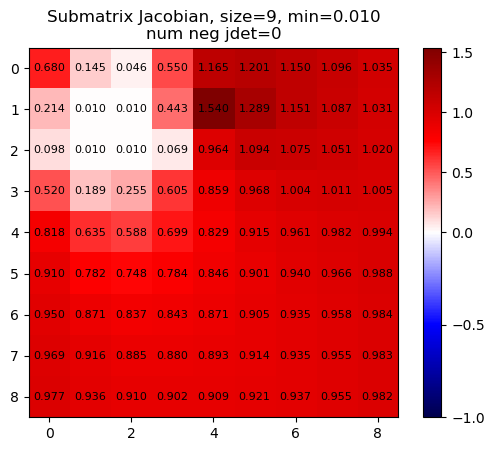

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


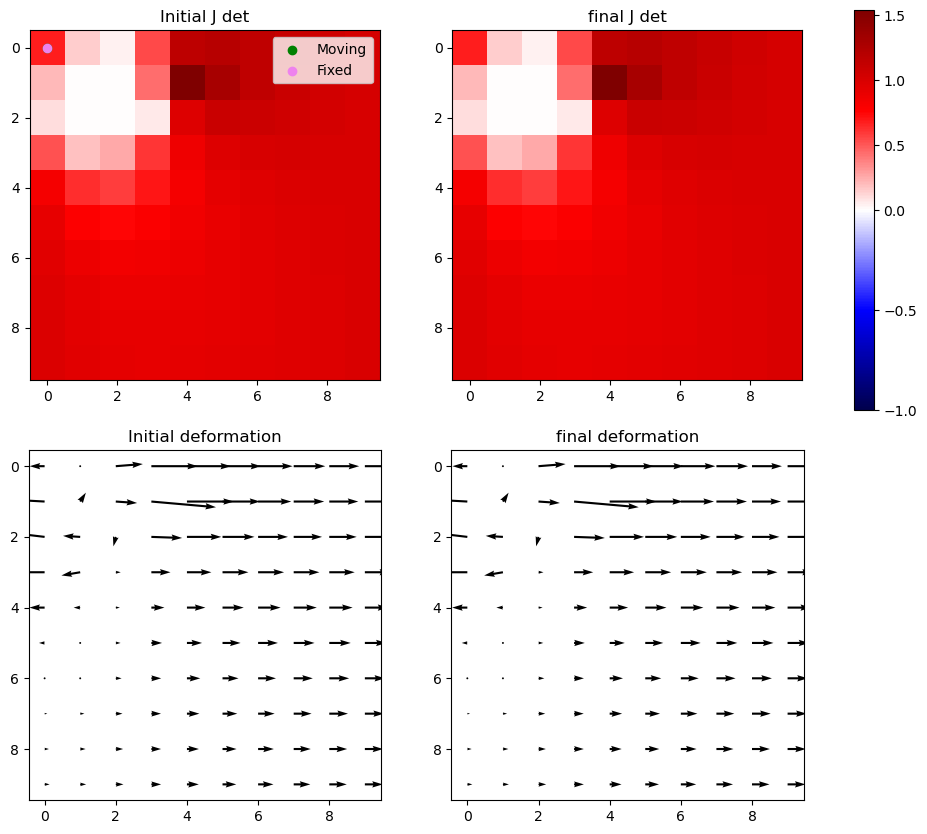

Iter 2 with 0 -ve jacs



Iter 3: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


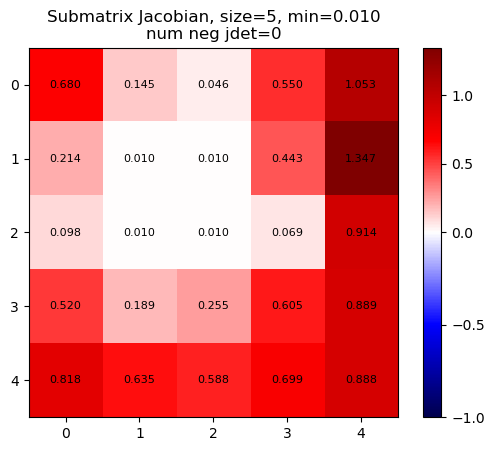

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


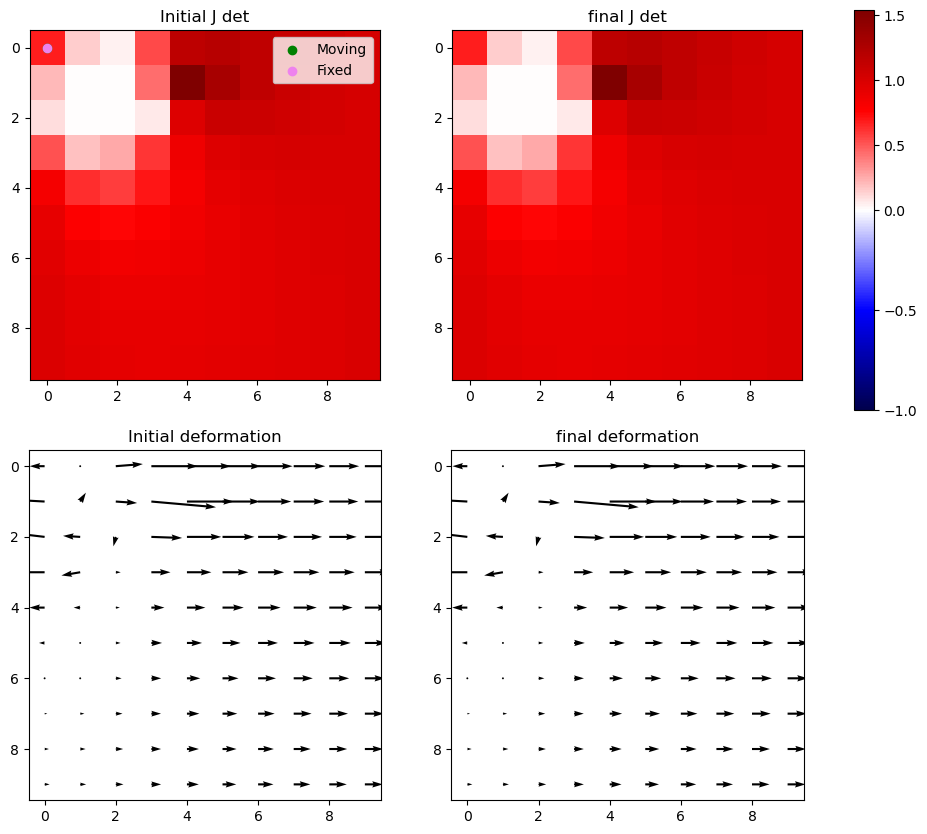

Iter 3: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


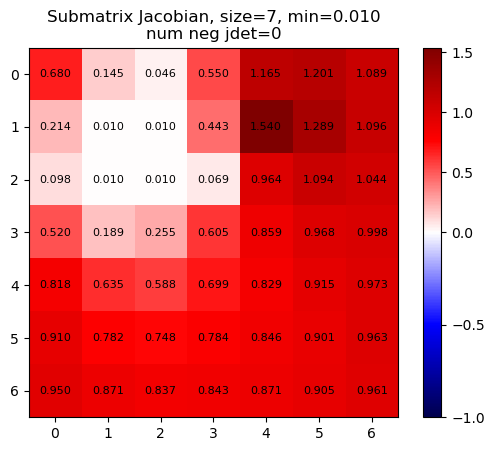

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


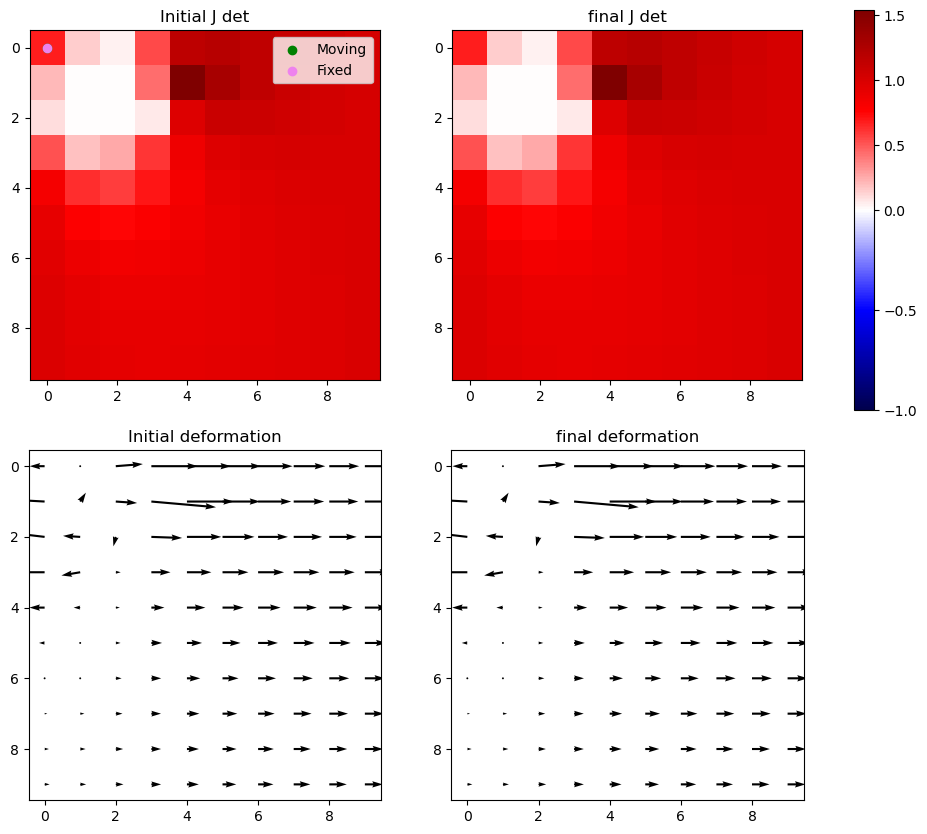

Iter 3: For index (2, 1), window size increased to 9 at iter 3


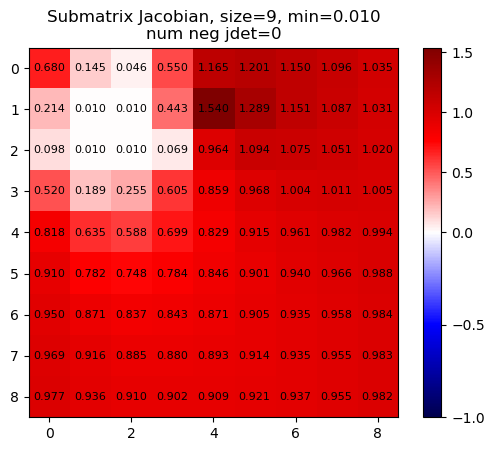

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


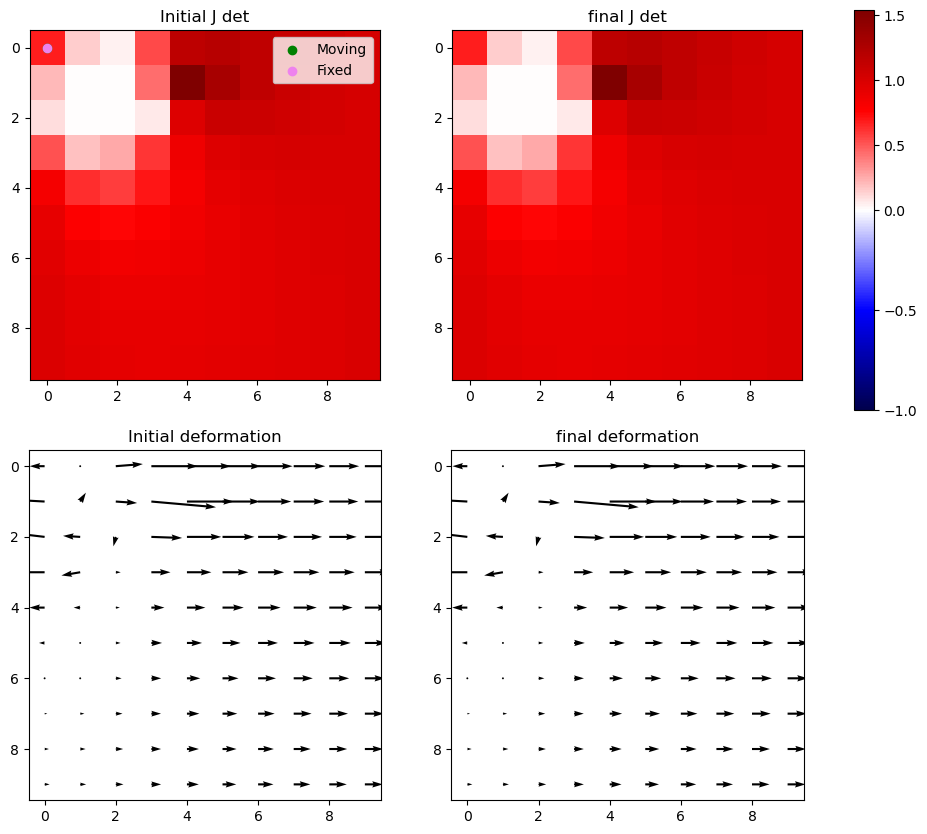

Iter 3 with 0 -ve jacs



Iter 4: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


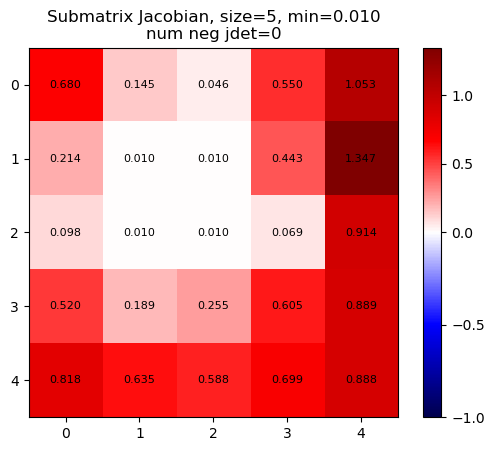

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


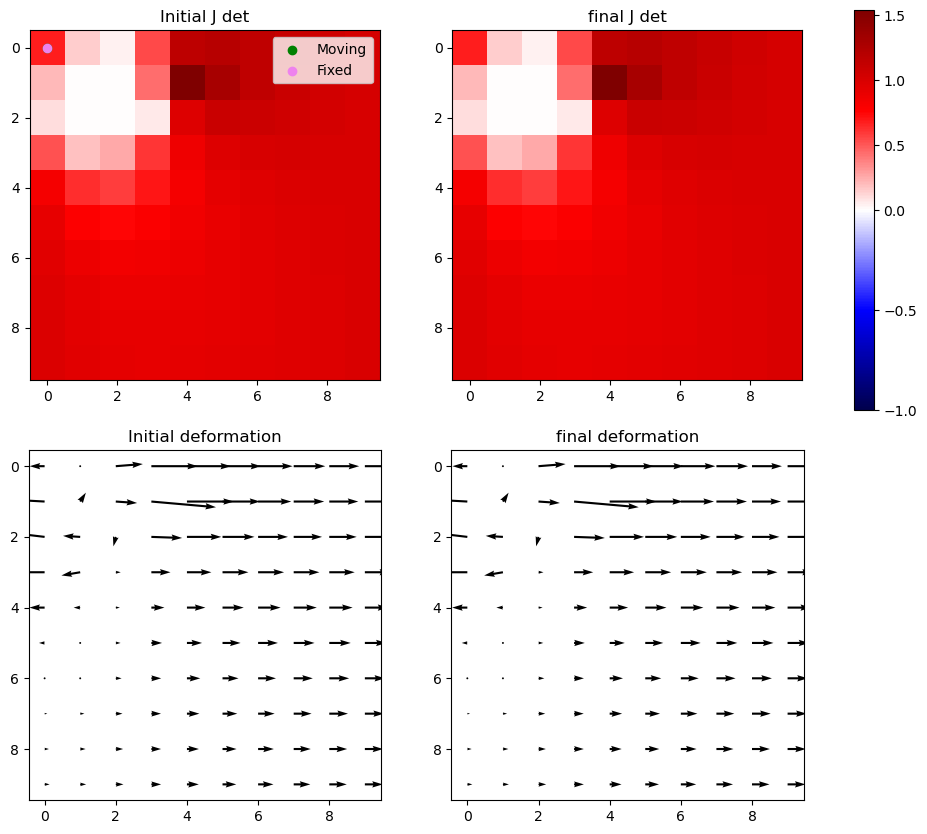

Iter 4: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


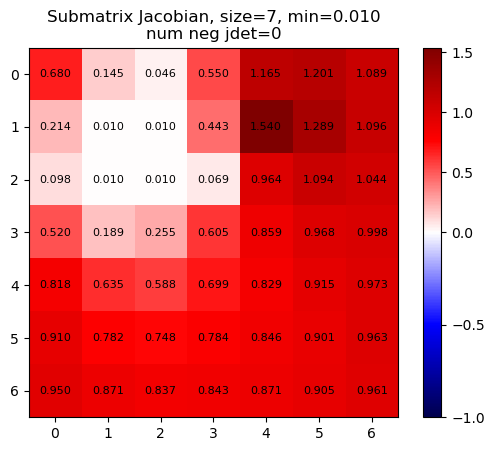

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


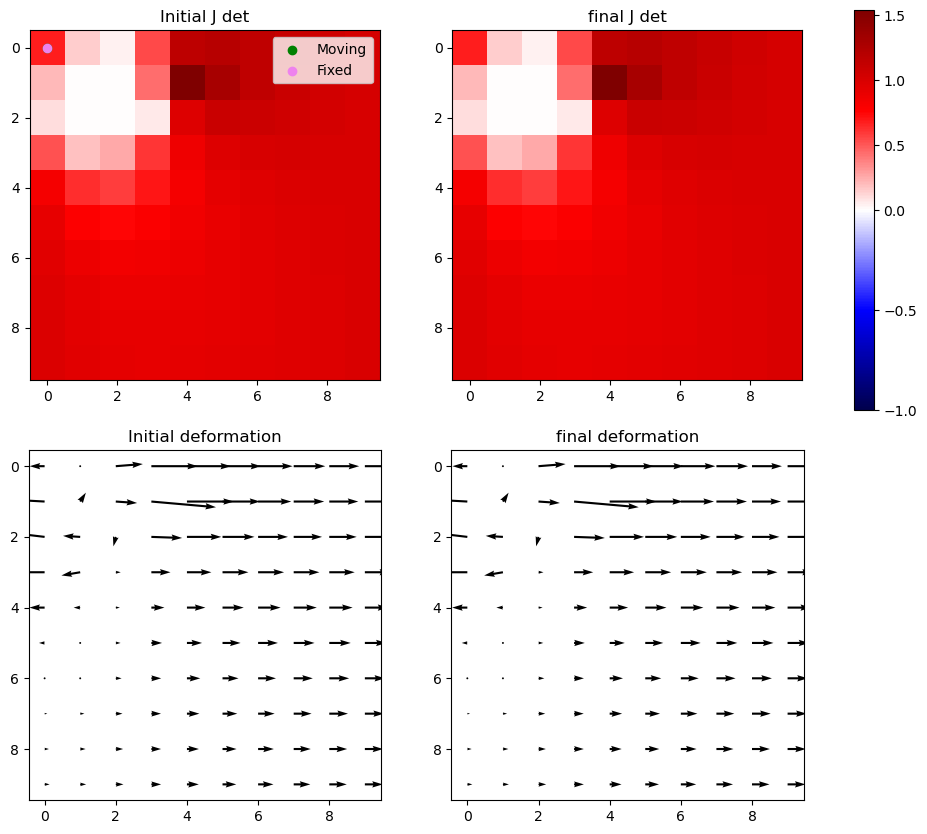

Iter 4: For index (2, 1), window size increased to 9 at iter 3


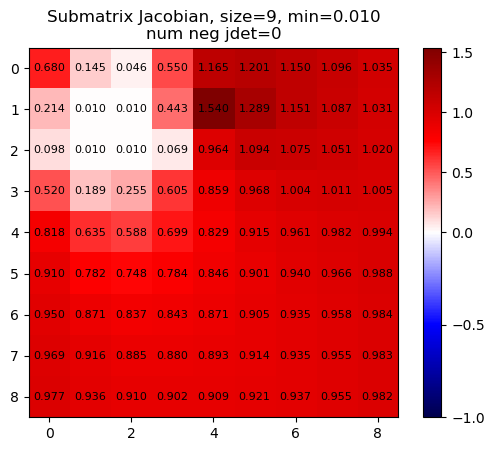

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


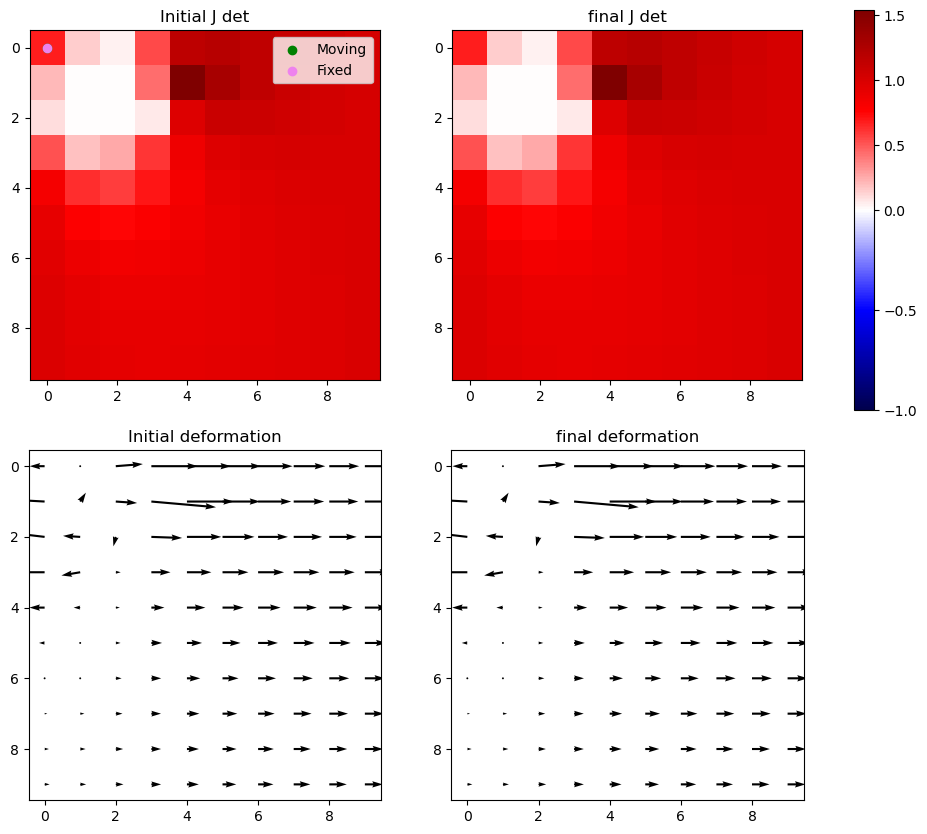

Iter 4 with 0 -ve jacs



Iter 5: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


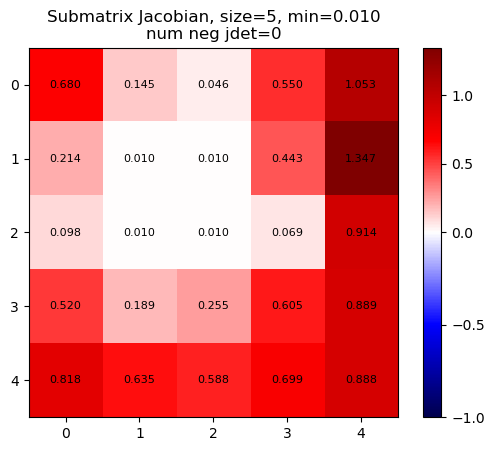

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


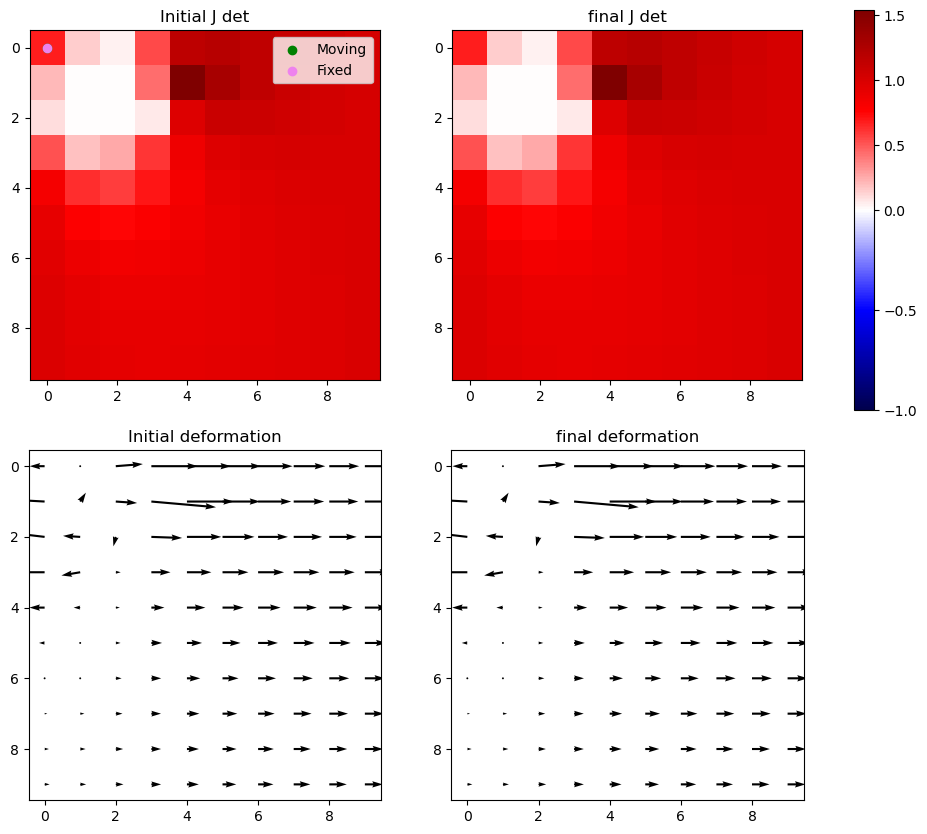

Iter 5: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


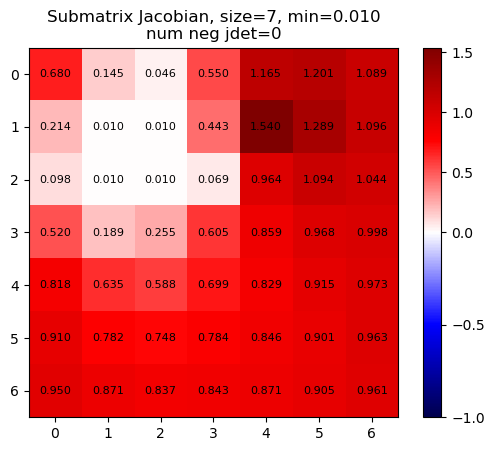

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


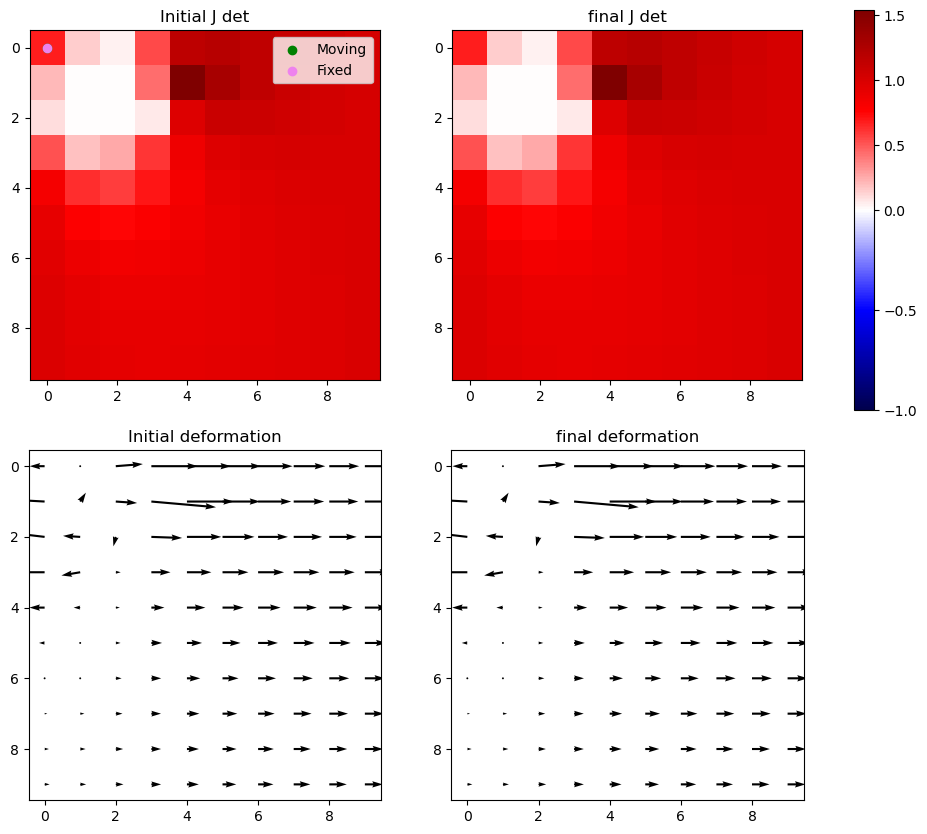

Iter 5: For index (2, 1), window size increased to 9 at iter 3


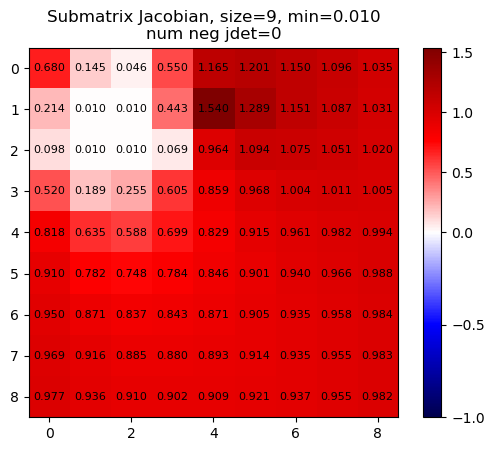

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


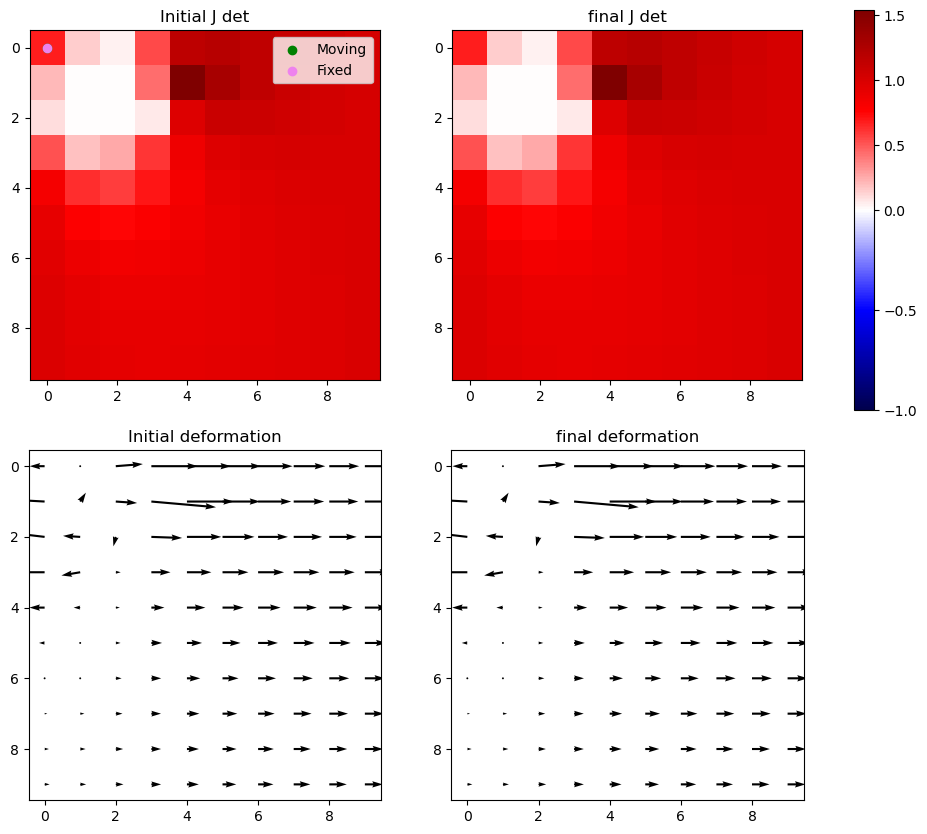

Iter 5 with 0 -ve jacs



Iter 6: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


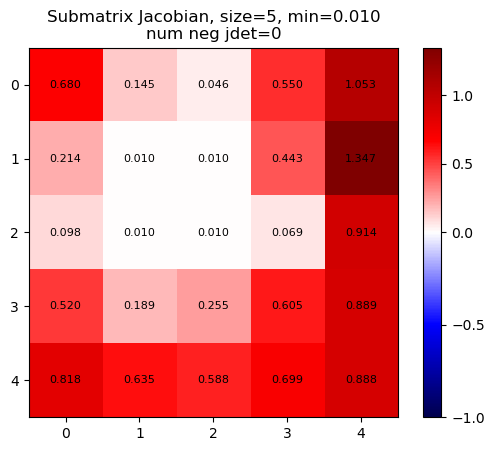

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


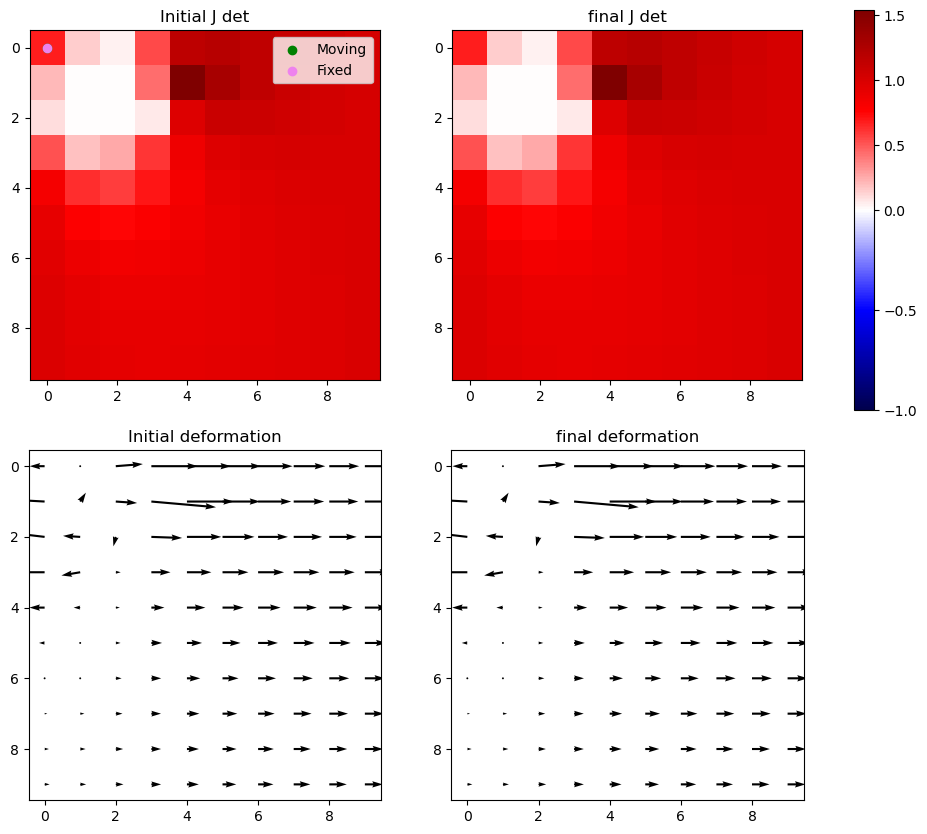

Iter 6: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


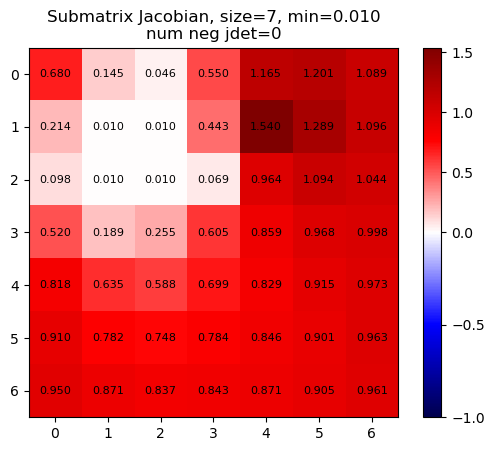

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


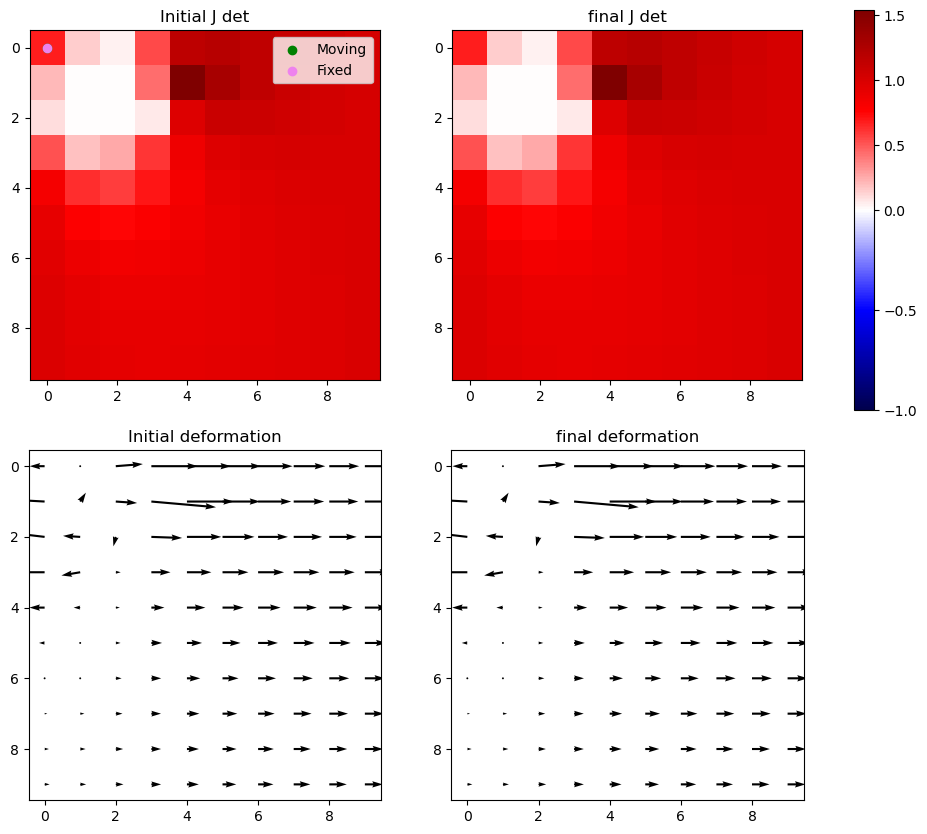

Iter 6: For index (2, 1), window size increased to 9 at iter 3


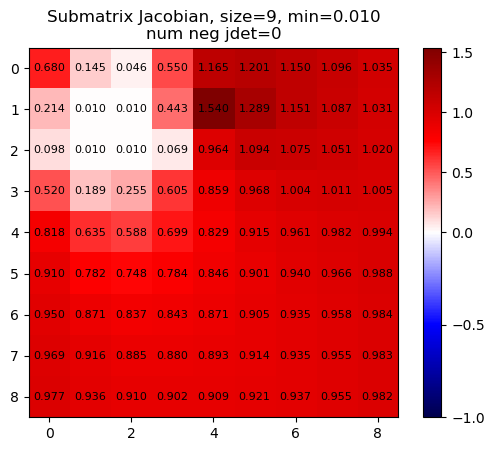

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


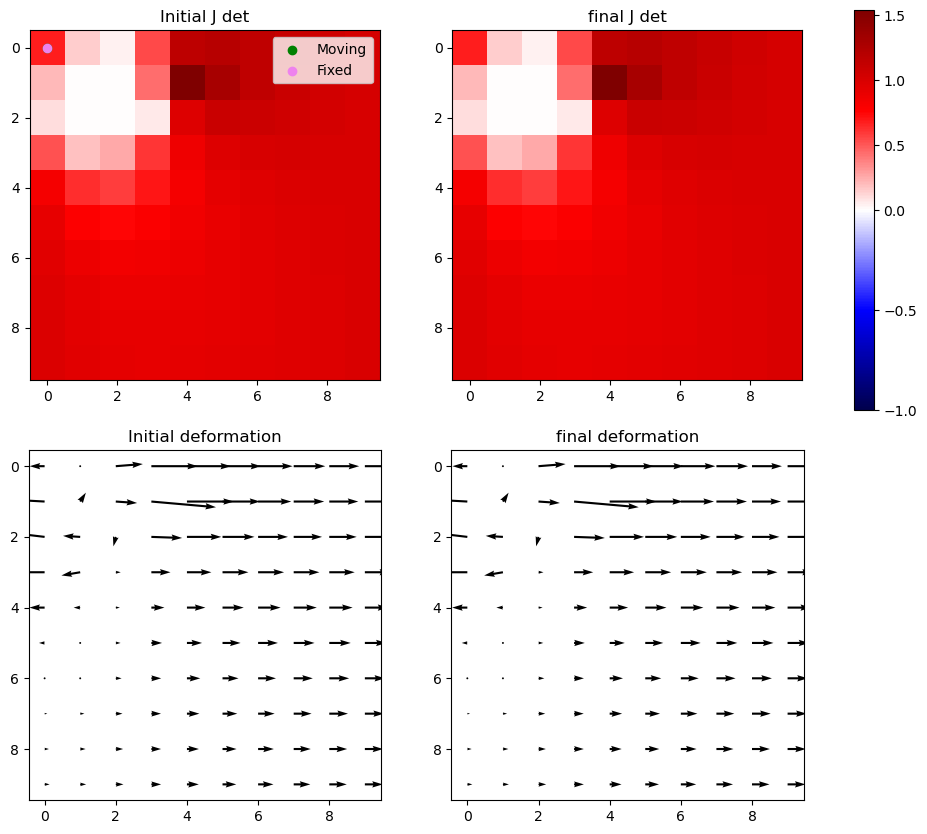

Iter 6 with 0 -ve jacs



Iter 7: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


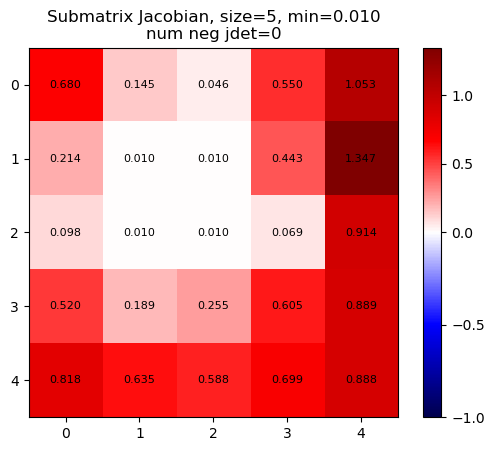

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


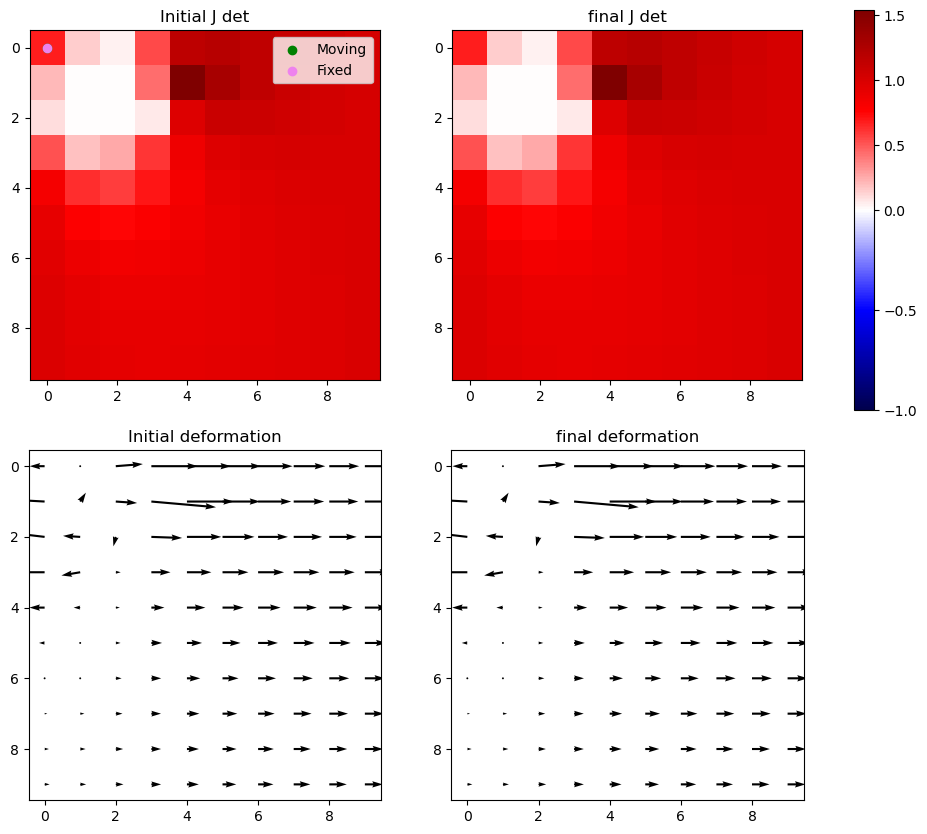

Iter 7: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


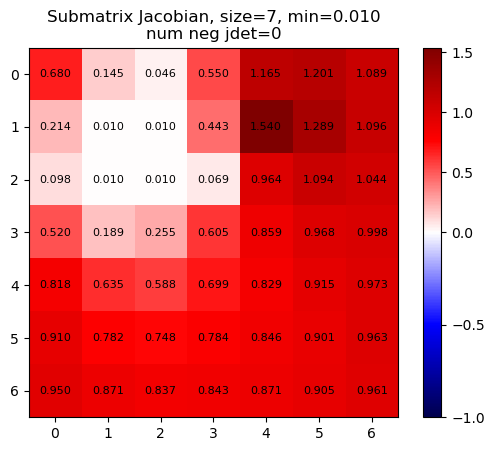

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


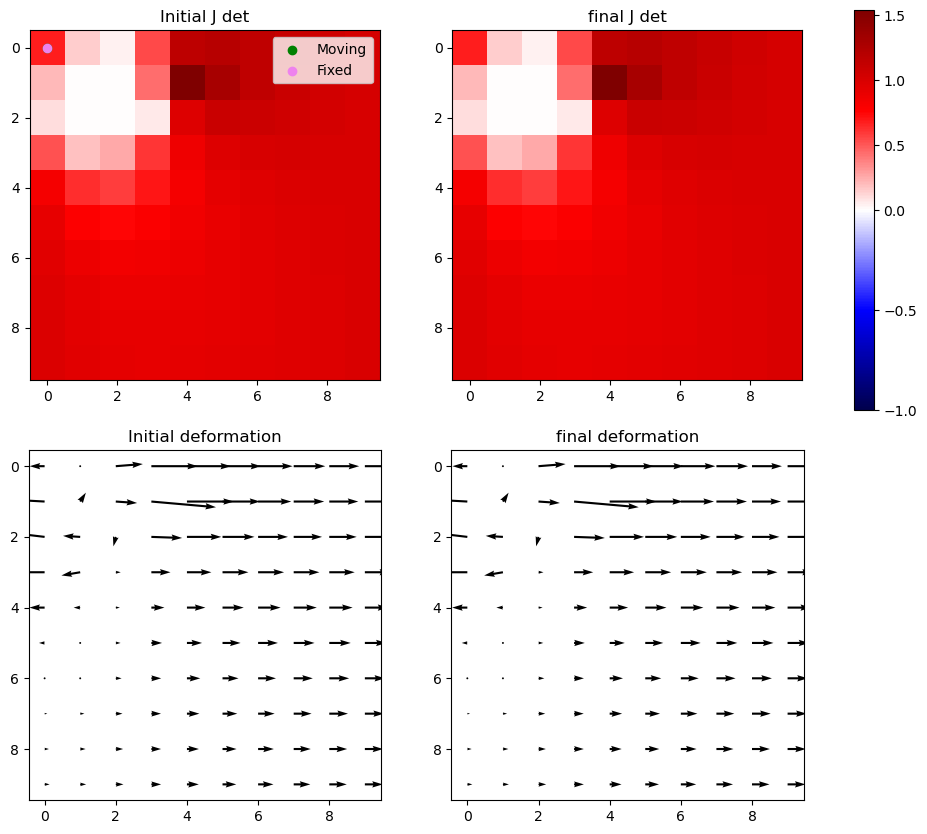

Iter 7: For index (2, 1), window size increased to 9 at iter 3


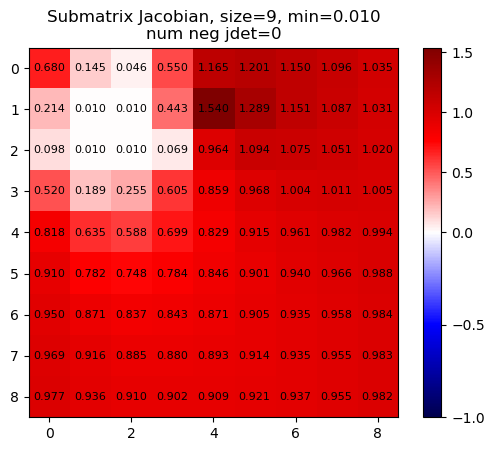

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


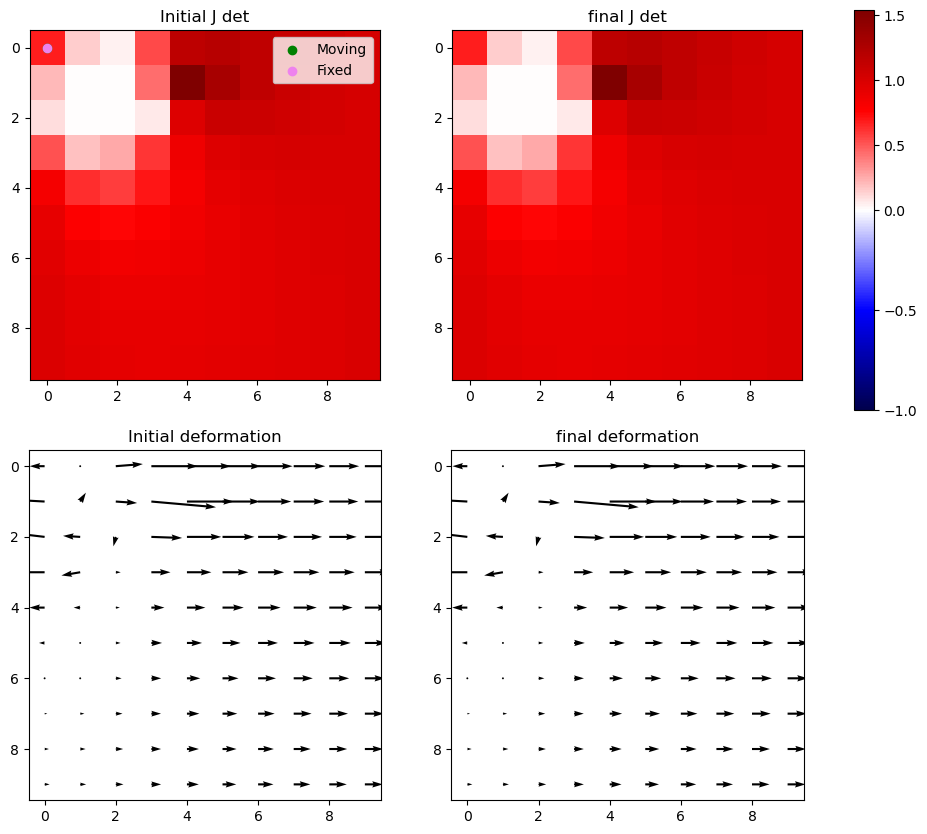

Iter 7 with 0 -ve jacs



Iter 8: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


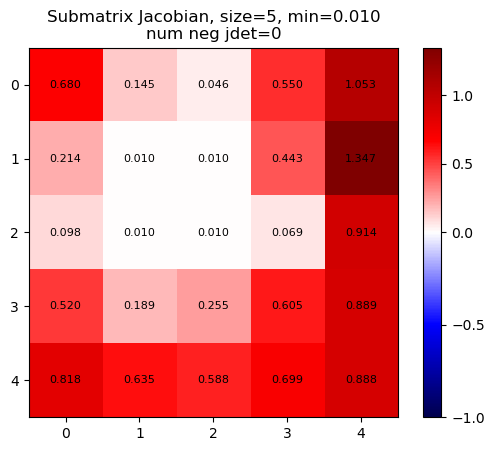

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


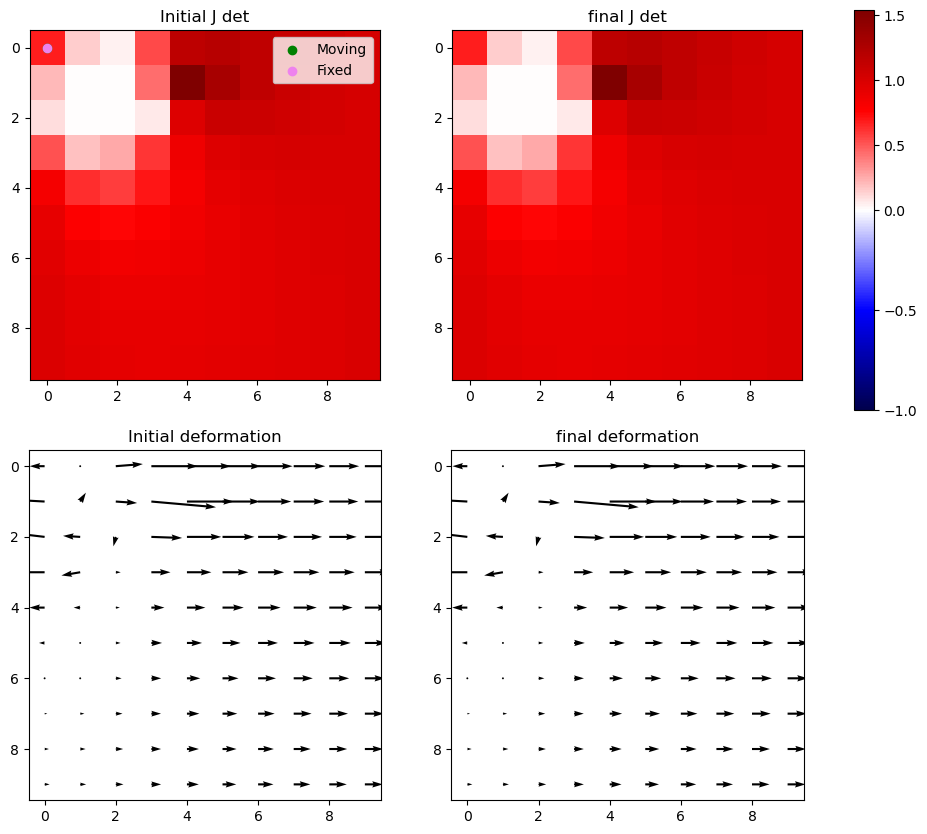

Iter 8: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


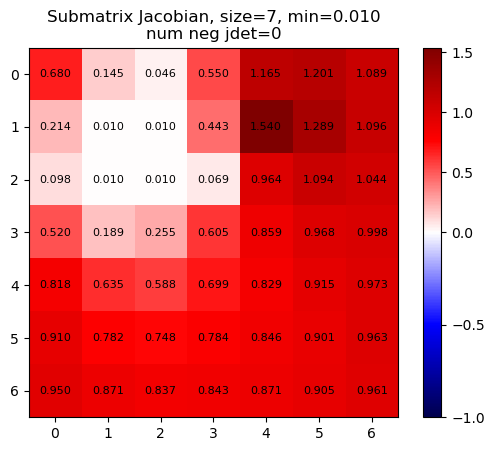

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


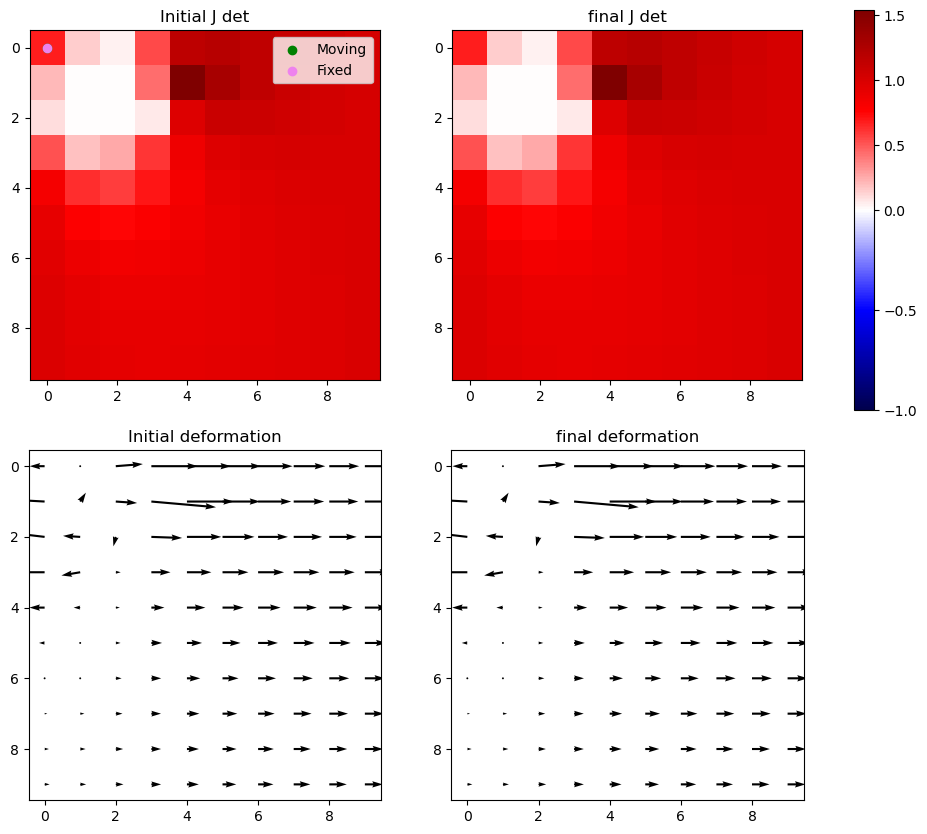

Iter 8: For index (2, 1), window size increased to 9 at iter 3


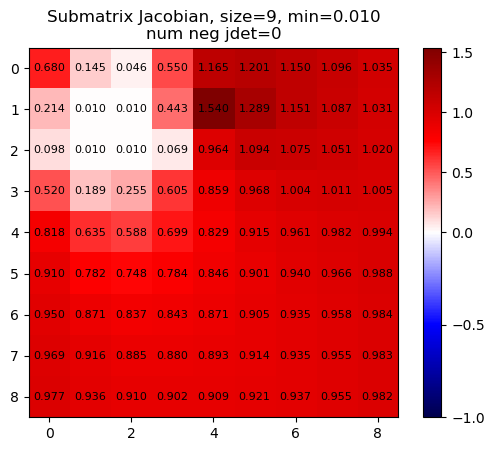

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


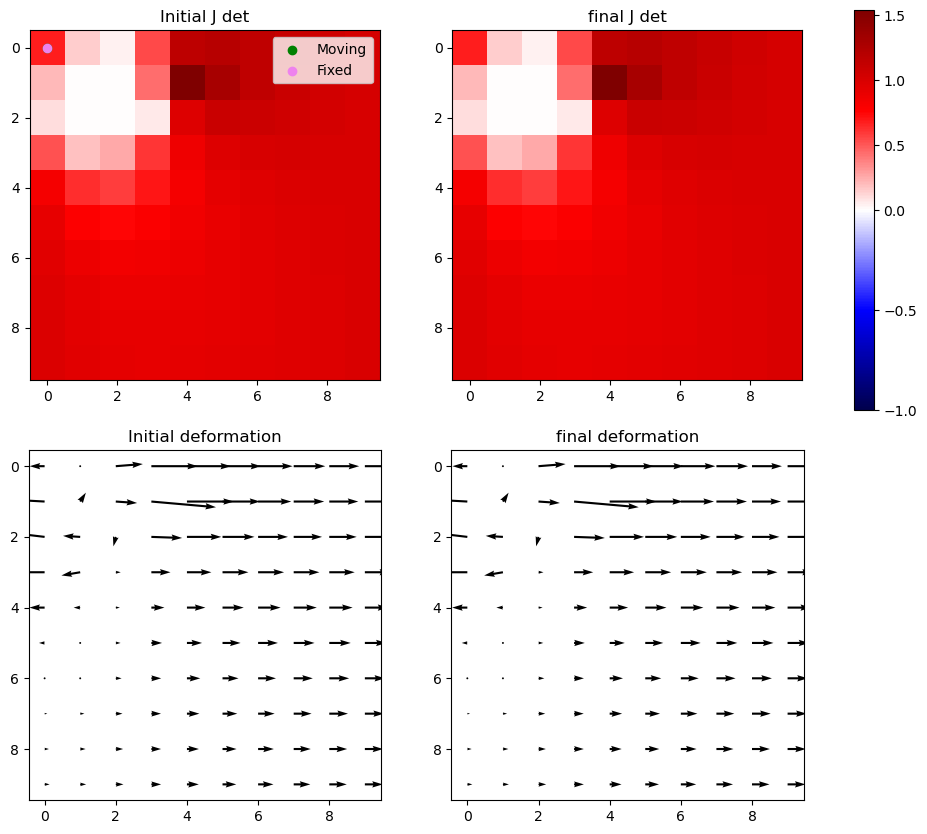

Iter 8 with 0 -ve jacs



Iter 9: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


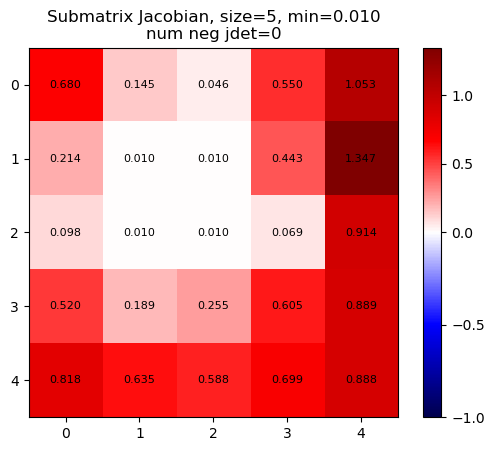

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


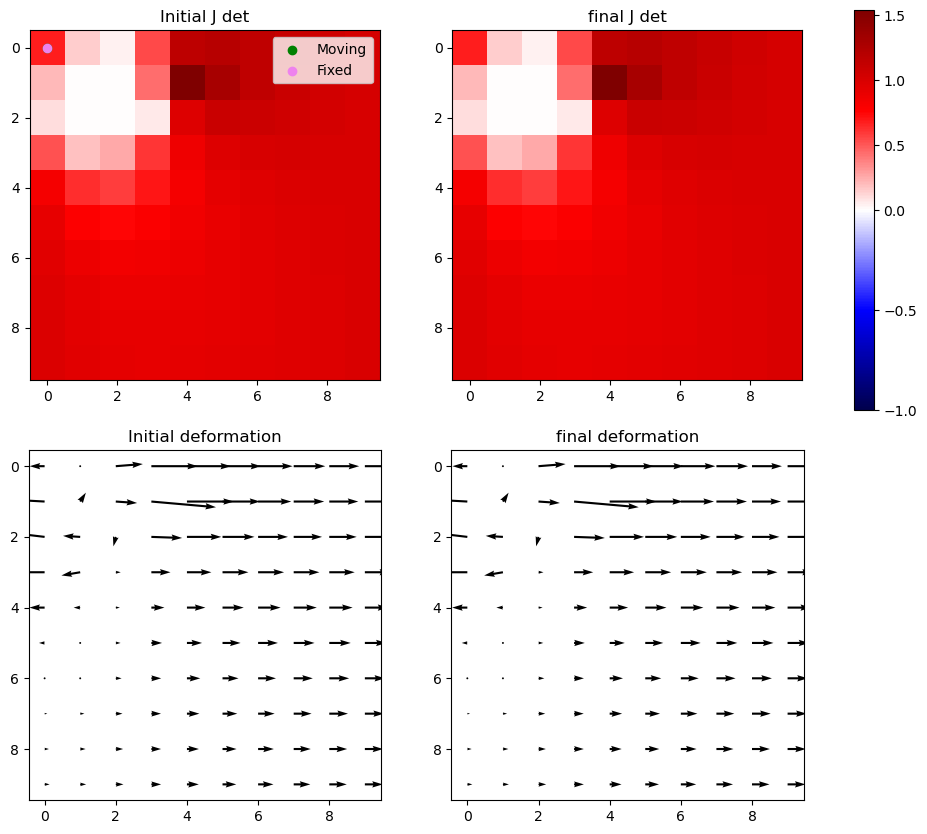

Iter 9: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


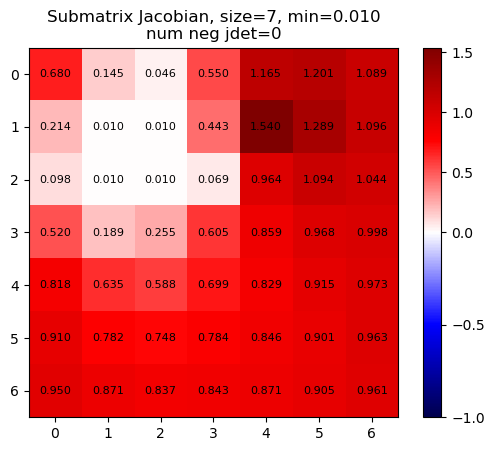

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


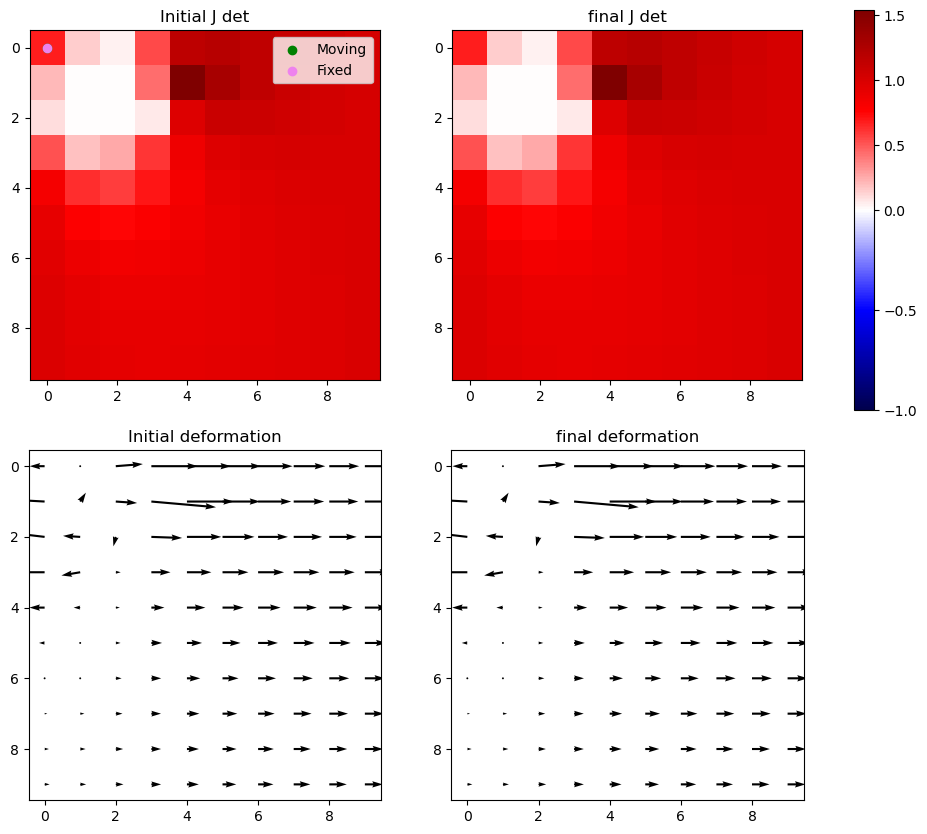

Iter 9: For index (2, 1), window size increased to 9 at iter 3


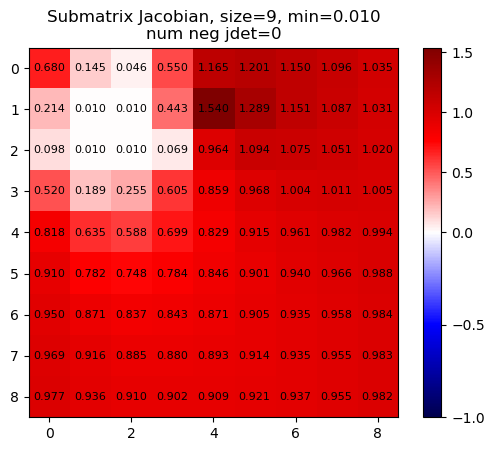

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


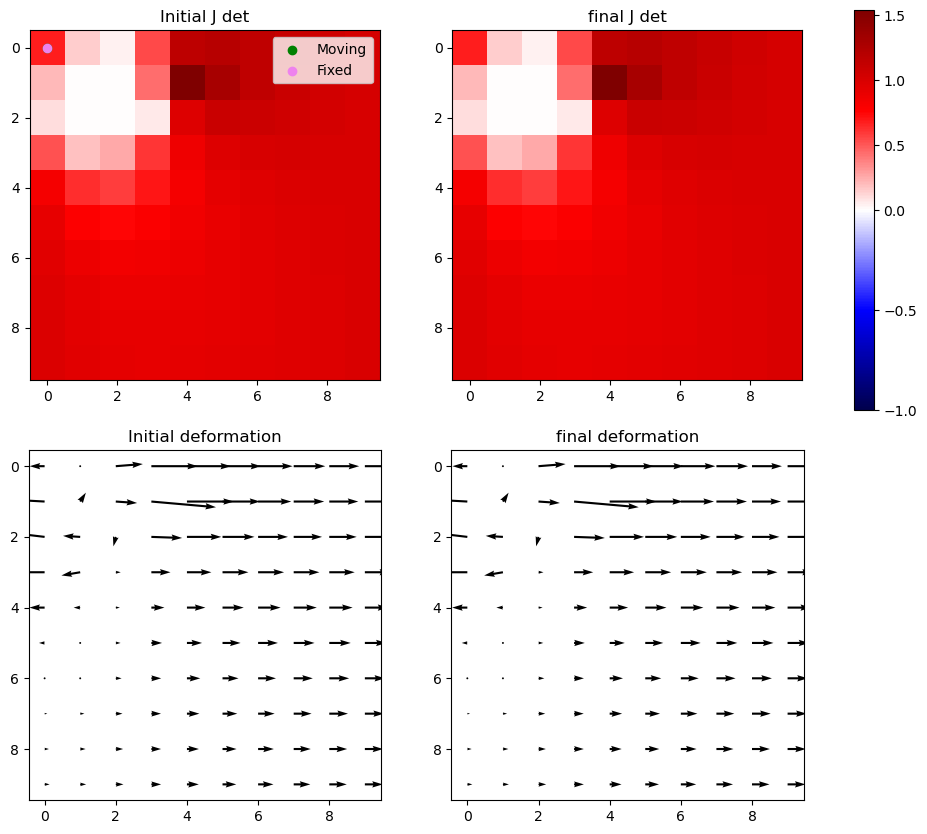

Iter 9 with 0 -ve jacs



Iter 10: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


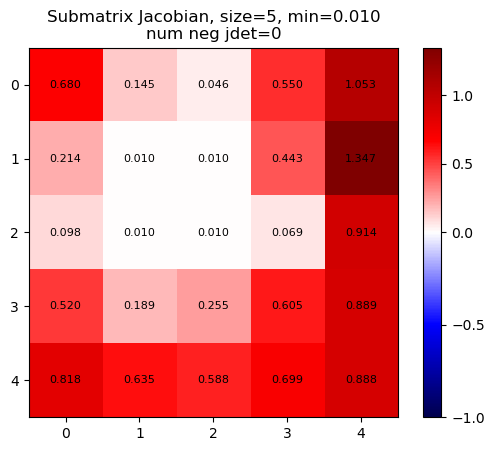

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


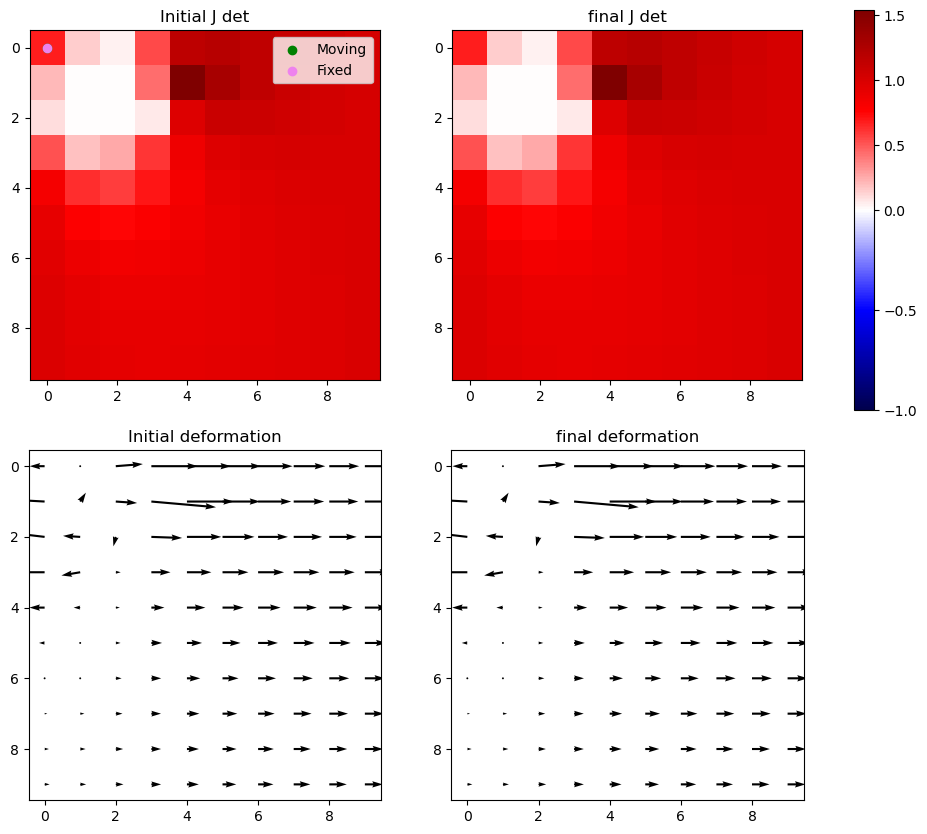

Iter 10: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


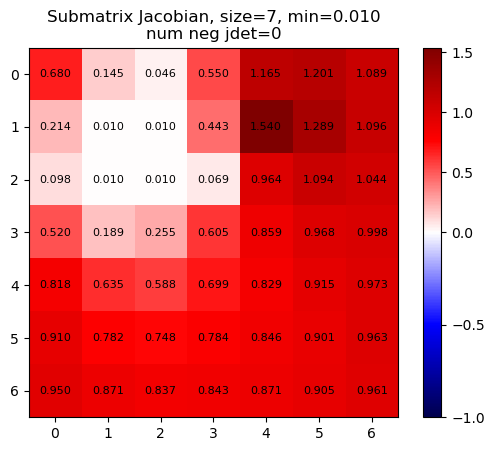

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


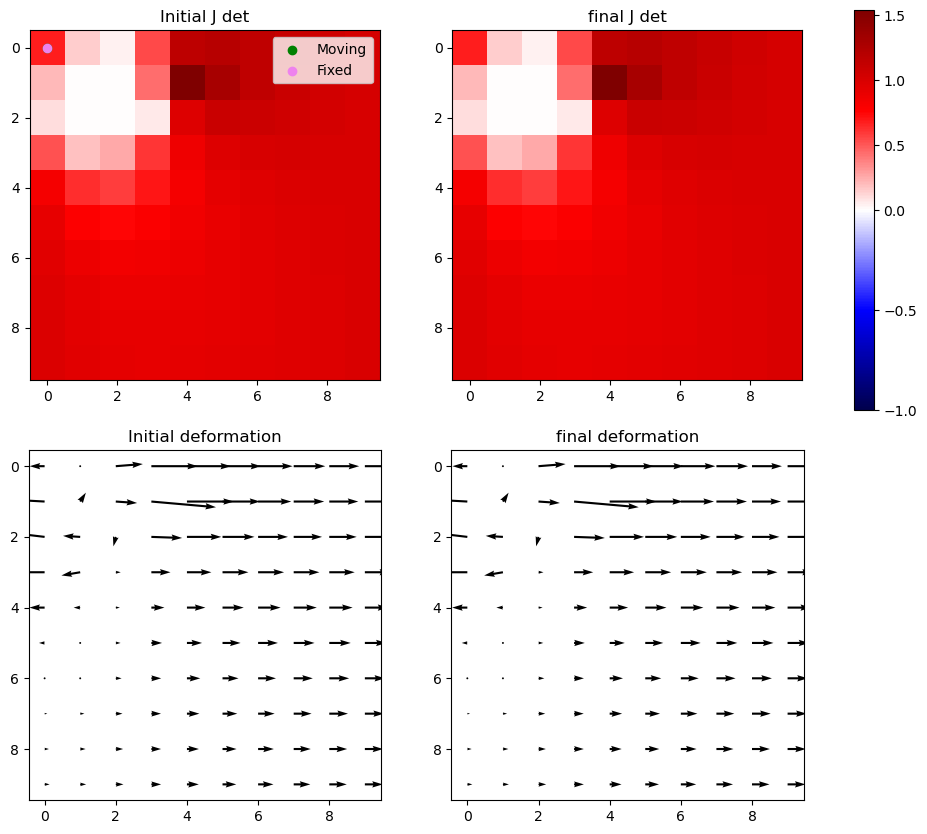

Iter 10: For index (2, 1), window size increased to 9 at iter 3


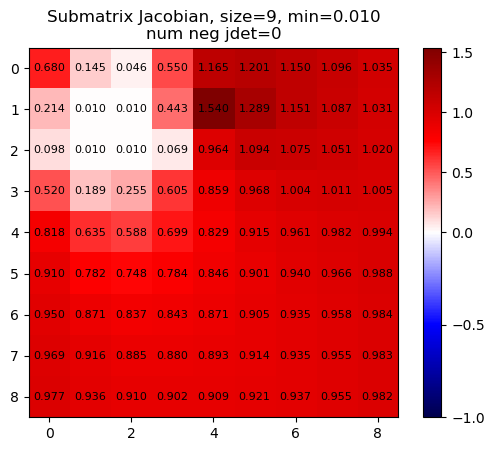

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


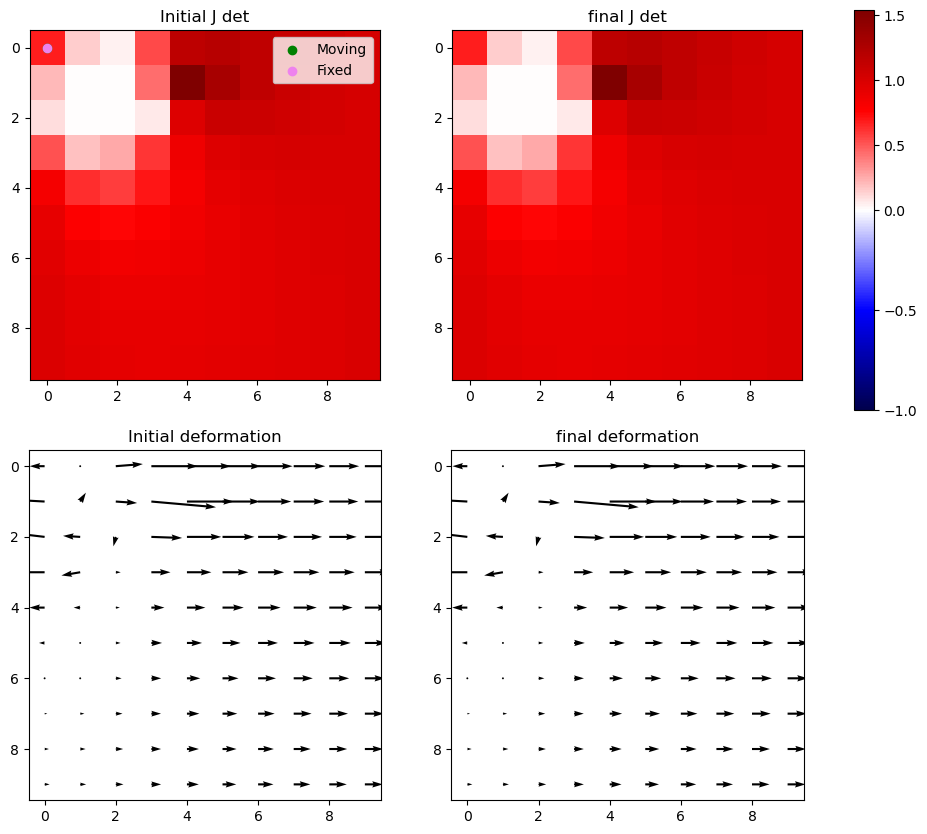

Iter 10 with 0 -ve jacs



Iter 11: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


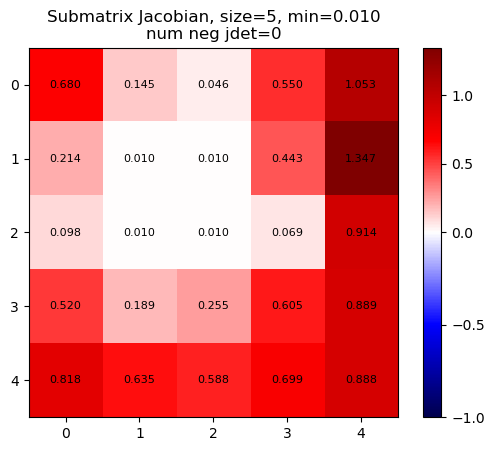

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


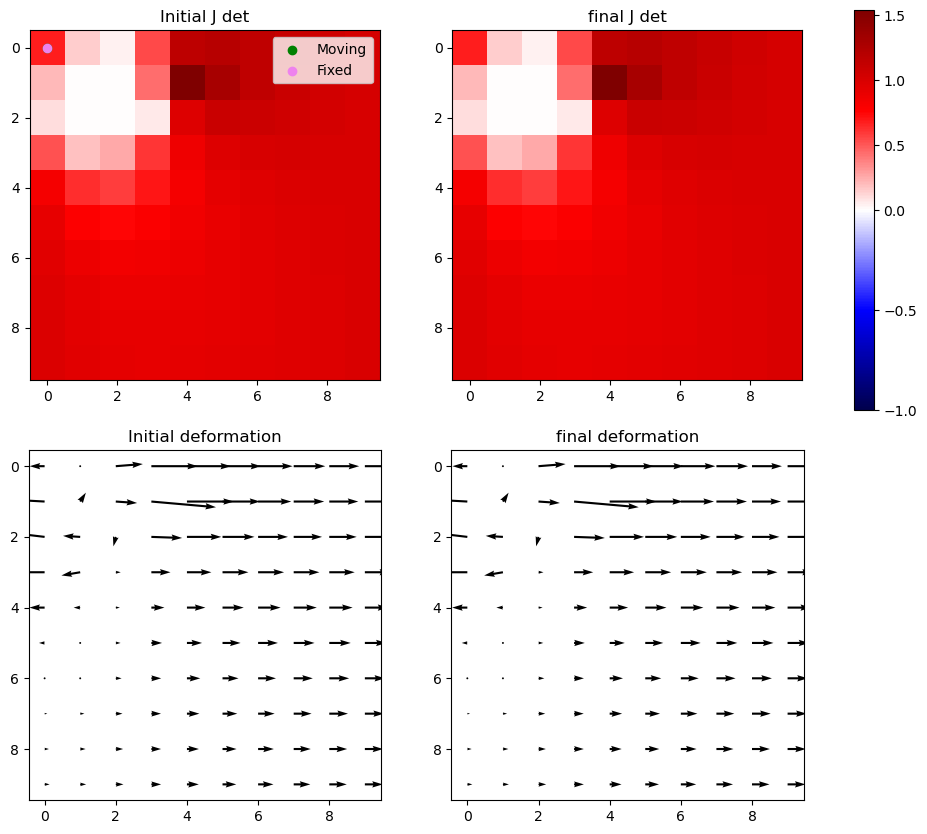

Iter 11: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


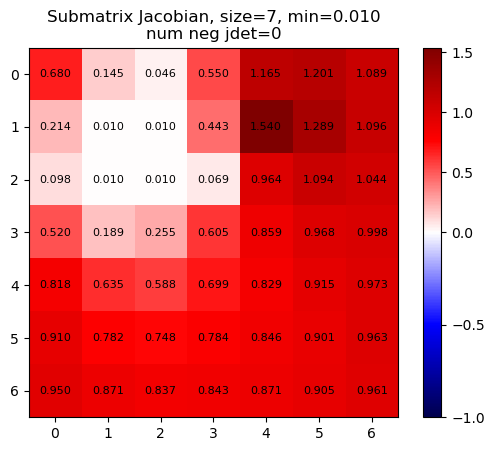

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


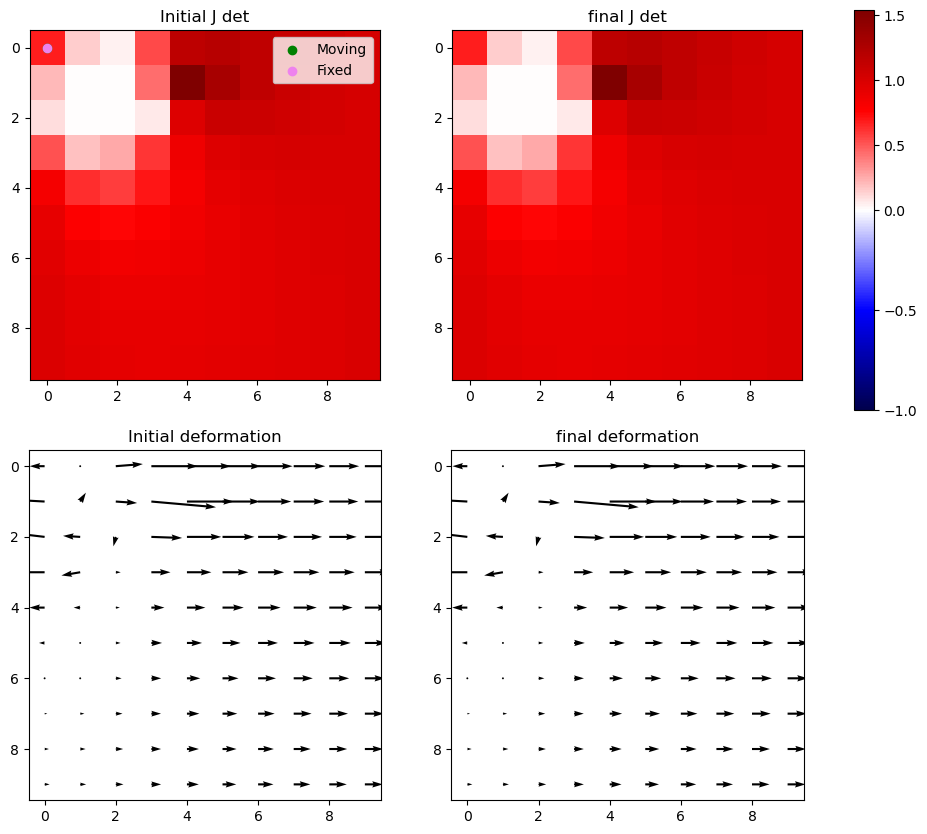

Iter 11: For index (2, 1), window size increased to 9 at iter 3


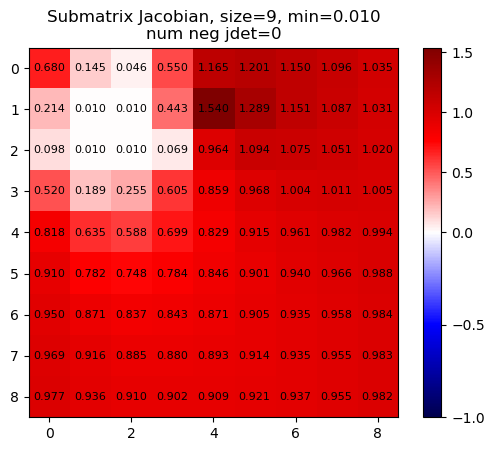

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


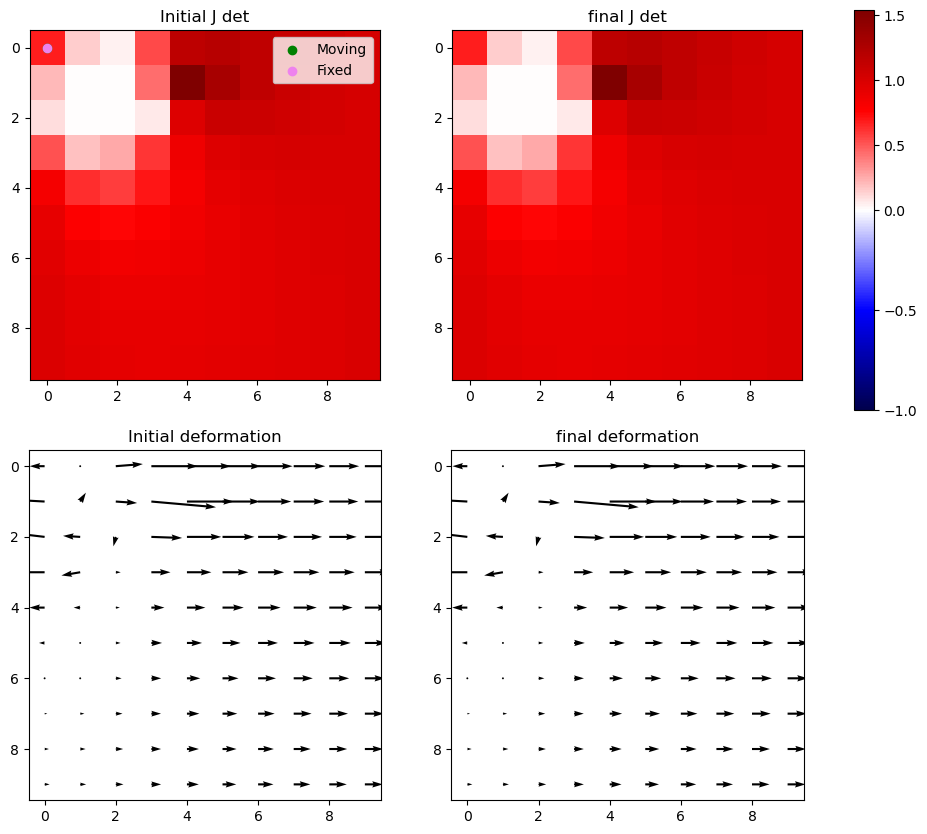

Iter 11 with 0 -ve jacs



Iter 12: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


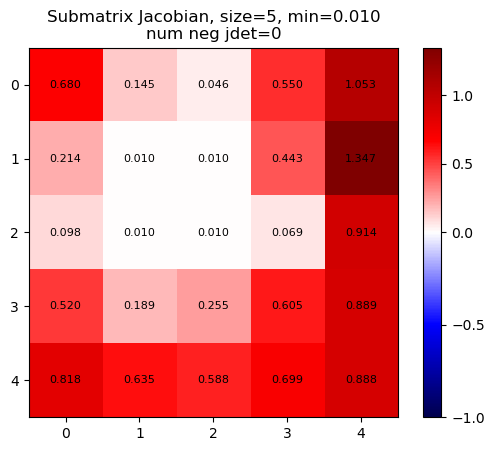

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


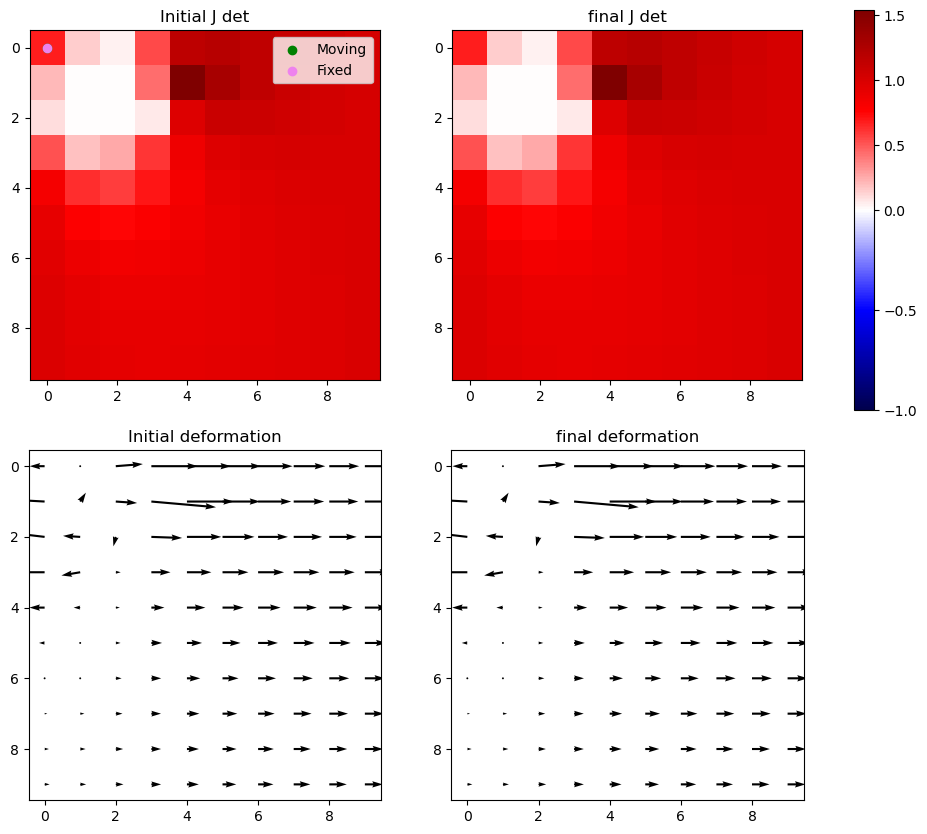

Iter 12: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


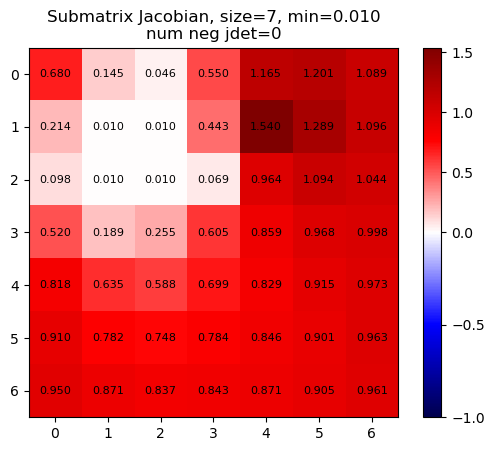

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


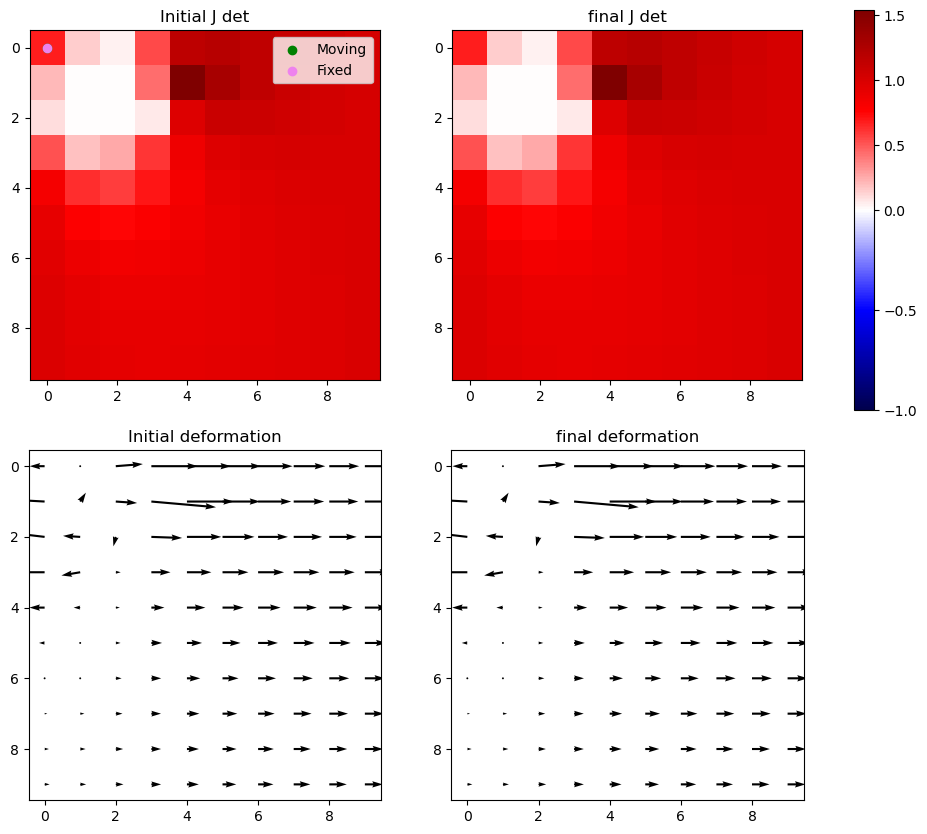

Iter 12: For index (2, 1), window size increased to 9 at iter 3


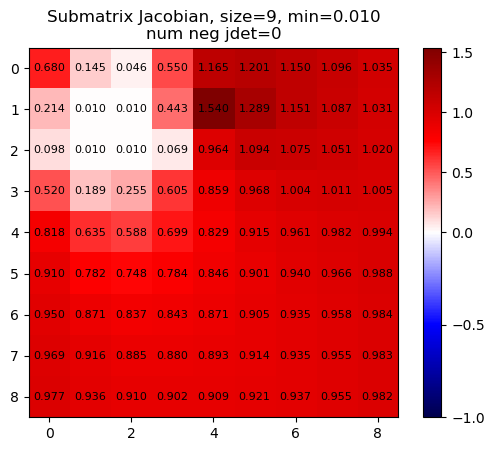

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


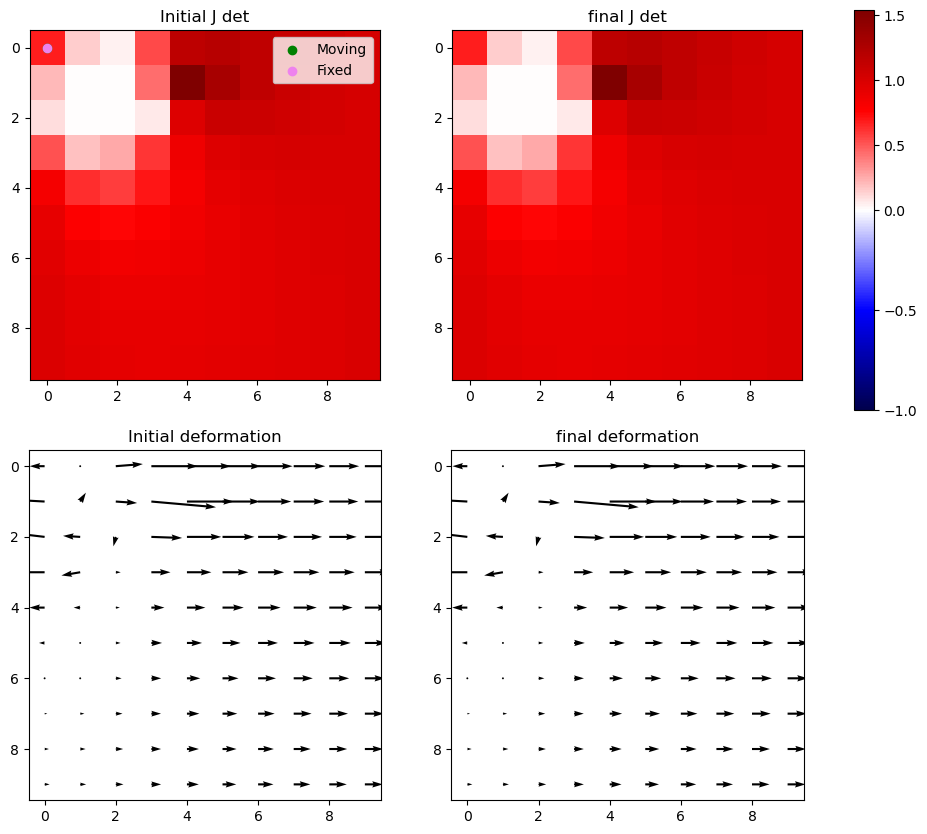

Iter 12 with 0 -ve jacs



Iter 13: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


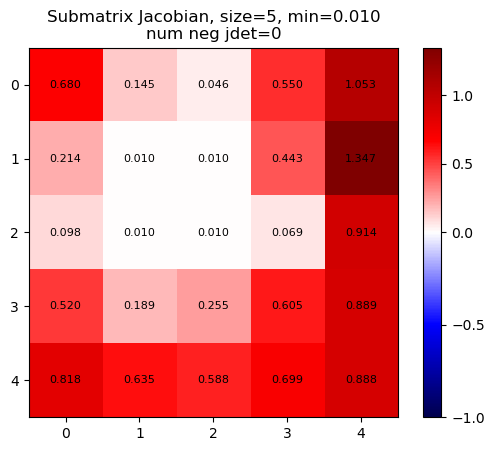

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


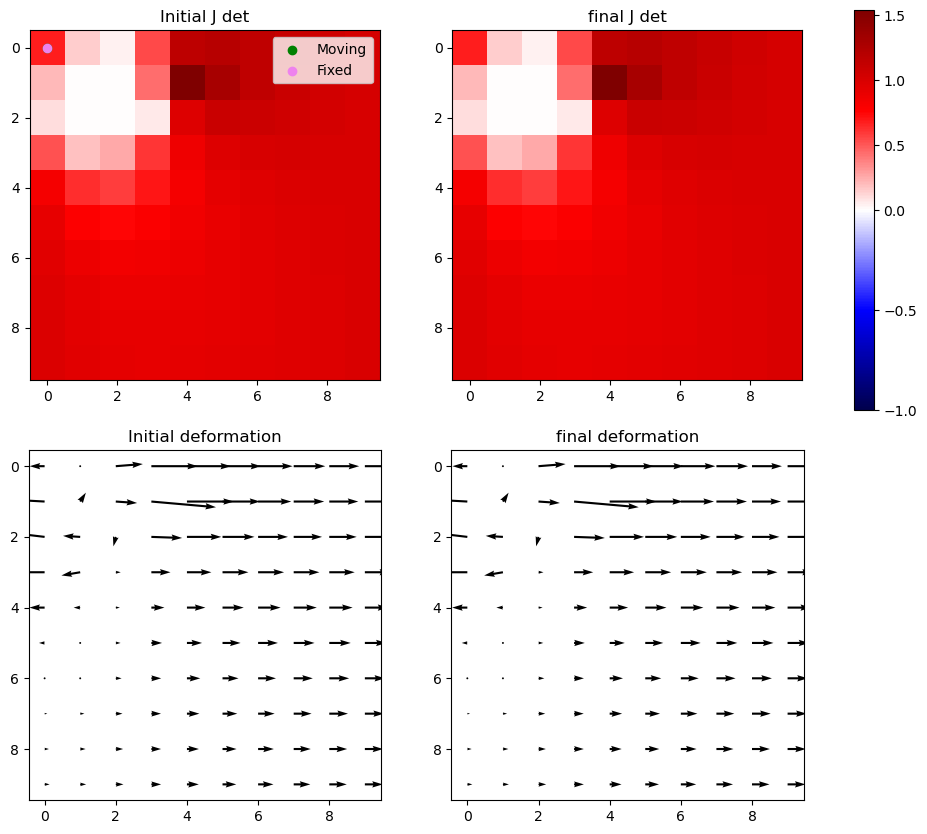

Iter 13: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


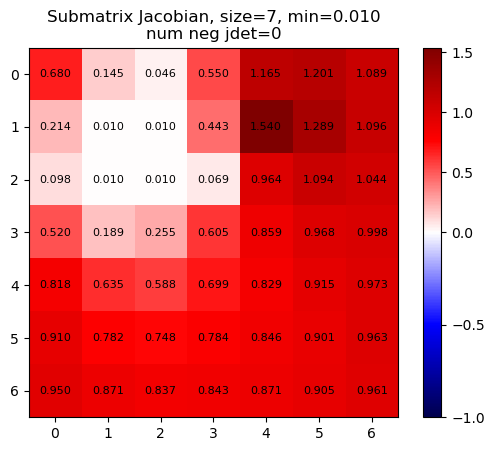

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


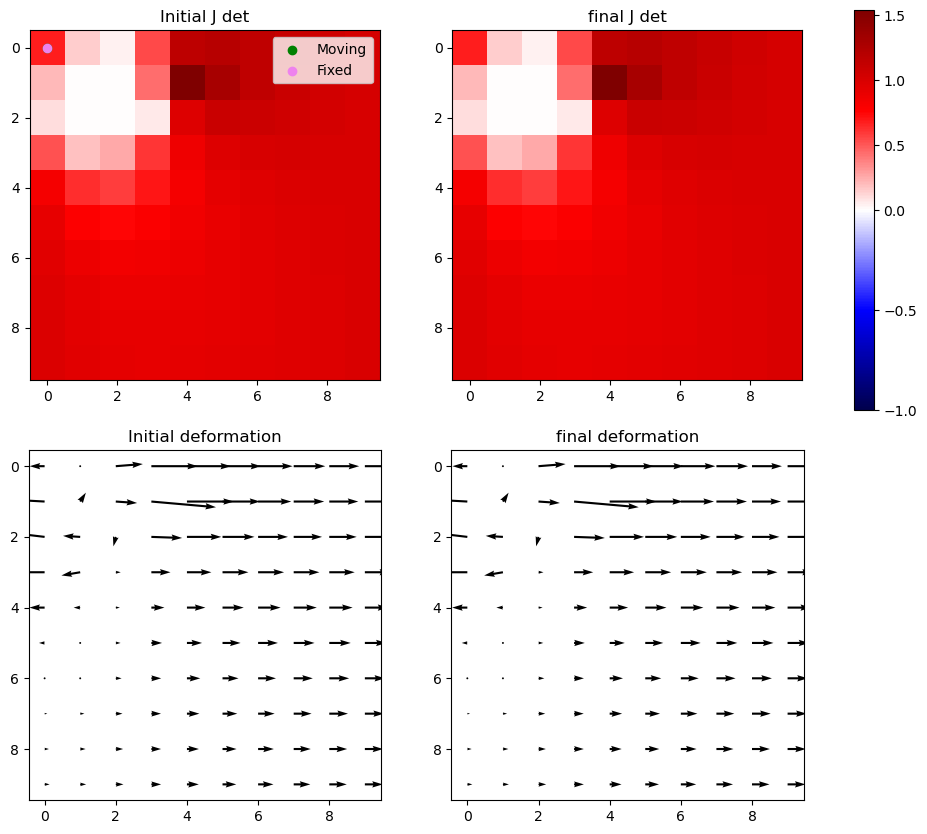

Iter 13: For index (2, 1), window size increased to 9 at iter 3


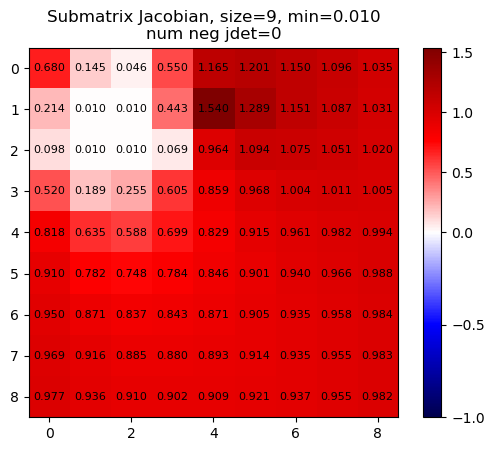

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


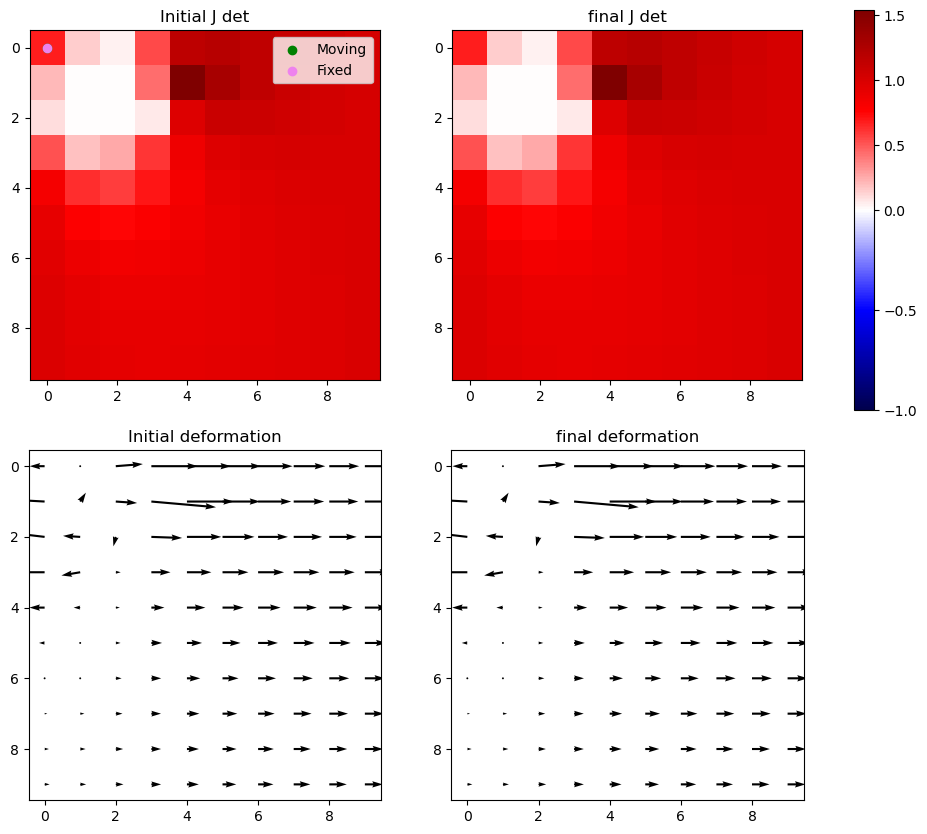

Iter 13 with 0 -ve jacs



Iter 14: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


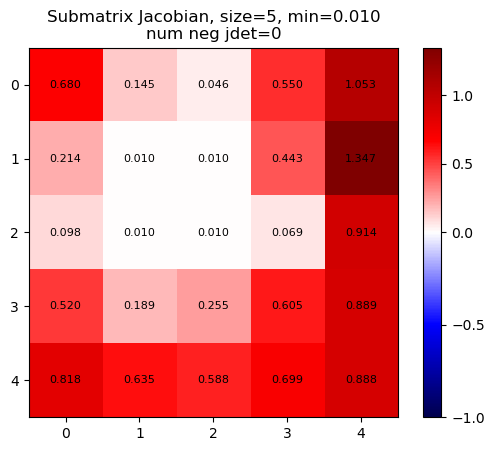

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


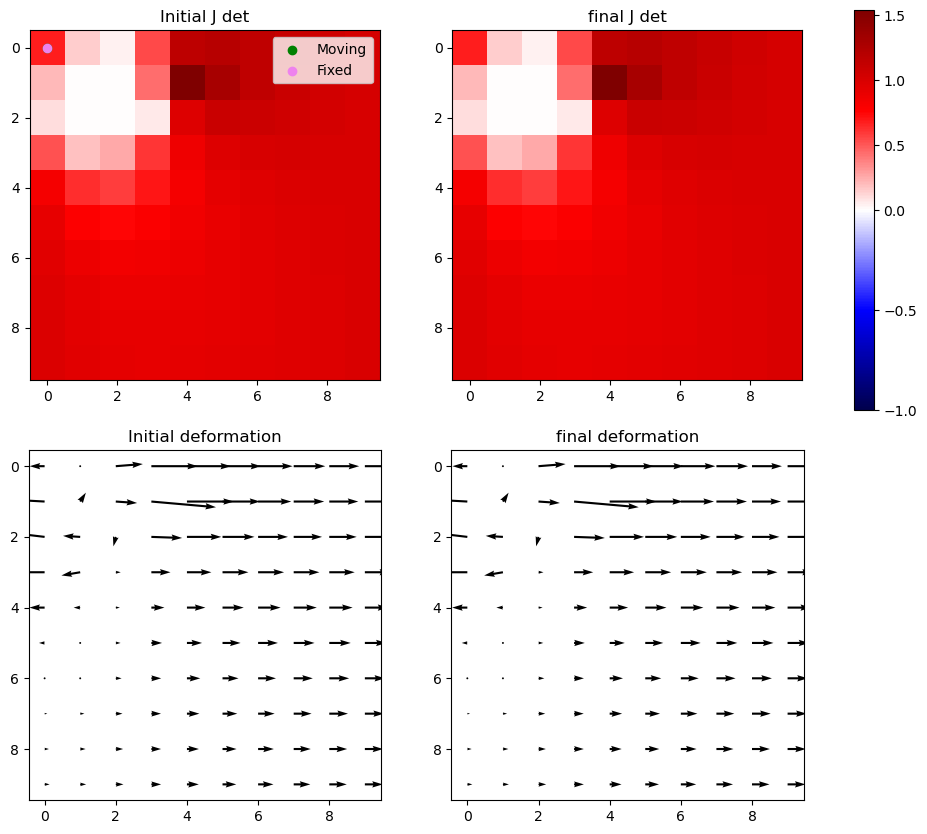

Iter 14: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


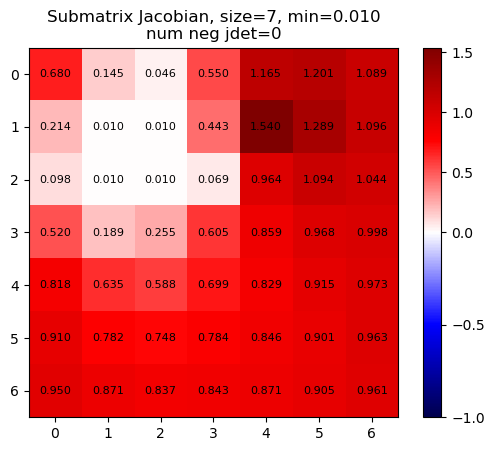

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


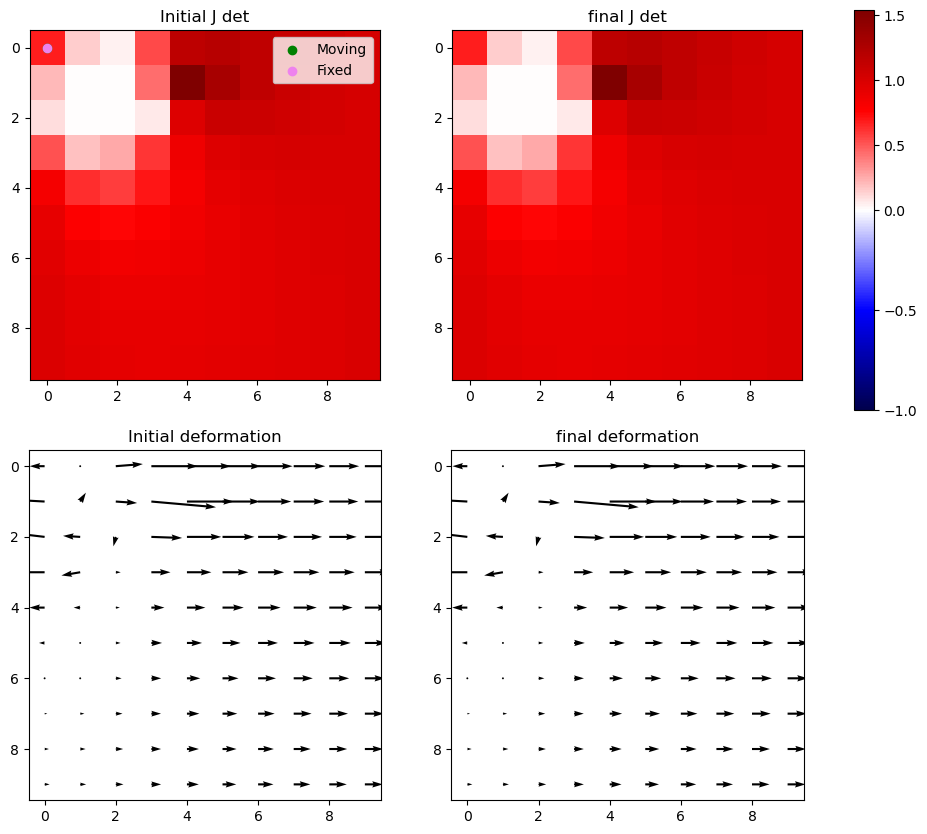

Iter 14: For index (2, 1), window size increased to 9 at iter 3


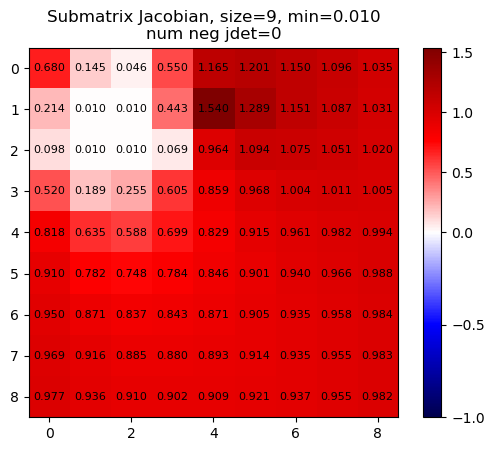

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


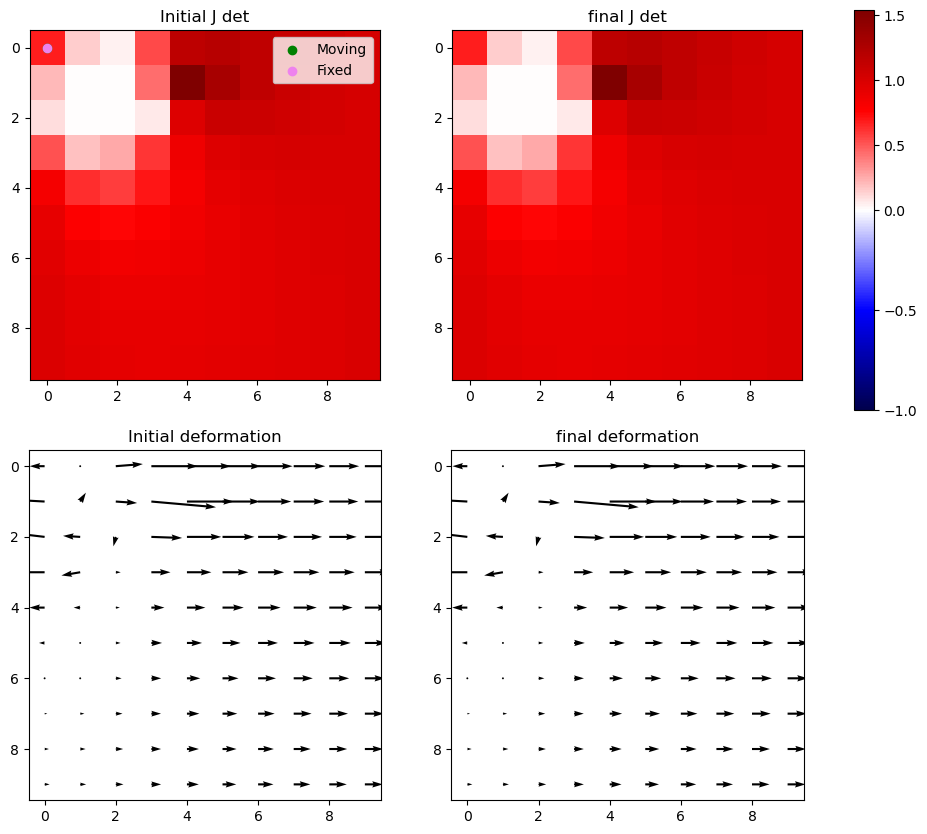

Iter 14 with 0 -ve jacs



Iter 15: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


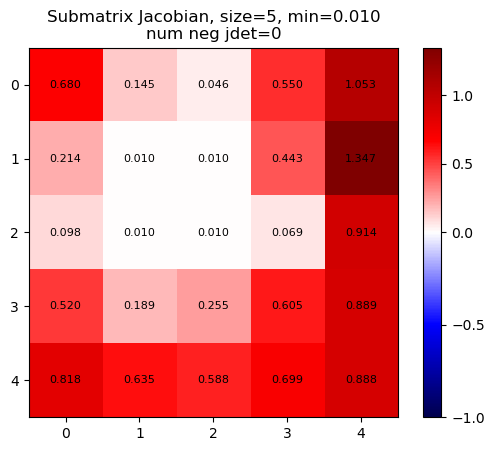

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


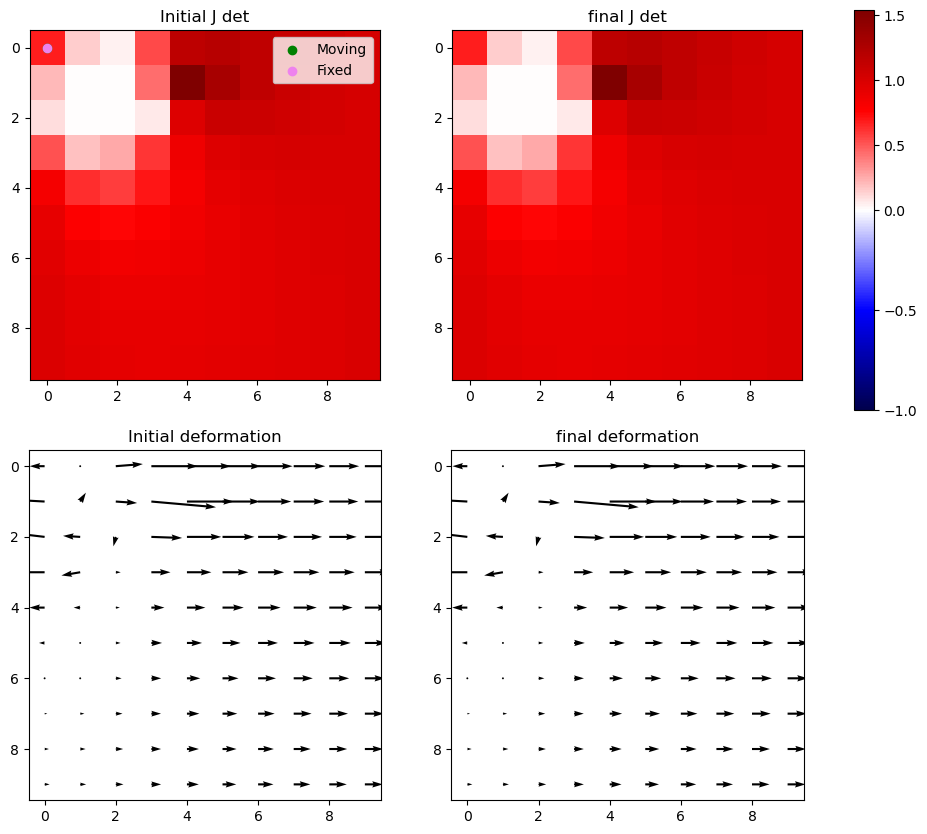

Iter 15: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


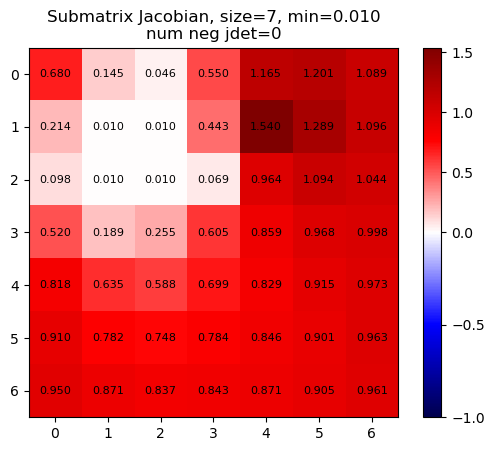

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


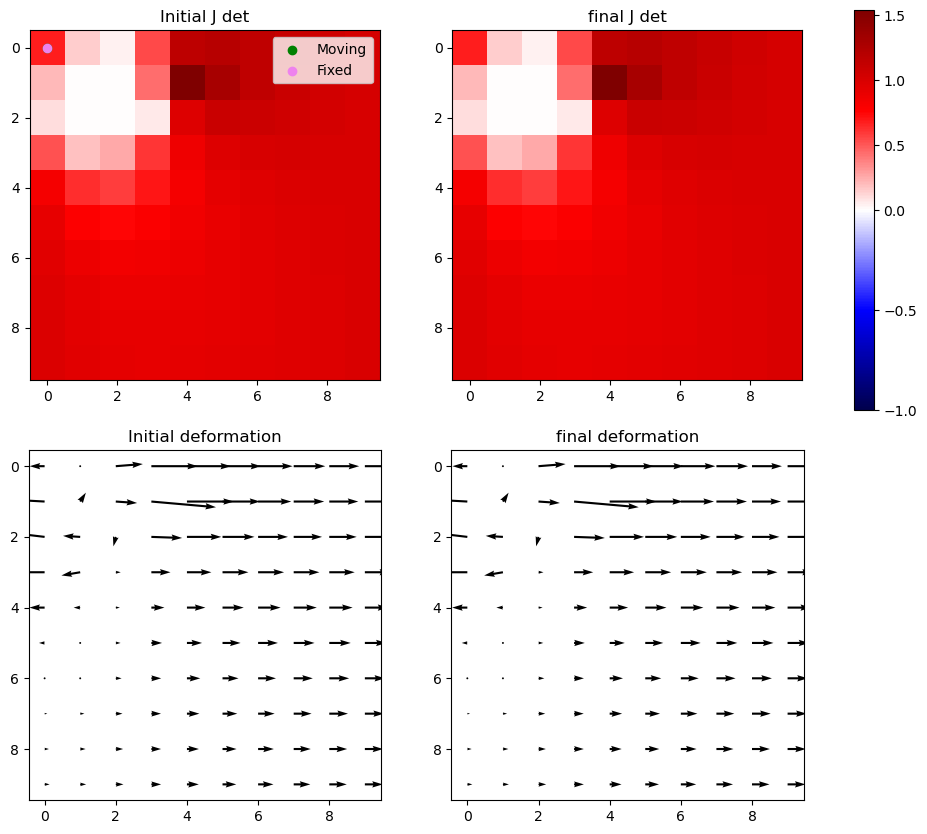

Iter 15: For index (2, 1), window size increased to 9 at iter 3


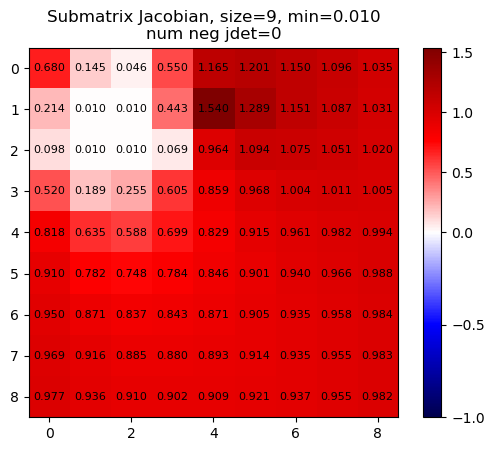

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


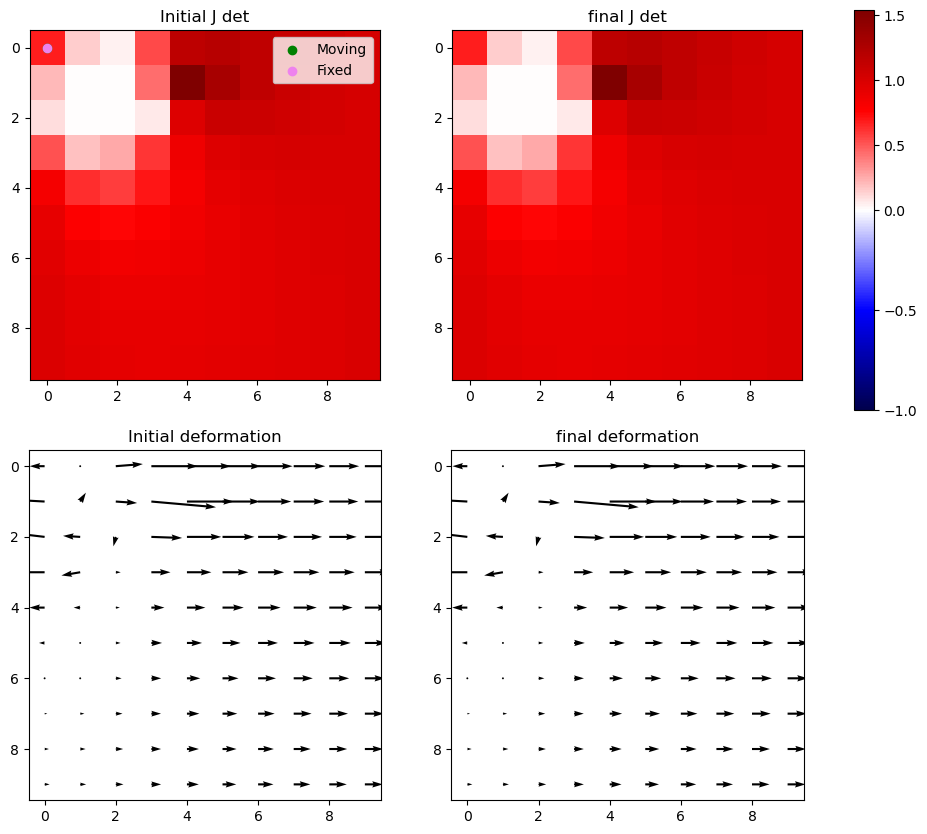

Iter 15 with 0 -ve jacs



Iter 16: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


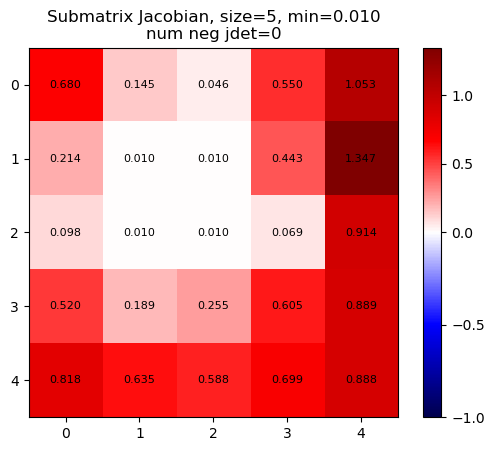

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


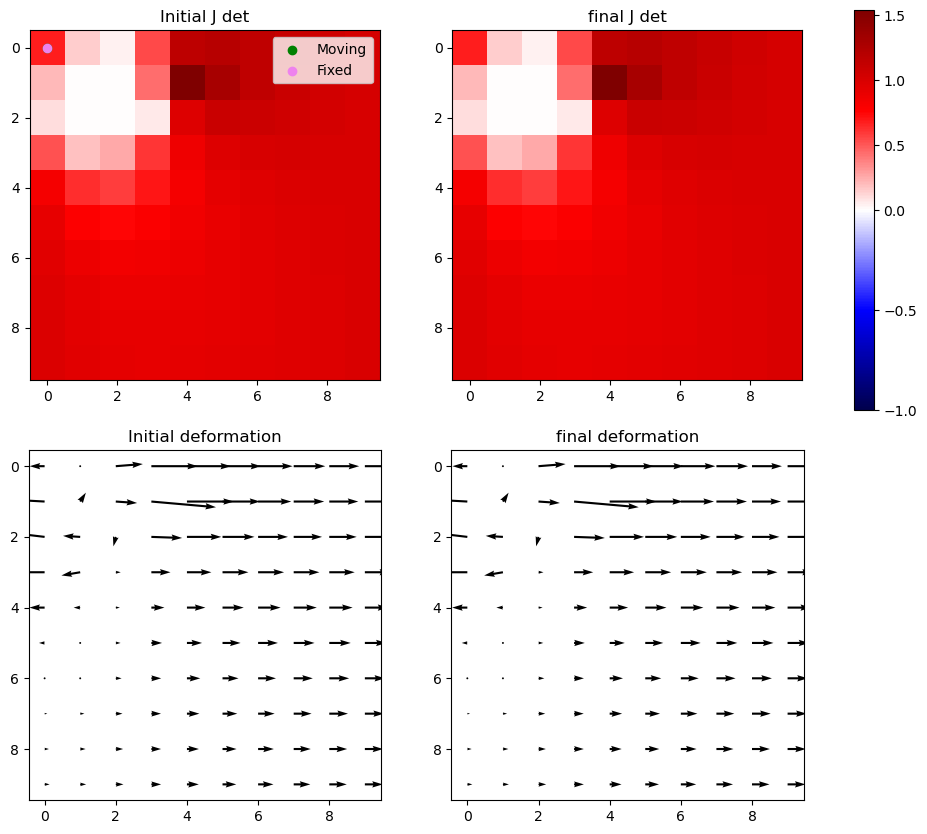

Iter 16: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


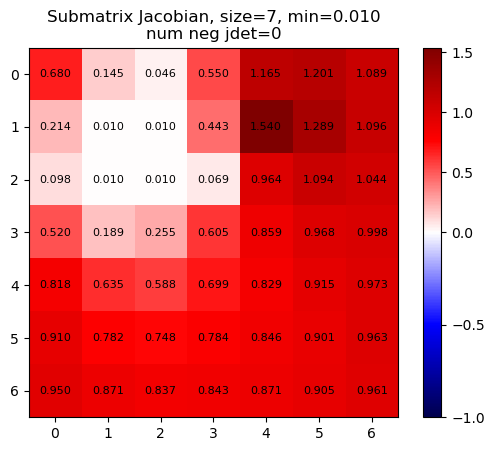

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


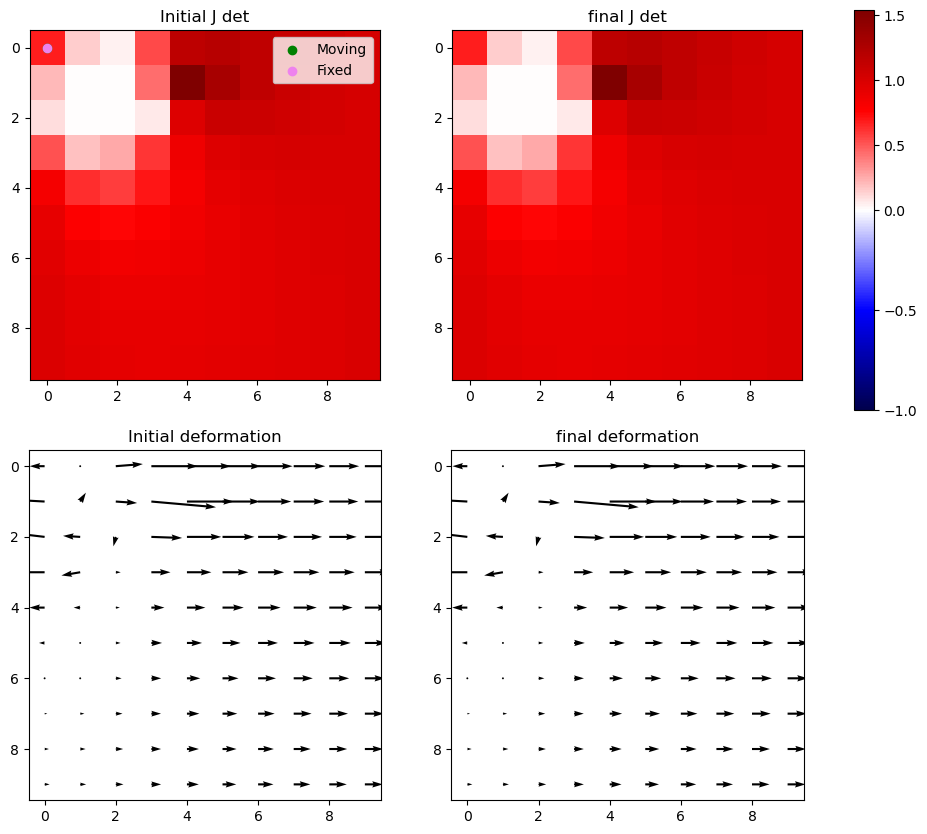

Iter 16: For index (2, 1), window size increased to 9 at iter 3


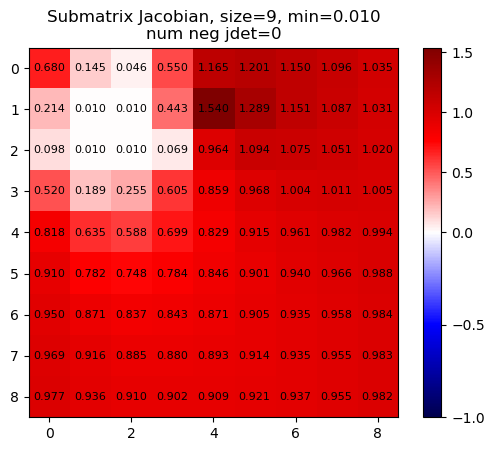

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


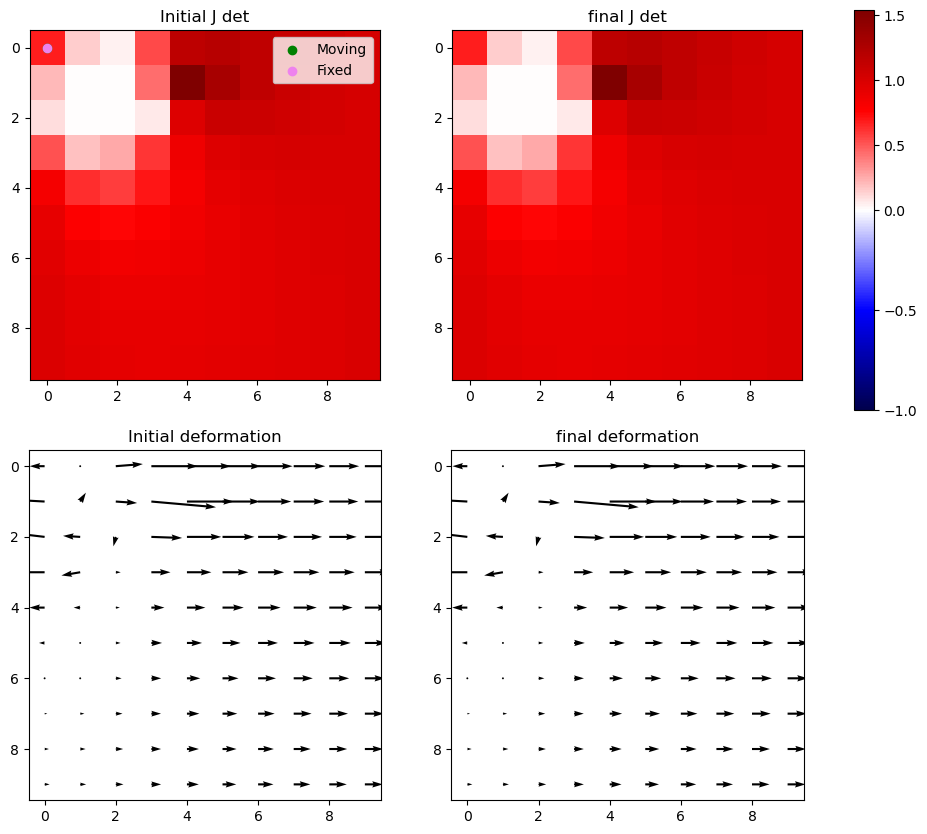

Iter 16 with 0 -ve jacs



Iter 17: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


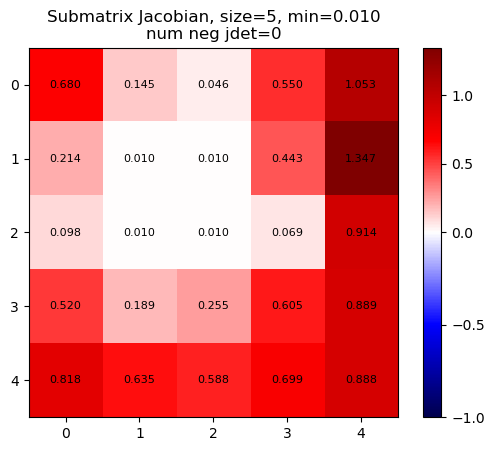

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


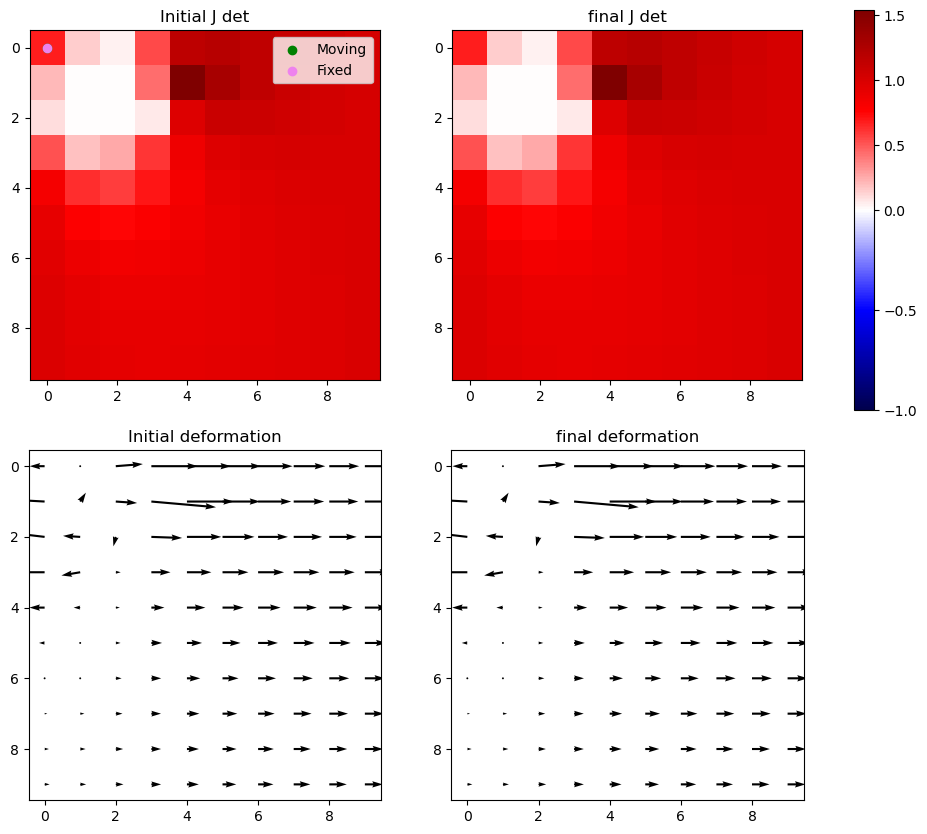

Iter 17: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


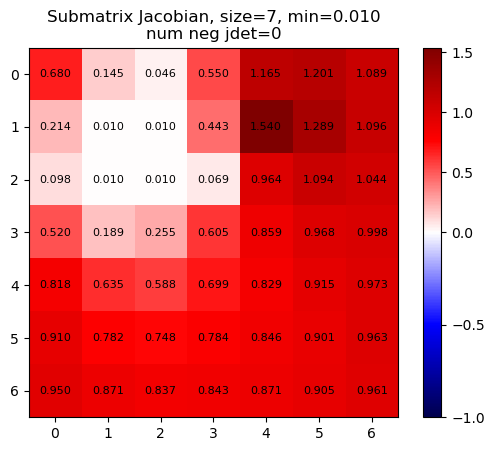

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


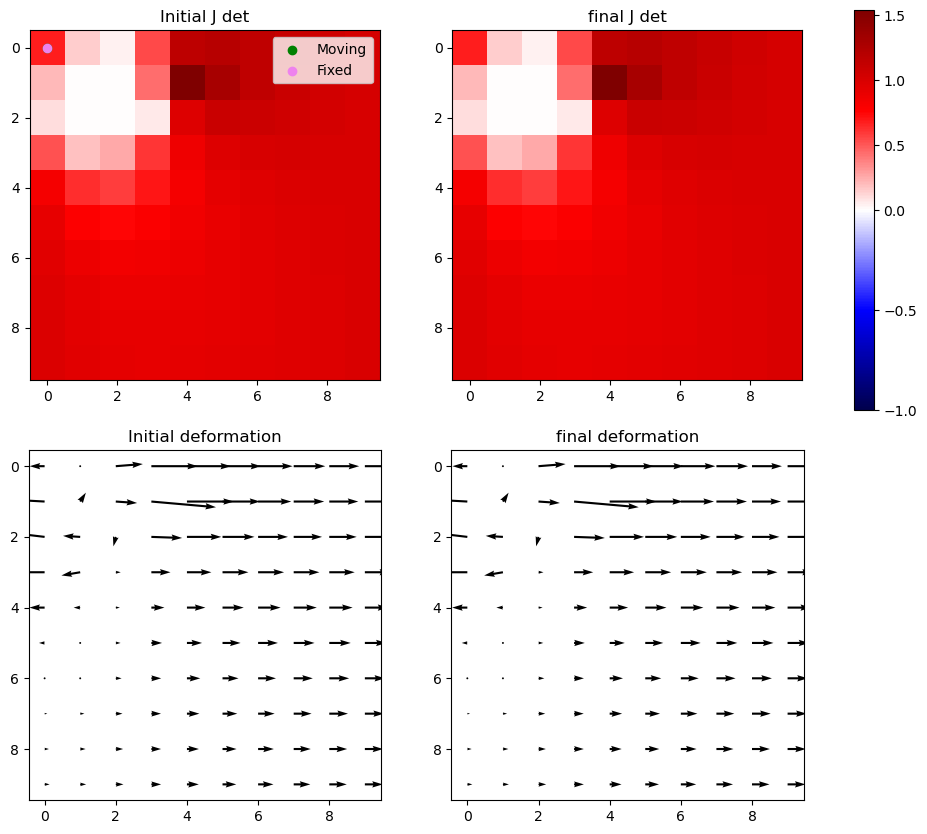

Iter 17: For index (2, 1), window size increased to 9 at iter 3


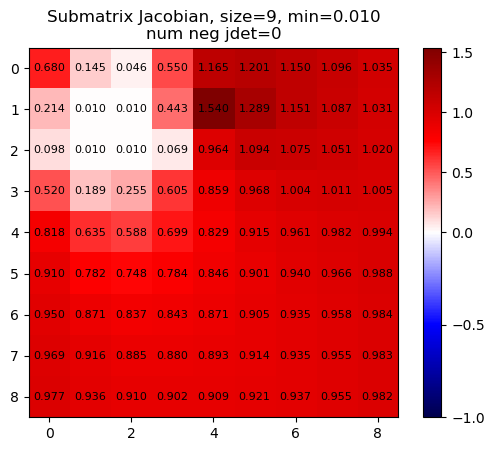

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


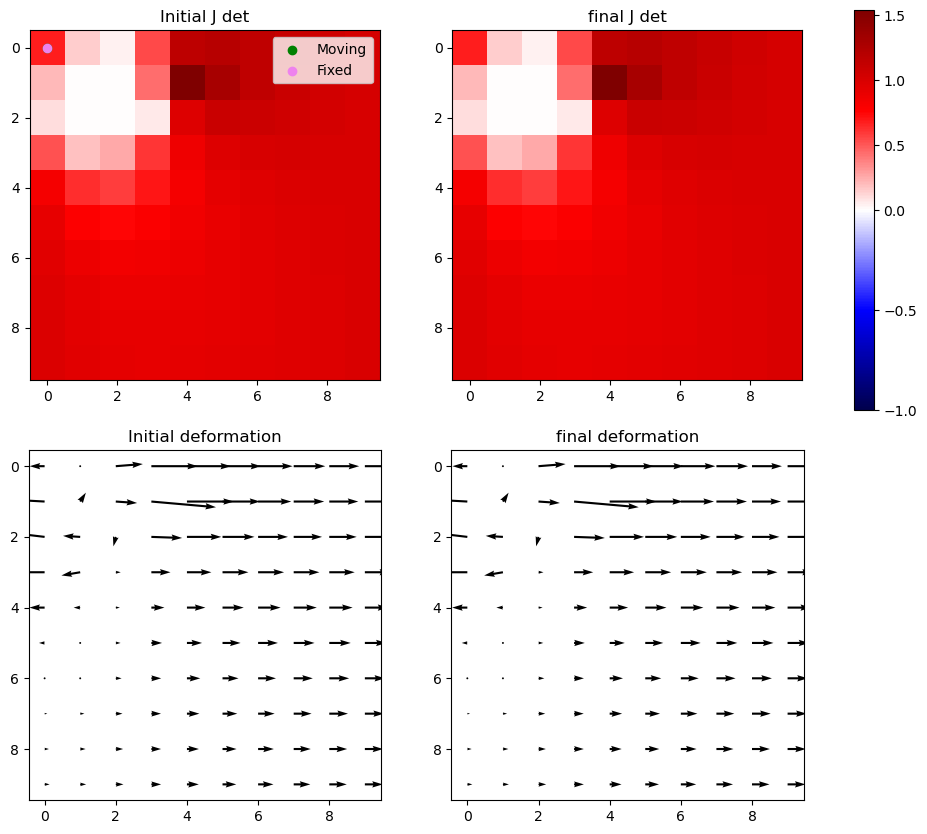

Iter 17 with 0 -ve jacs



Iter 18: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


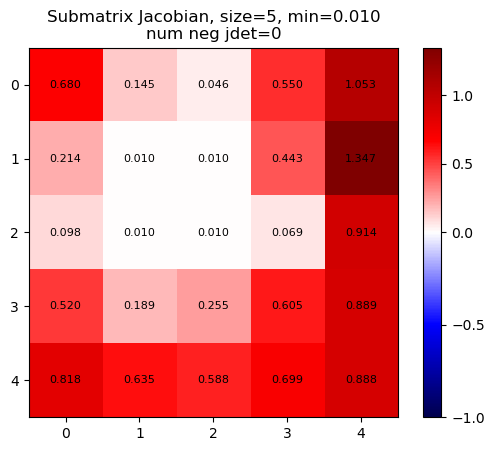

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


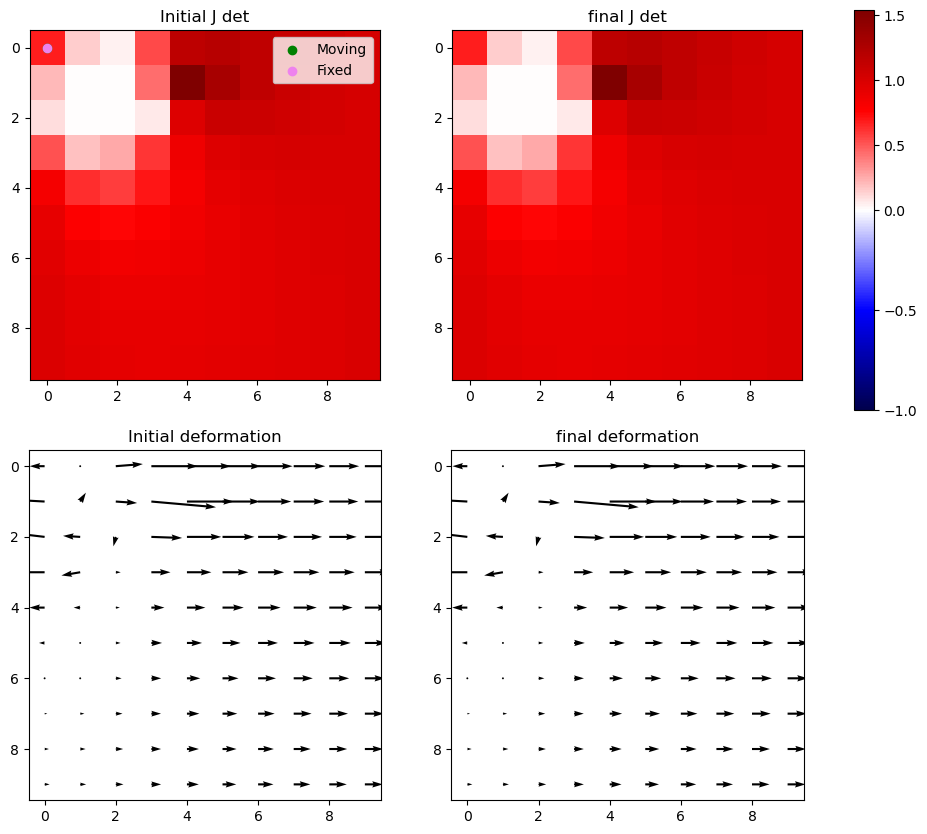

Iter 18: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


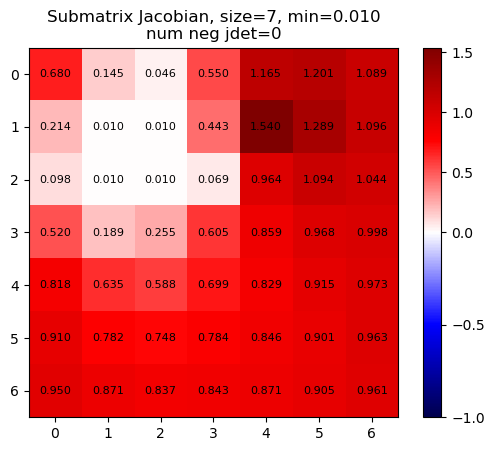

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


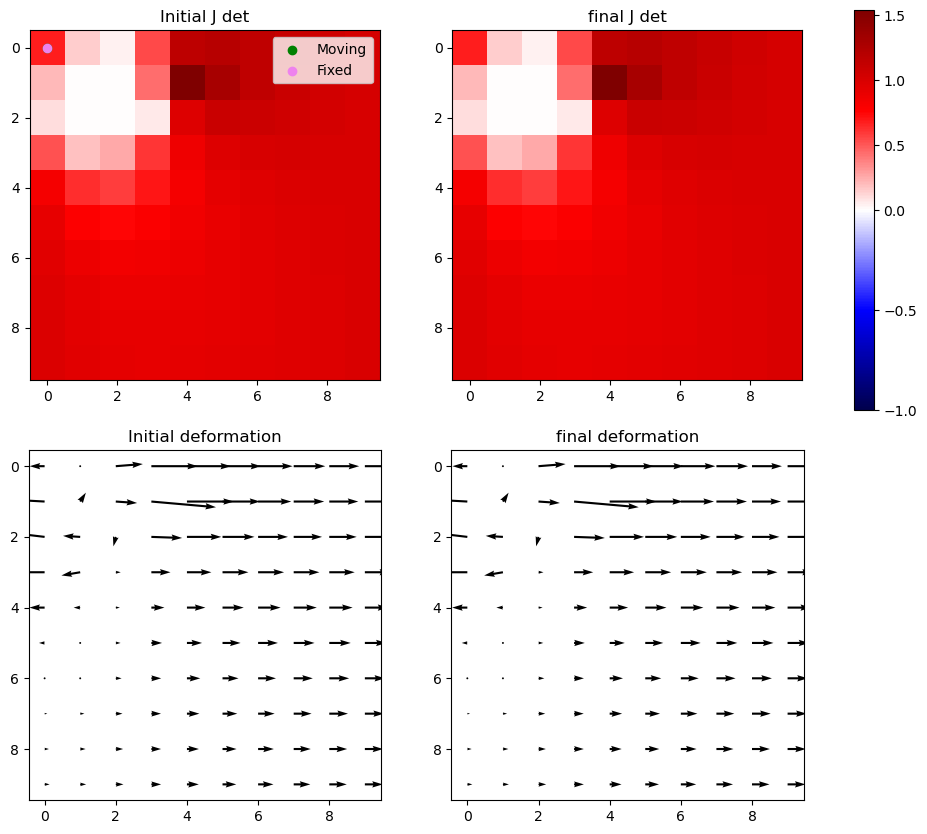

Iter 18: For index (2, 1), window size increased to 9 at iter 3


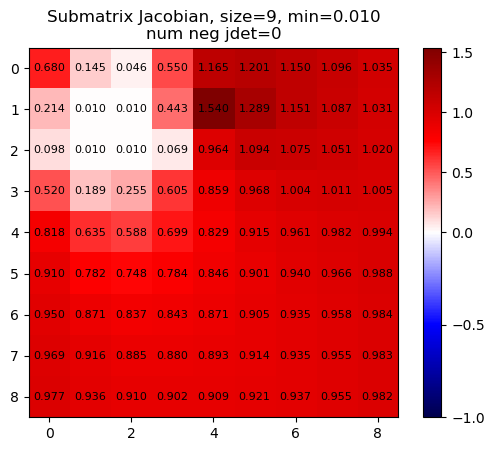

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


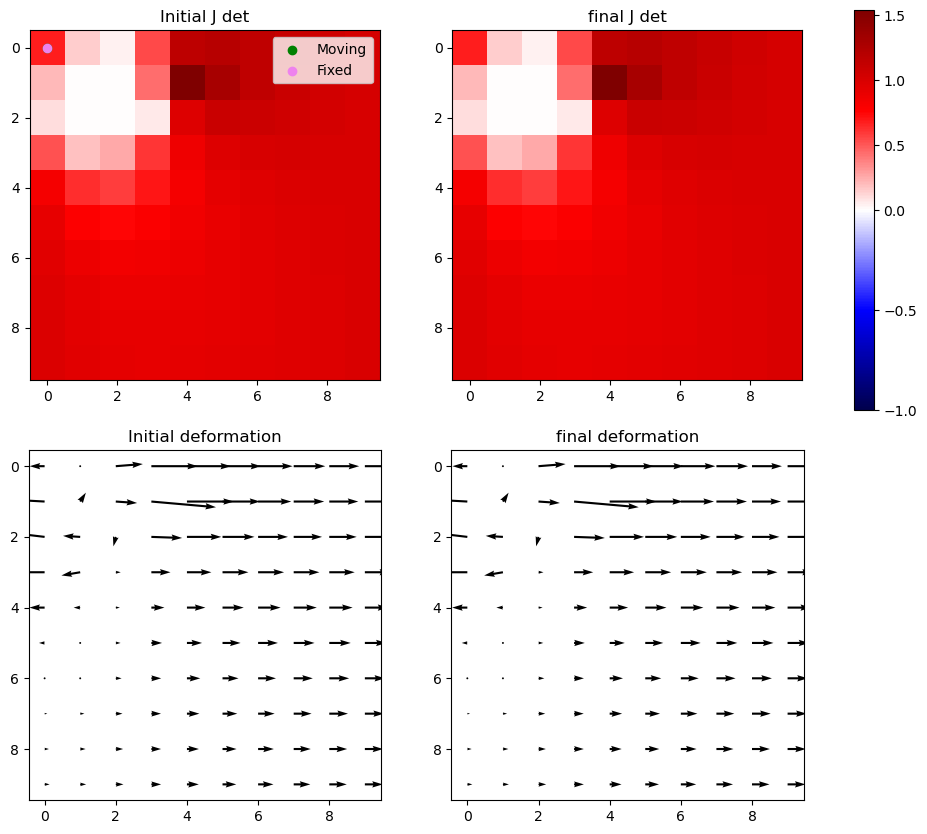

Iter 18 with 0 -ve jacs



Iter 19: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


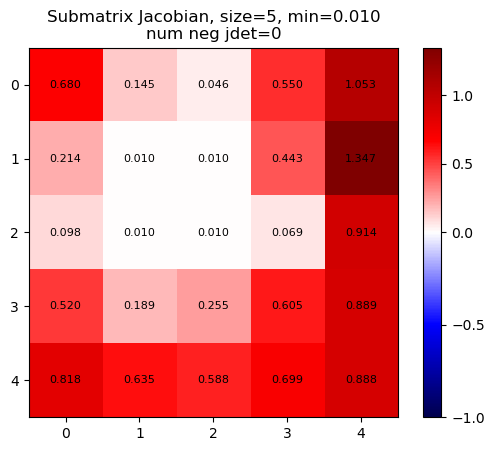

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


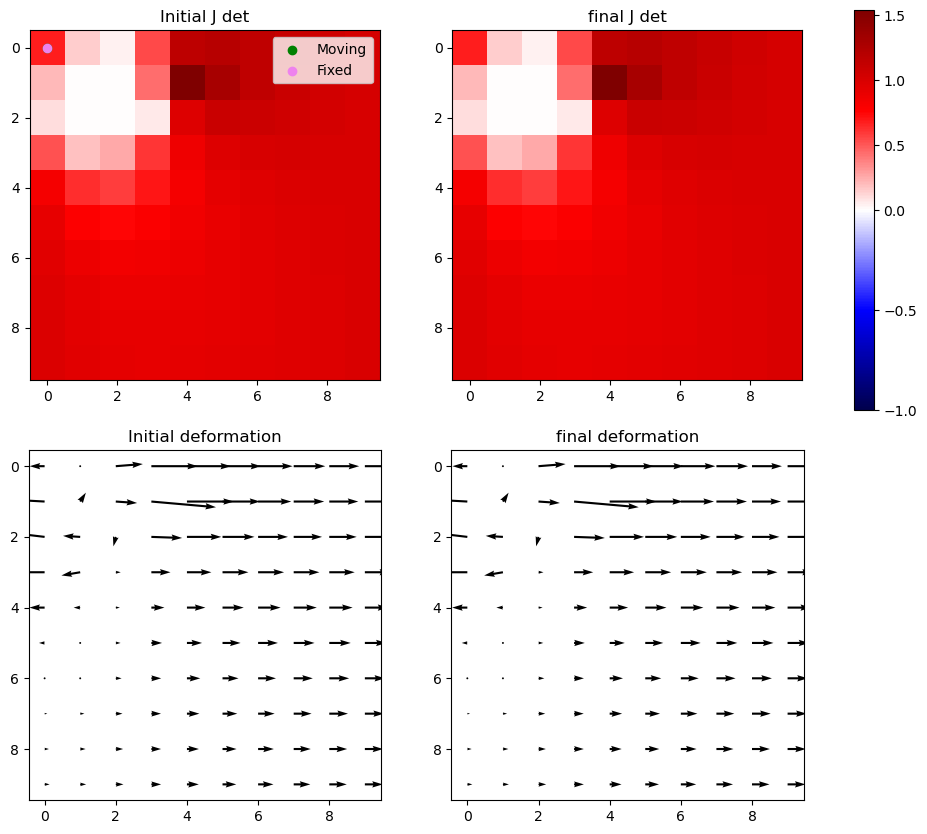

Iter 19: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


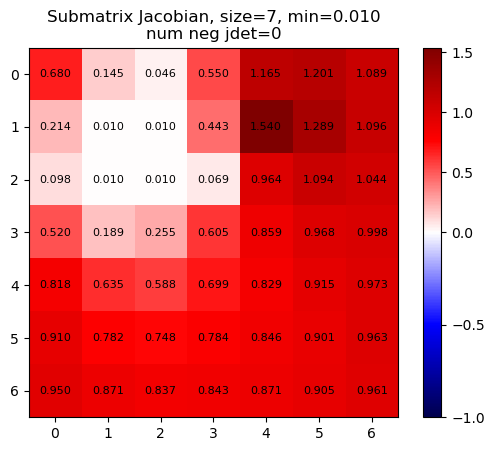

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


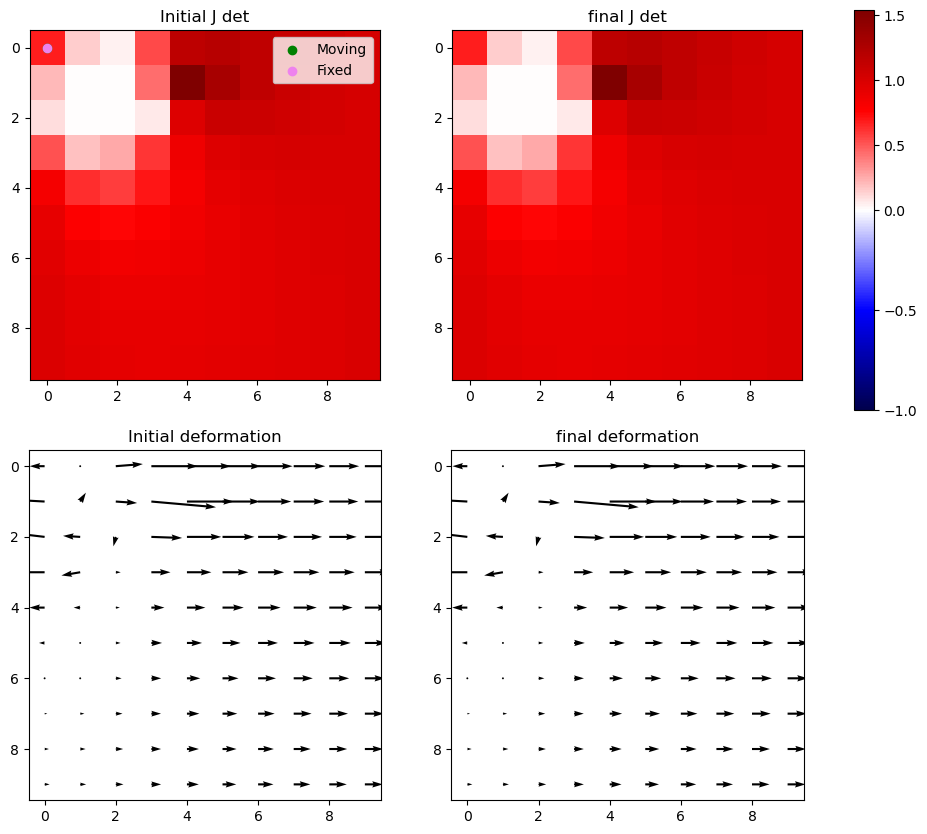

Iter 19: For index (2, 1), window size increased to 9 at iter 3


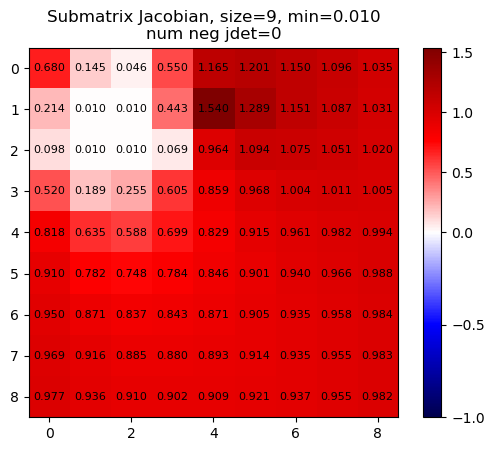

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


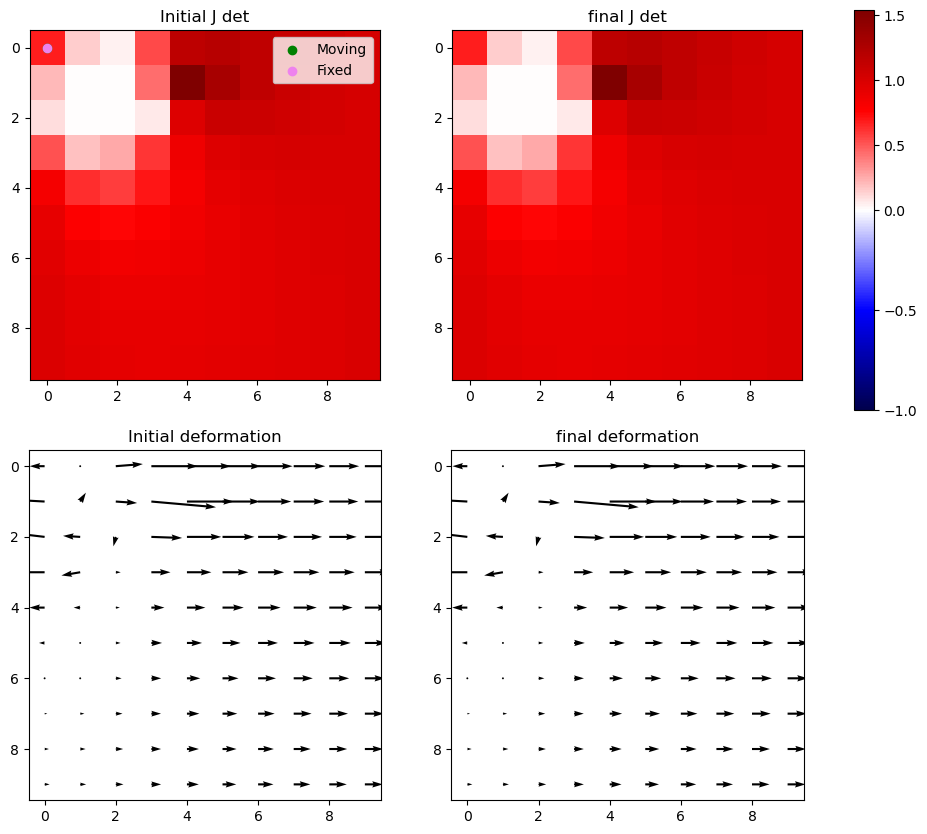

Iter 19 with 0 -ve jacs



Iter 20: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


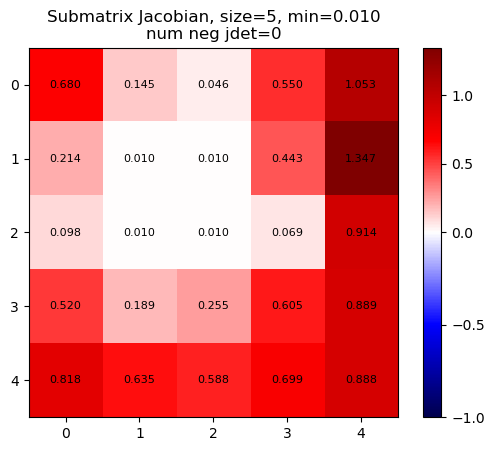

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


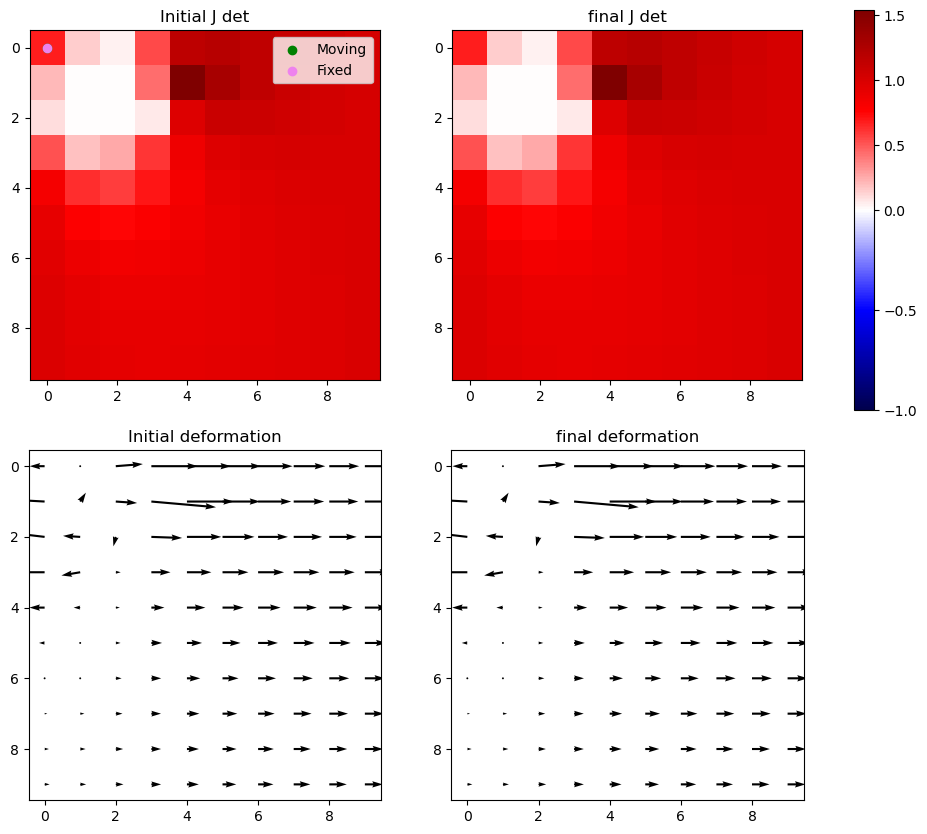

Iter 20: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


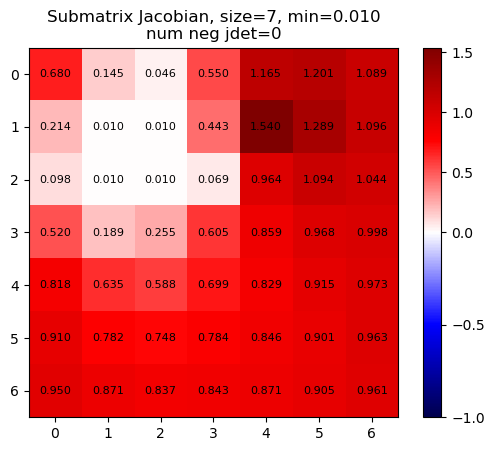

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


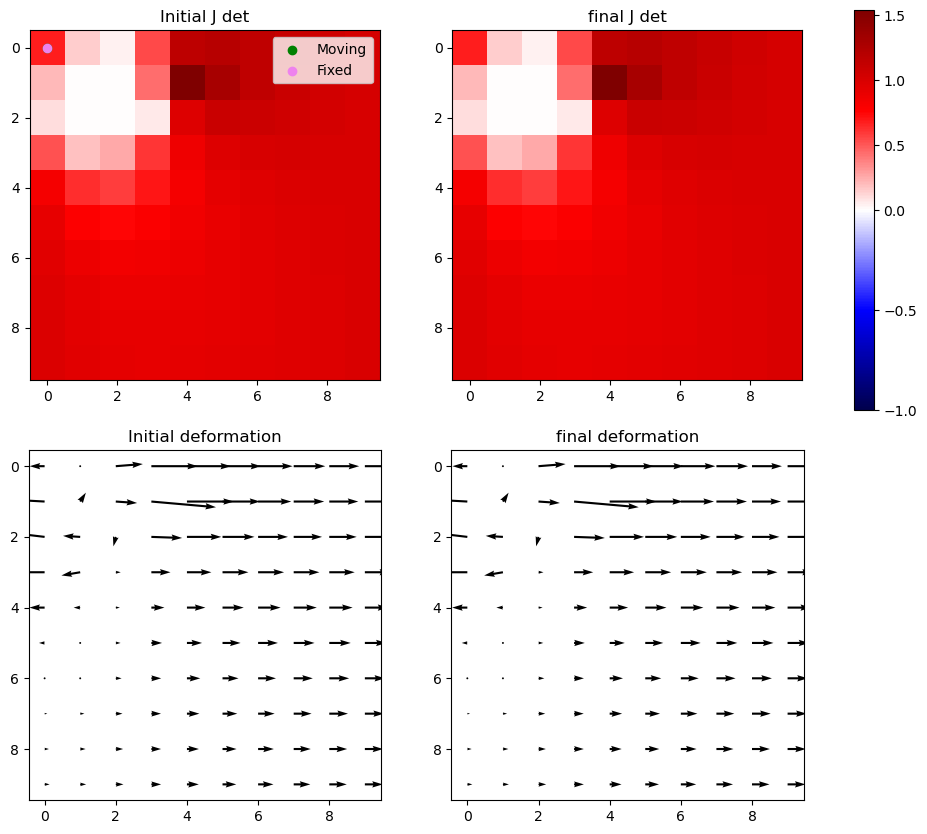

Iter 20: For index (2, 1), window size increased to 9 at iter 3


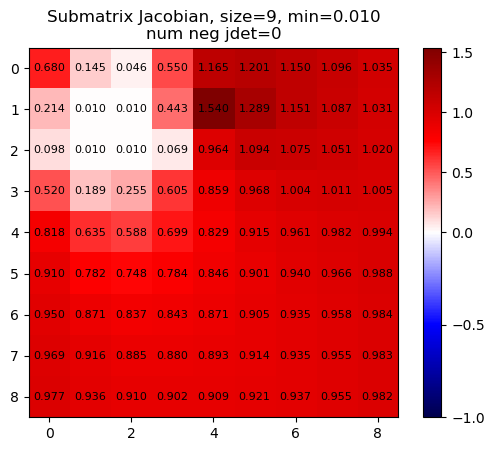

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


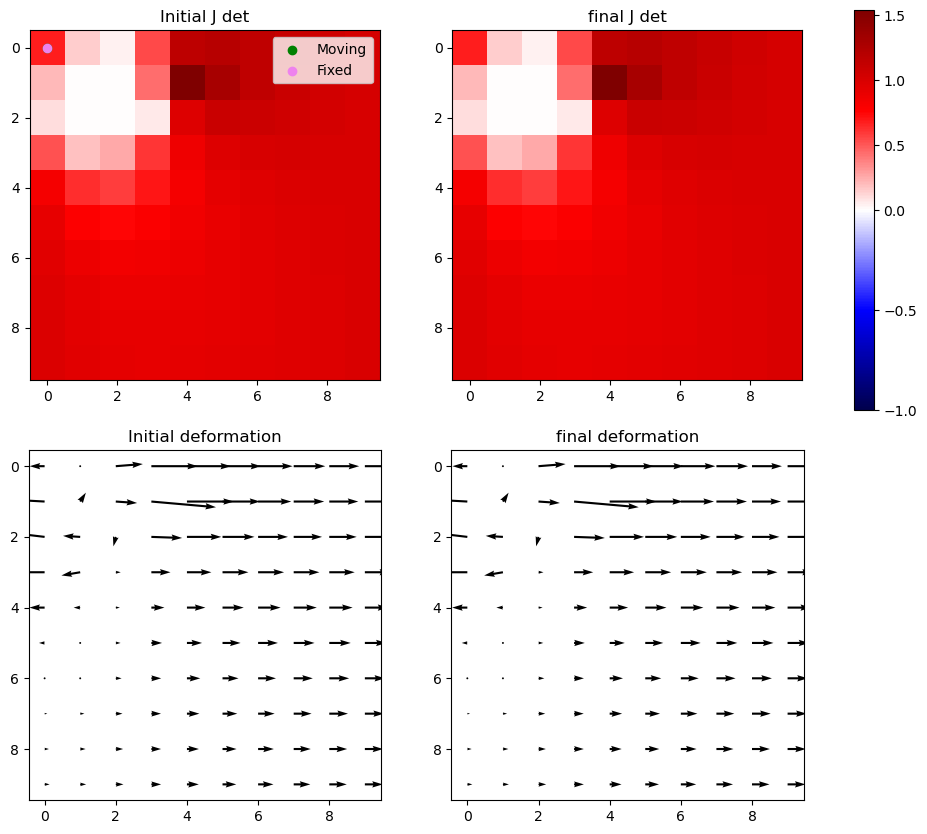

Iter 20 with 0 -ve jacs



Iter 21: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


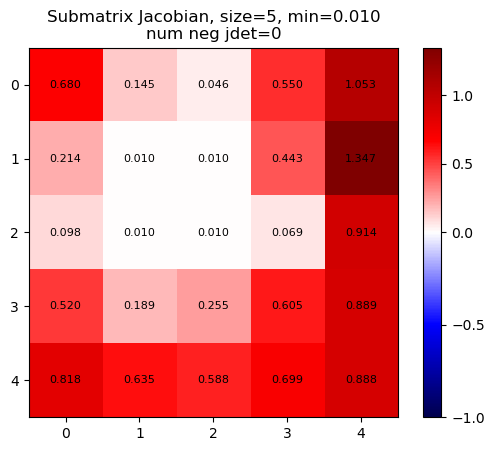

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


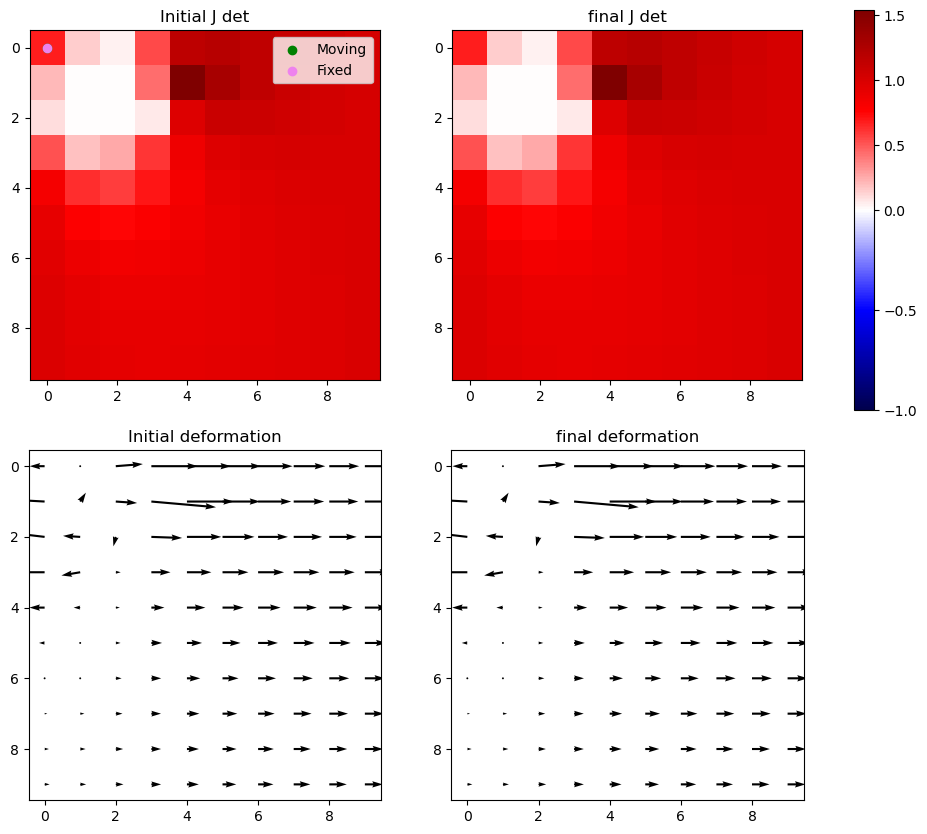

Iter 21: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


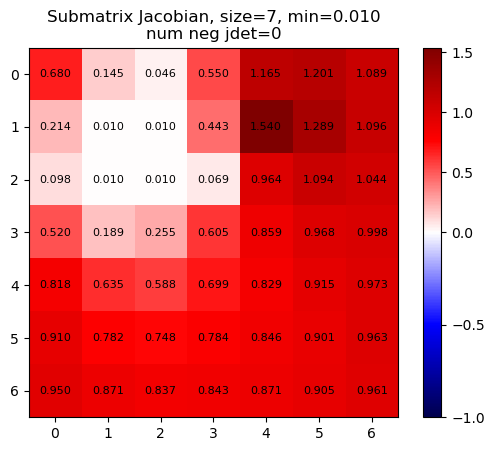

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


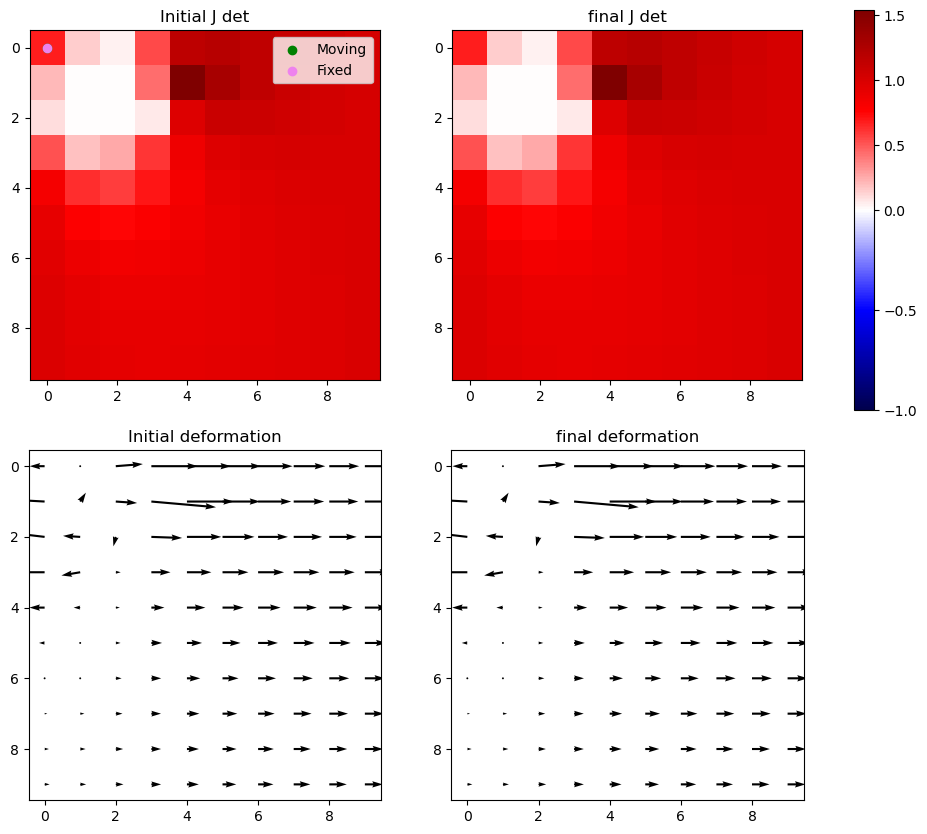

Iter 21: For index (2, 1), window size increased to 9 at iter 3


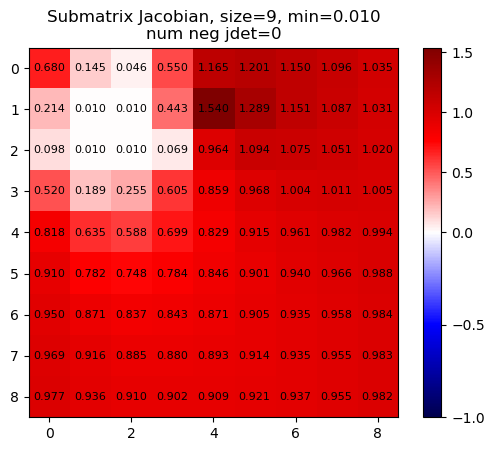

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


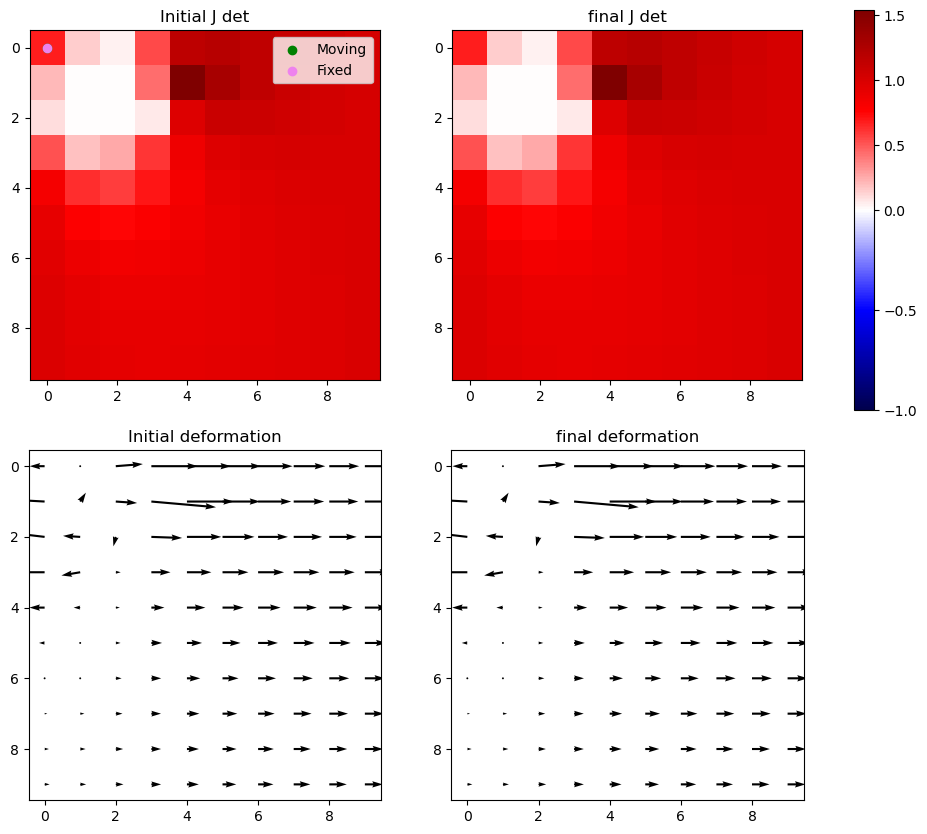

Iter 21 with 0 -ve jacs



Iter 22: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


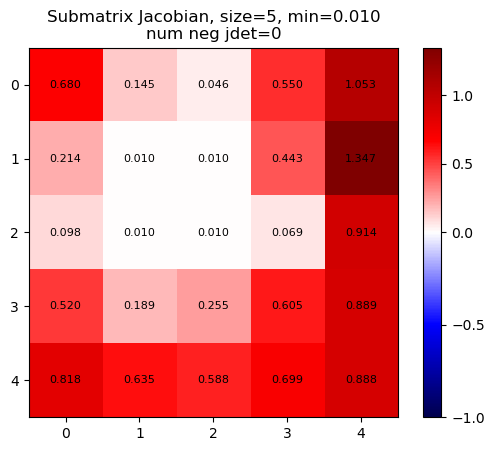

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


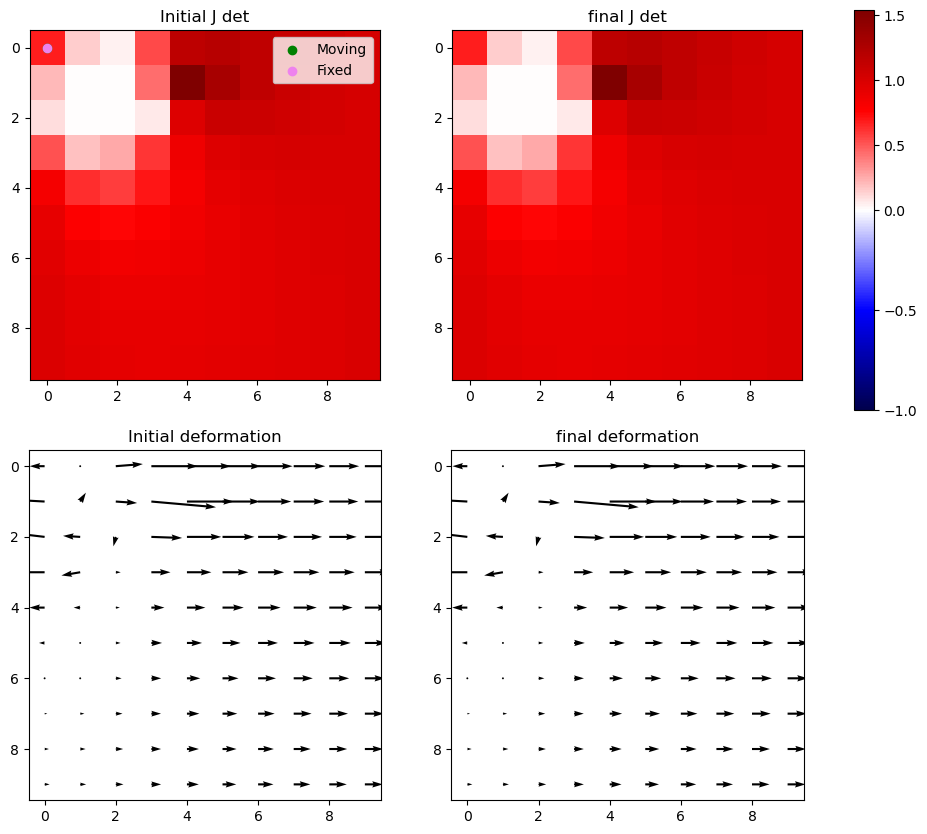

Iter 22: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


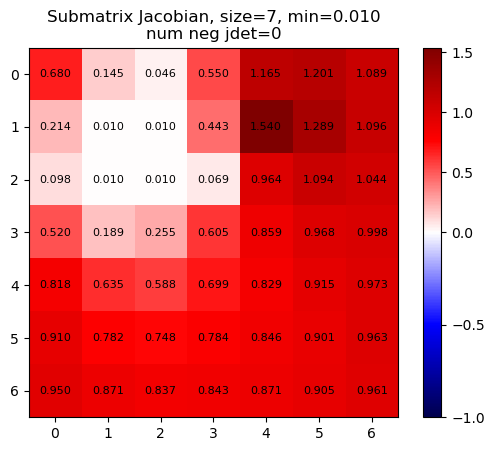

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


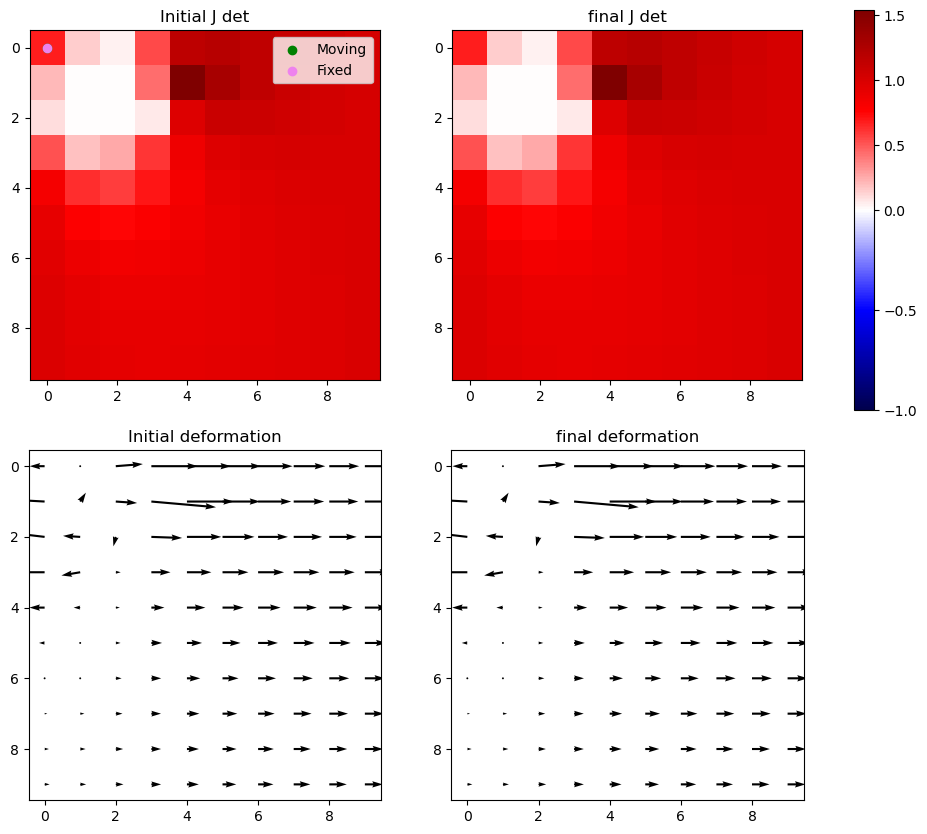

Iter 22: For index (2, 1), window size increased to 9 at iter 3


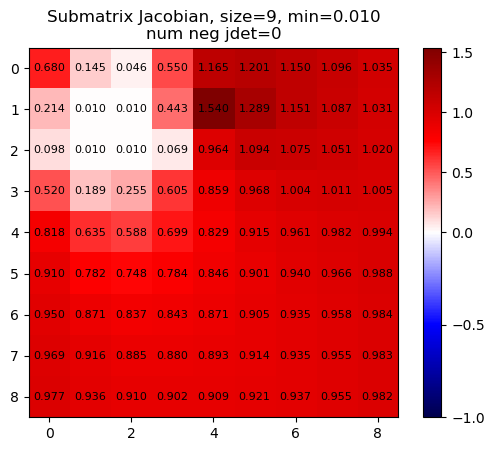

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


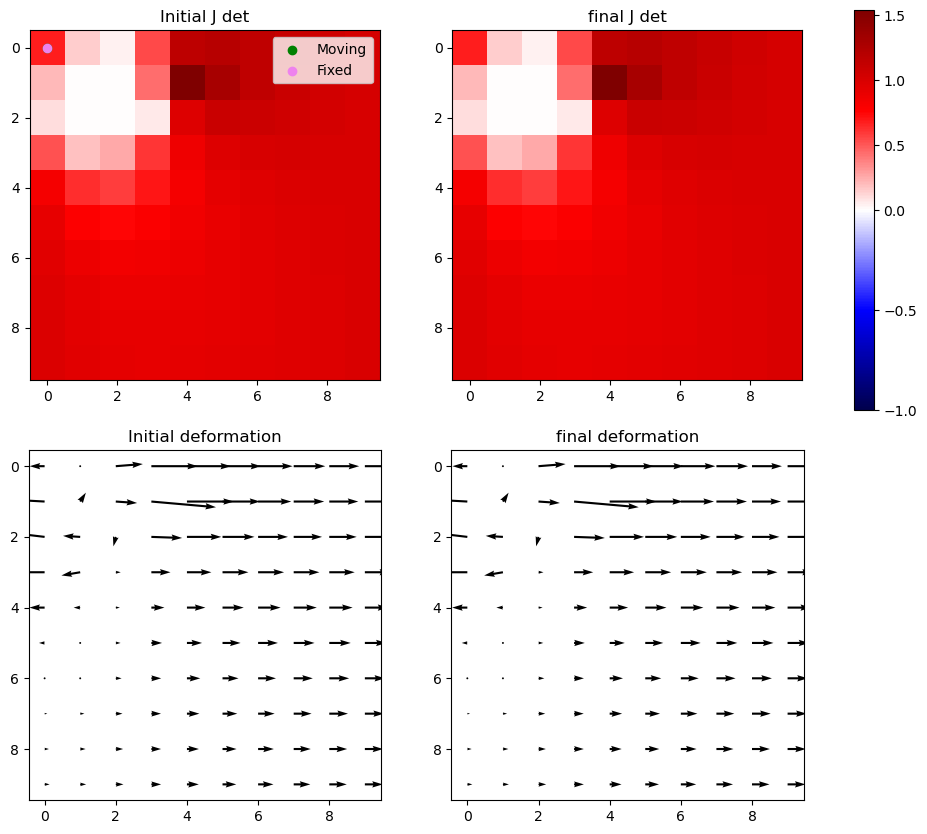

Iter 22 with 0 -ve jacs



Iter 23: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


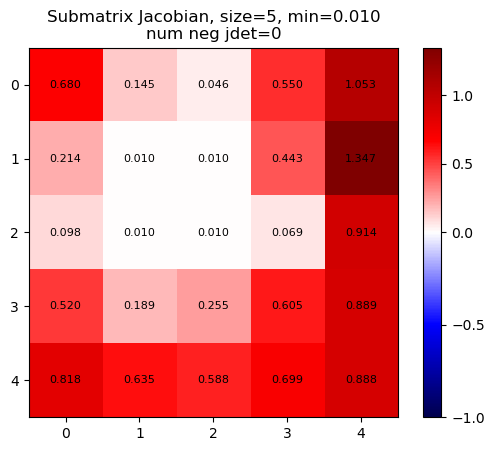

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


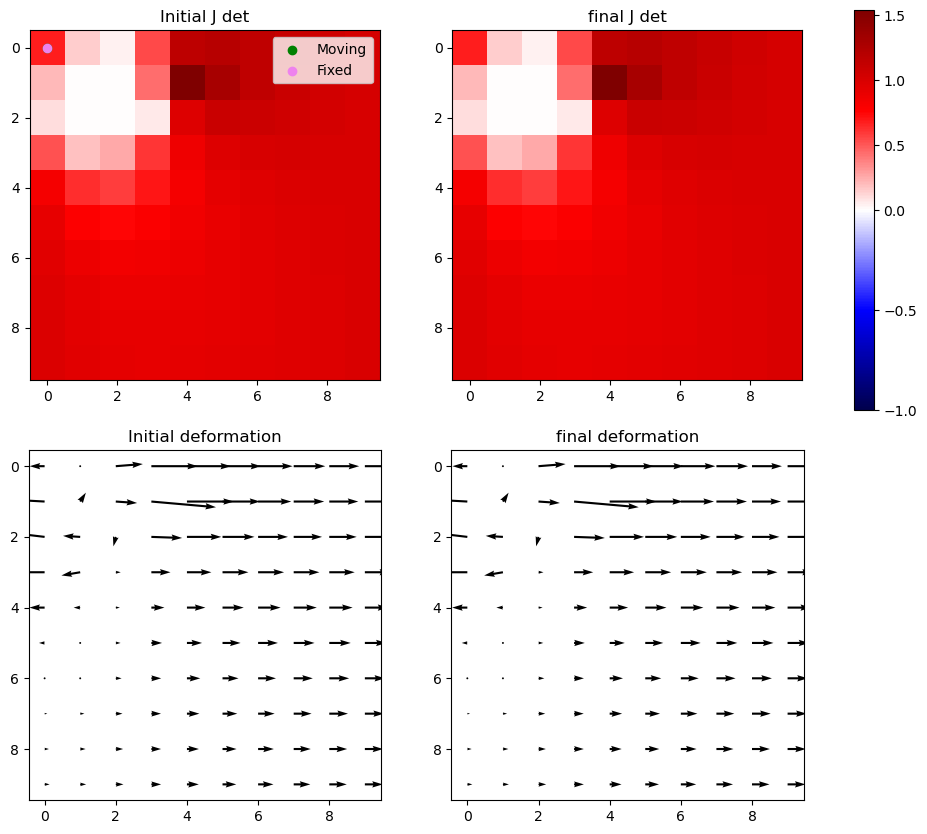

Iter 23: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


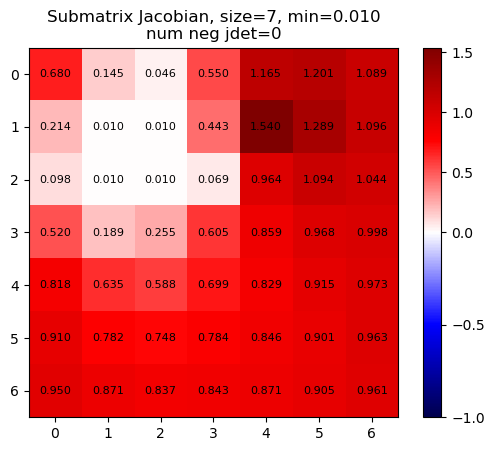

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


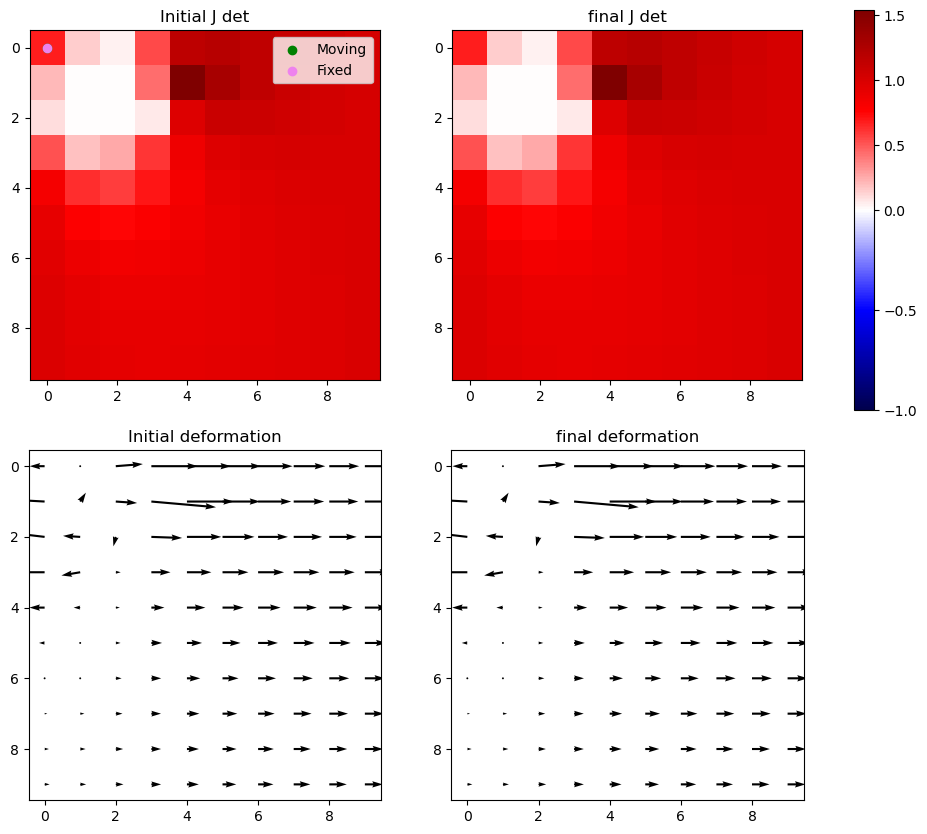

Iter 23: For index (2, 1), window size increased to 9 at iter 3


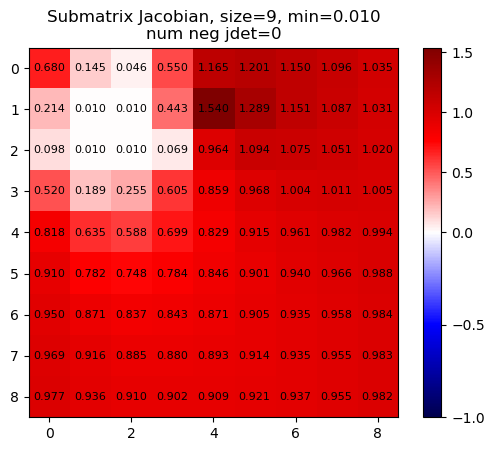

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


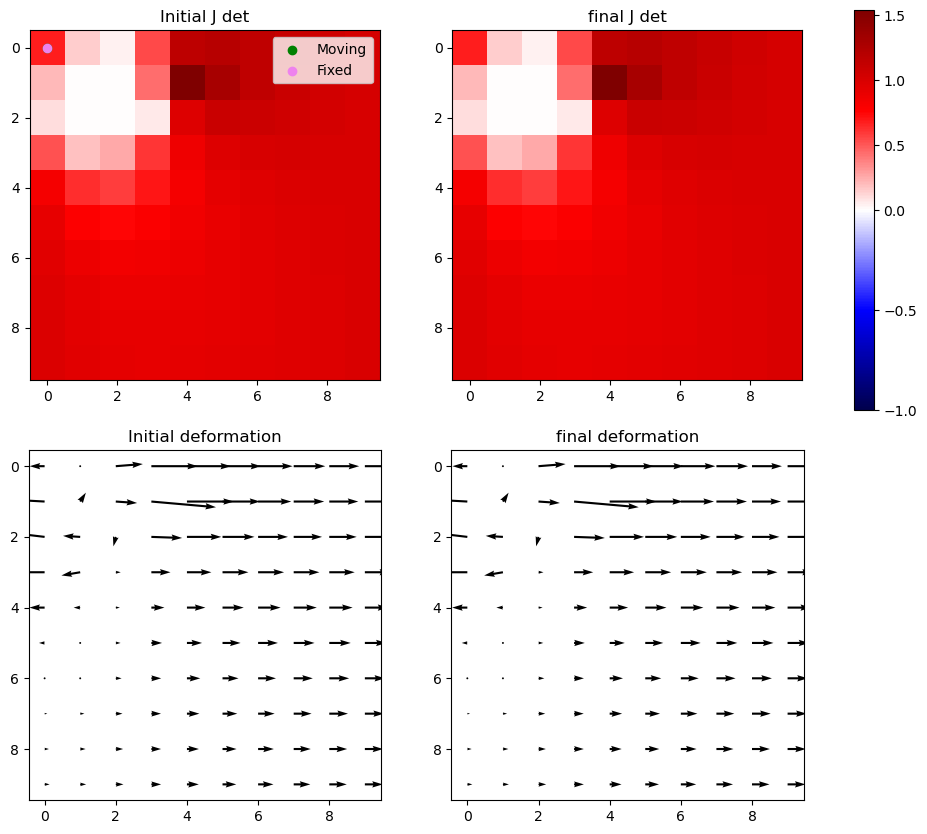

Iter 23 with 0 -ve jacs



Iter 24: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


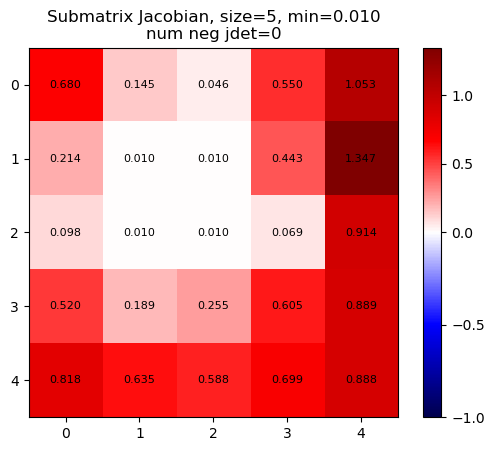

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


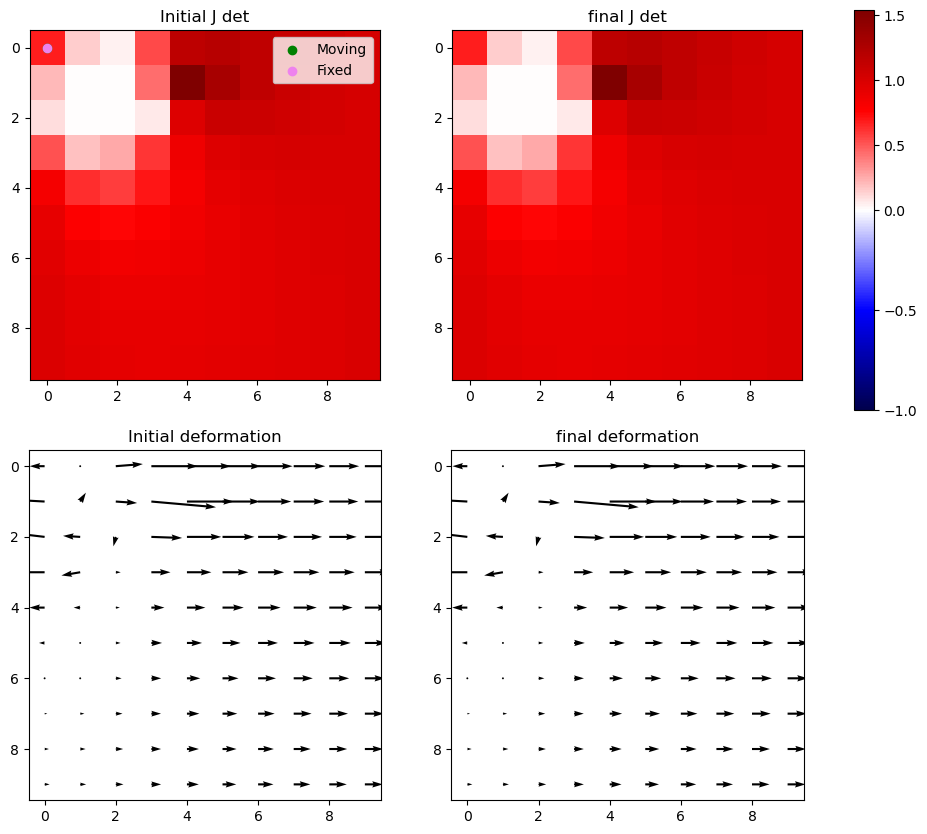

Iter 24: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


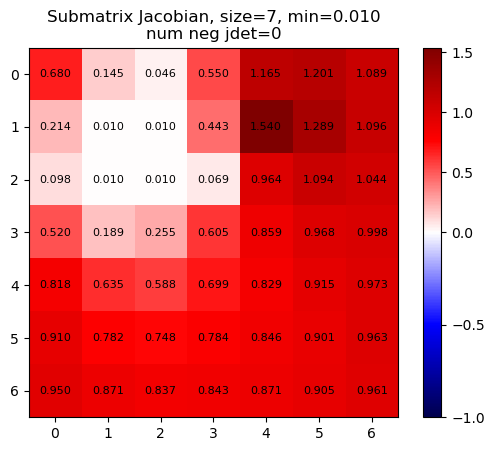

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


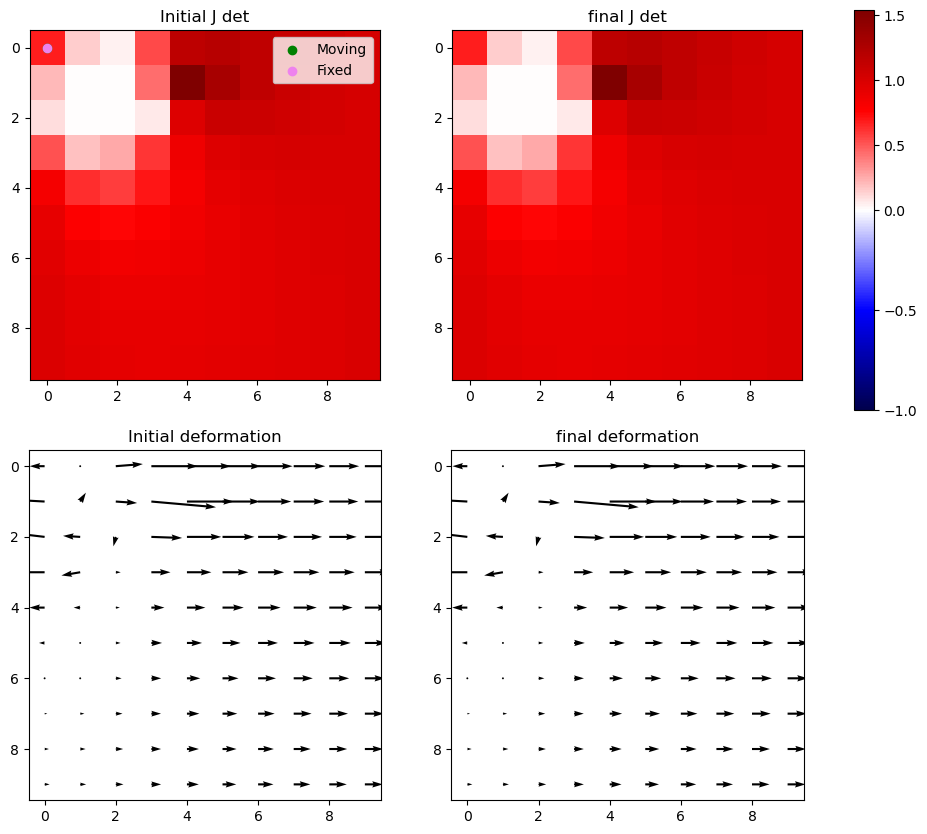

Iter 24: For index (2, 1), window size increased to 9 at iter 3


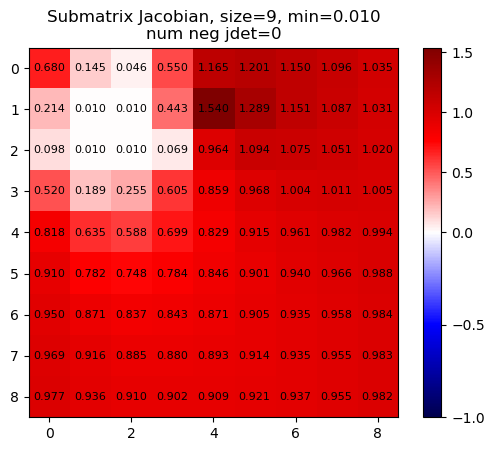

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


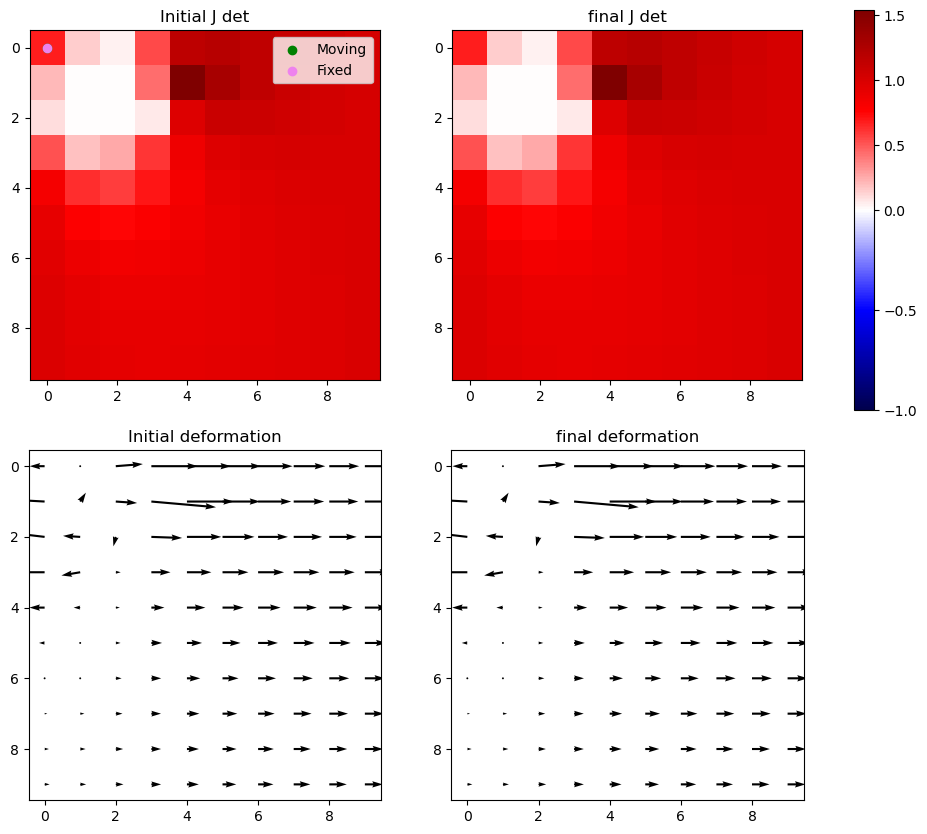

Iter 24 with 0 -ve jacs



Iter 25: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


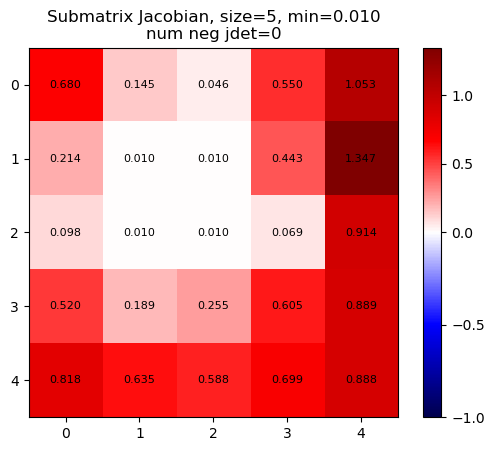

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


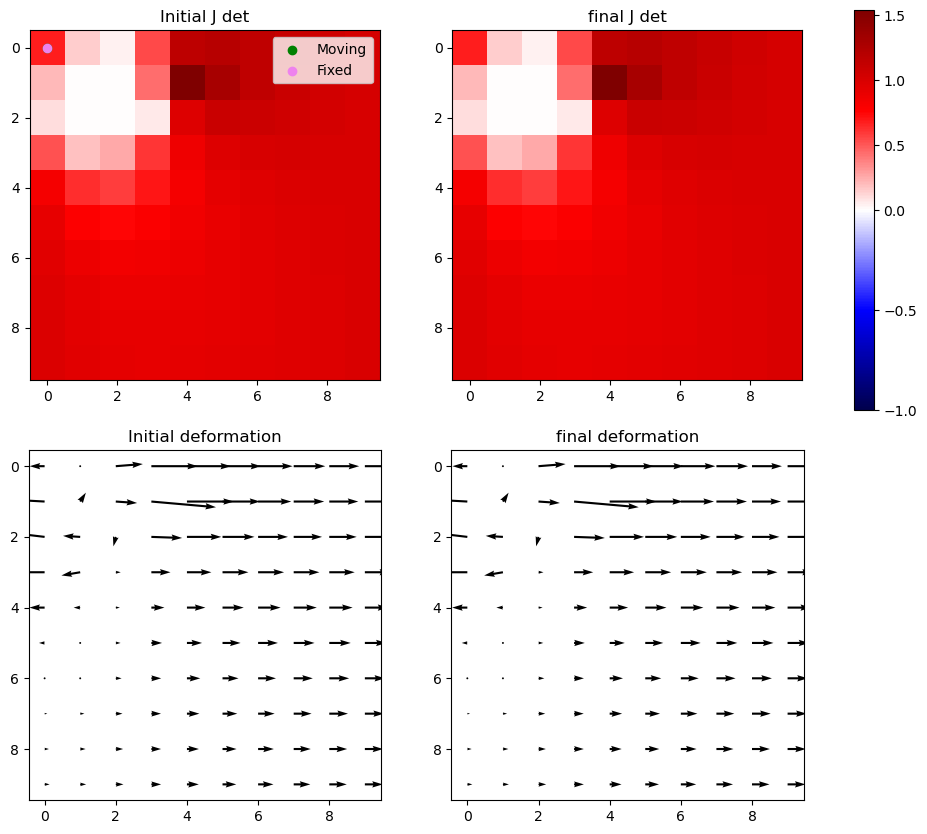

Iter 25: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


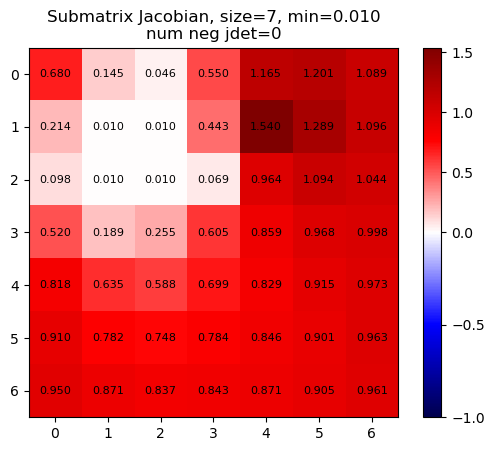

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


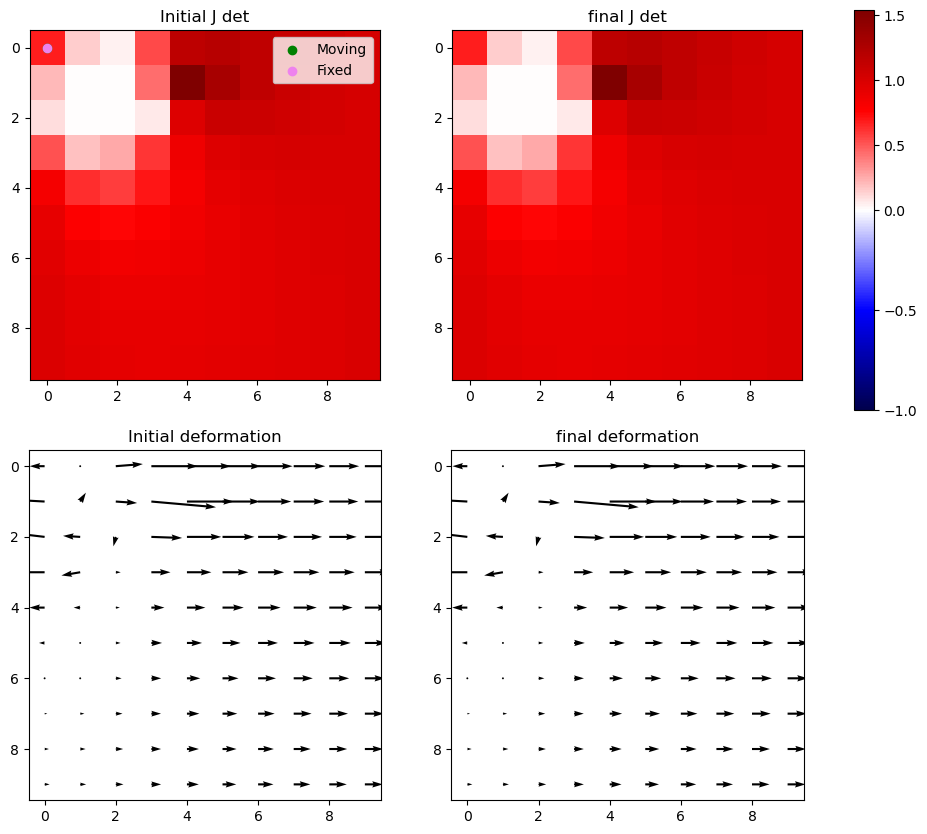

Iter 25: For index (2, 1), window size increased to 9 at iter 3


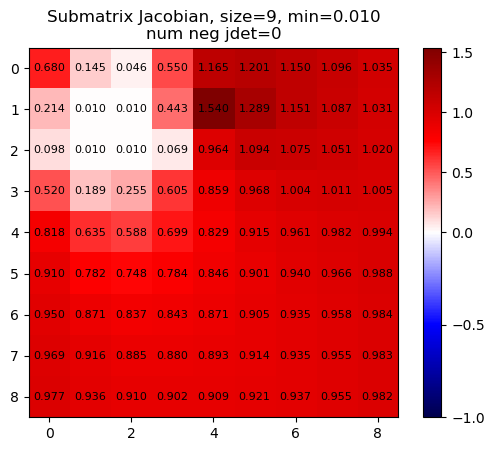

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


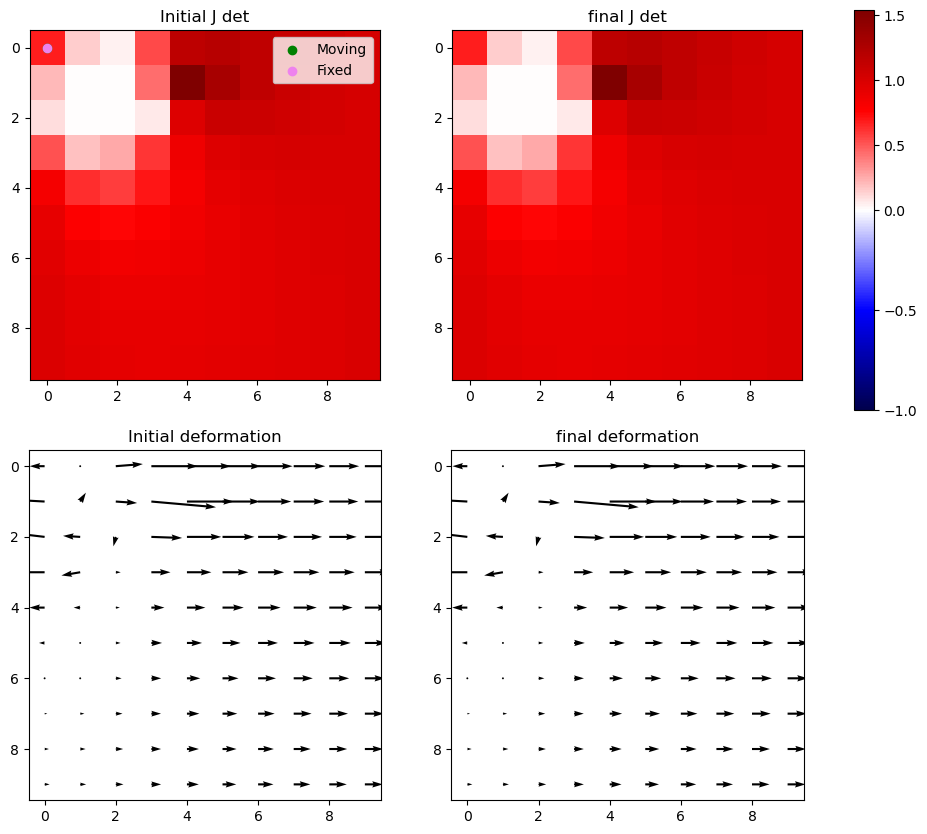

Iter 25 with 0 -ve jacs



Iter 26: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


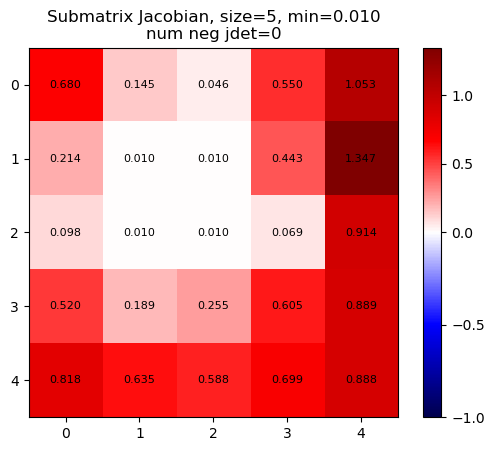

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


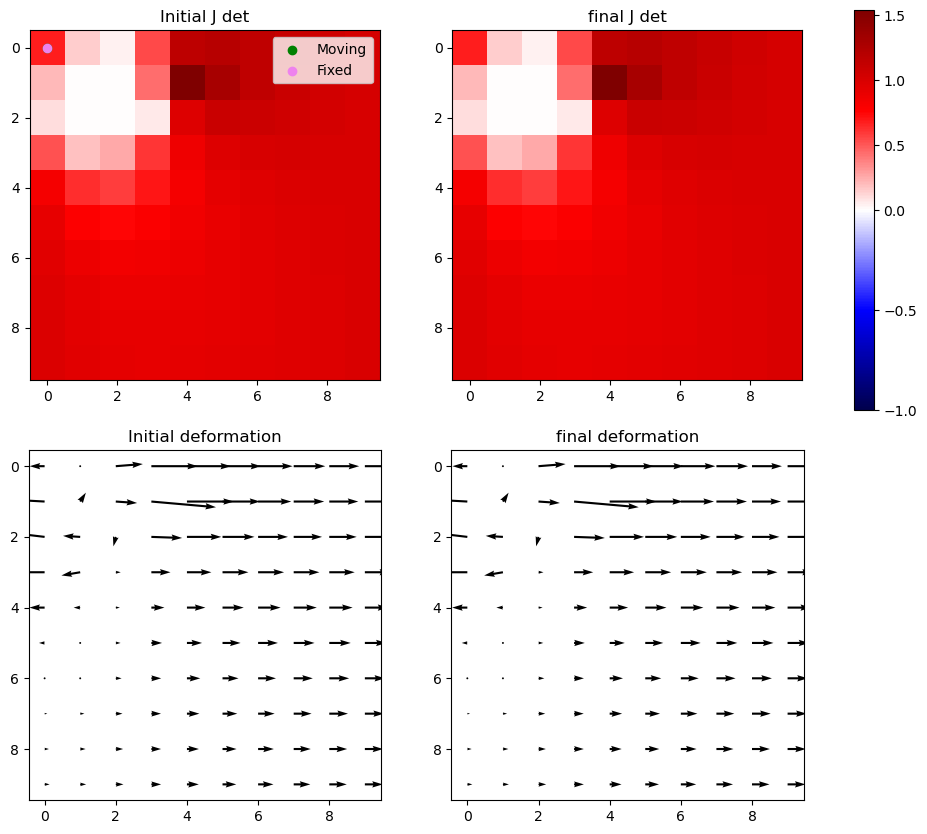

Iter 26: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


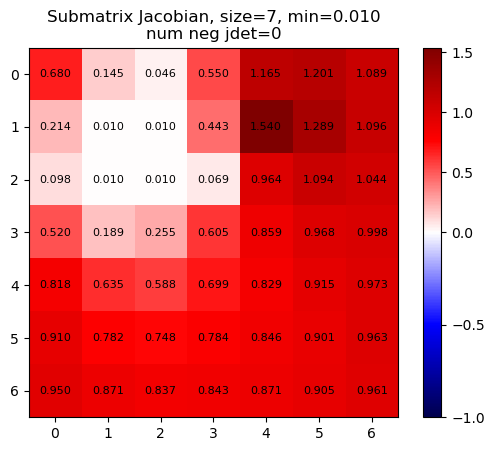

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


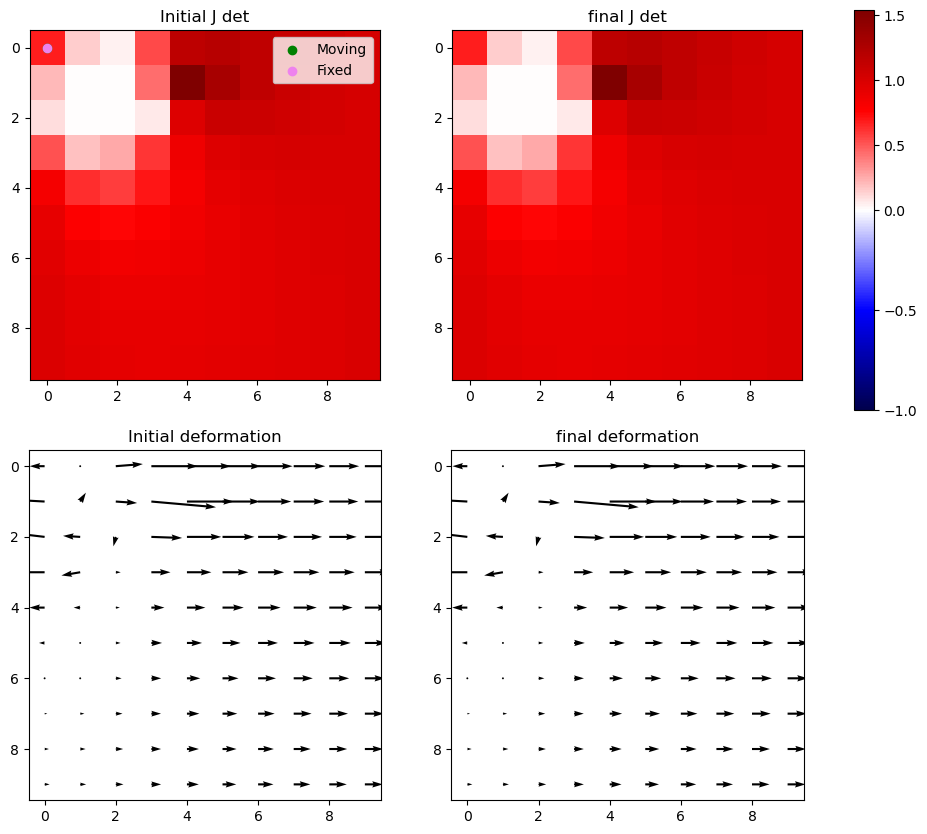

Iter 26: For index (2, 1), window size increased to 9 at iter 3


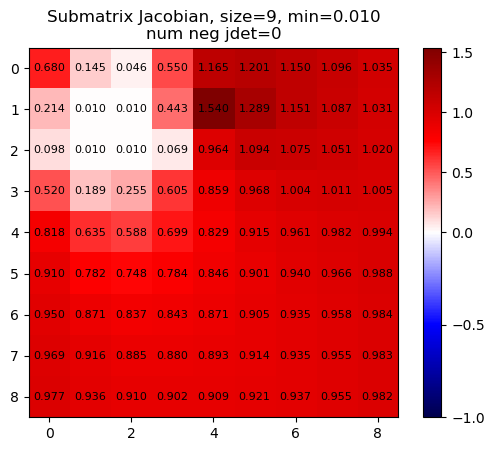

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


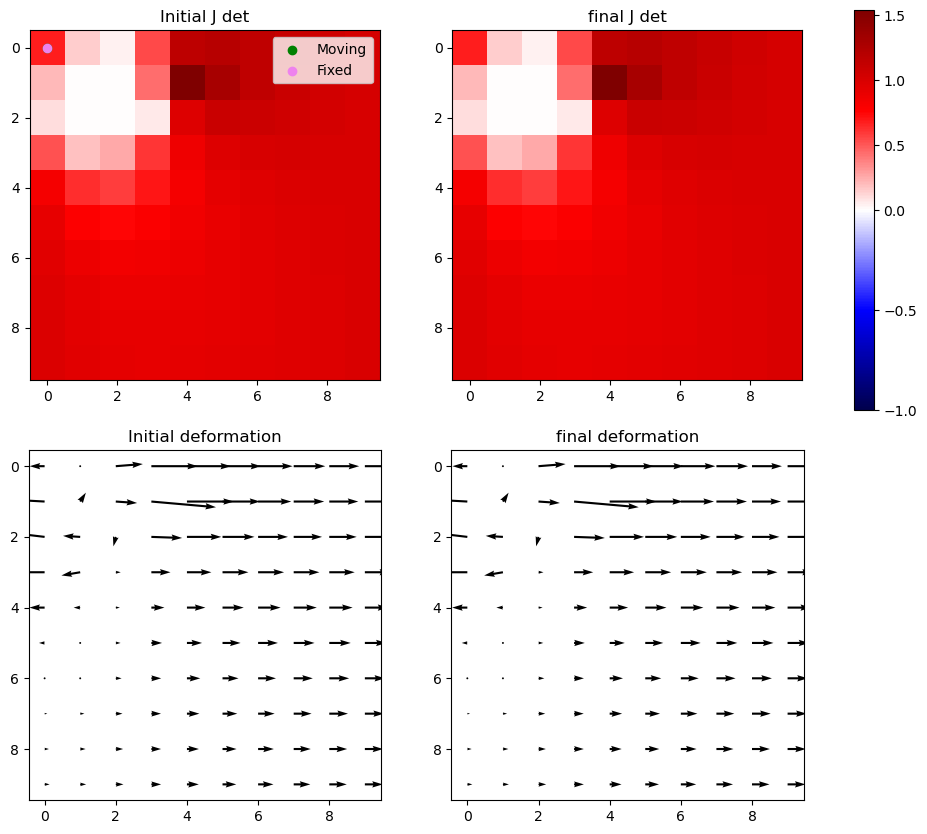

Iter 26 with 0 -ve jacs



Iter 27: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


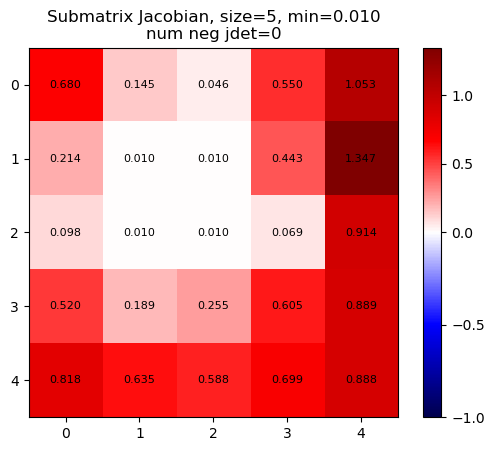

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


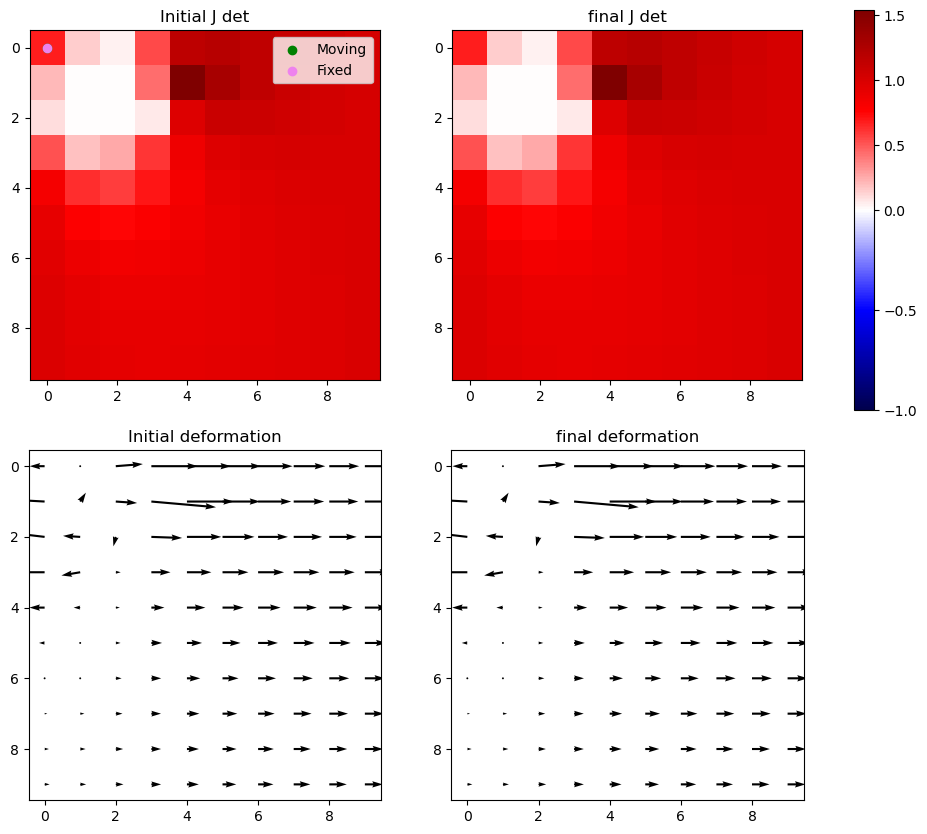

Iter 27: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


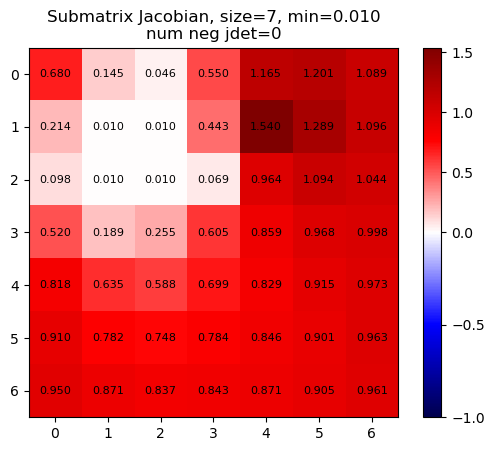

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


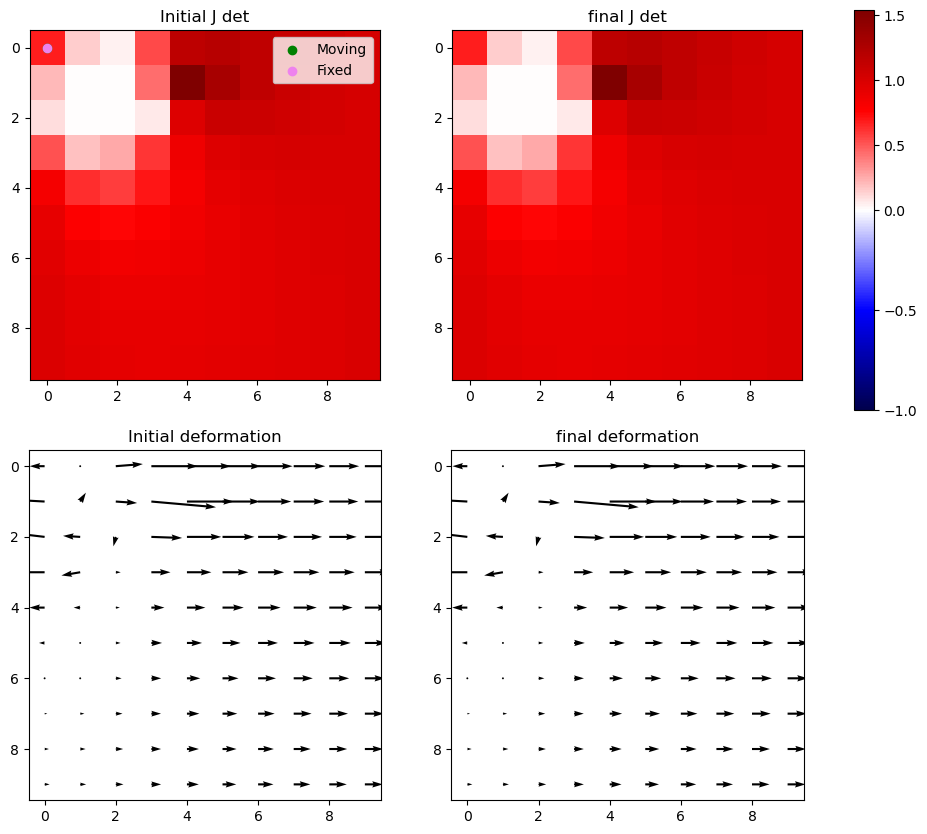

Iter 27: For index (2, 1), window size increased to 9 at iter 3


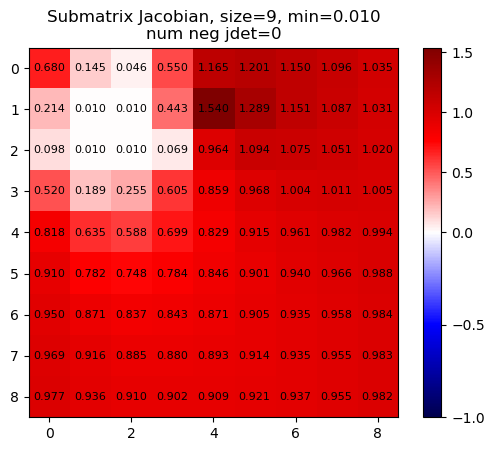

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


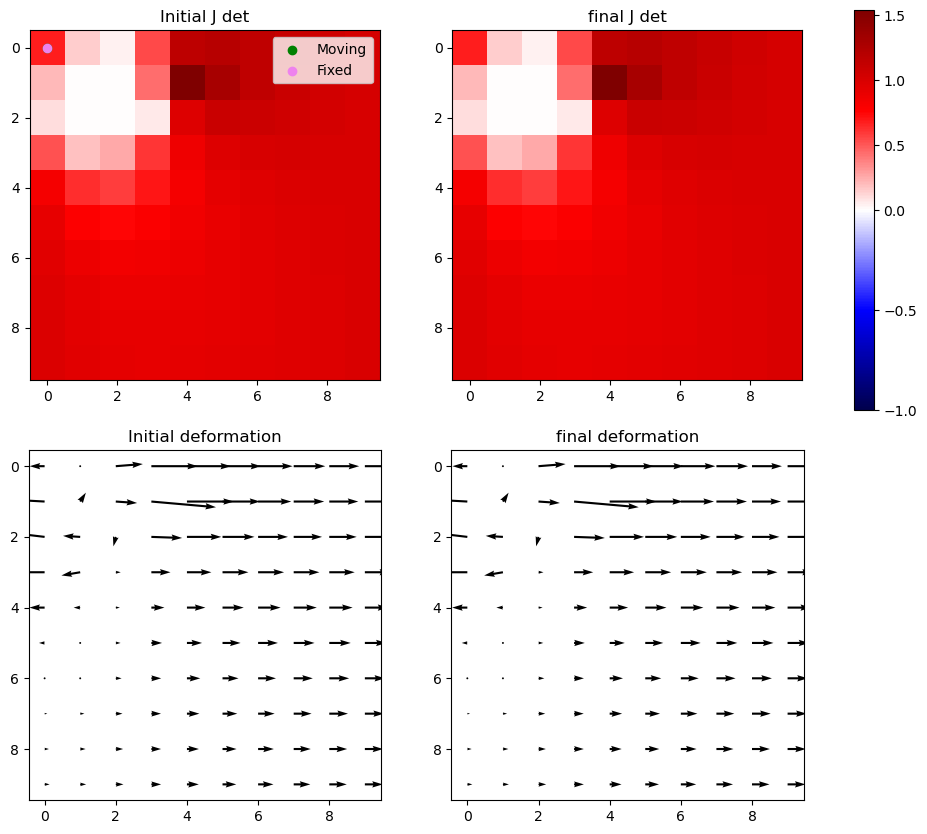

Iter 27 with 0 -ve jacs



Iter 28: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


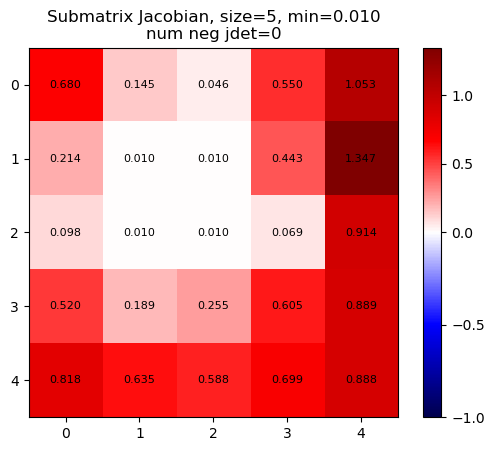

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


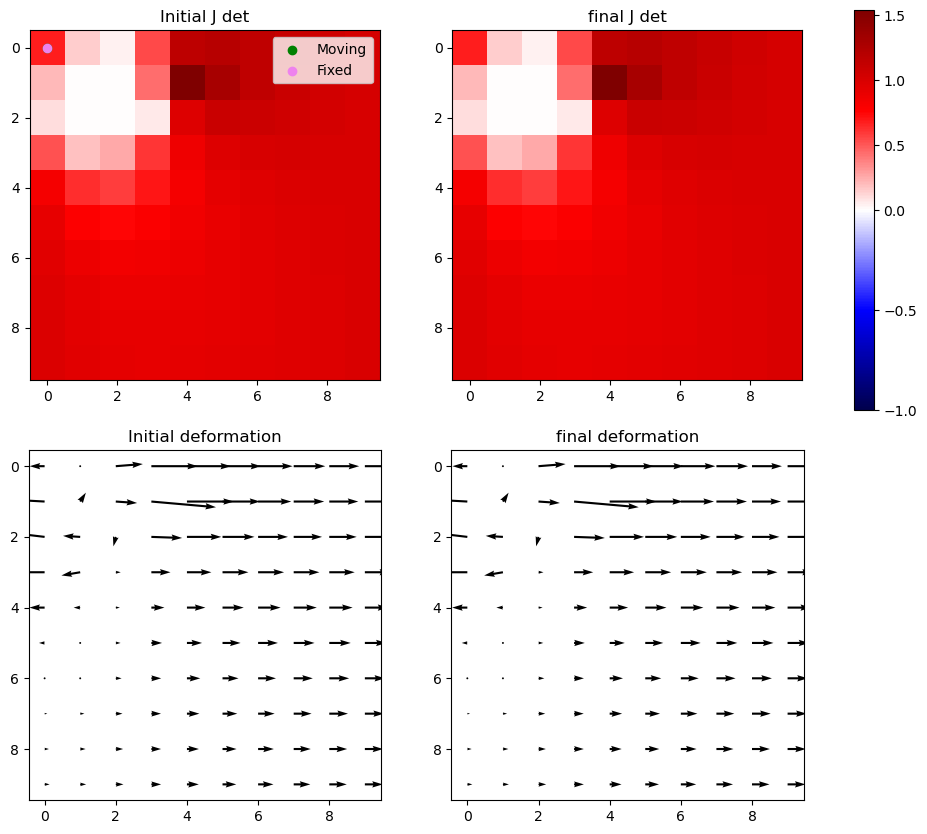

Iter 28: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


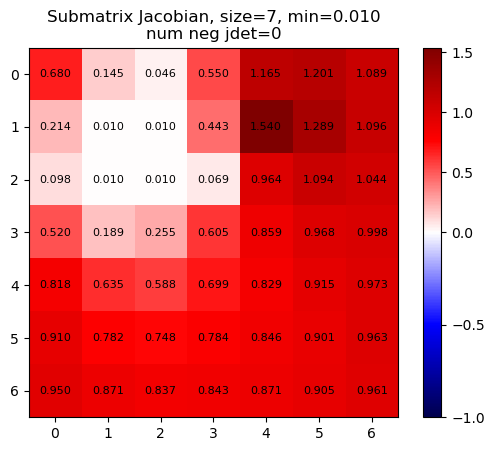

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


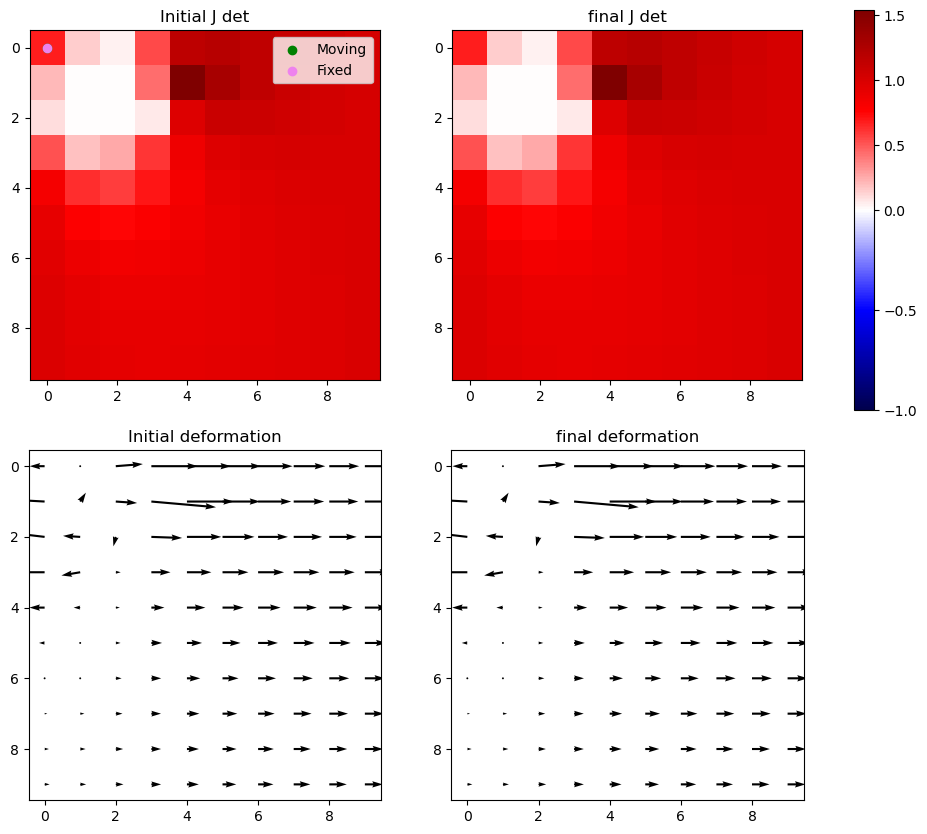

Iter 28: For index (2, 1), window size increased to 9 at iter 3


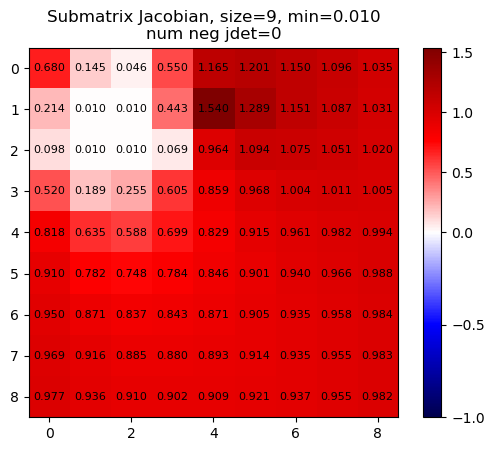

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


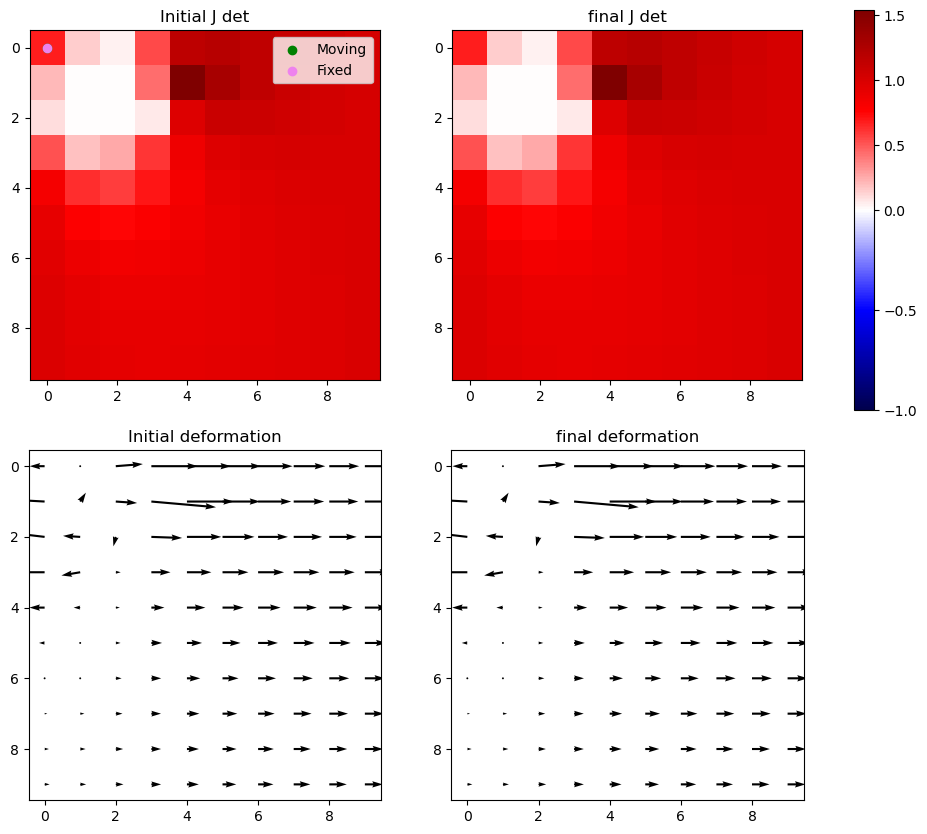

Iter 28 with 0 -ve jacs



Iter 29: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


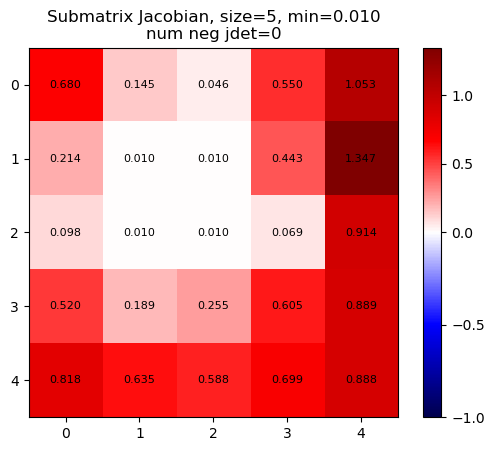

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


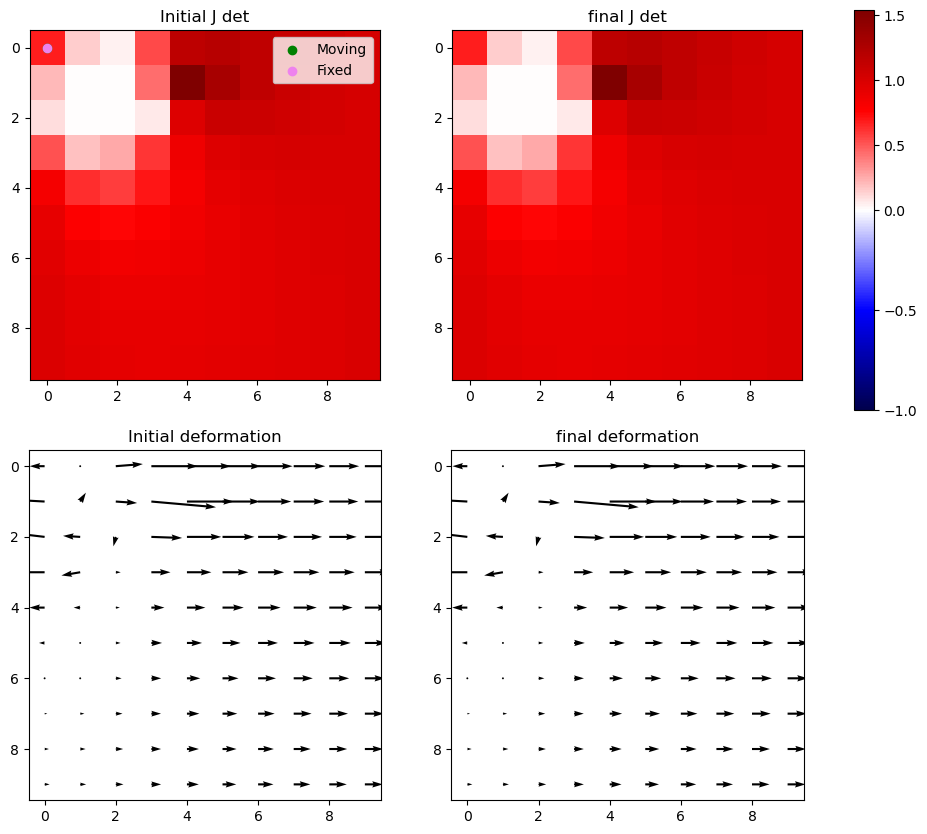

Iter 29: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


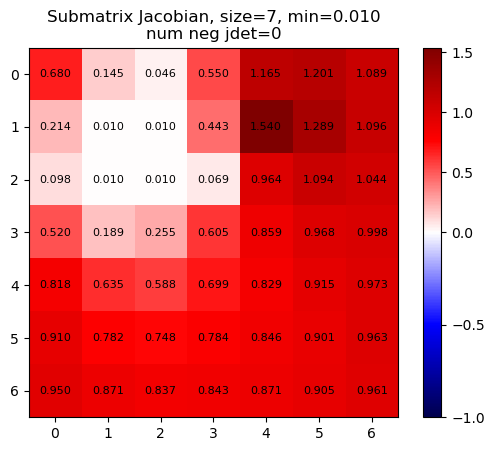

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


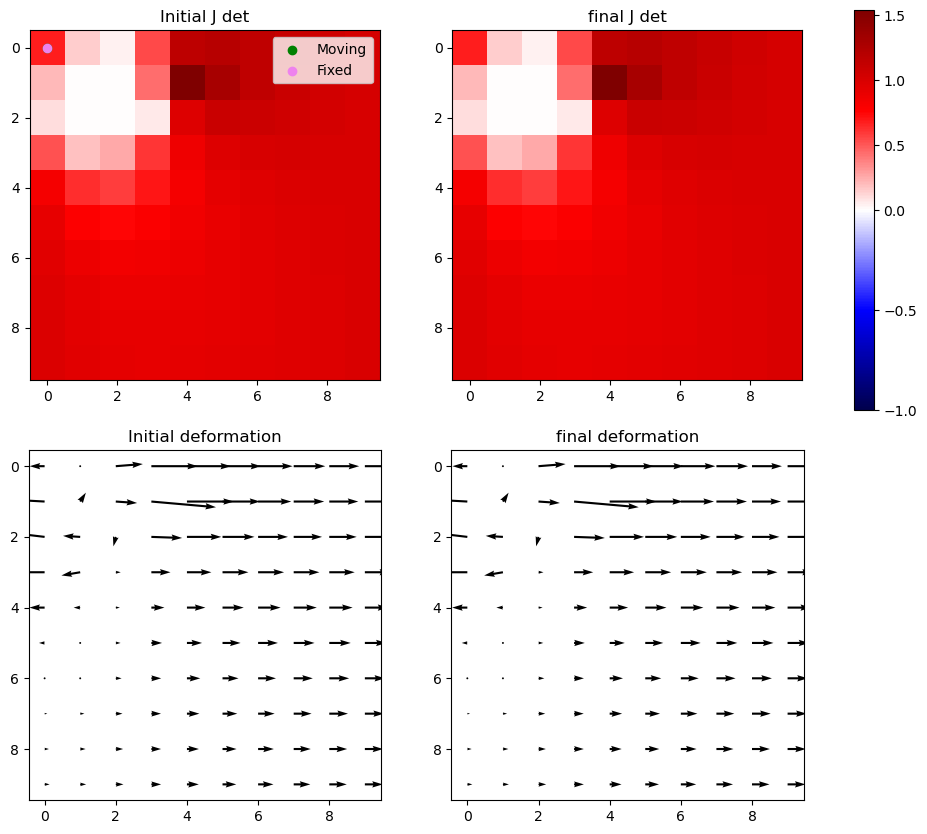

Iter 29: For index (2, 1), window size increased to 9 at iter 3


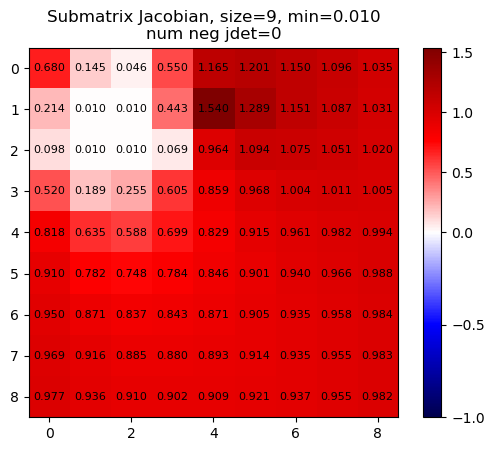

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


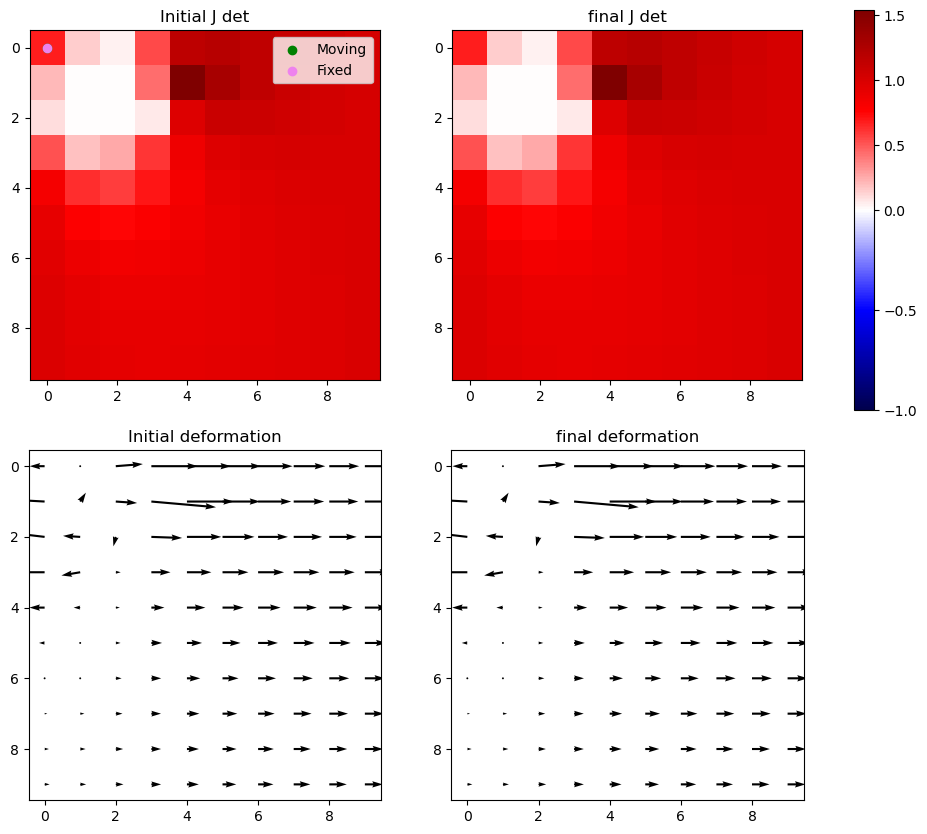

Iter 29 with 0 -ve jacs



Iter 30: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


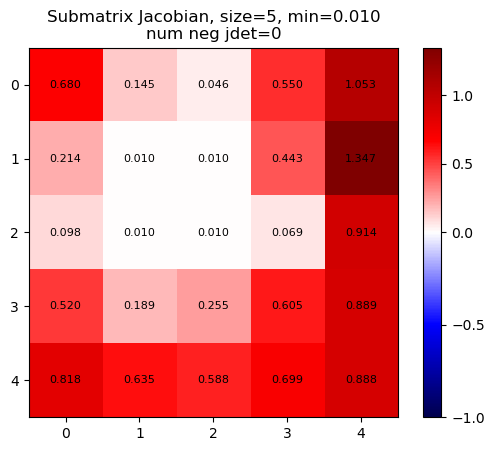

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


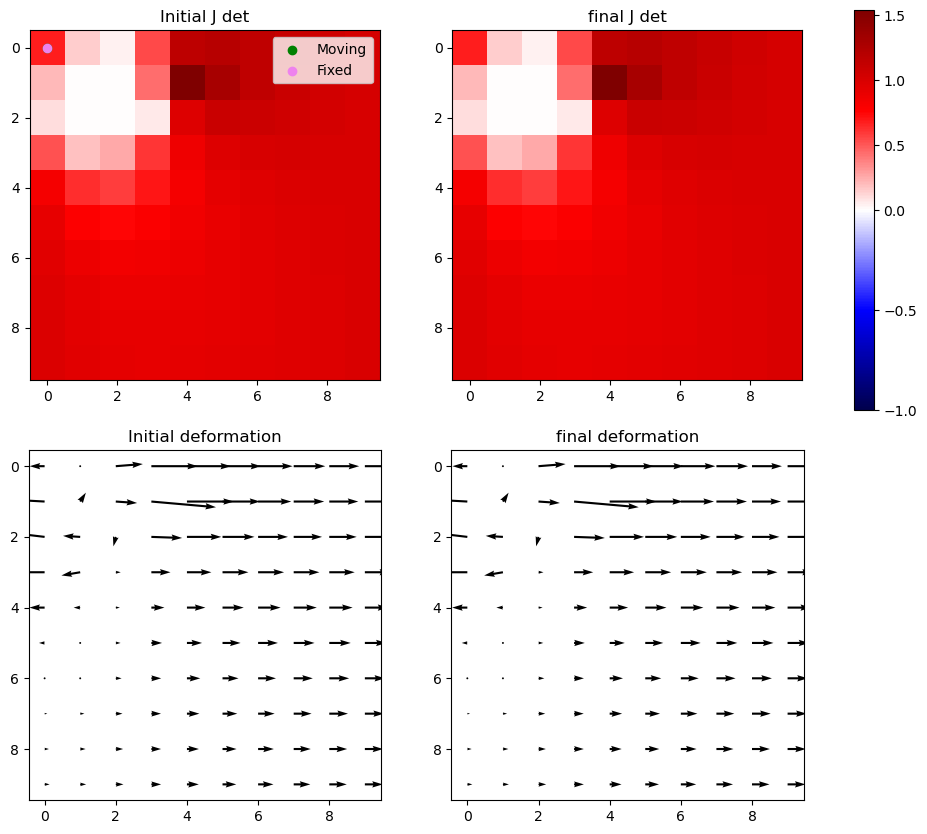

Iter 30: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


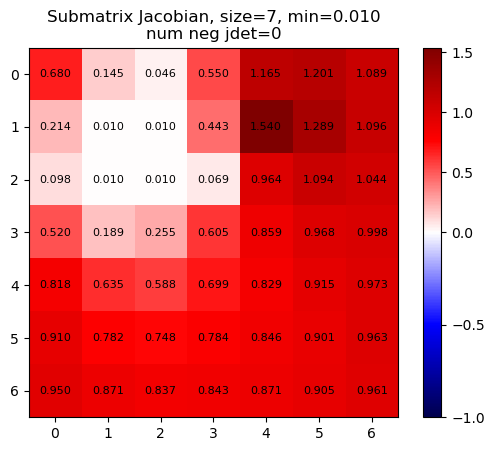

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


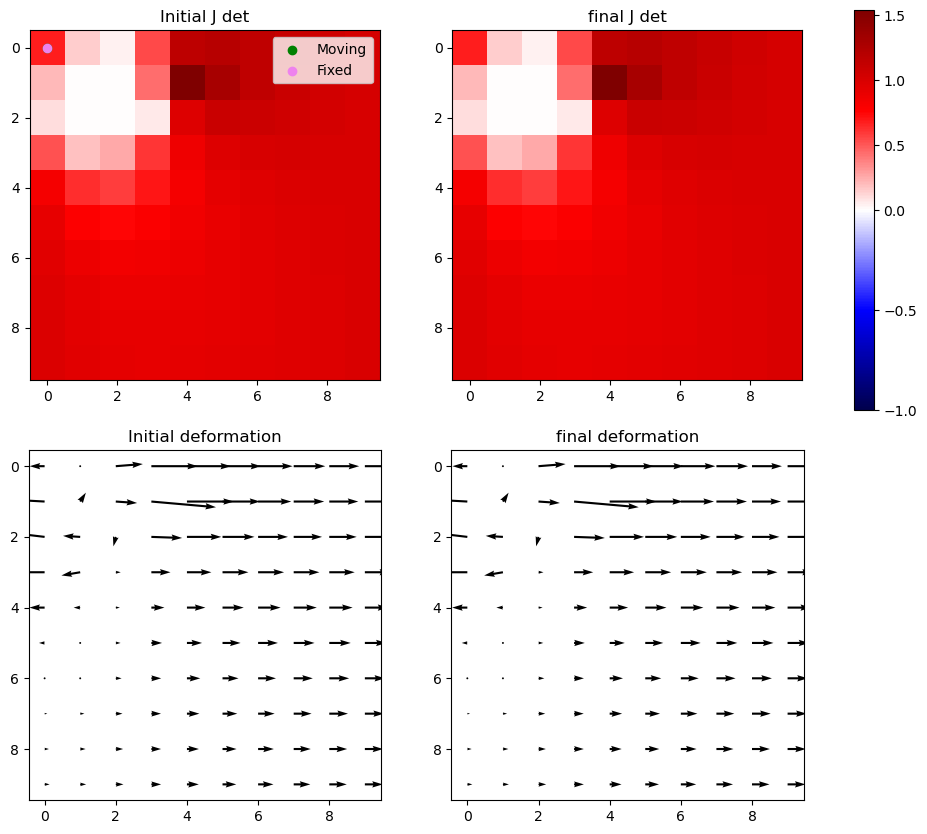

Iter 30: For index (2, 1), window size increased to 9 at iter 3


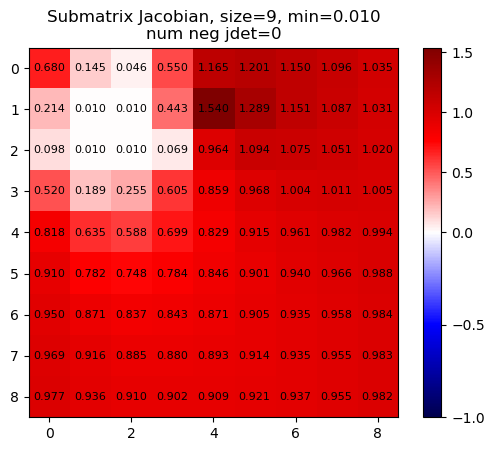

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


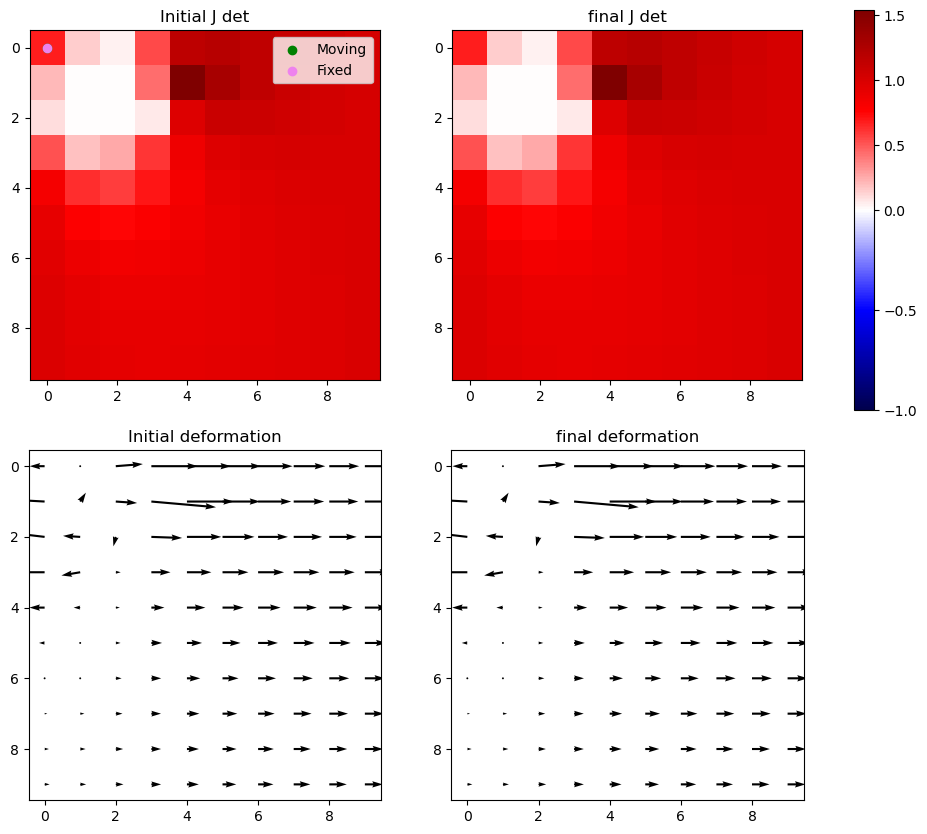

Iter 30 with 0 -ve jacs



Iter 31: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


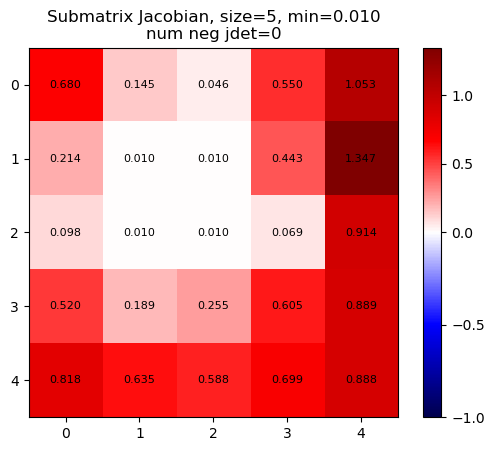

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


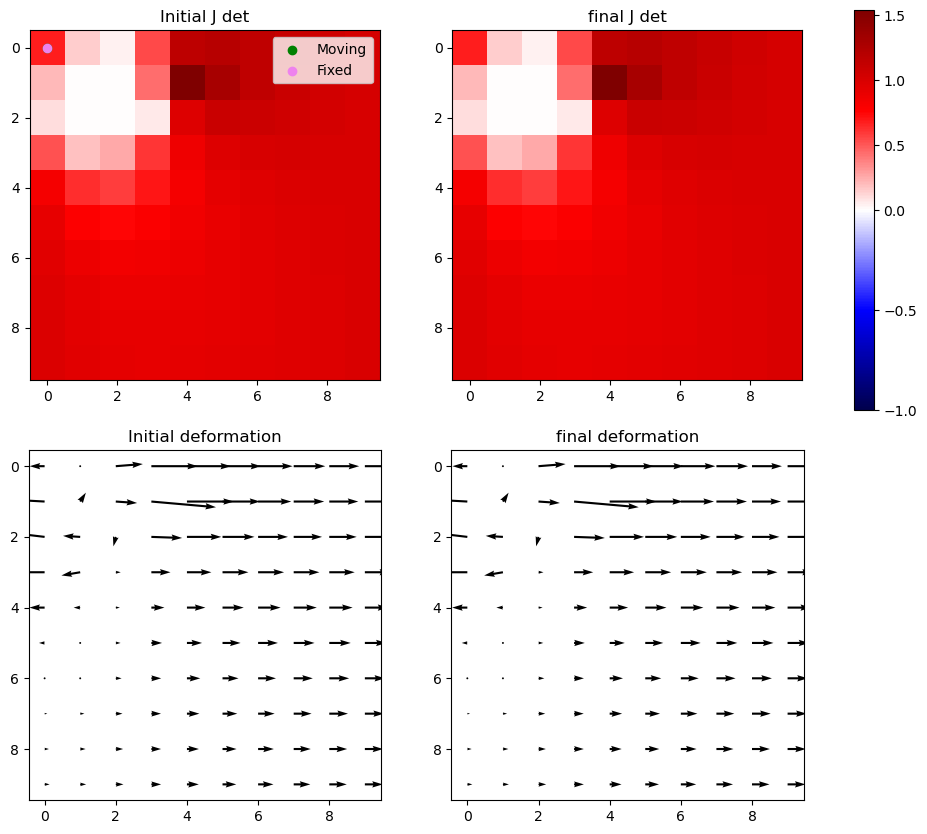

Iter 31: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


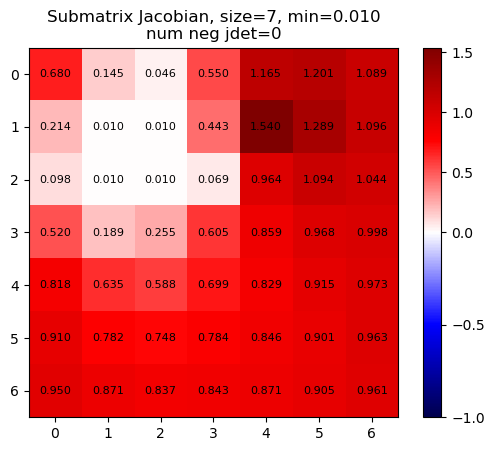

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


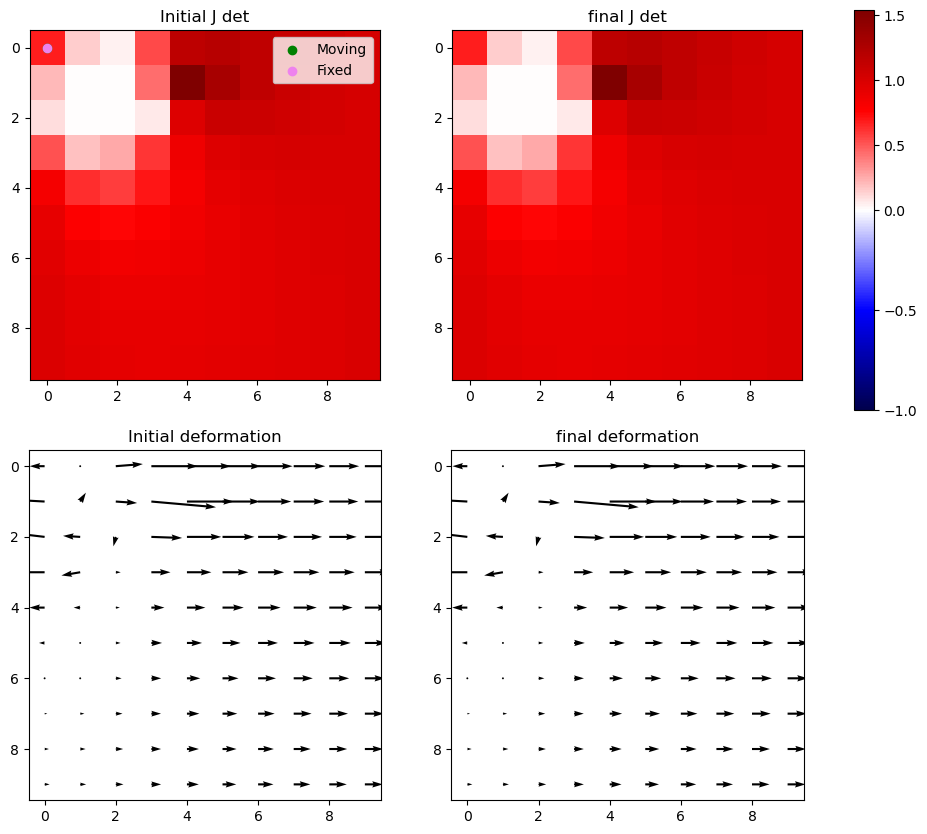

Iter 31: For index (2, 1), window size increased to 9 at iter 3


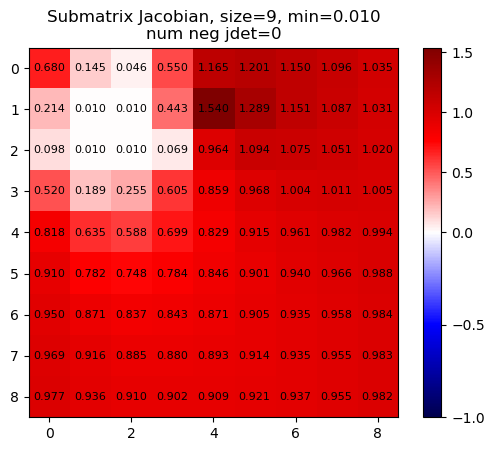

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


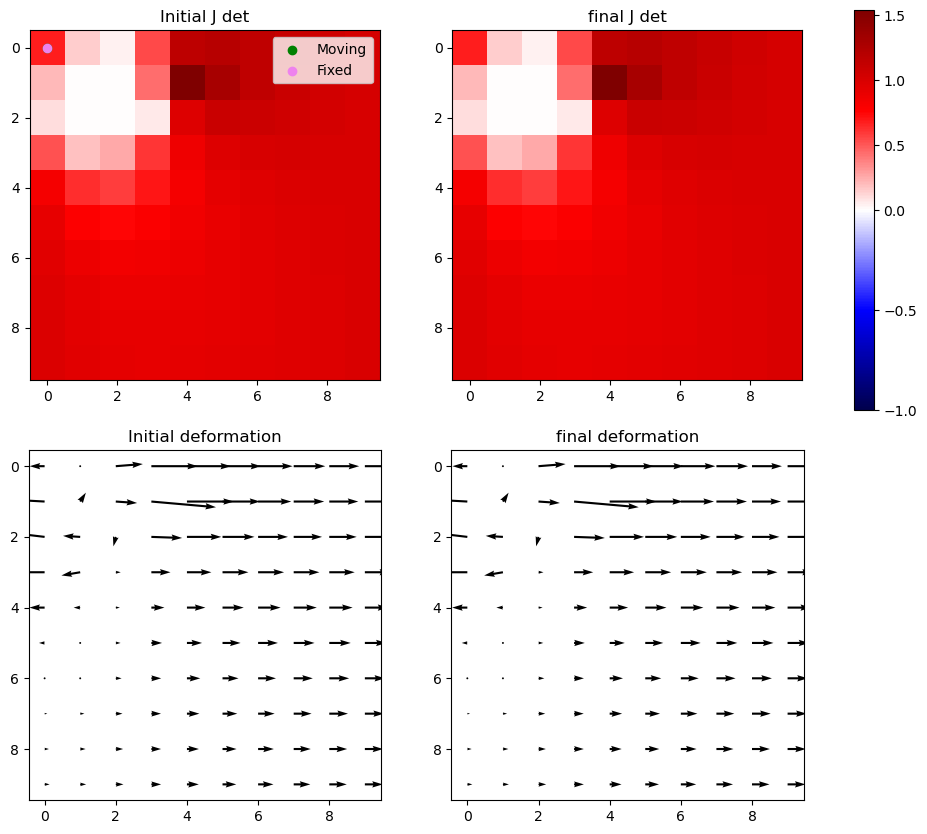

Iter 31 with 0 -ve jacs



Iter 32: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


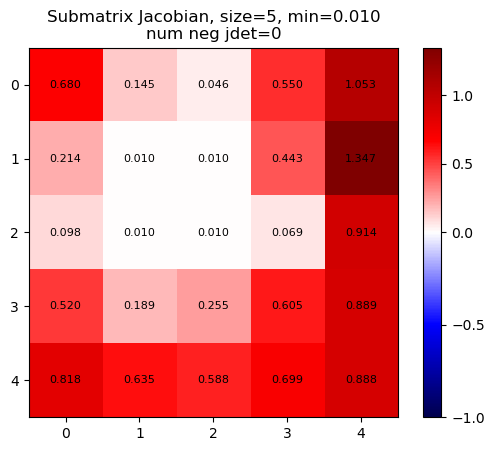

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


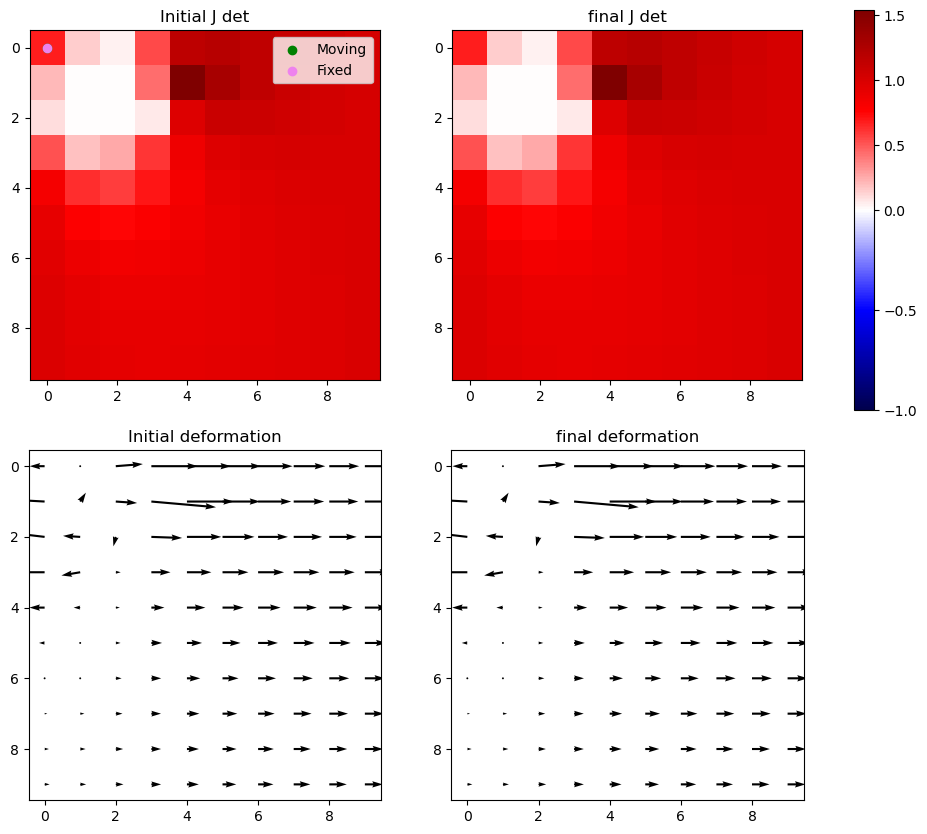

Iter 32: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


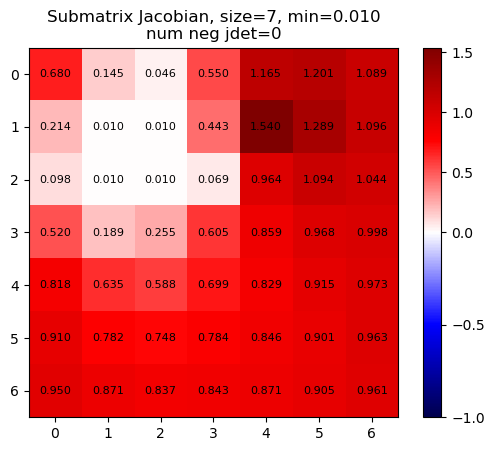

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


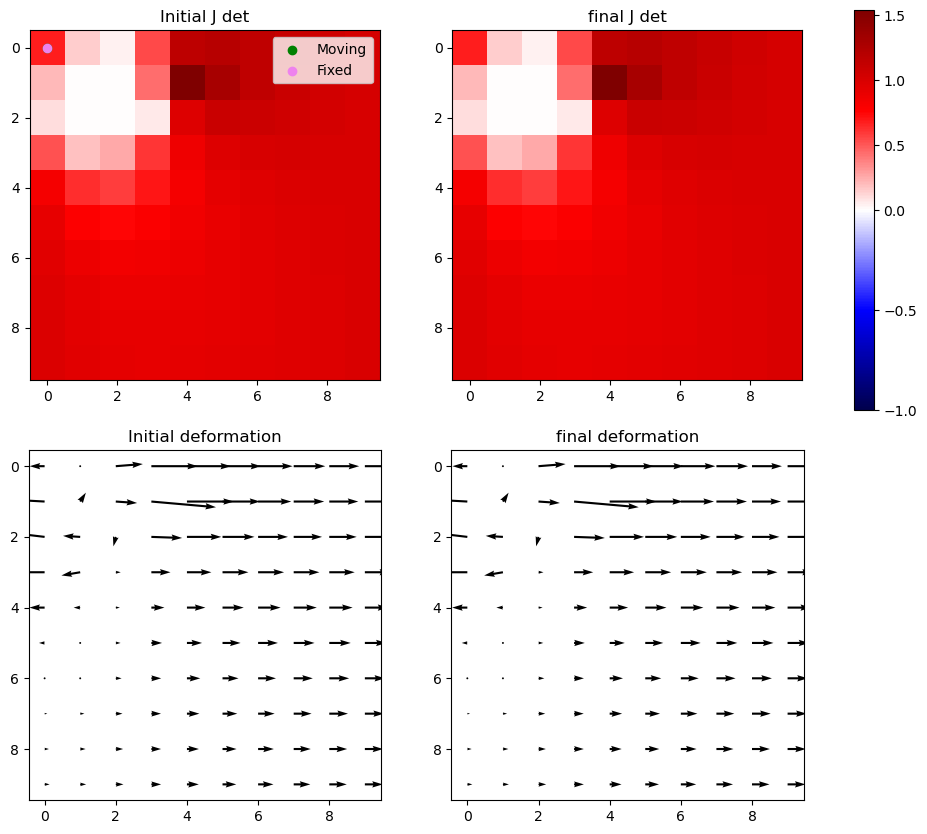

Iter 32: For index (2, 1), window size increased to 9 at iter 3


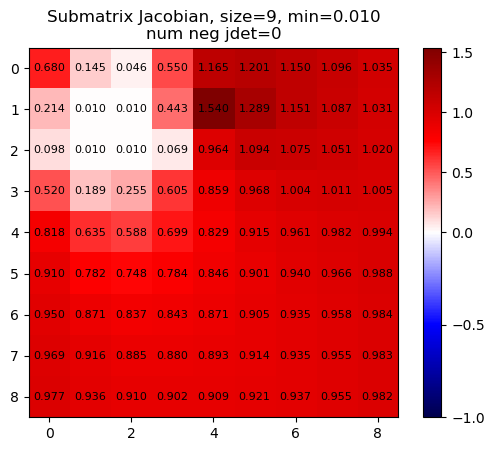

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


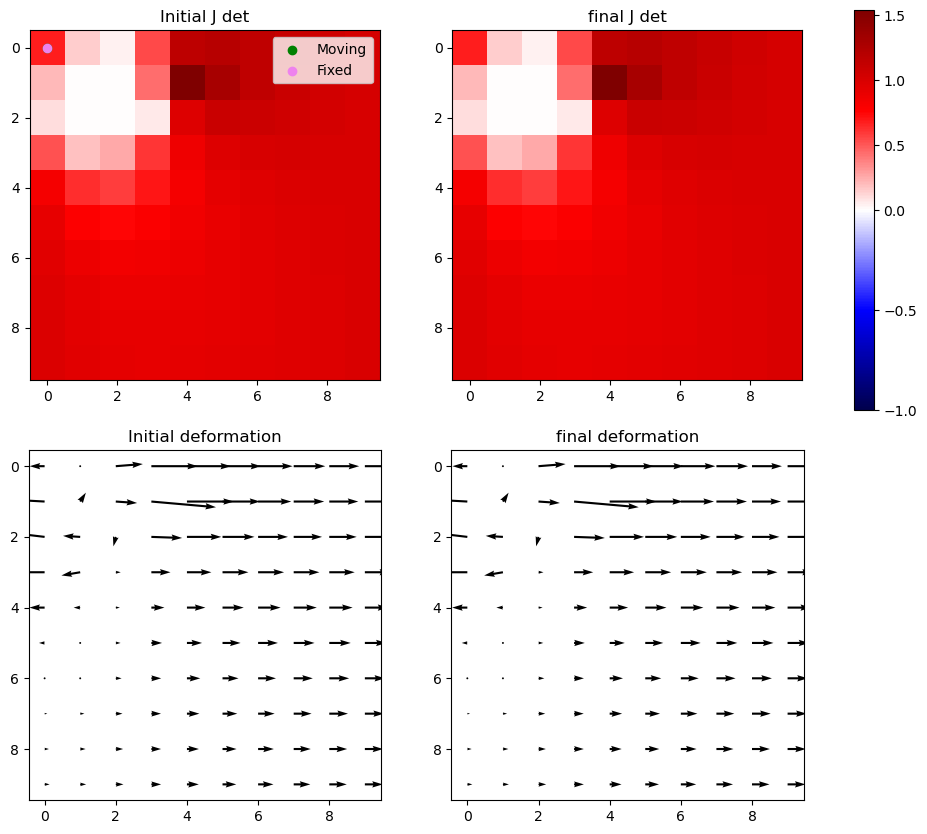

Iter 32 with 0 -ve jacs



Iter 33: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


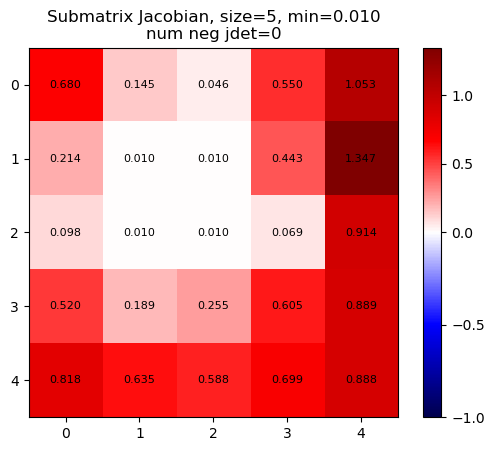

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


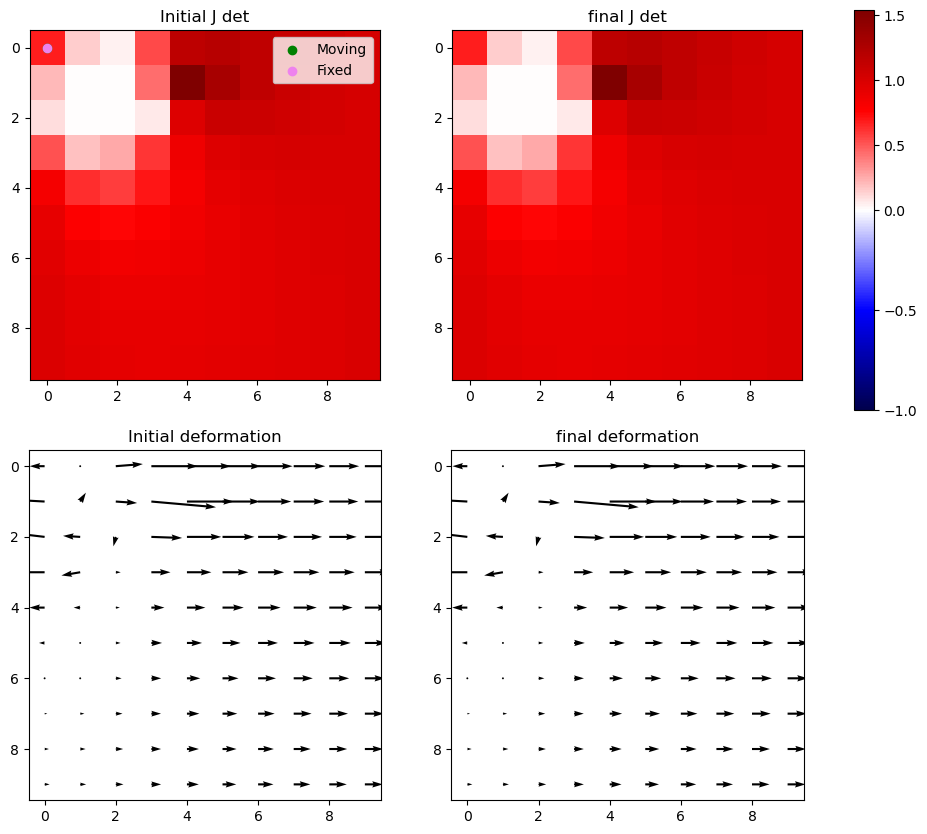

Iter 33: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


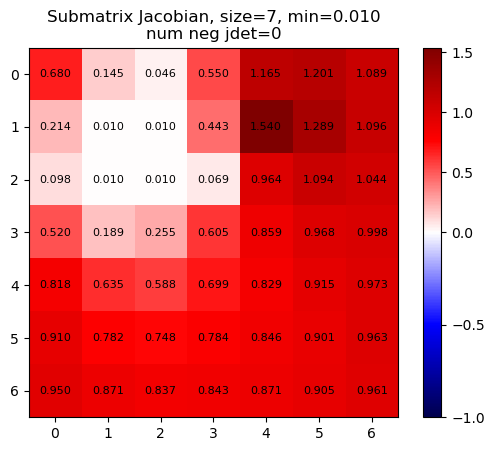

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


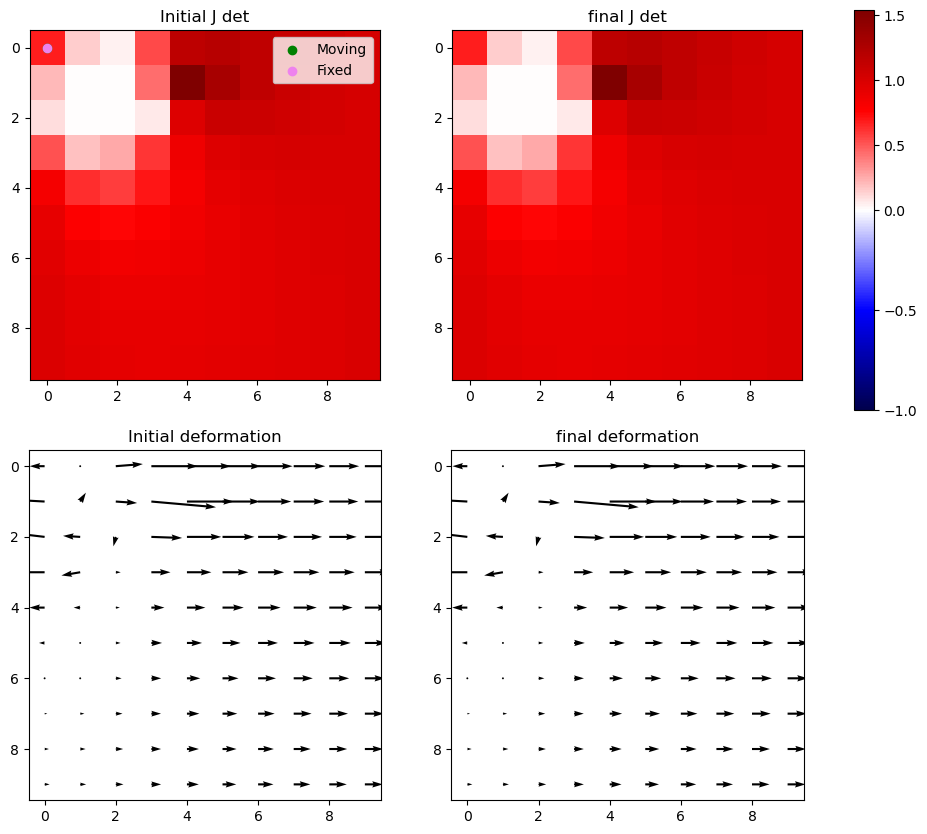

Iter 33: For index (2, 1), window size increased to 9 at iter 3


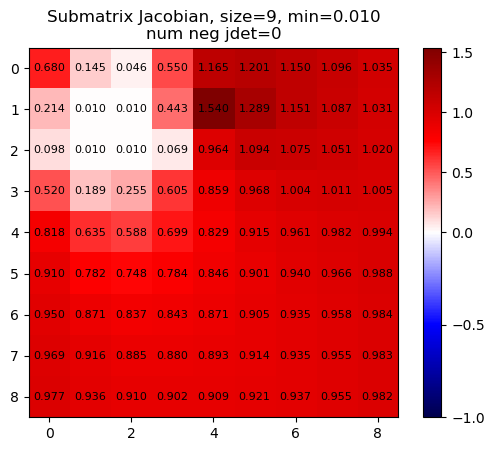

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


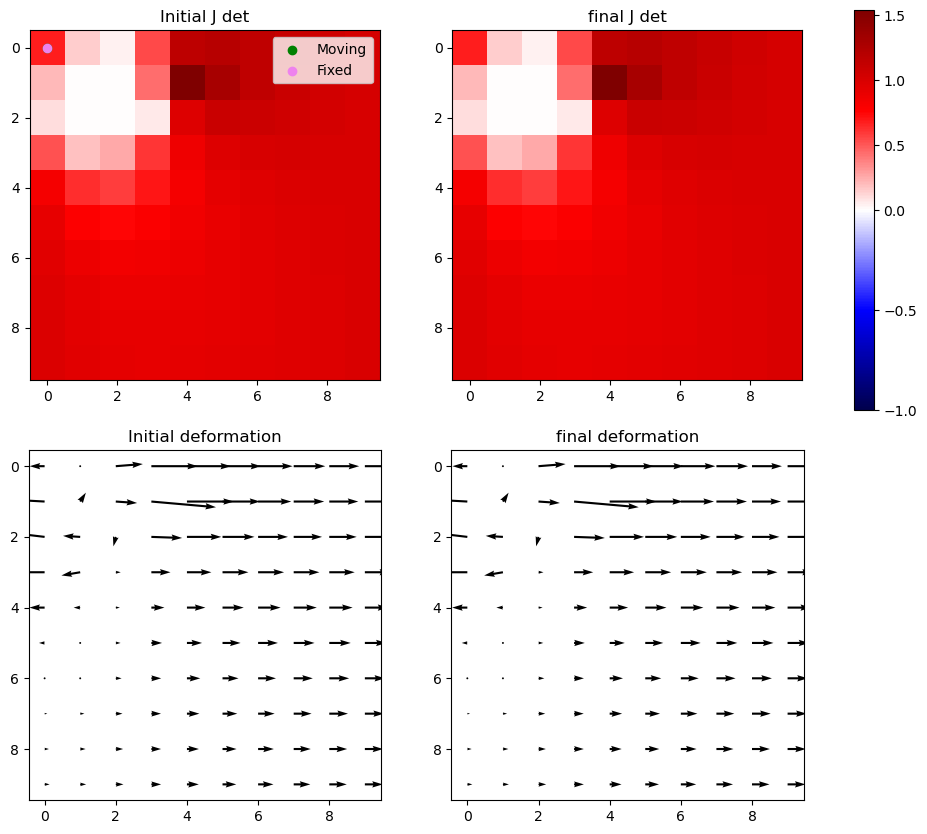

Iter 33 with 0 -ve jacs



Iter 34: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


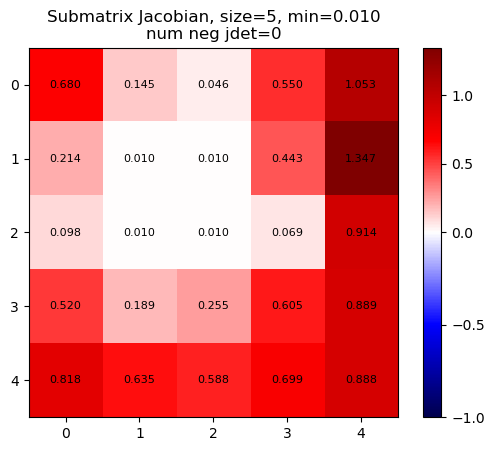

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


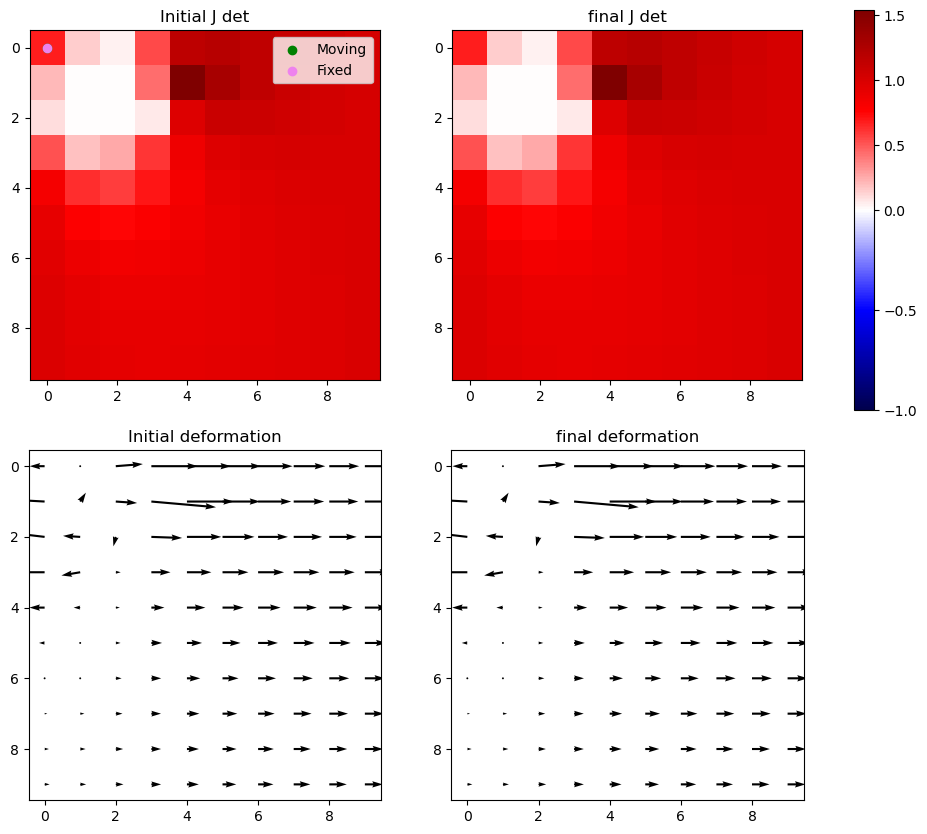

Iter 34: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


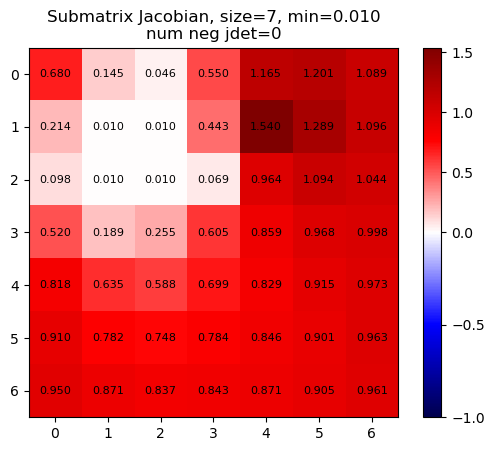

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


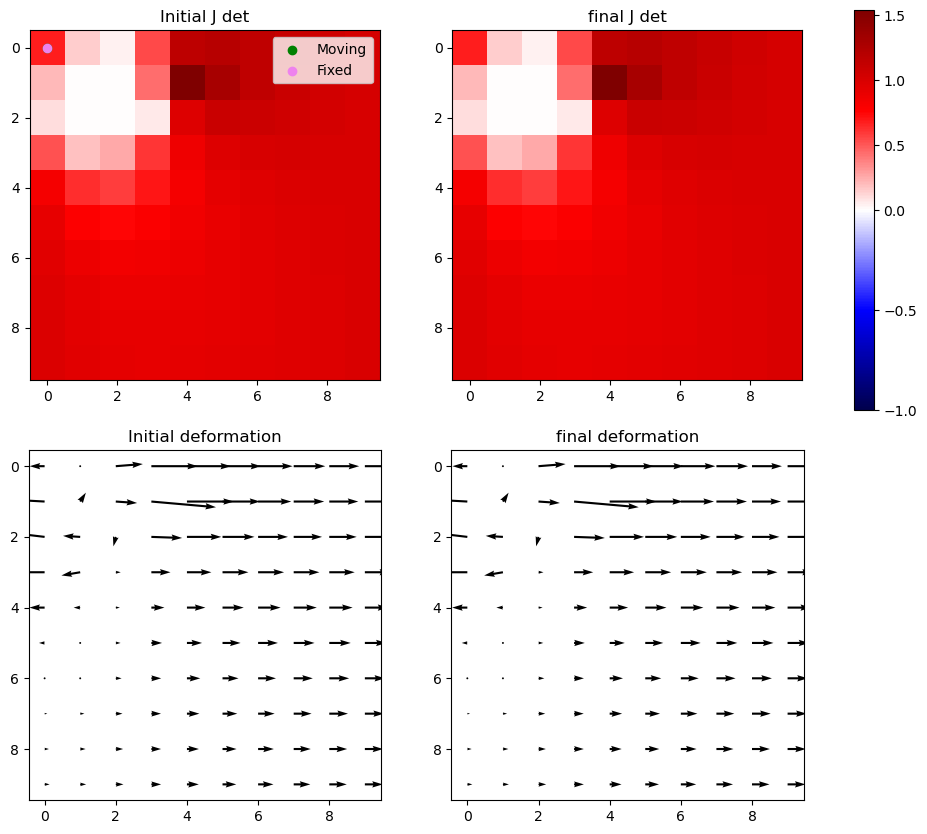

Iter 34: For index (2, 1), window size increased to 9 at iter 3


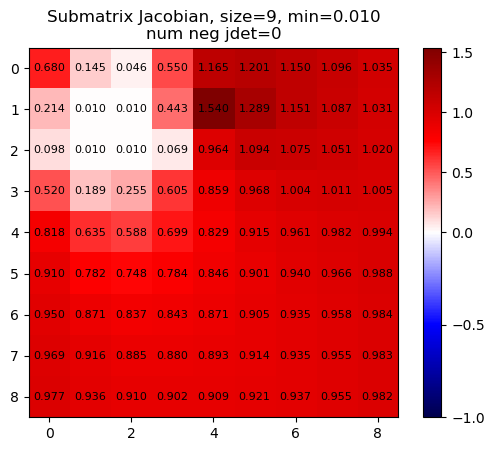

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


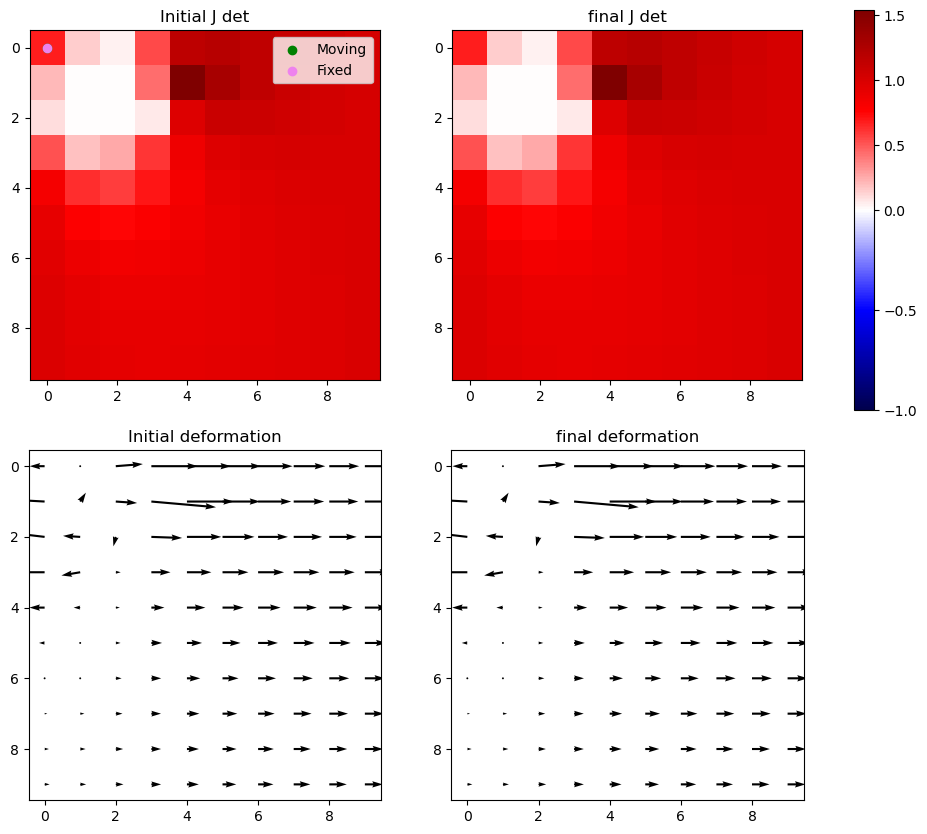

Iter 34 with 0 -ve jacs



Iter 35: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


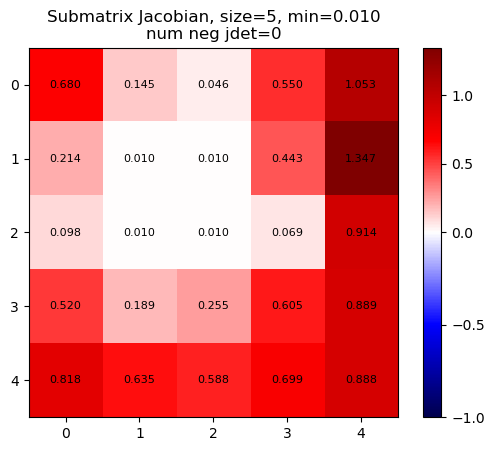

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


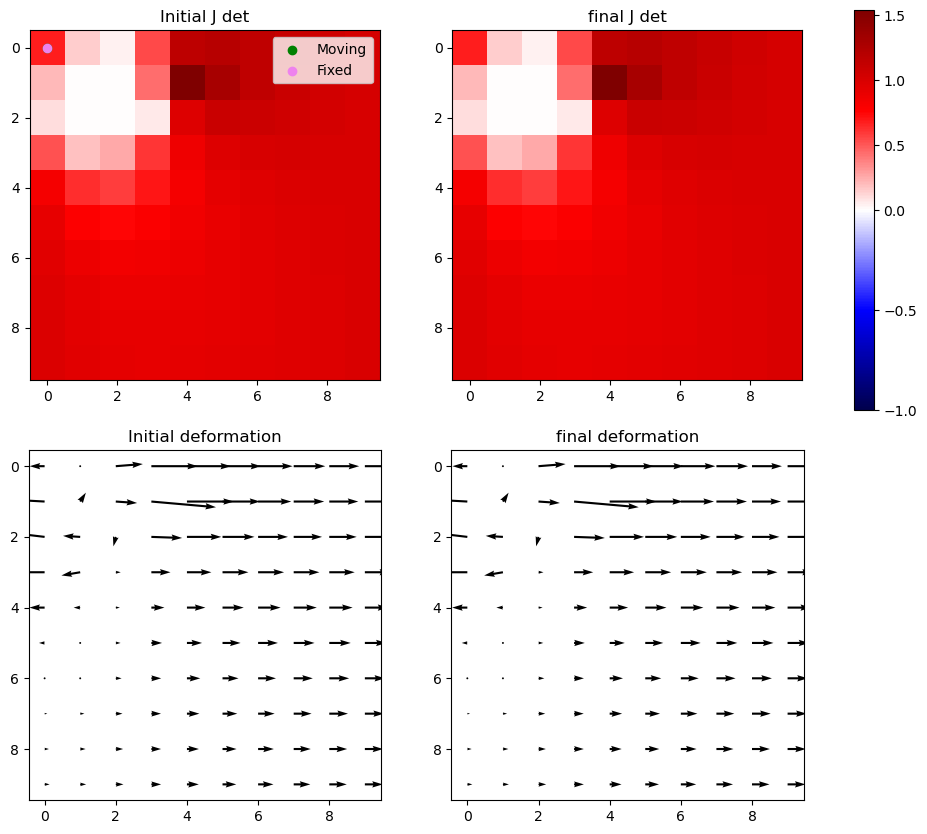

Iter 35: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


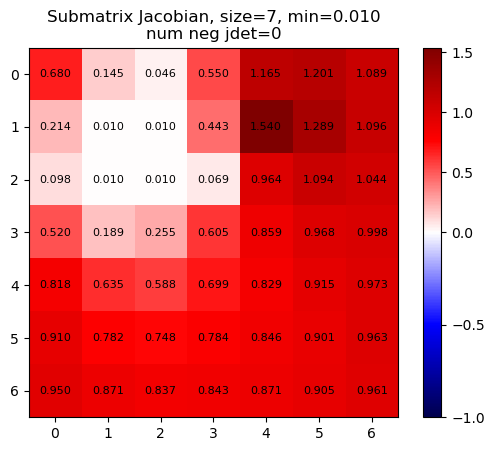

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


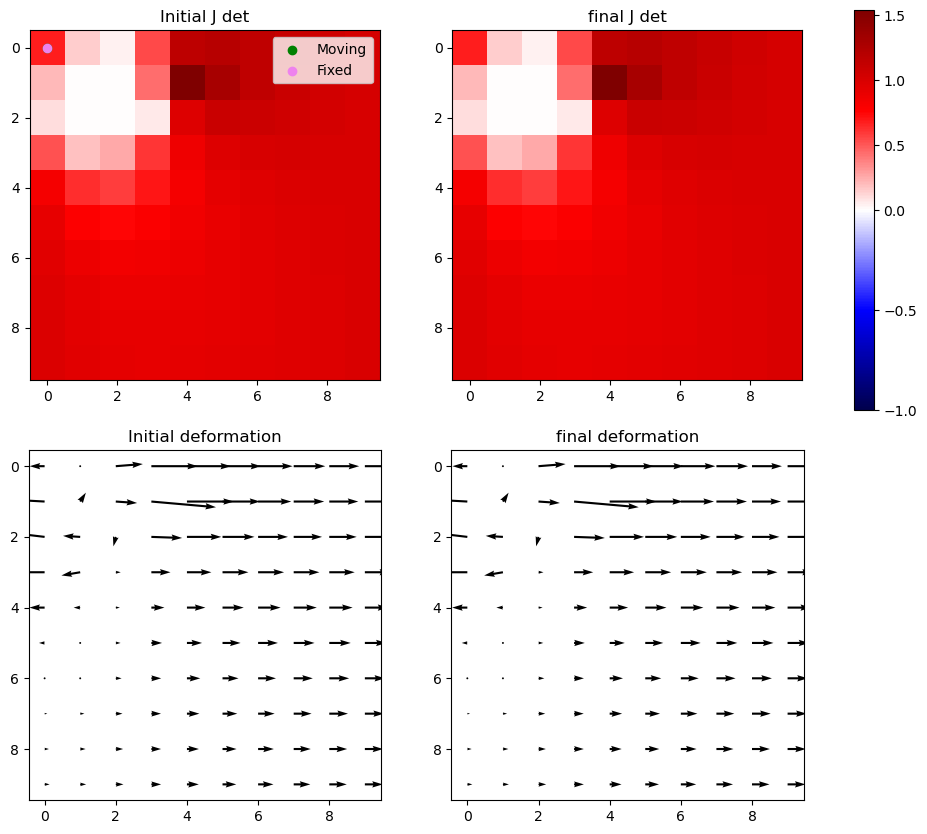

Iter 35: For index (2, 1), window size increased to 9 at iter 3


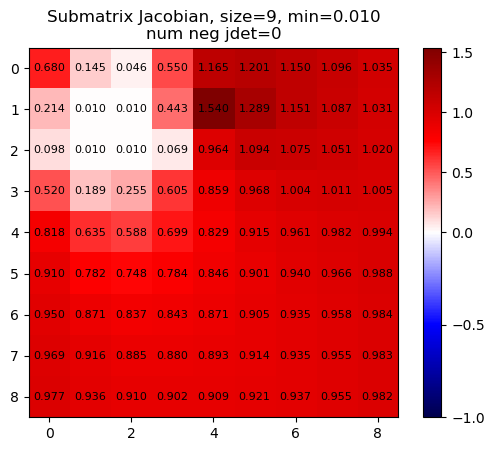

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


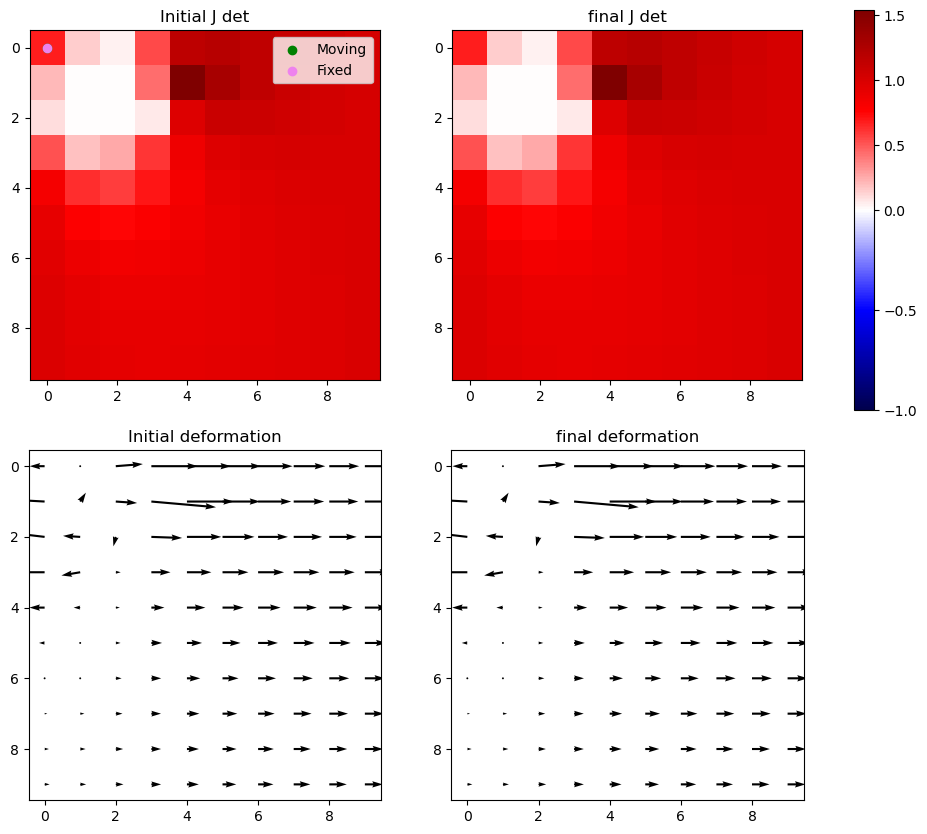

Iter 35 with 0 -ve jacs



Iter 36: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


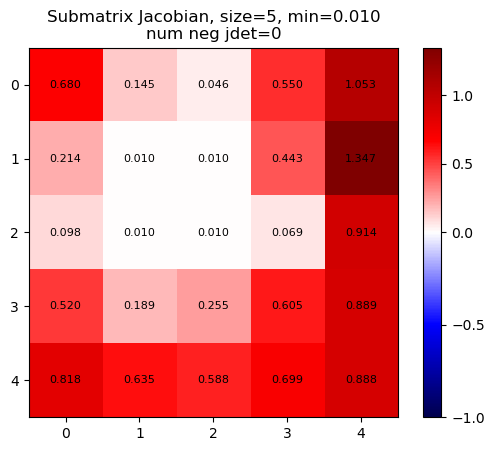

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


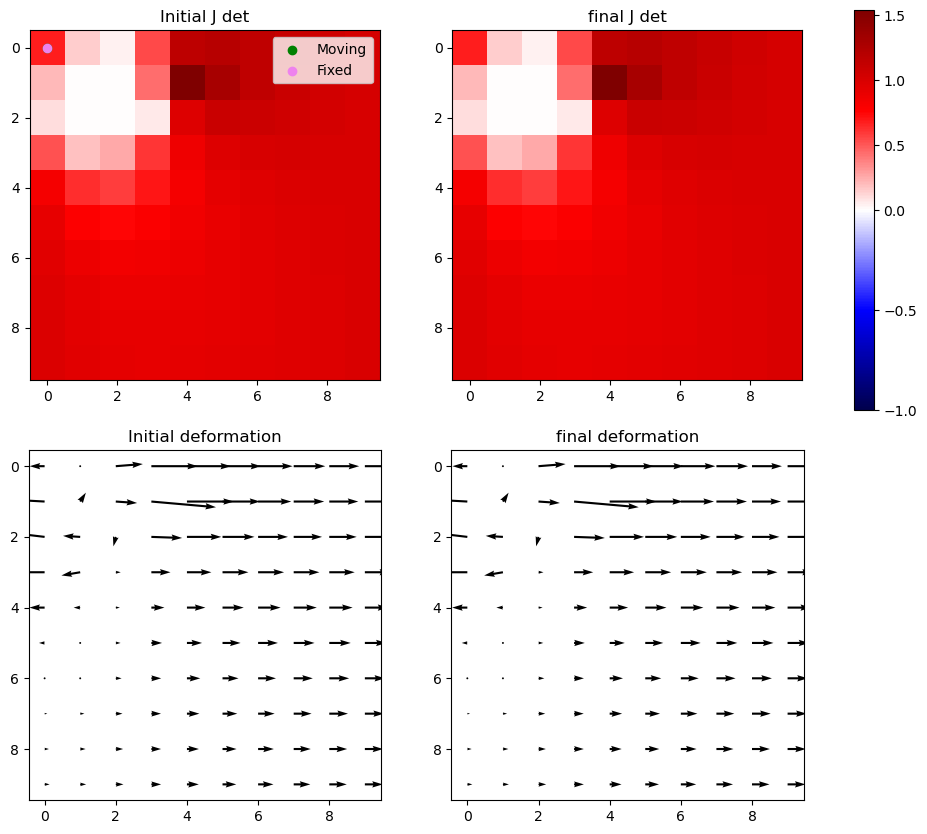

Iter 36: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


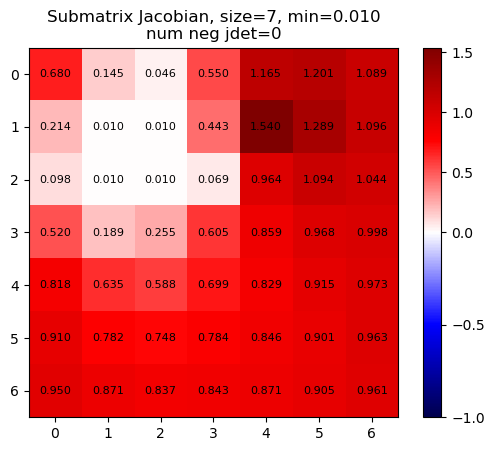

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


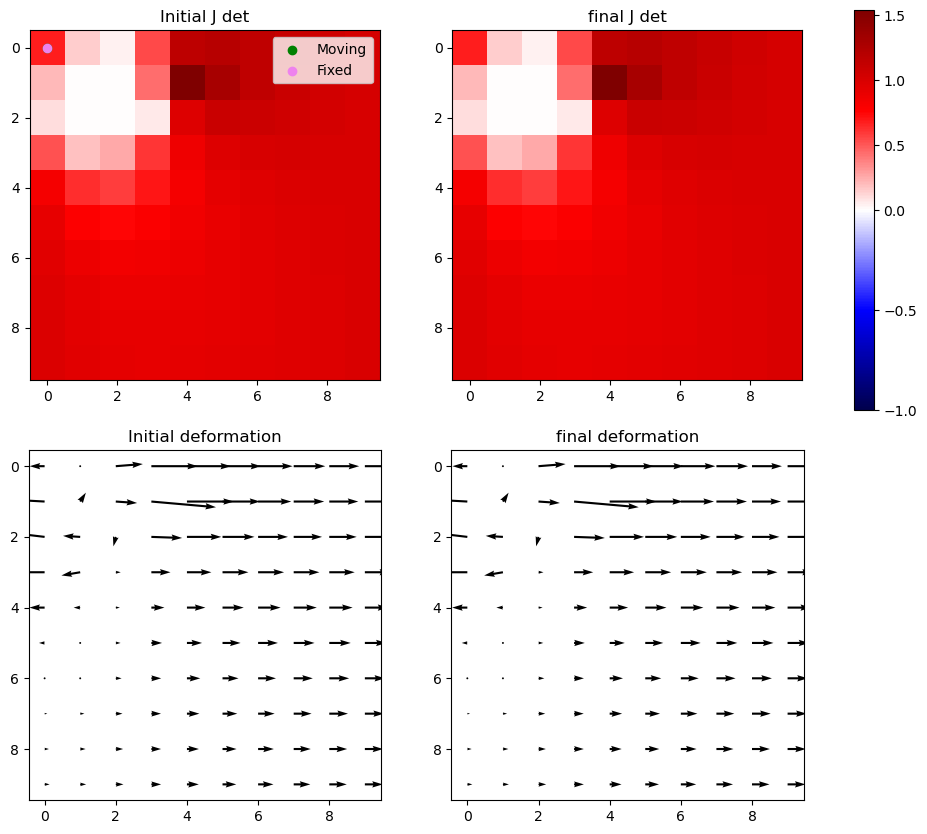

Iter 36: For index (2, 1), window size increased to 9 at iter 3


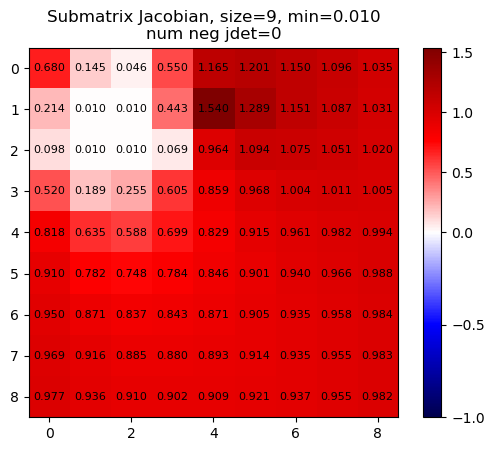

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


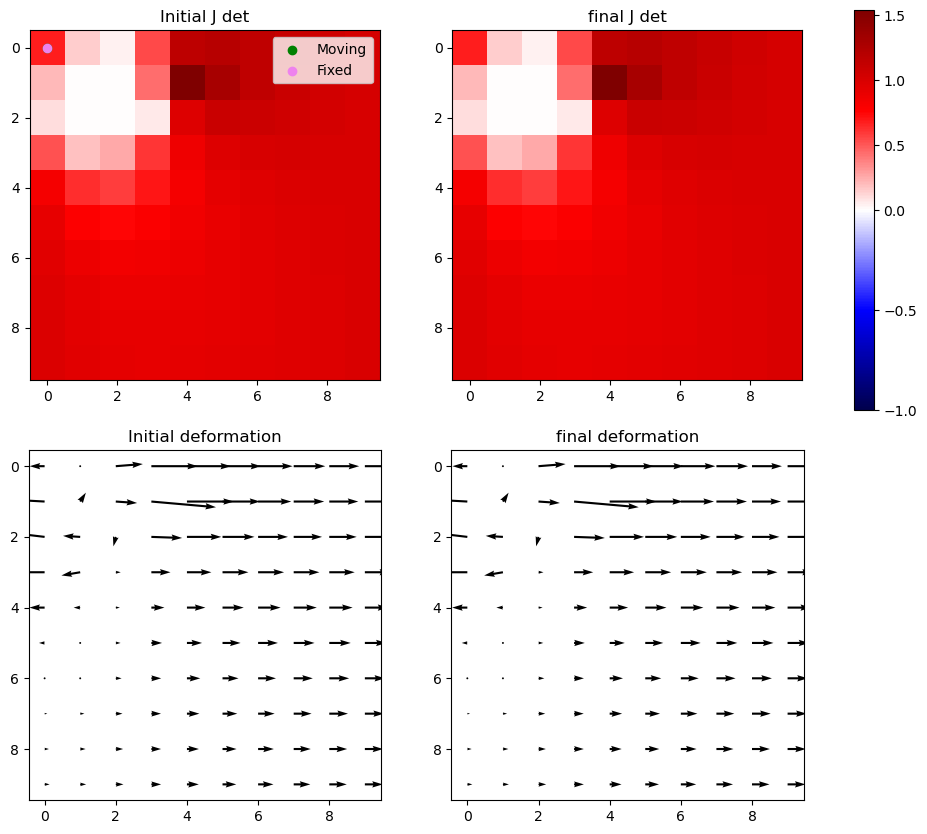

Iter 36 with 0 -ve jacs



Iter 37: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


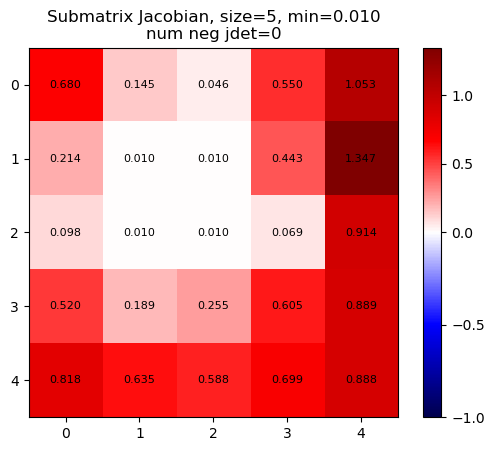

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


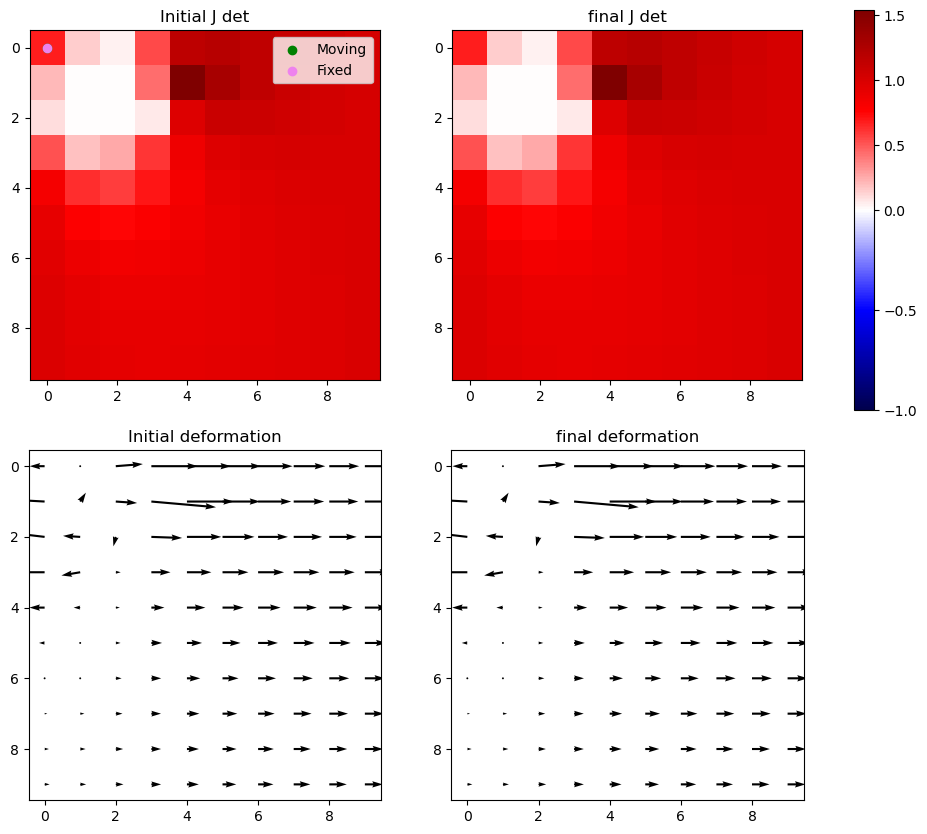

Iter 37: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


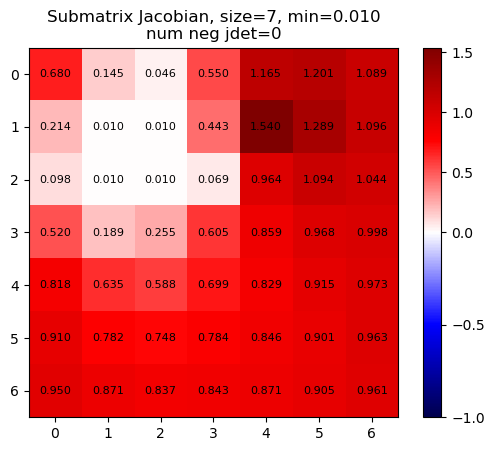

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


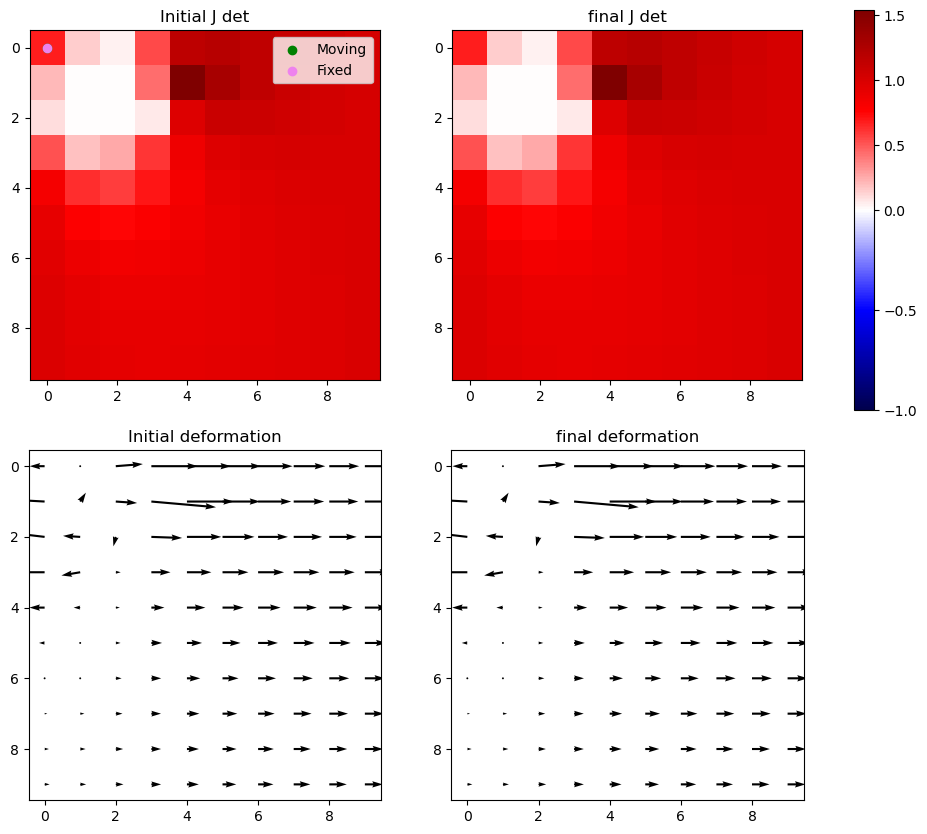

Iter 37: For index (2, 1), window size increased to 9 at iter 3


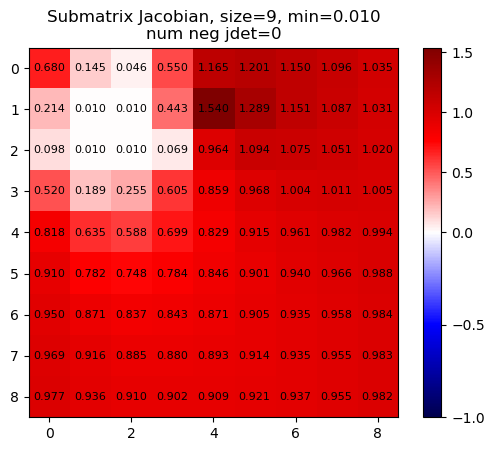

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


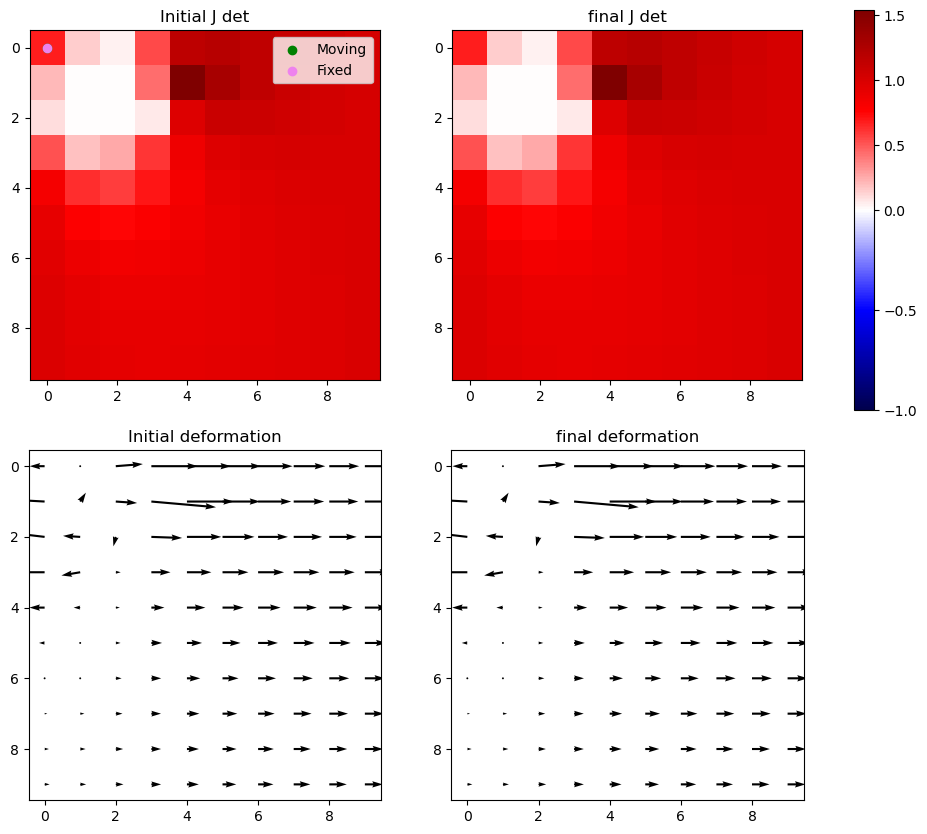

Iter 37 with 0 -ve jacs



Iter 38: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


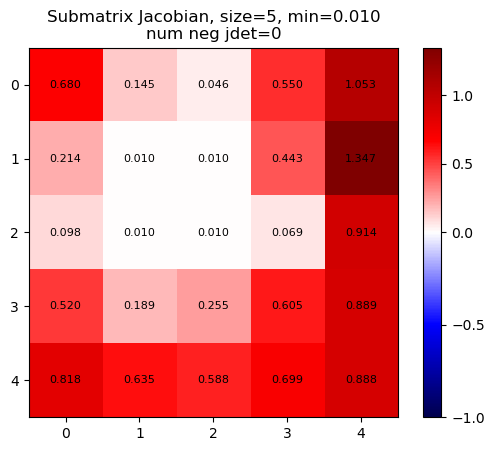

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


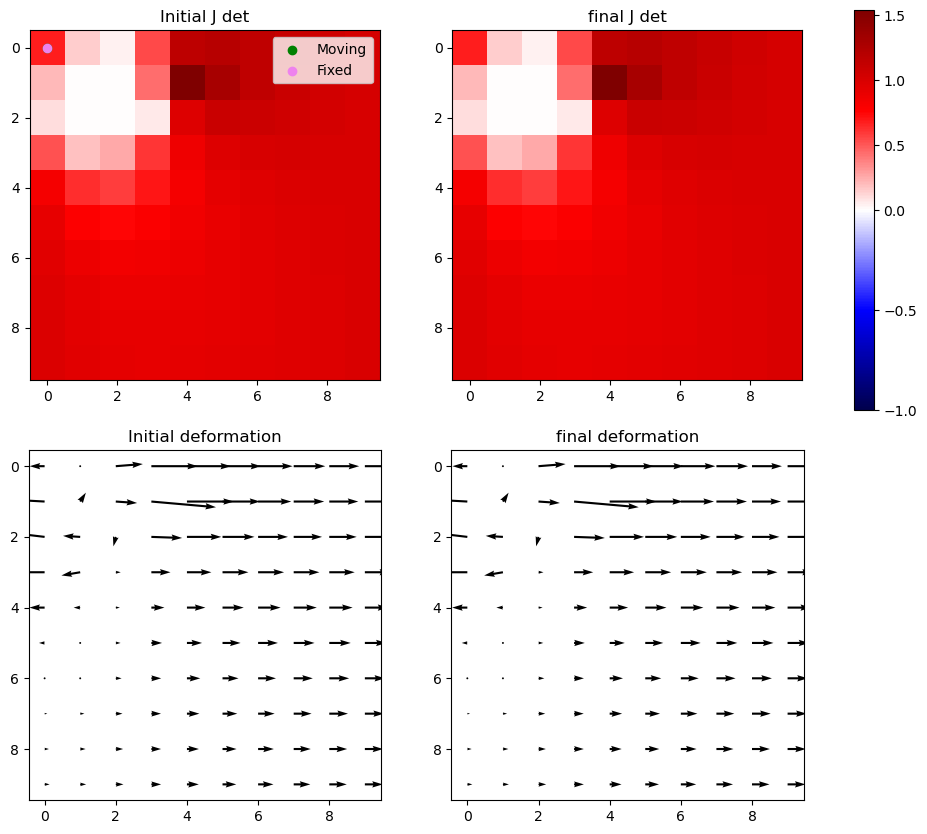

Iter 38: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


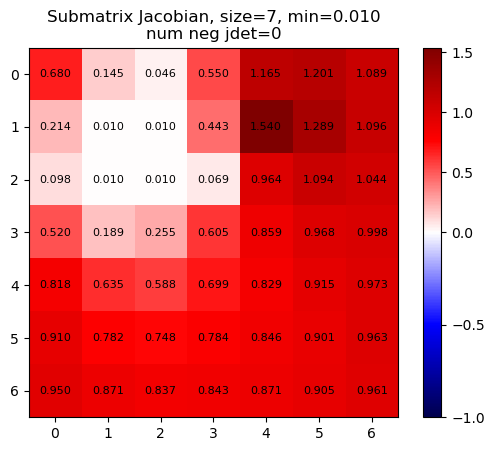

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


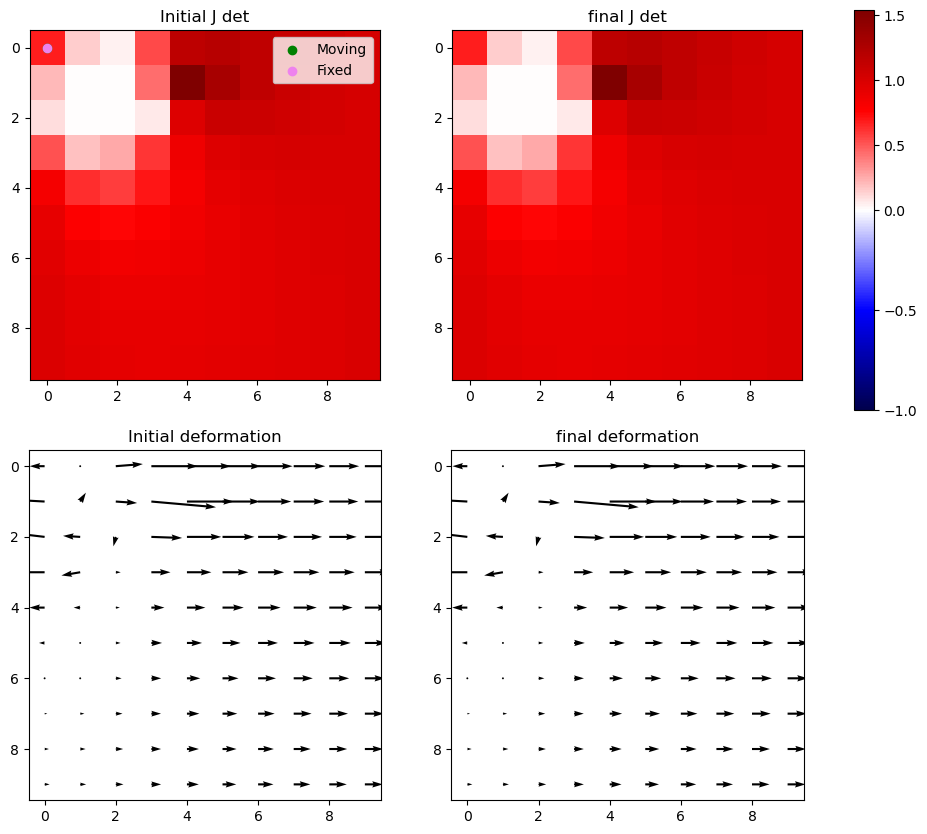

Iter 38: For index (2, 1), window size increased to 9 at iter 3


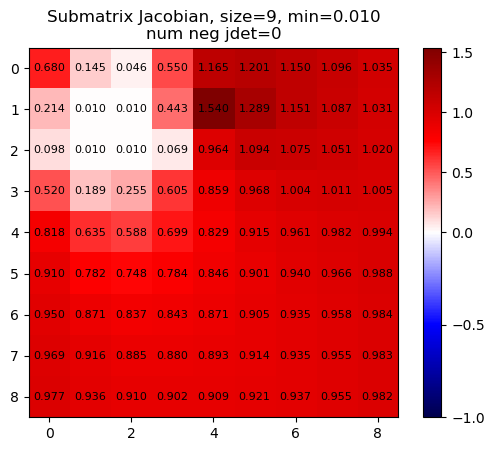

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


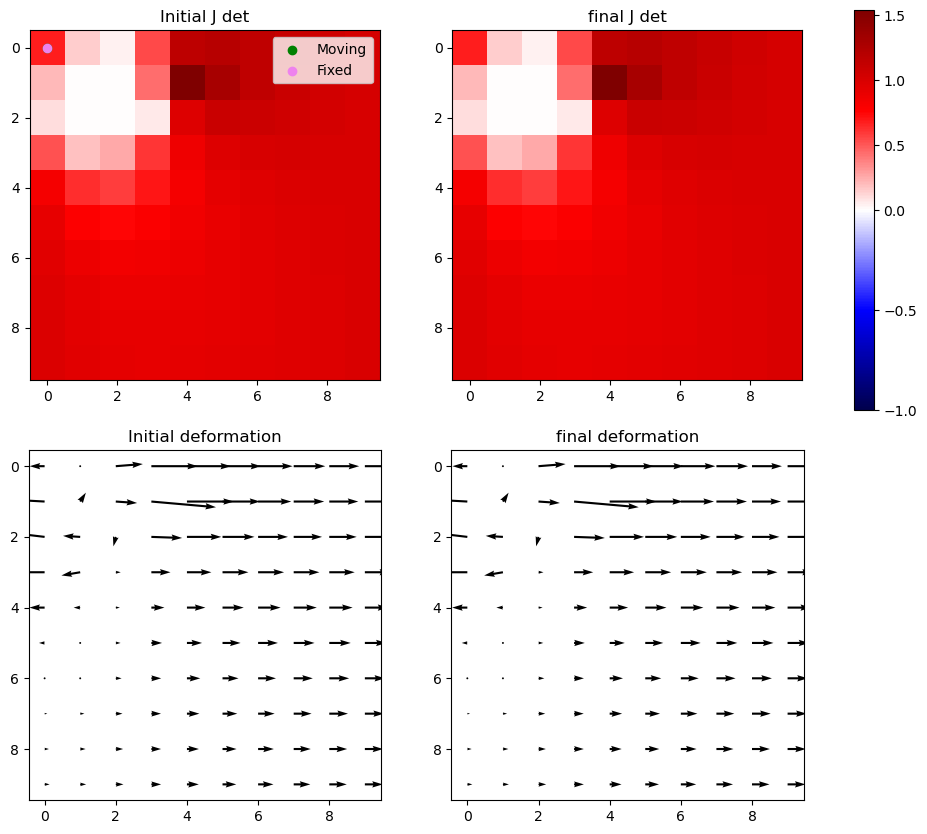

Iter 38 with 0 -ve jacs



Iter 39: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


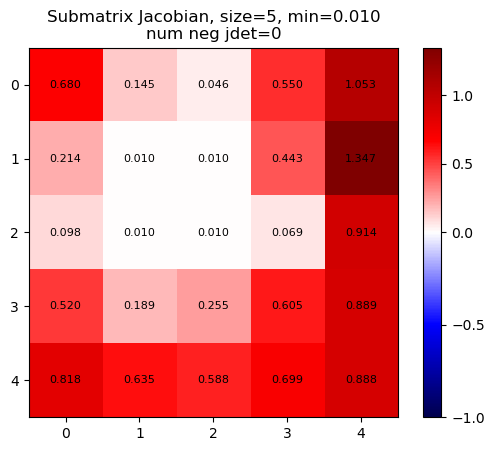

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


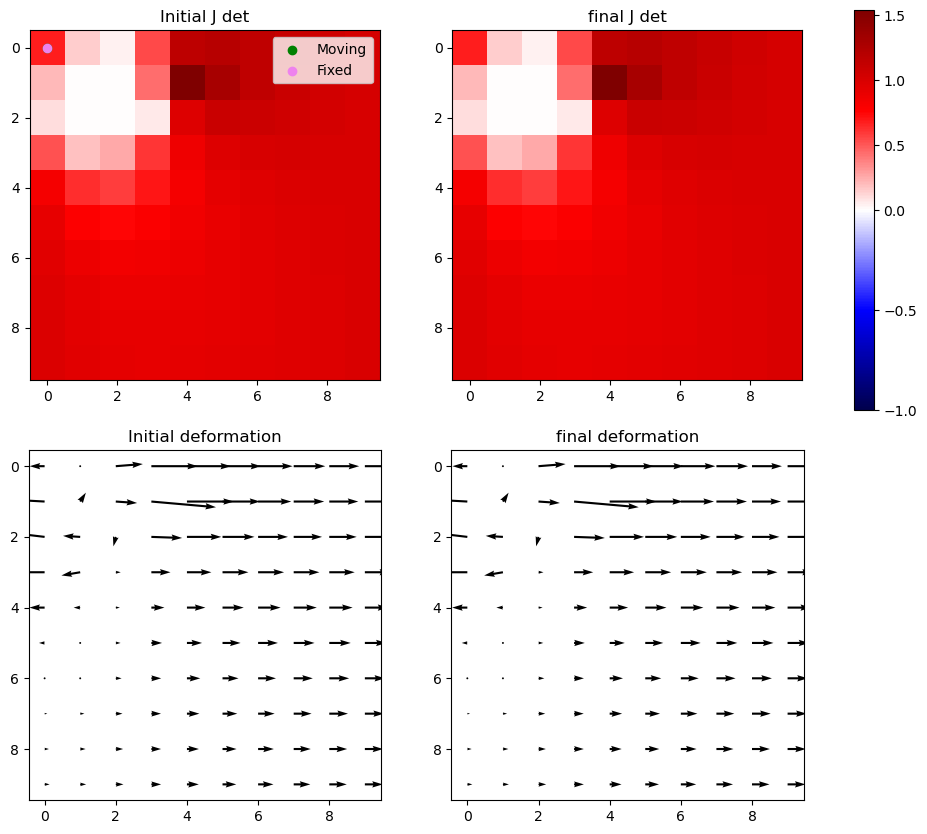

Iter 39: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


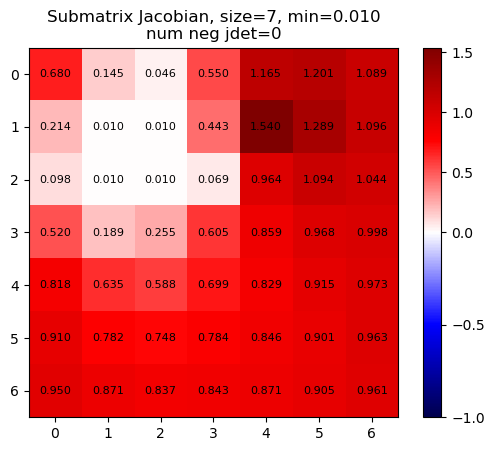

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


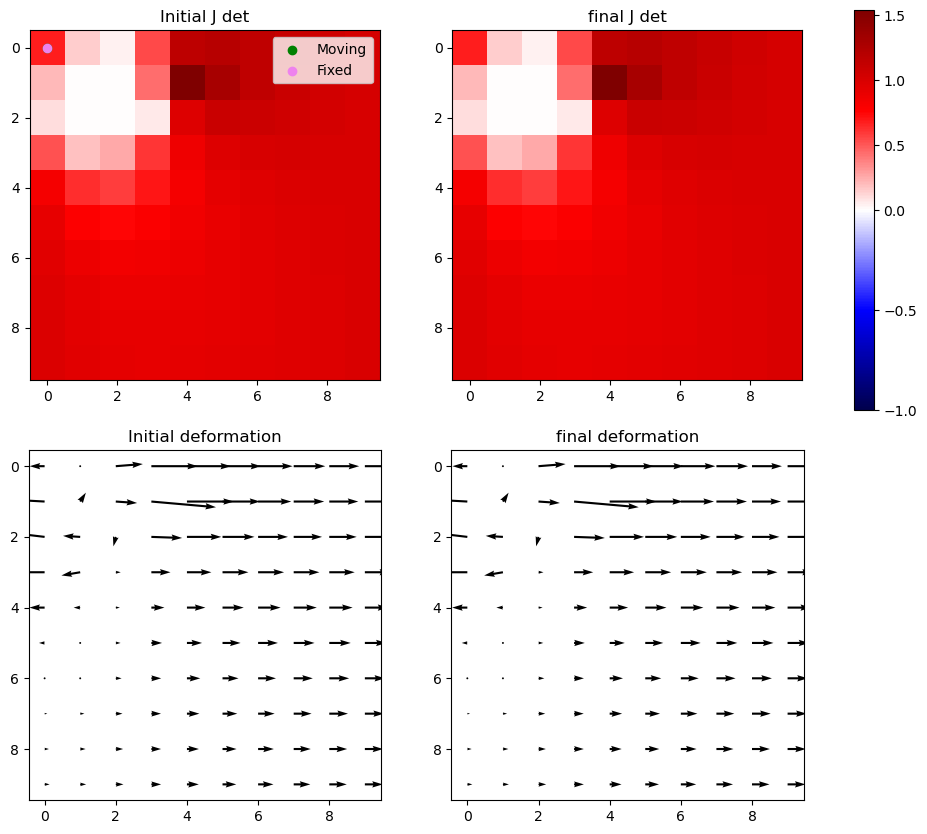

Iter 39: For index (2, 1), window size increased to 9 at iter 3


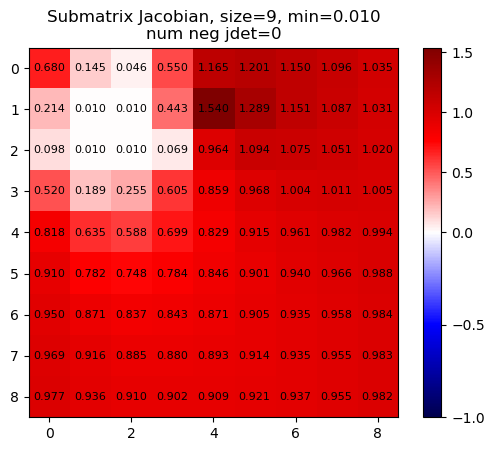

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


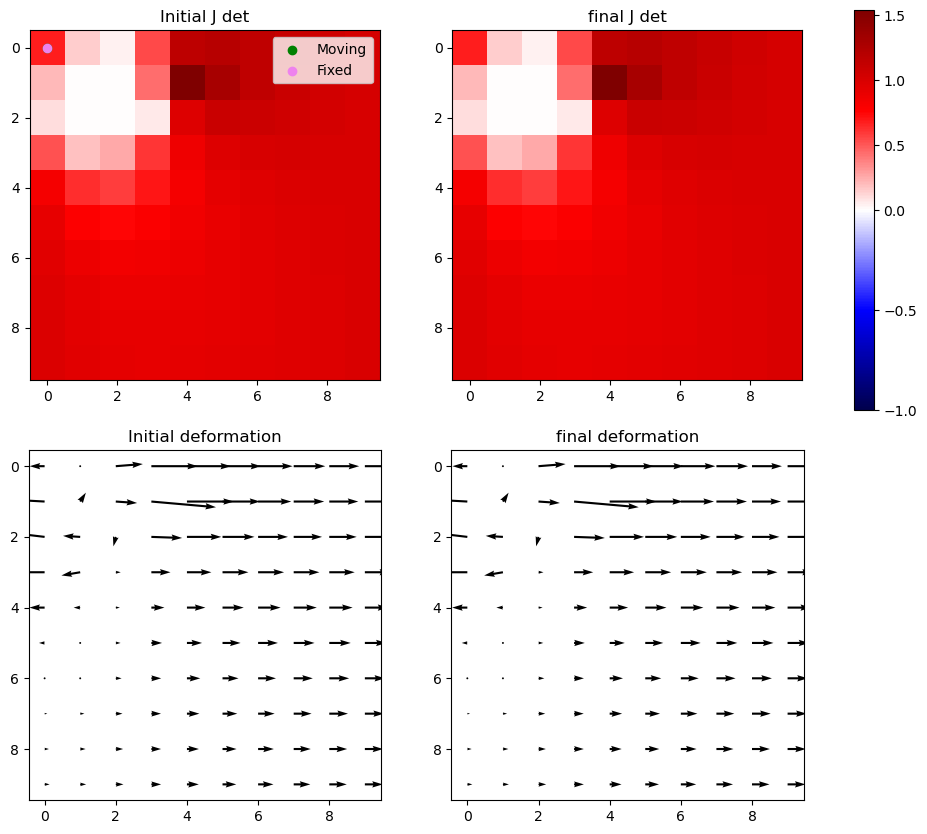

Iter 39 with 0 -ve jacs



Iter 40: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


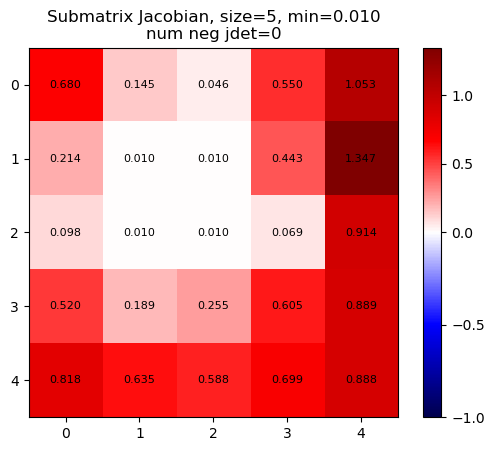

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


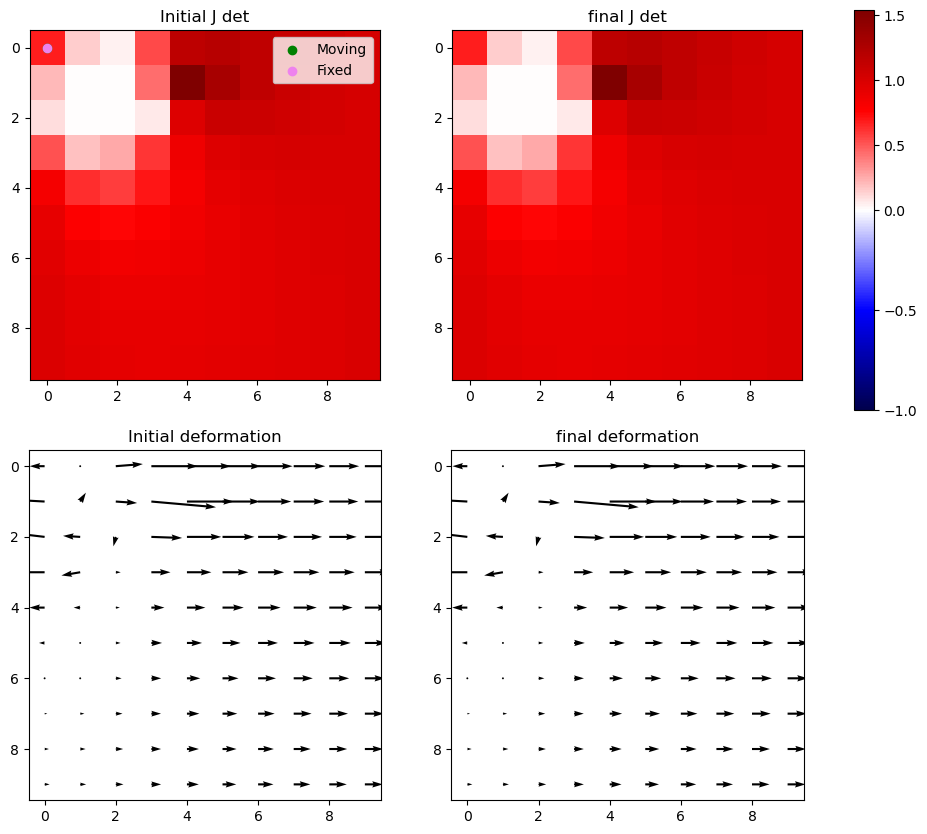

Iter 40: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


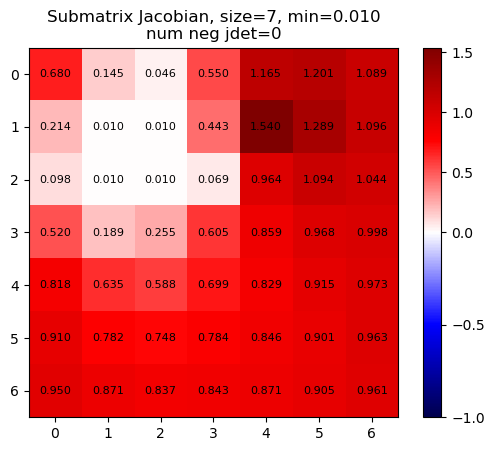

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


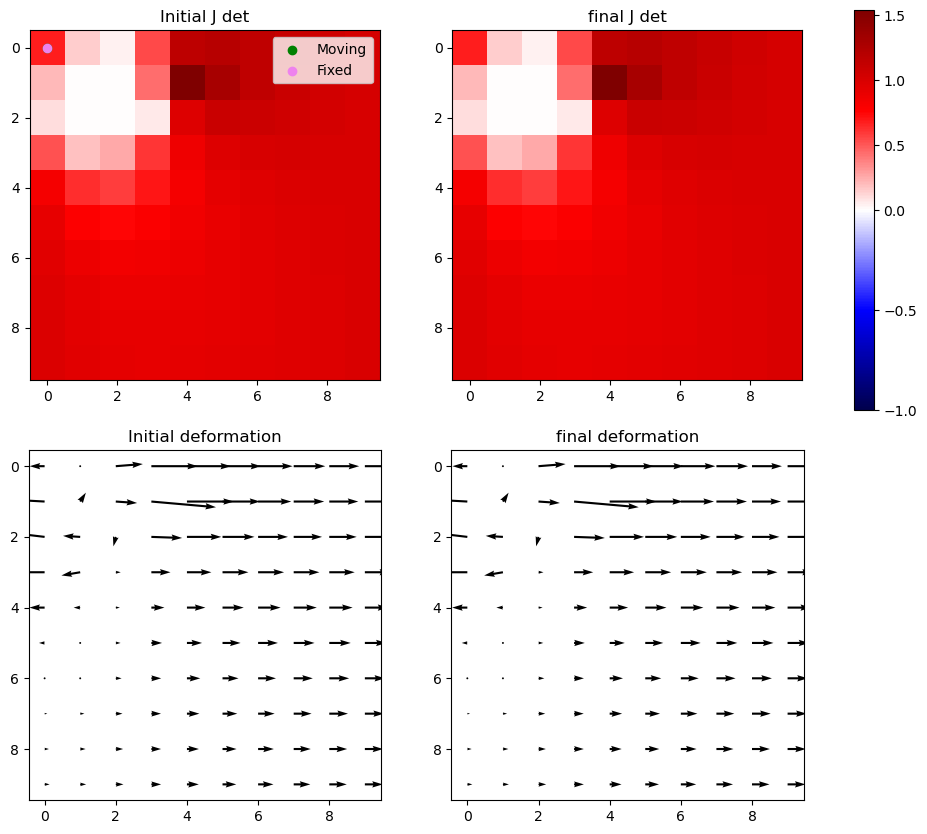

Iter 40: For index (2, 1), window size increased to 9 at iter 3


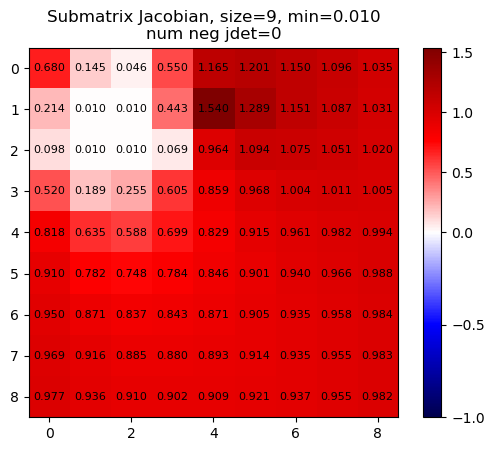

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


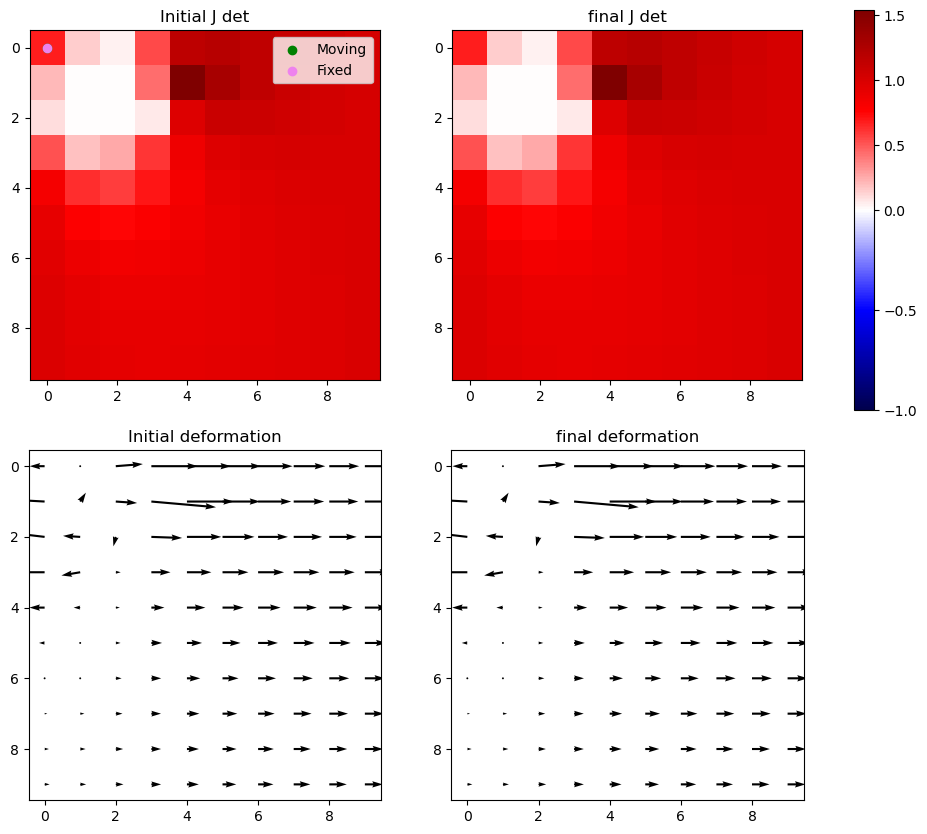

Iter 40 with 0 -ve jacs



Iter 41: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


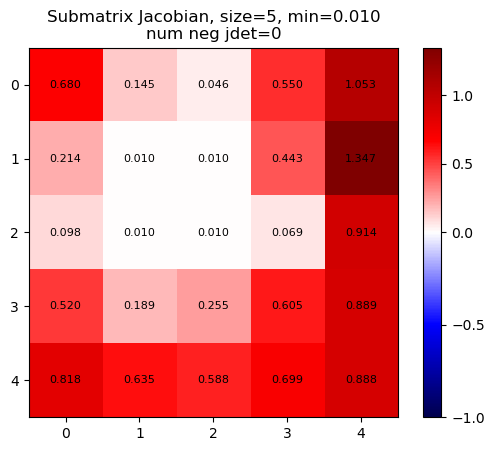

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


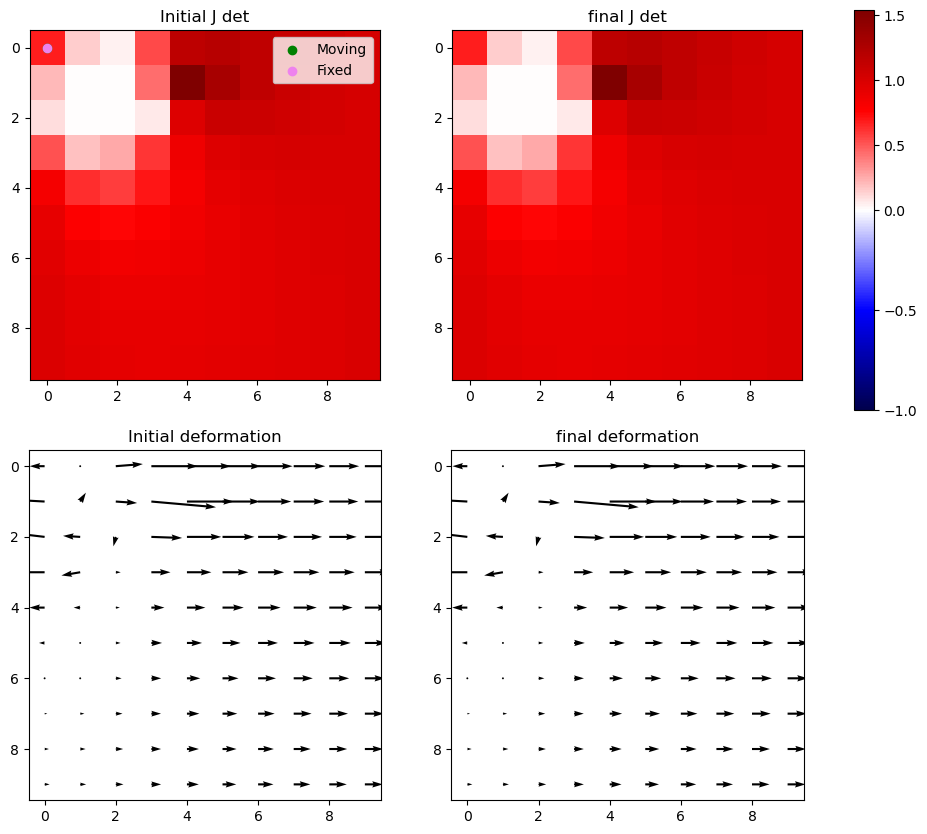

Iter 41: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


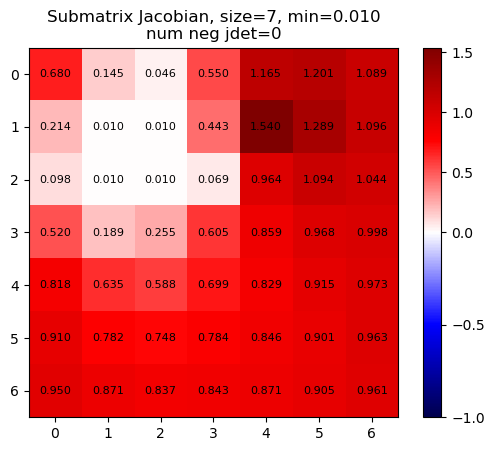

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


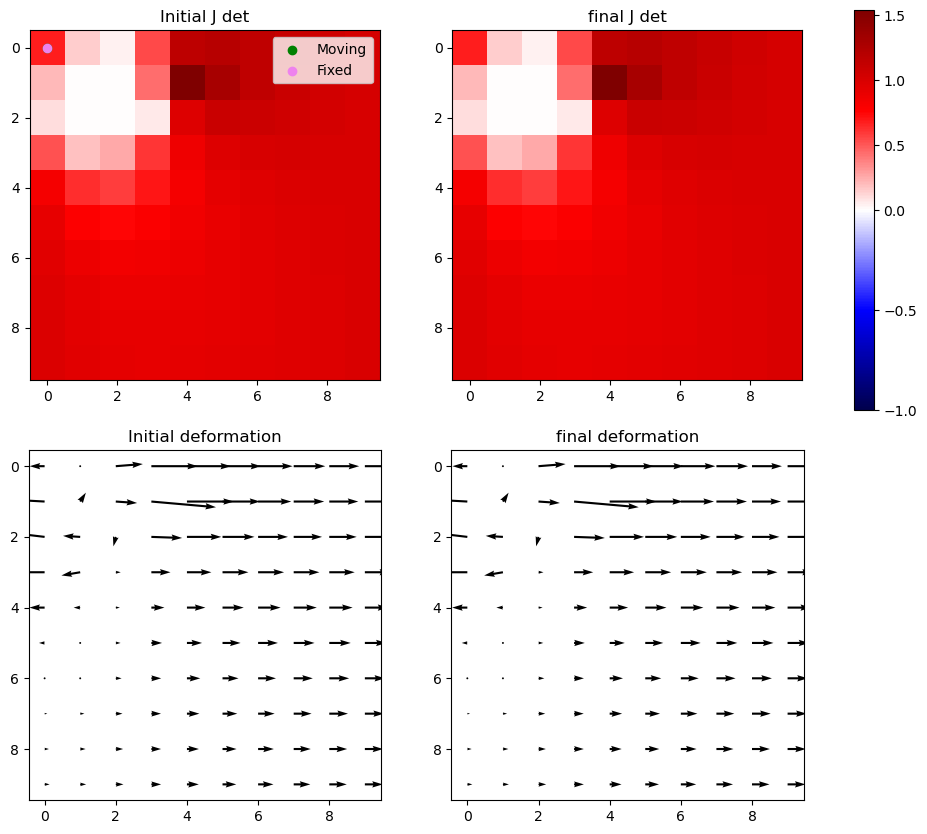

Iter 41: For index (2, 1), window size increased to 9 at iter 3


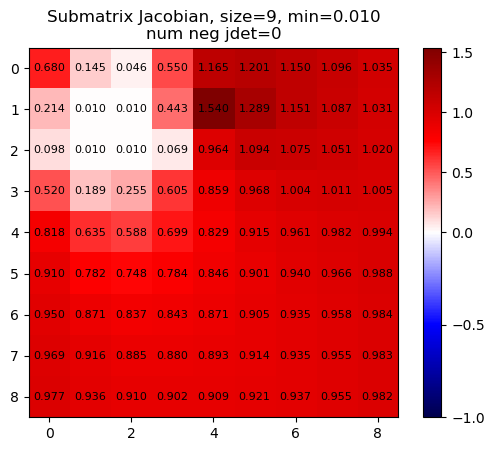

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


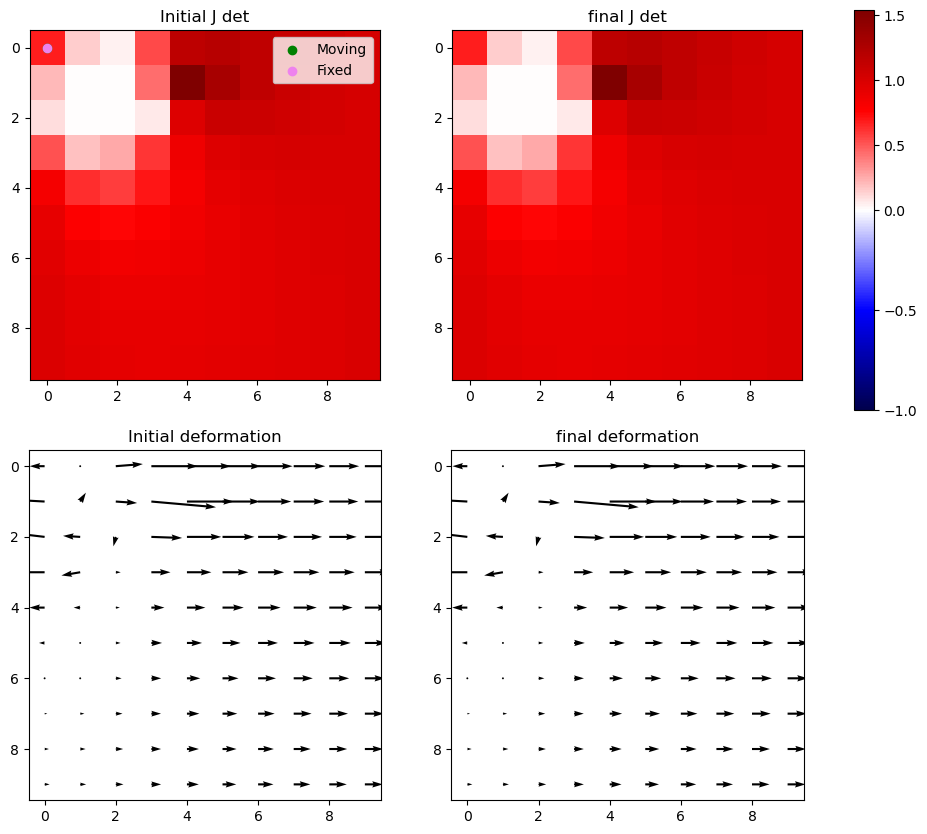

Iter 41 with 0 -ve jacs



Iter 42: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


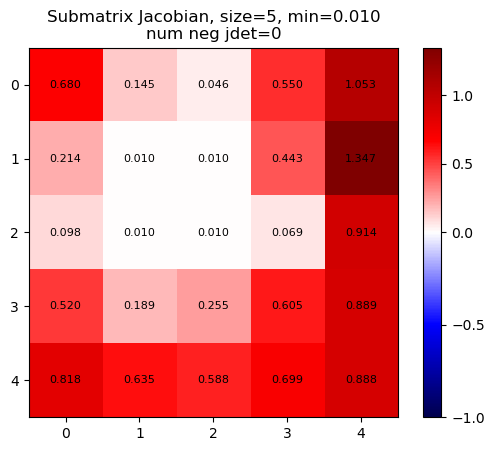

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


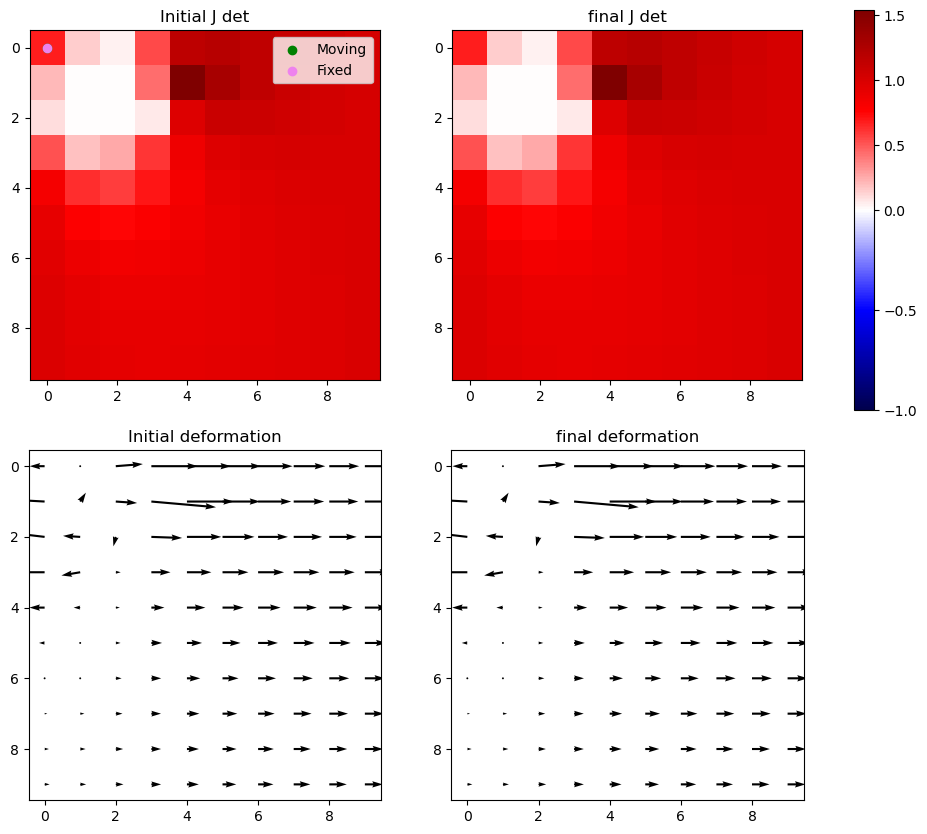

Iter 42: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


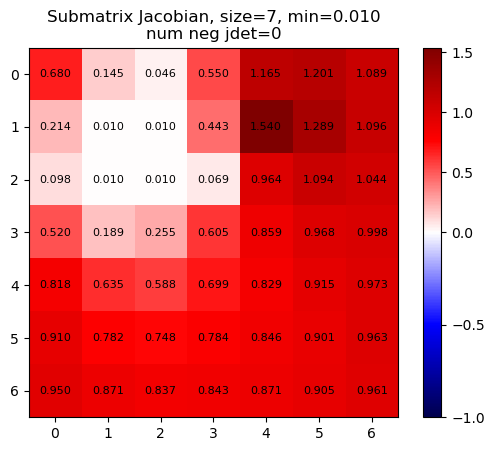

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


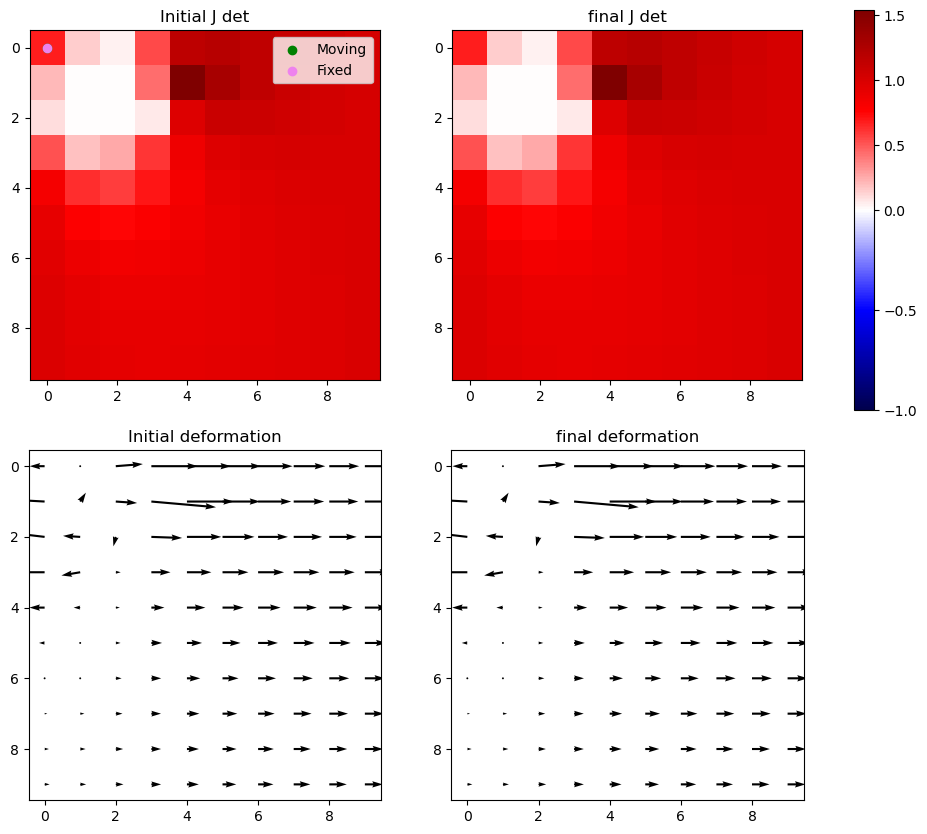

Iter 42: For index (2, 1), window size increased to 9 at iter 3


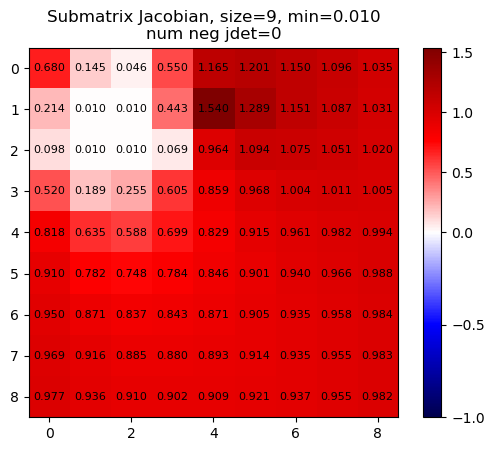

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


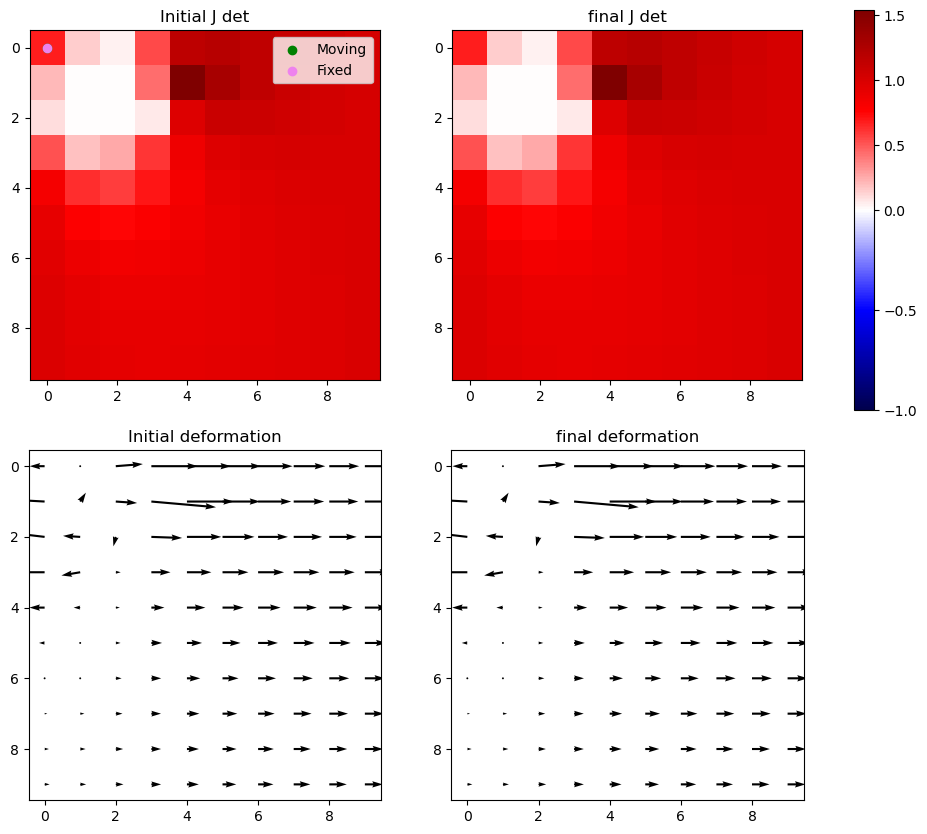

Iter 42 with 0 -ve jacs



Iter 43: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


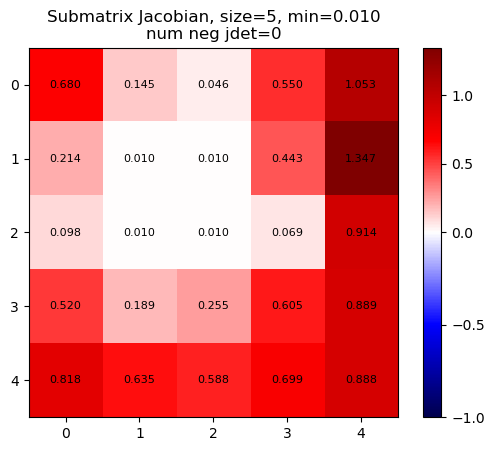

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


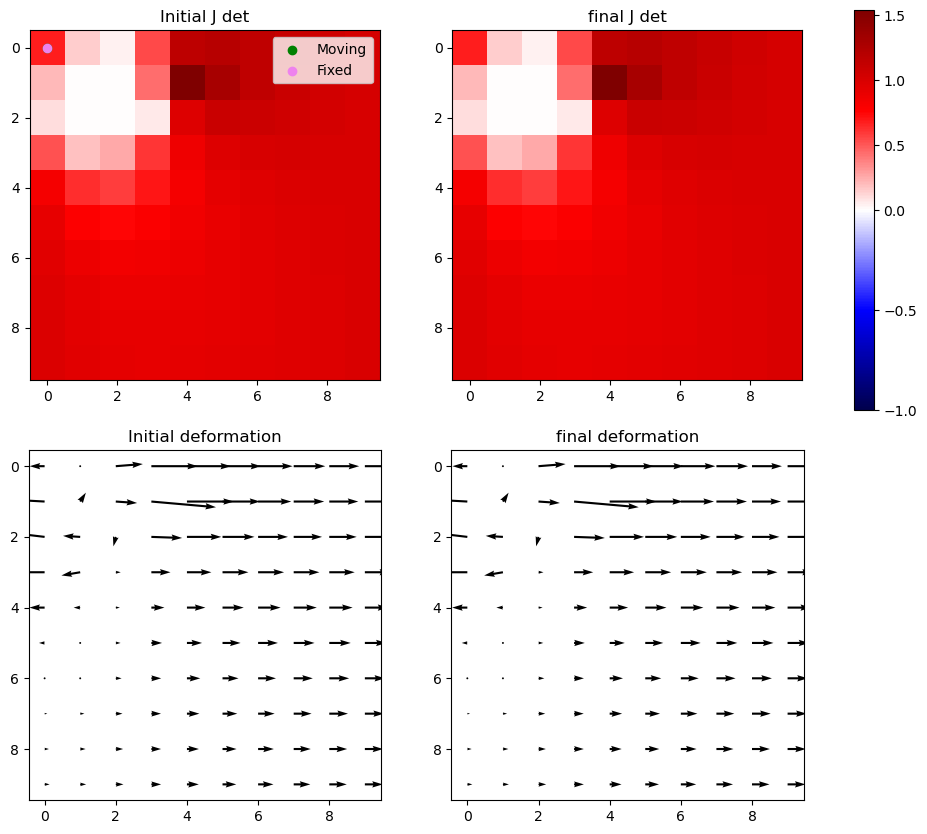

Iter 43: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


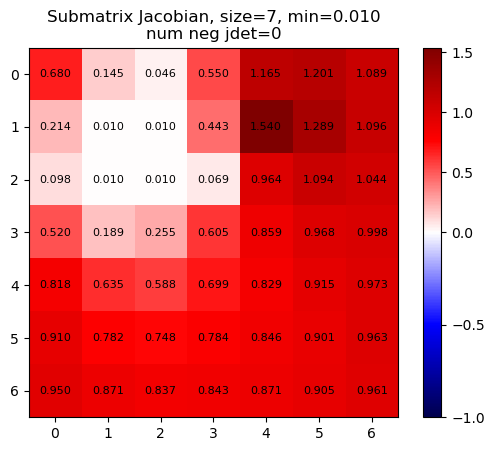

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


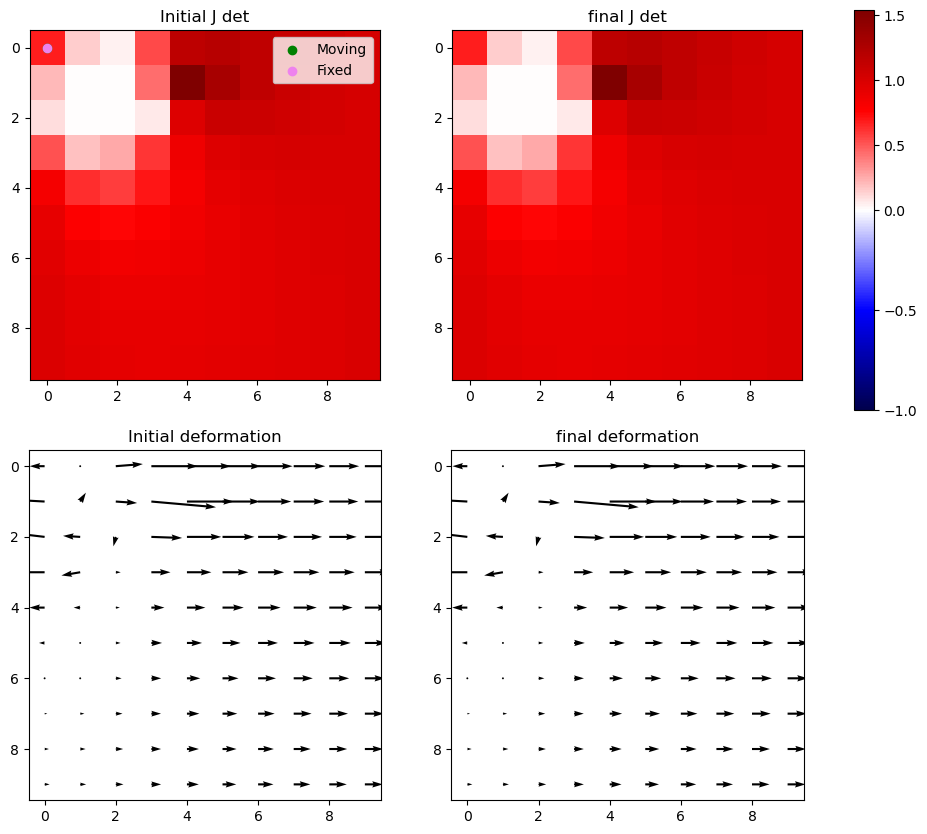

Iter 43: For index (2, 1), window size increased to 9 at iter 3


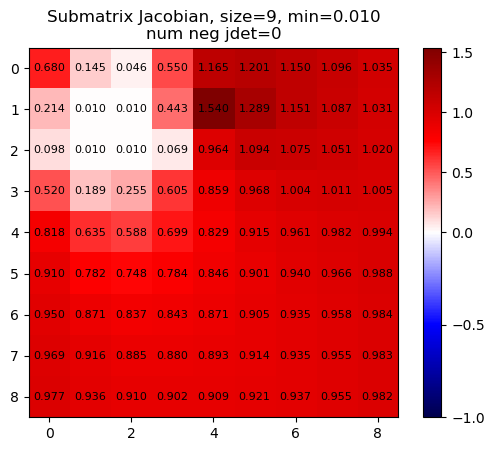

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


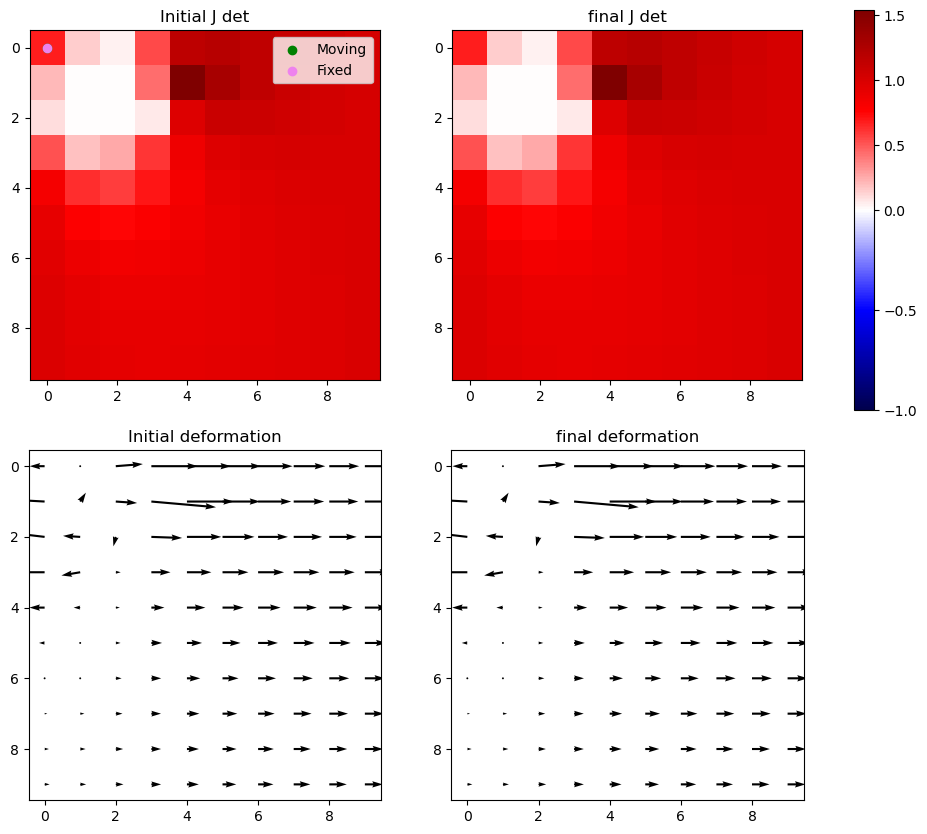

Iter 43 with 0 -ve jacs



Iter 44: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


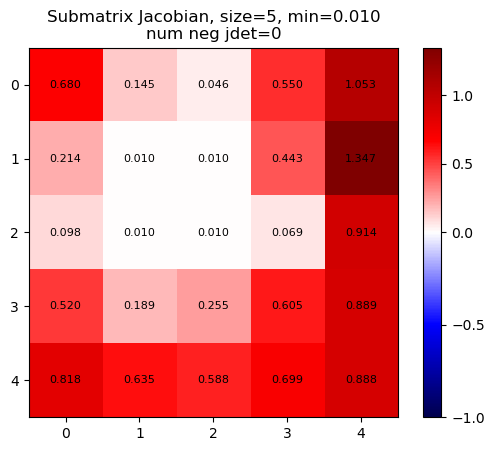

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


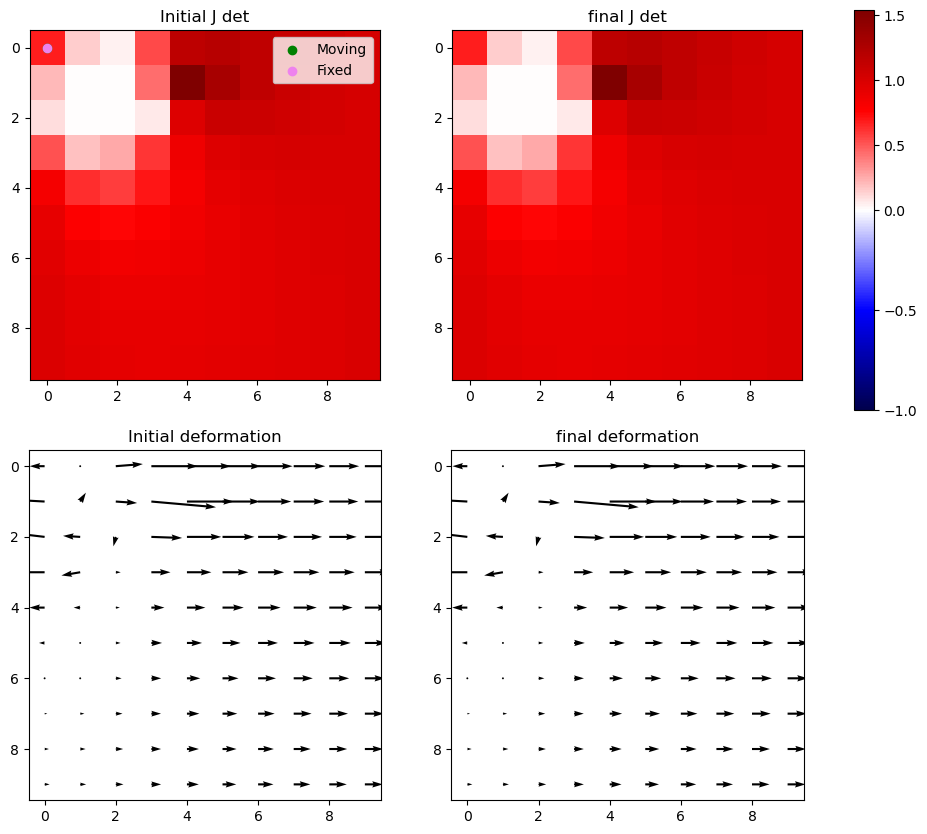

Iter 44: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


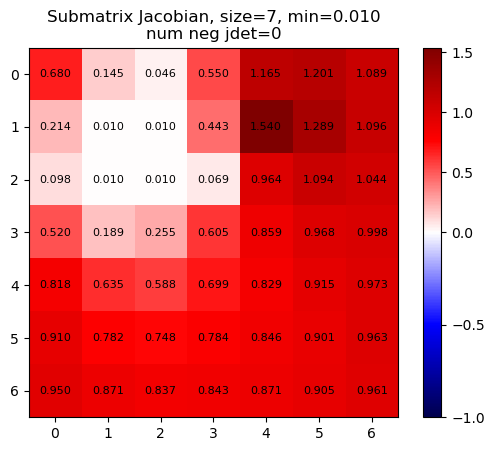

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


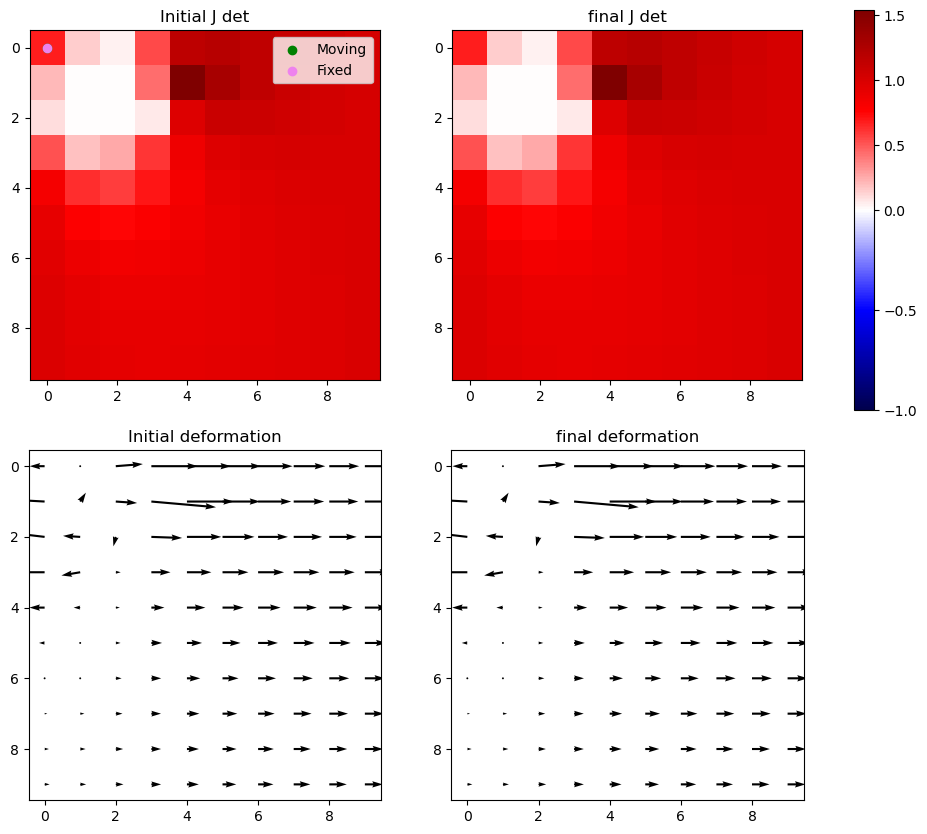

Iter 44: For index (2, 1), window size increased to 9 at iter 3


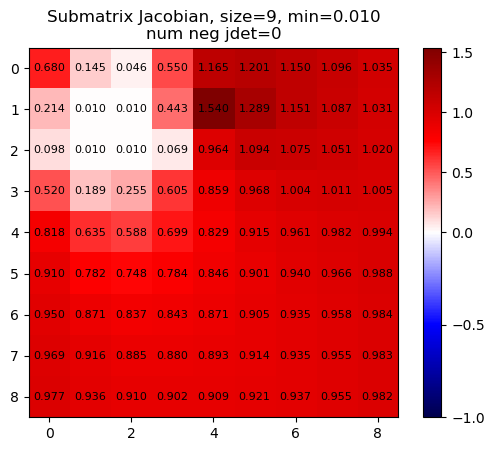

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


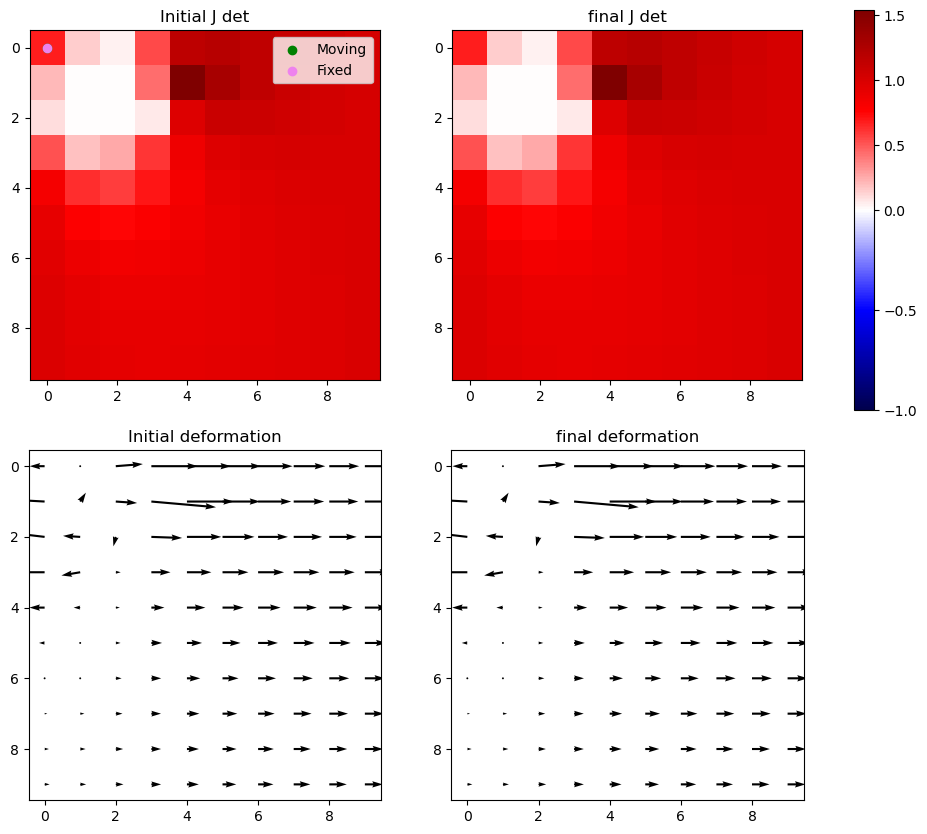

Iter 44 with 0 -ve jacs



Iter 45: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


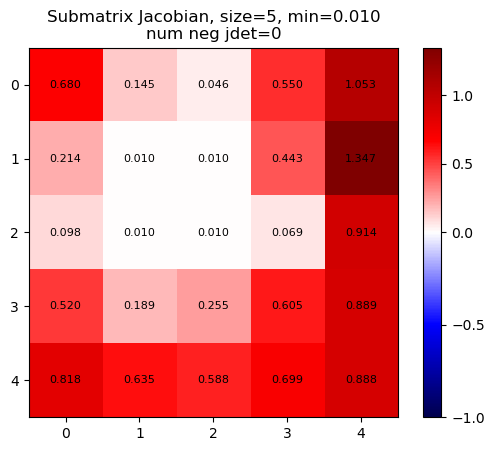

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


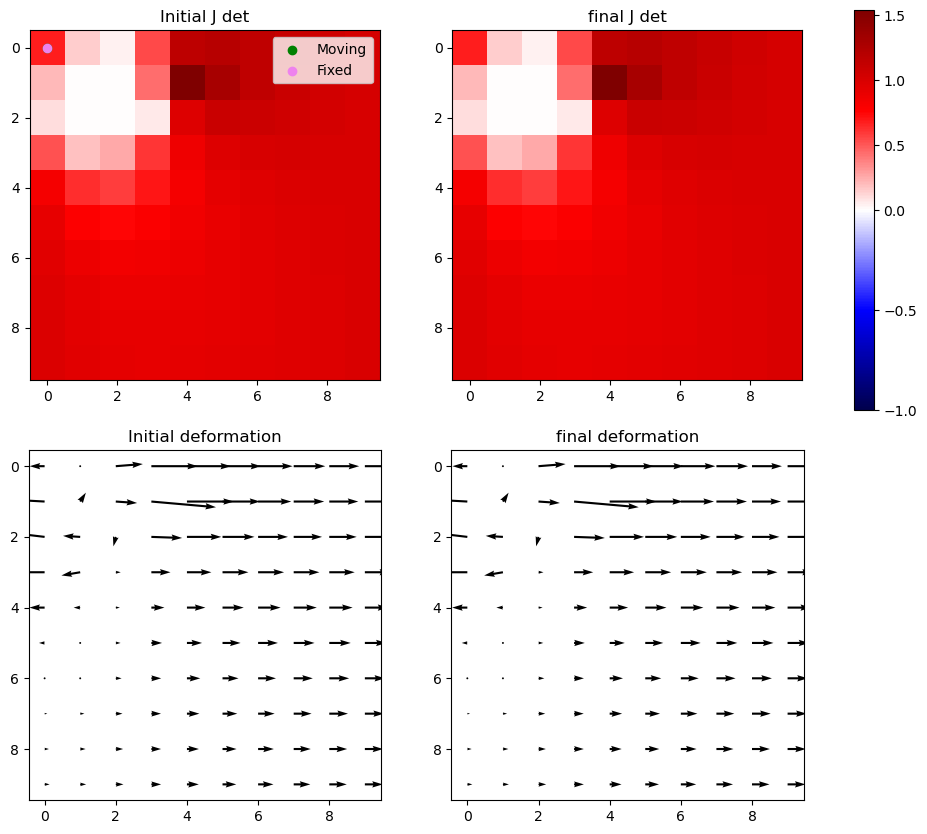

Iter 45: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


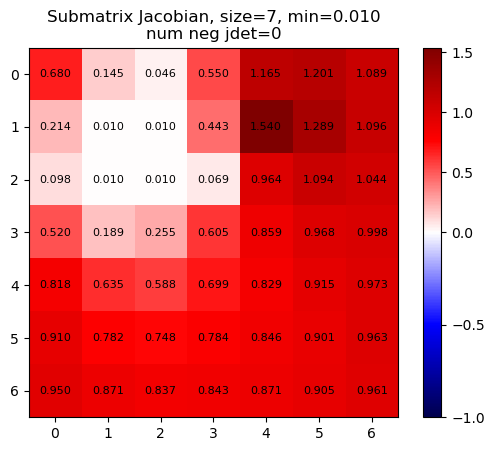

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


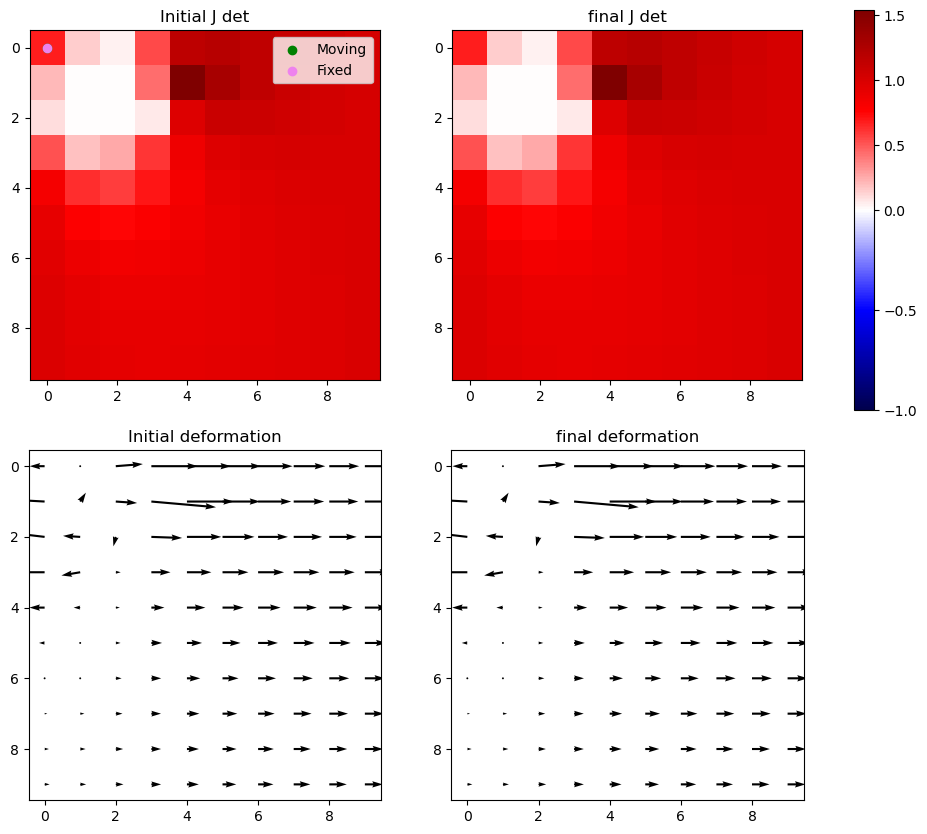

Iter 45: For index (2, 1), window size increased to 9 at iter 3


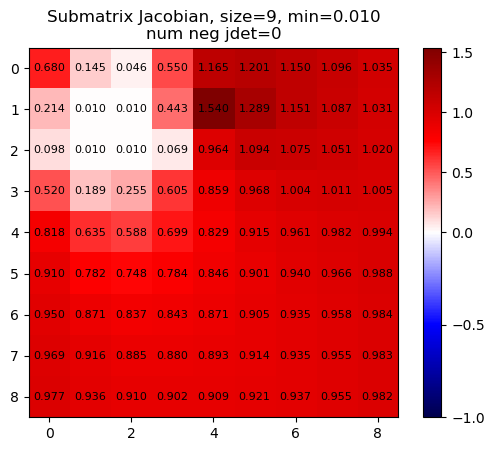

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


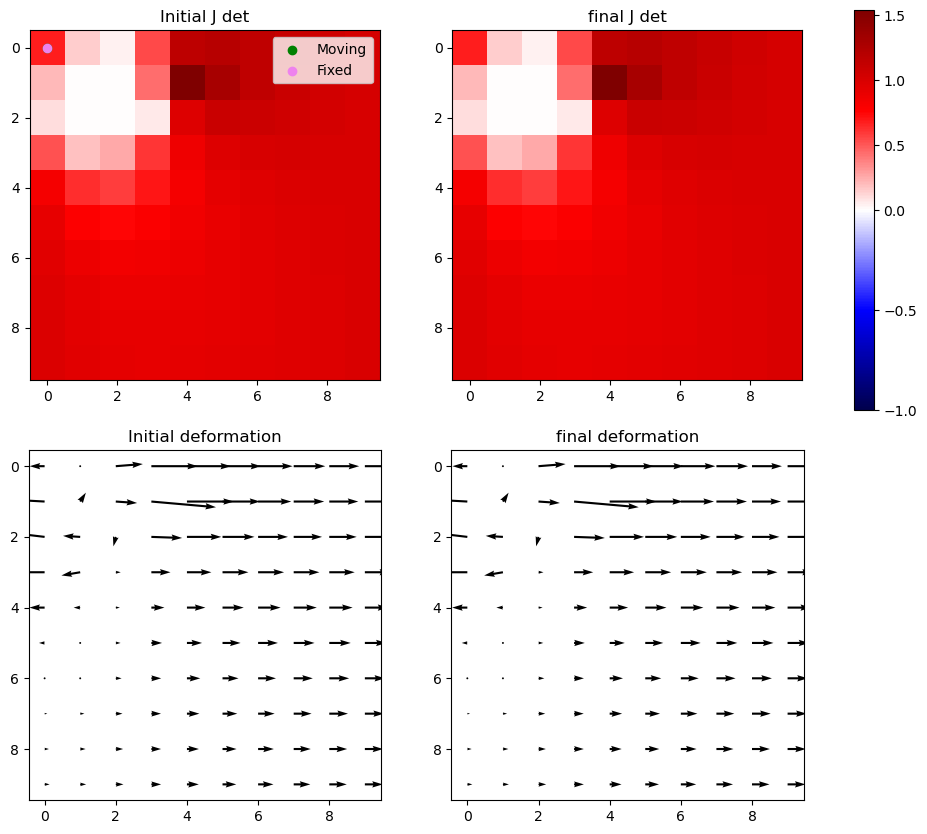

Iter 45 with 0 -ve jacs



Iter 46: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


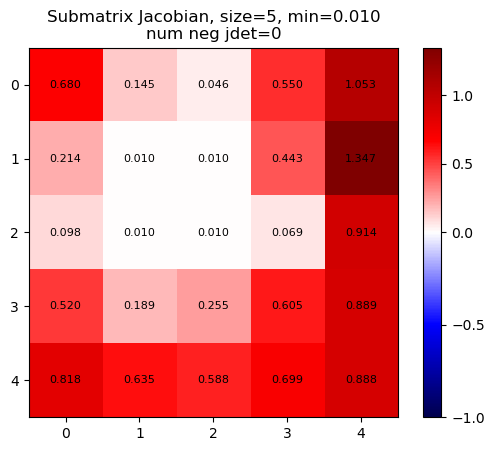

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


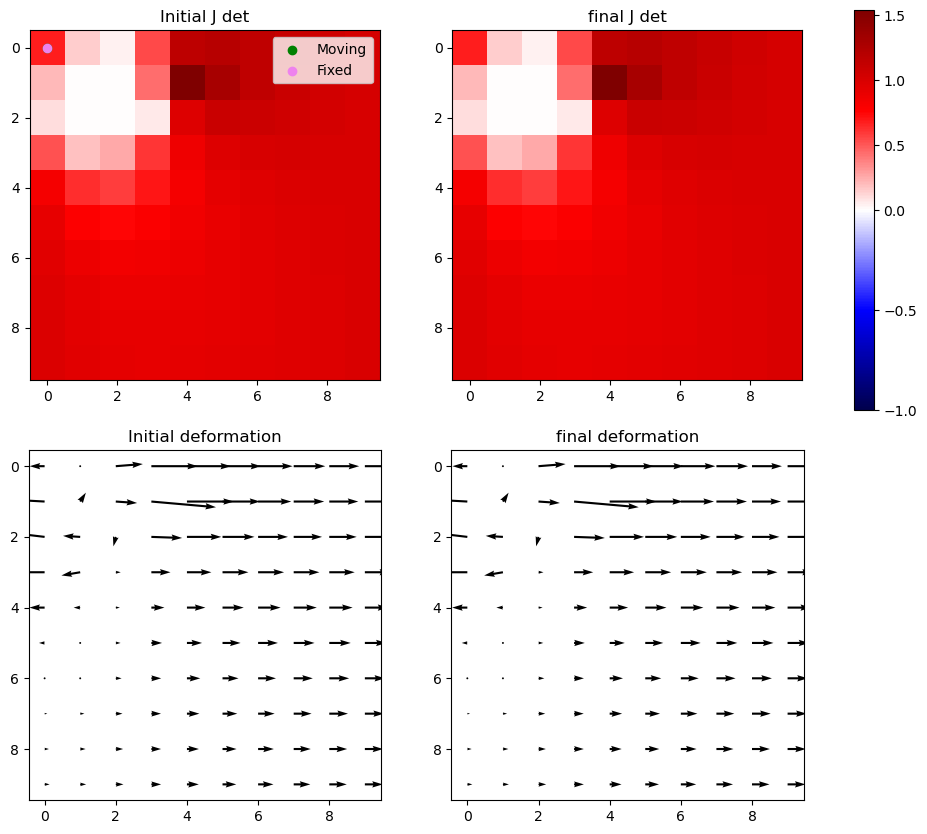

Iter 46: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


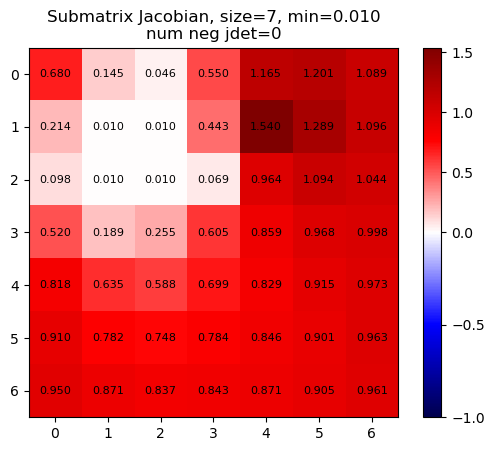

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


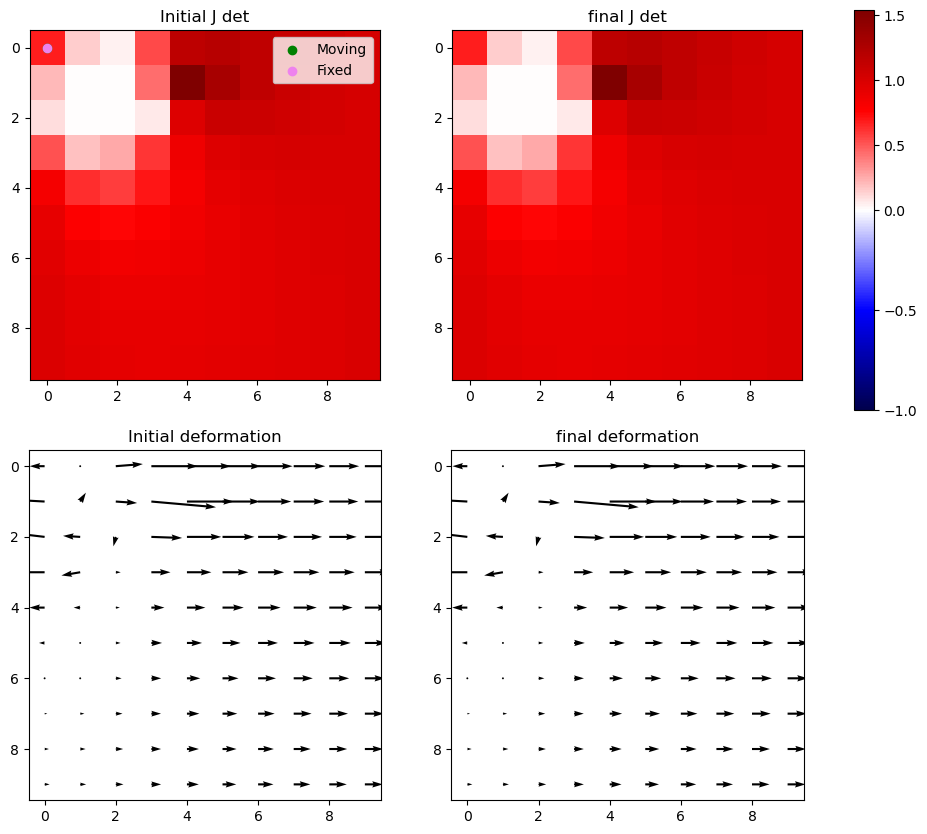

Iter 46: For index (2, 1), window size increased to 9 at iter 3


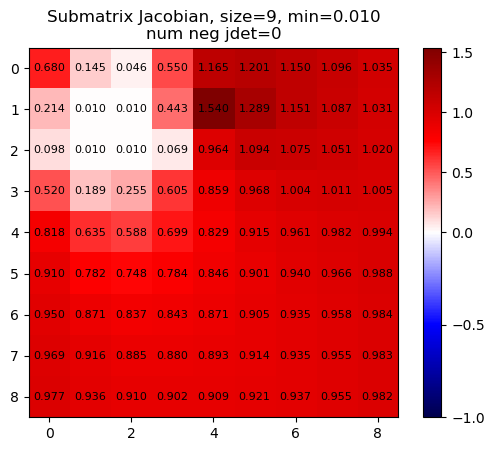

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


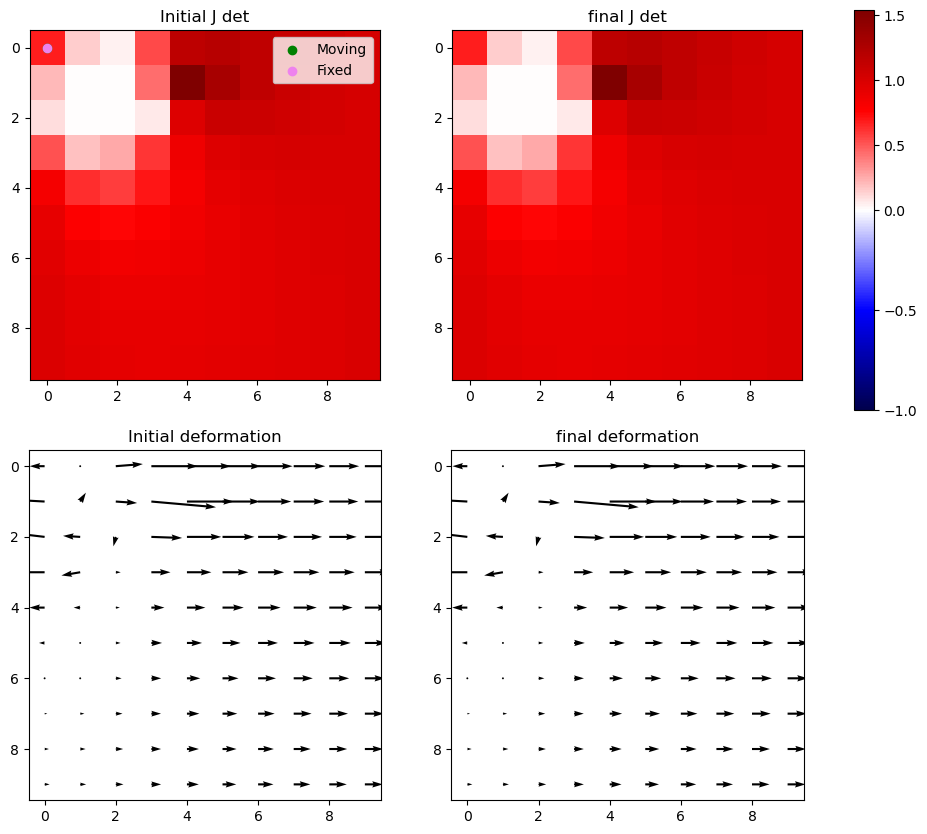

Iter 46 with 0 -ve jacs



Iter 47: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


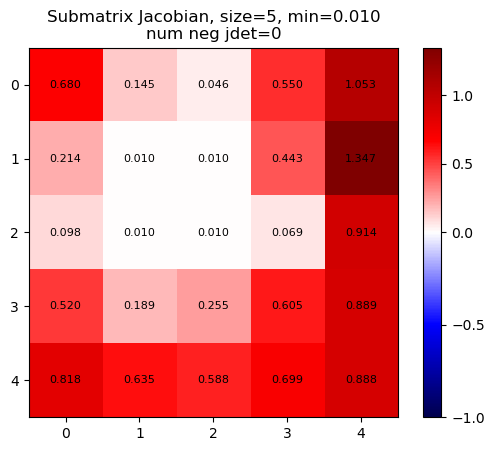

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


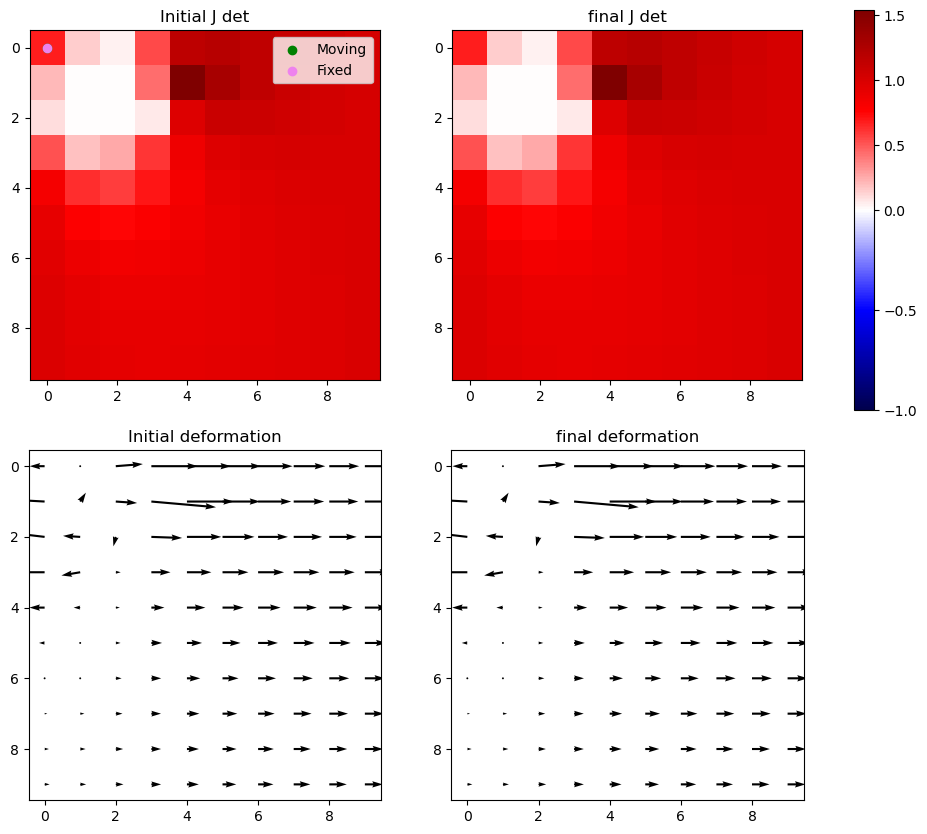

Iter 47: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


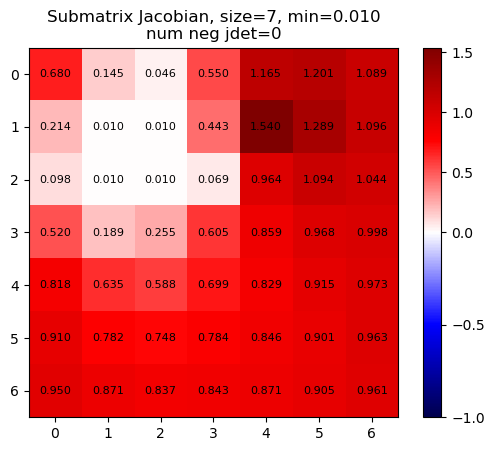

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


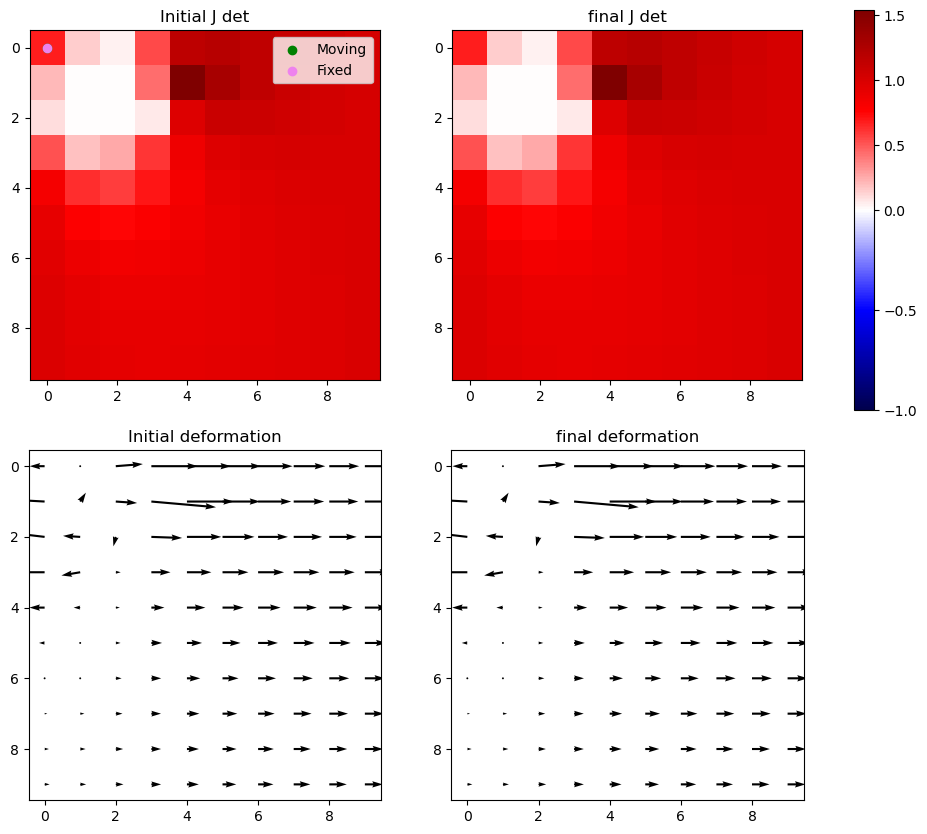

Iter 47: For index (2, 1), window size increased to 9 at iter 3


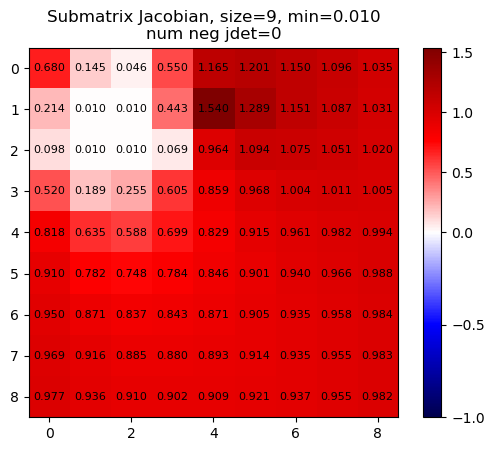

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


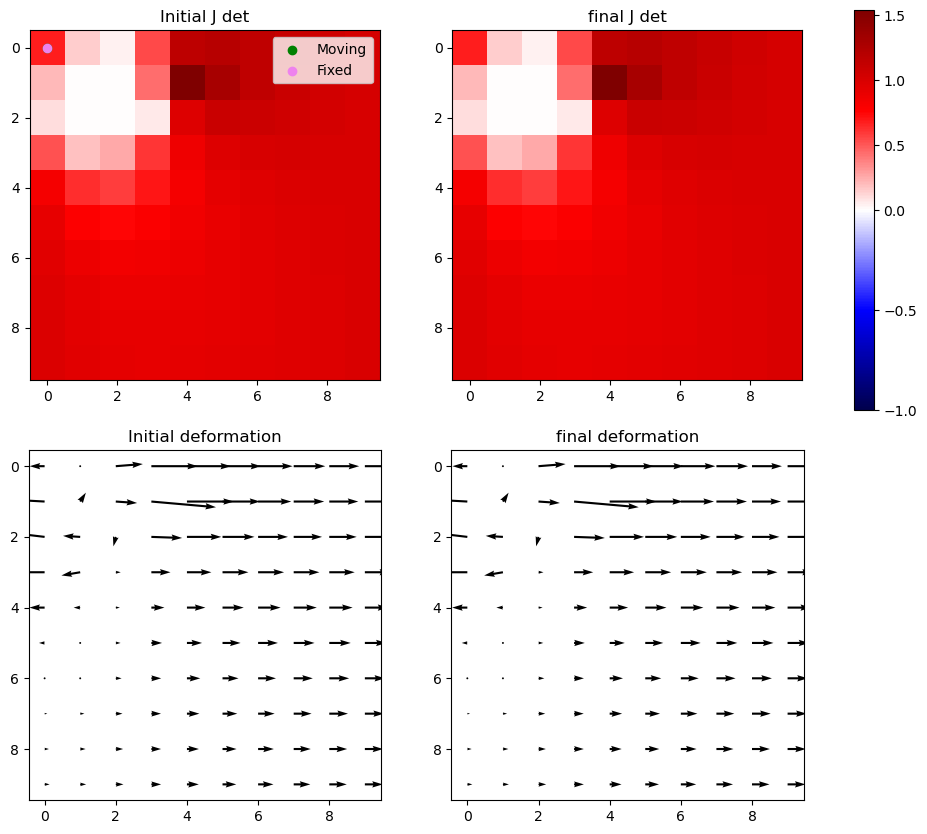

Iter 47 with 0 -ve jacs



Iter 48: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


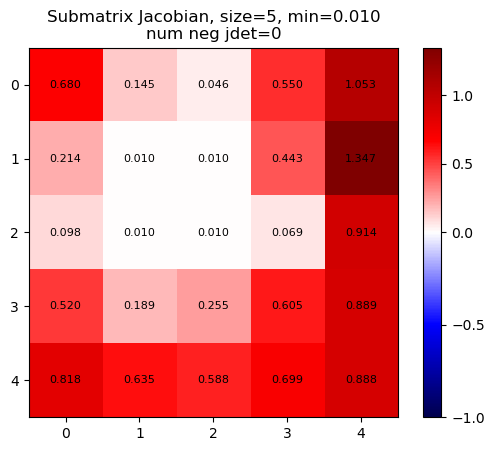

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


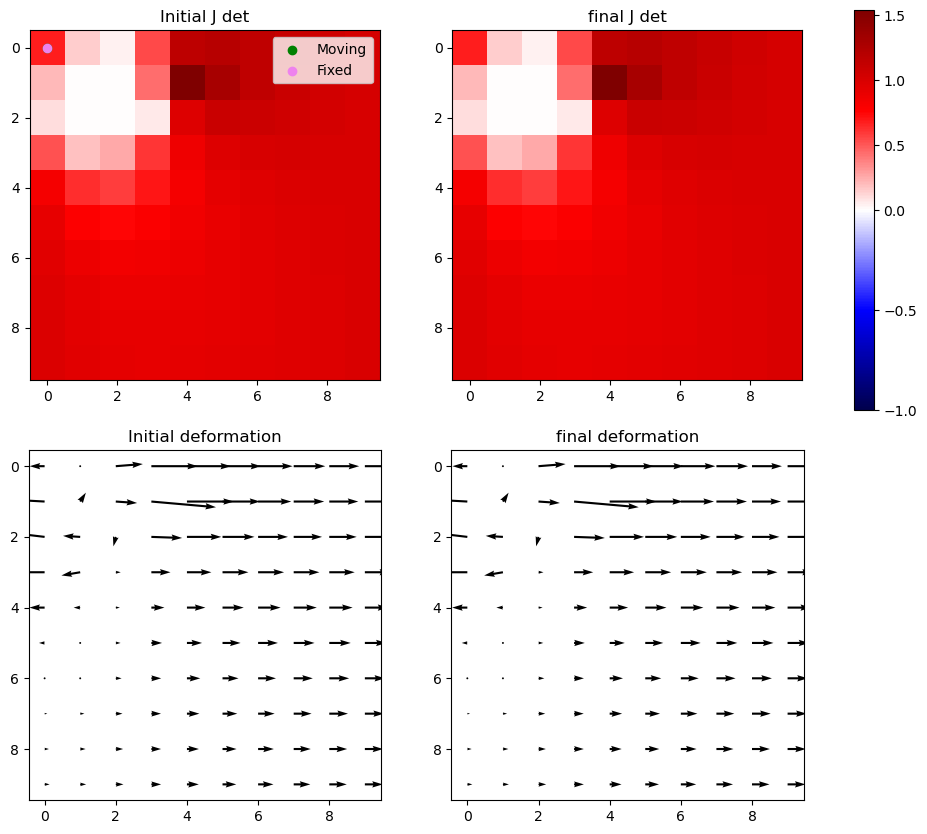

Iter 48: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


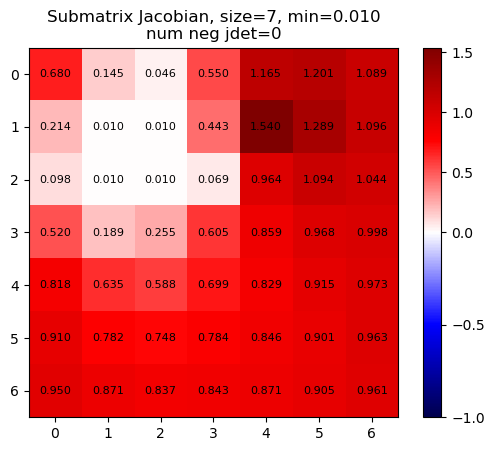

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


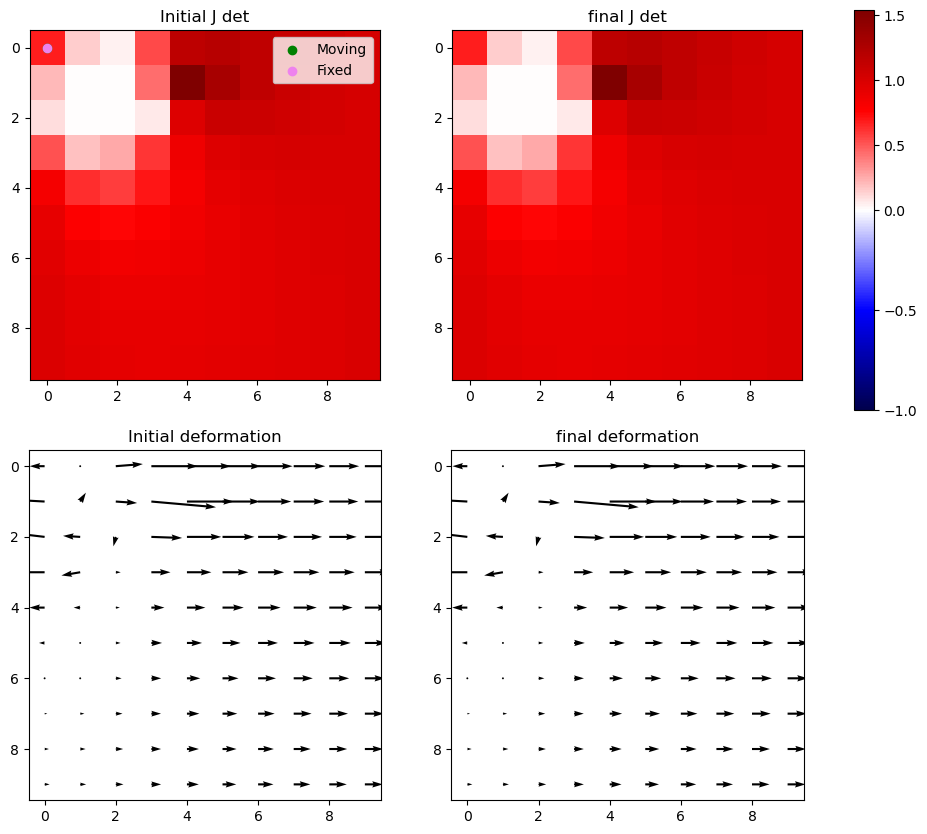

Iter 48: For index (2, 1), window size increased to 9 at iter 3


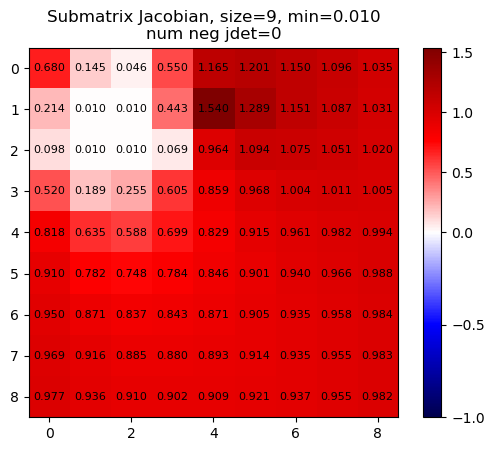

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


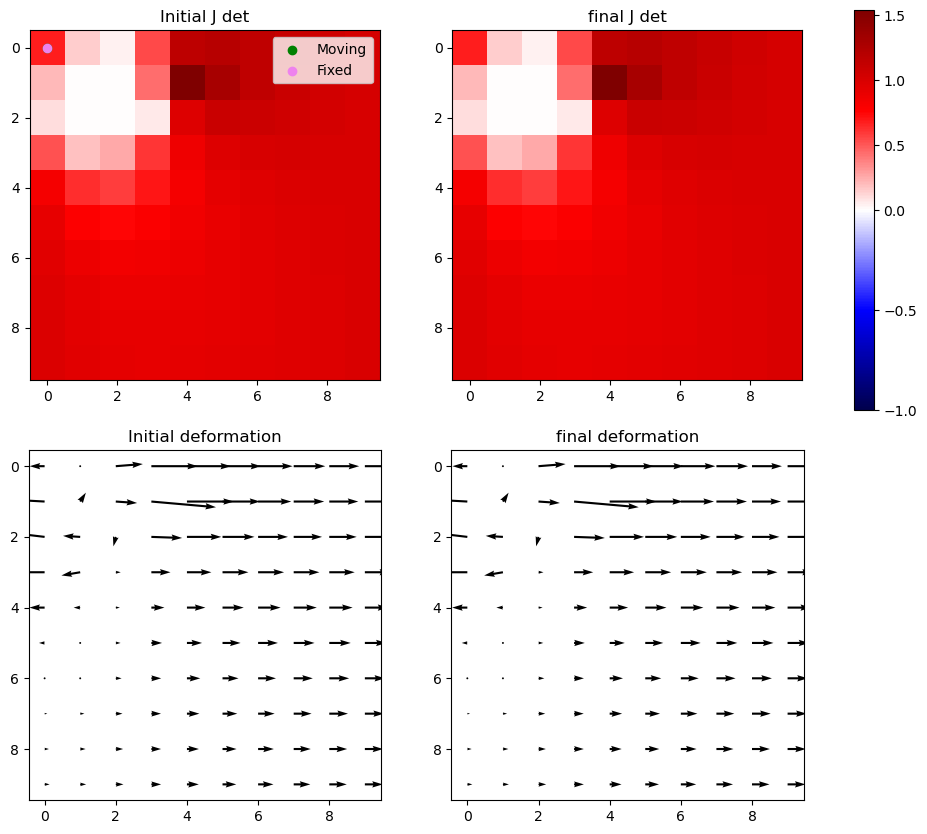

Iter 48 with 0 -ve jacs



Iter 49: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


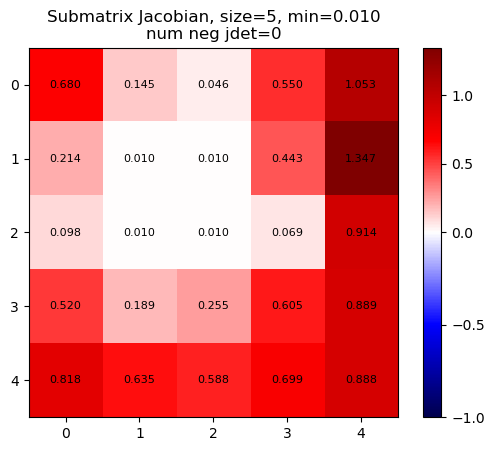

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


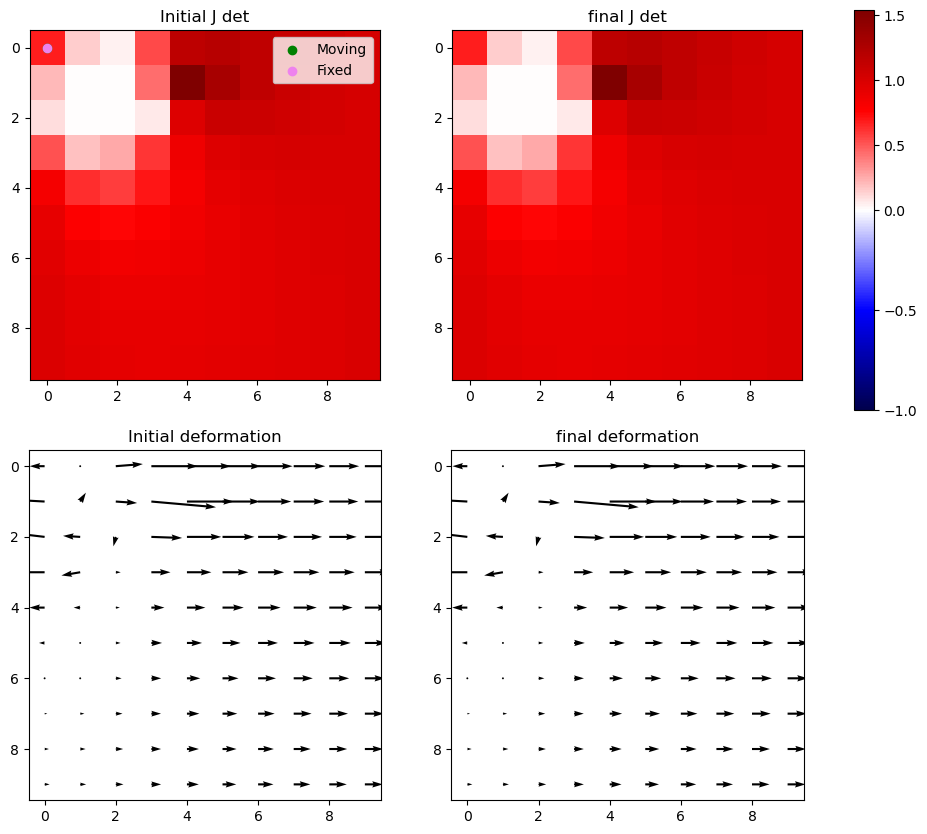

Iter 49: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


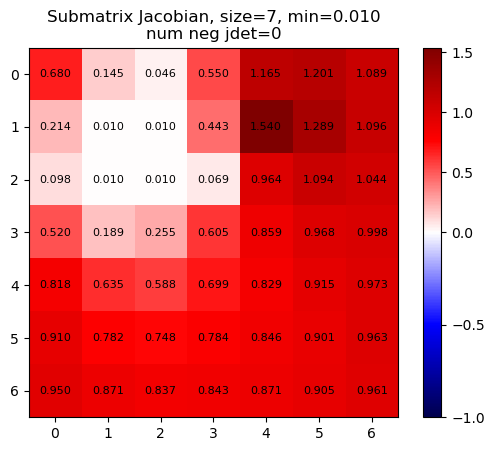

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


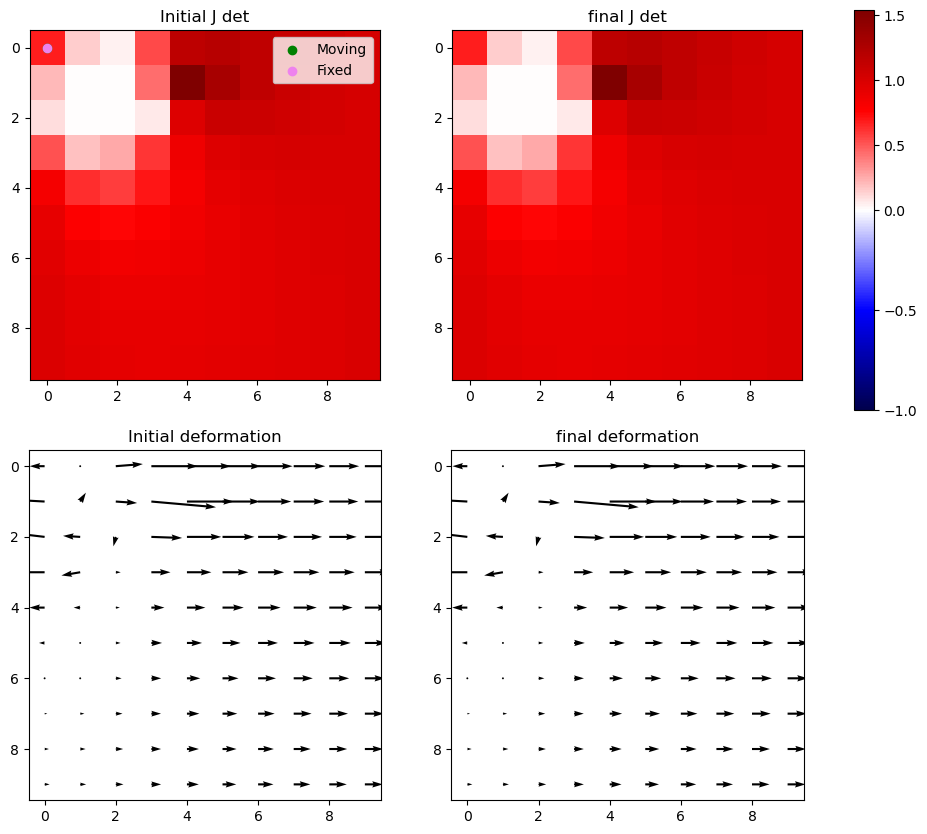

Iter 49: For index (2, 1), window size increased to 9 at iter 3


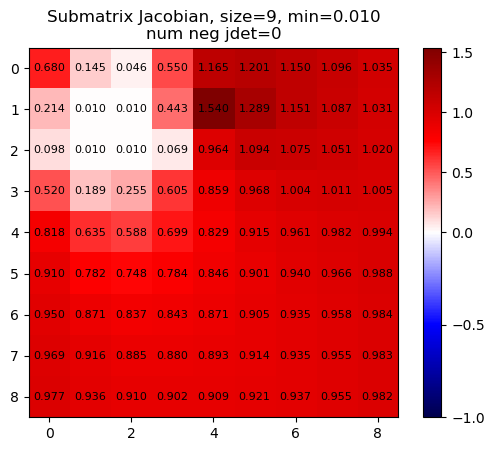

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


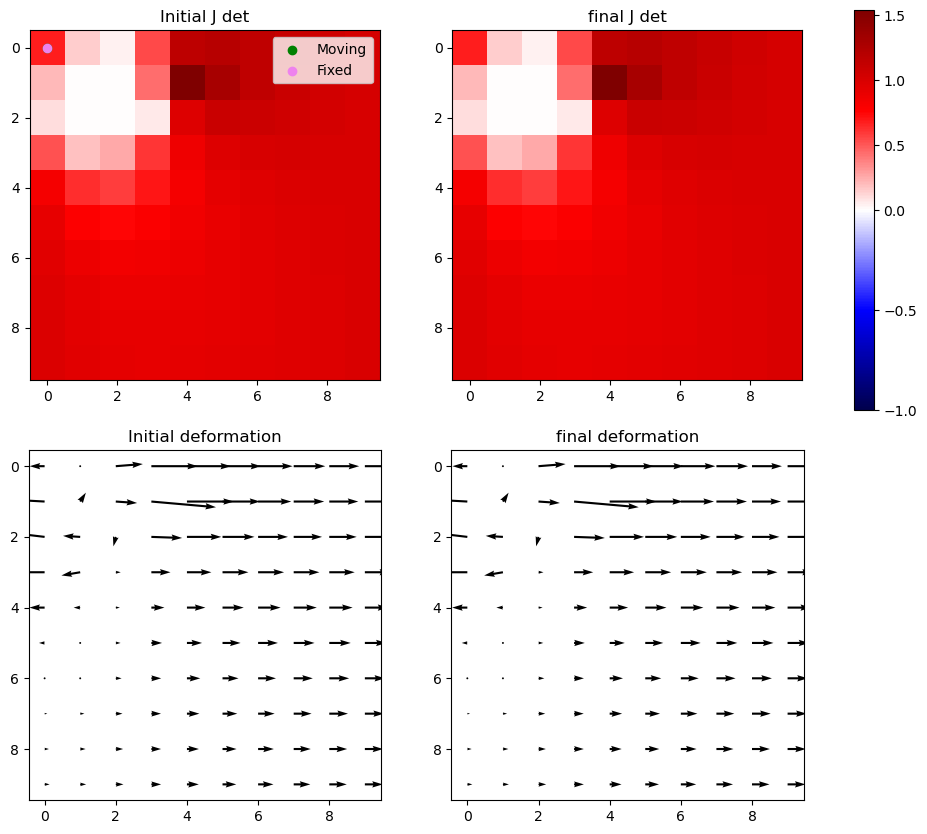

Iter 49 with 0 -ve jacs



Iter 50: Fixing index (2, 1)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


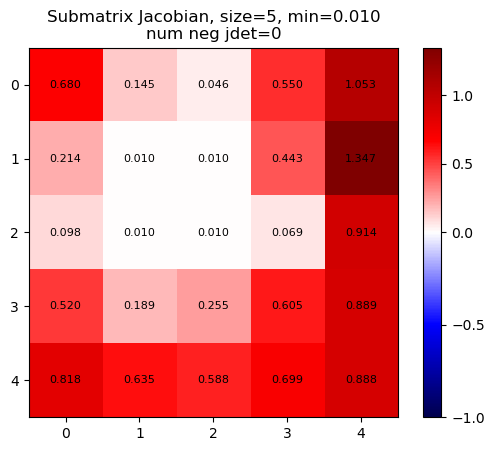

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005262
            Iterations: 1
            Function evaluations: 51
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


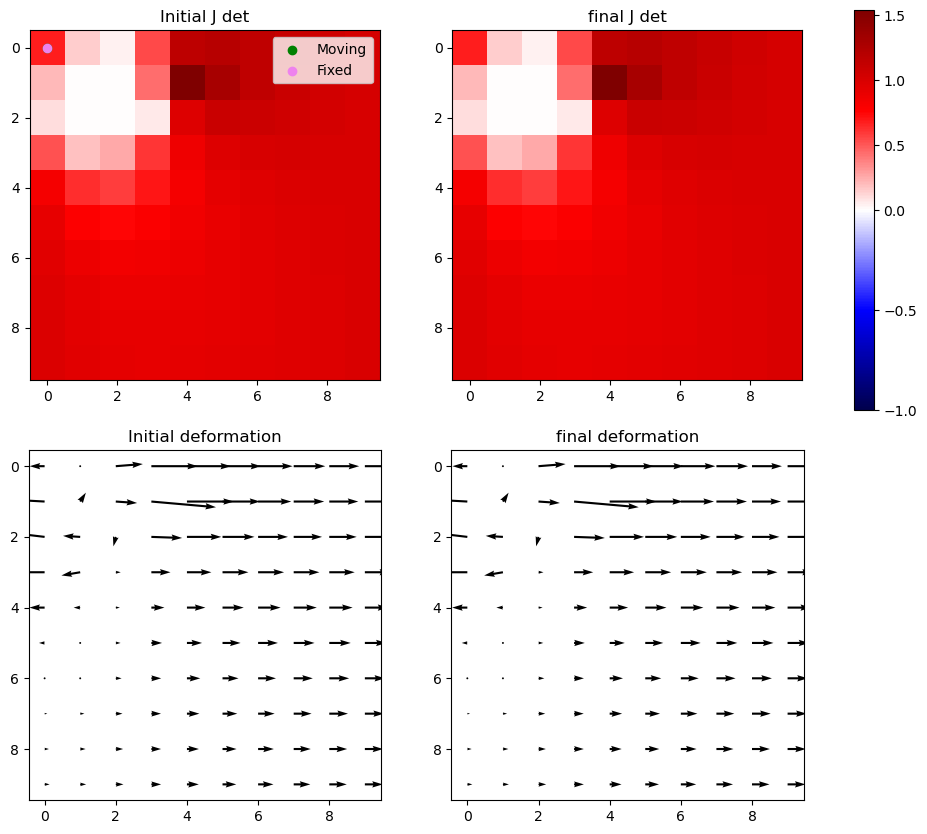

Iter 50: For index (2, 1), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]


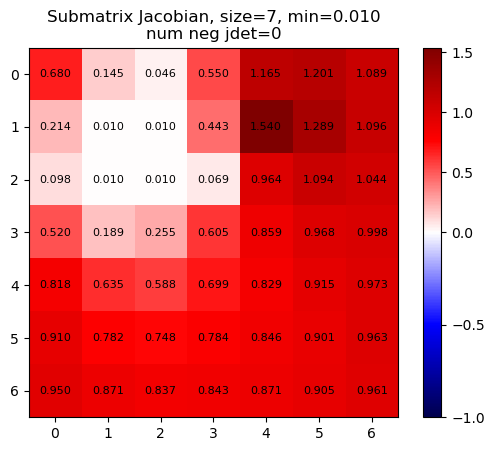

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005297
            Iterations: 1
            Function evaluations: 99
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


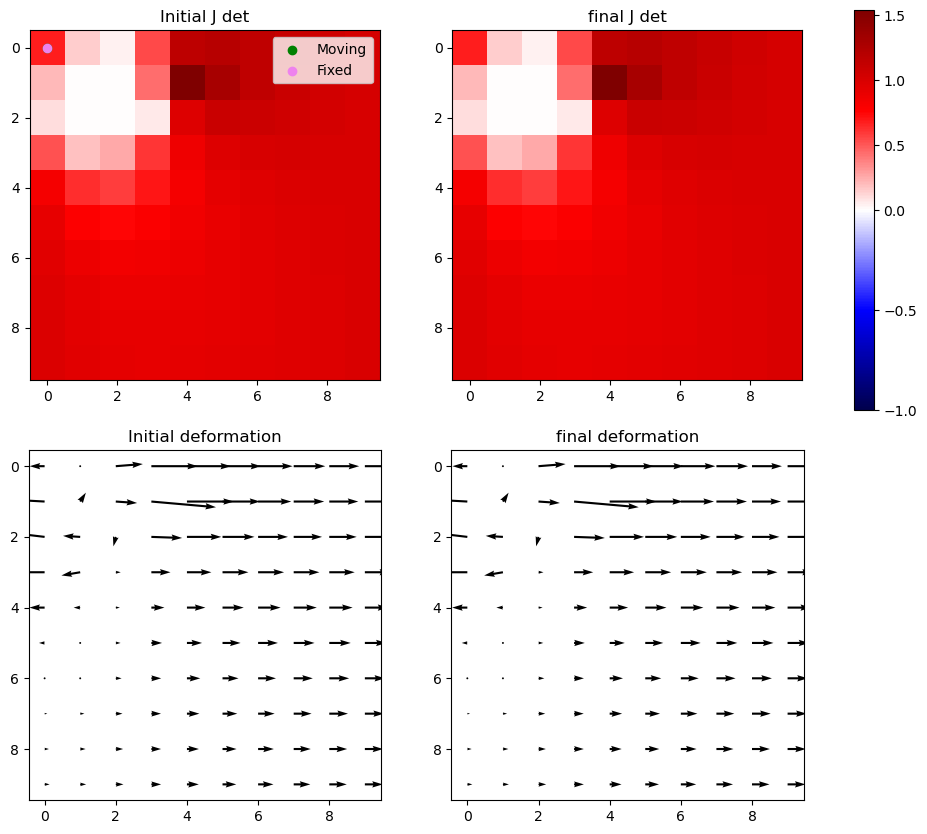

Iter 50: For index (2, 1), window size increased to 9 at iter 3


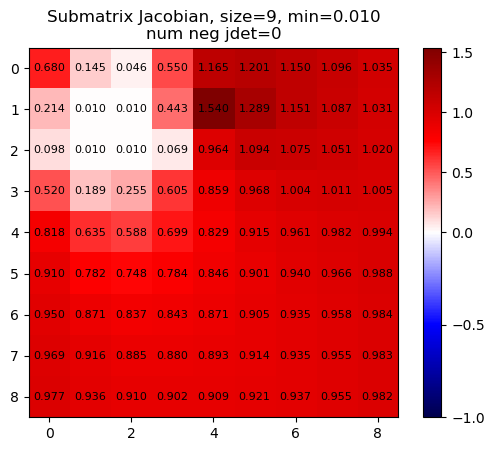

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.2134565775005342
            Iterations: 1
            Function evaluations: 163
            Gradient evaluations: 1
            x-def               y-def           jacobian         
              min       max       min       max      min      max
initial -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
final   -2.709375  2.555239 -0.395733  0.372456     0.01  1.53959
meshgrid shape for plot: (10, 10)


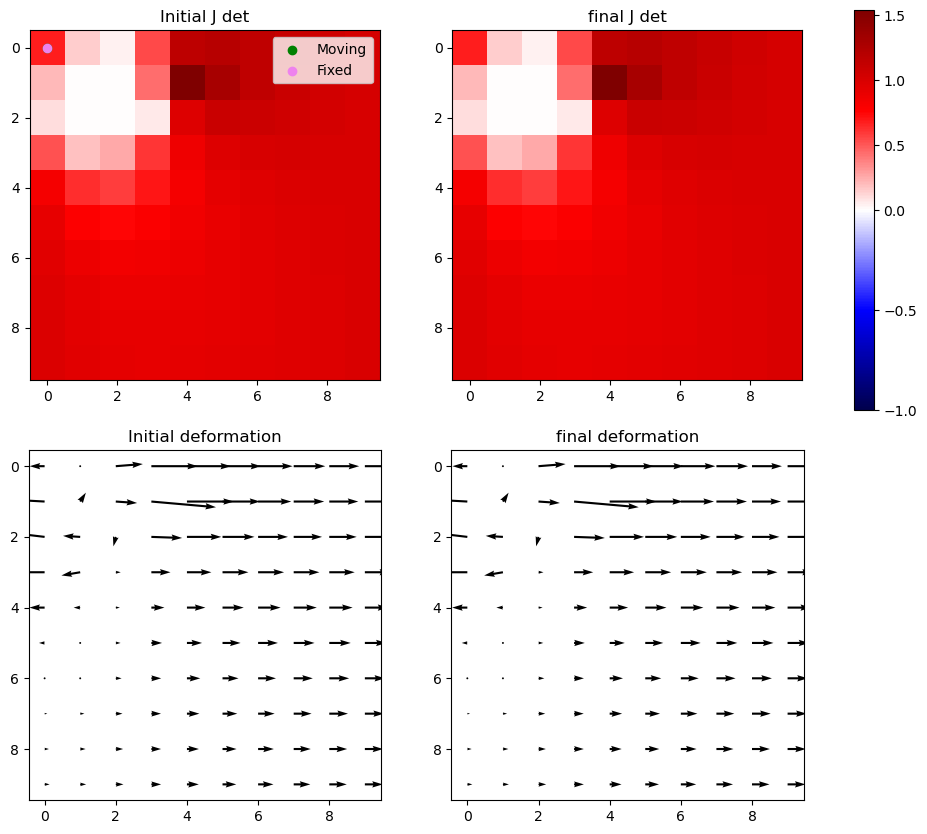

Iter 50 with 0 -ve jacs
Deviation from initial = 1.2134565775005344
Changed number of -ve jacobians from 5 to 0
Time taken for iter SLSQP optimisation: 168.2640552520752s
            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -2.999822  2.999822  0.000000  0.000000 -0.730373  1.709059
final   -2.709375  2.555239 -0.395733  0.372456  0.010000  1.539590
meshgrid shape for plot: (10, 10)


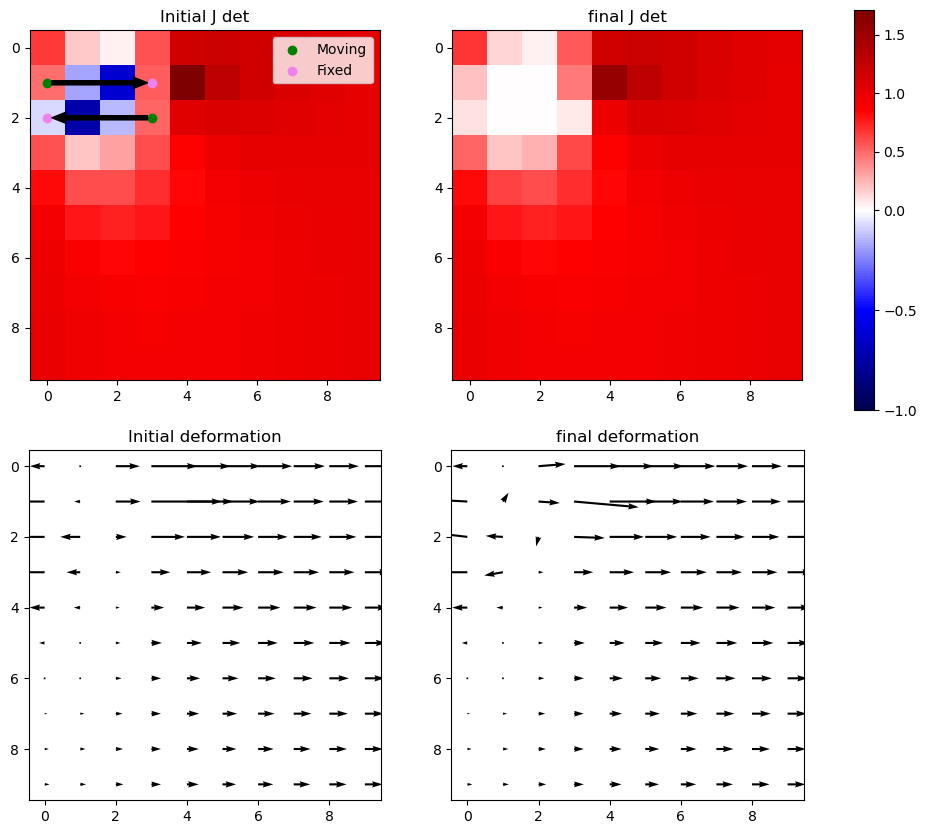

In [115]:
msample = np.array([
    [0, 1, 0],
    [0, 2, 3],
])
fsample = np.array([
    [0, 1, 3],
    [0, 2, 0],
])

fixed_sample = np.zeros((1, 10, 10)) # depth, rows, cols

run_lapl_and_correction(fixed_sample, msample, fsample)

# takes 15 mins and does not conclude on full 20x40 constraints
# 1.5mins on 10x10 constraints
# reduce constraints
# (10,5) - 50 vs 5 - 3.9s vs 0.15s
# (5,5) - 25 vs 5 - 0.35s vs 0.0645s
# (10, 10) - 100 vs 5 - 50s vs 0.46s
# (20, 20) - 400 vs 5 - waited for full one to run for 20min vs 1.5min

# 20x40 with 5 random constraints - 10.5 mins
# 20x40 run over the full thing - 174 min does not finish

deformation shape: (3, 1, 10, 10)
[[[[ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.          0.          0.        ]
   [ 0.          0.          0.          0.          0.          0.          0.          0.

C:\Users\Andy\AppData\Local\Temp\ipykernel_9292\3501370654.py:46: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


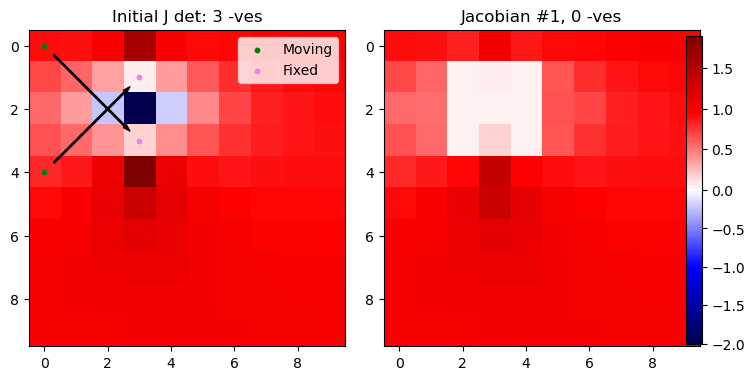

            x-def               y-def            jacobian          
              min       max       min       max       min       max
initial -3.013711 -2.977314 -2.999803  2.999803 -2.003395  1.893126
final   -3.940395 -2.072205 -1.939688  1.864271  0.050000  1.366055
meshgrid shape for plot: (10, 10)
[[[ 0.89126076  0.88649201  0.96400756  1.58394211  0.97360102  0.9065901   0.92879864  0.95207293  0.96609706  0.97211199]
  [ 0.67434955  0.56825474  0.34437072  0.07246907  0.36555203  0.62007237  0.77637465  0.86184539  0.90500563  0.9221917 ]
  [ 0.56162551  0.36726659 -0.22374717 -2.0033955  -0.19642219  0.43519678  0.69436959  0.81377889  0.86940417  0.89126523]
  [ 0.64182308  0.56192132  0.39110896  0.17568873  0.42200789  0.62541714  0.75434954  0.82965913  0.86984911  0.88682344]
  [ 0.79774359  0.84437209  1.05607877  1.8931261   1.08067768  0.891393    0.86707284  0.88018585  0.89376049  0.90111237]
  [ 0.90823824  0.96275502  1.09845439  1.31025733  1.11602031  0.99152123

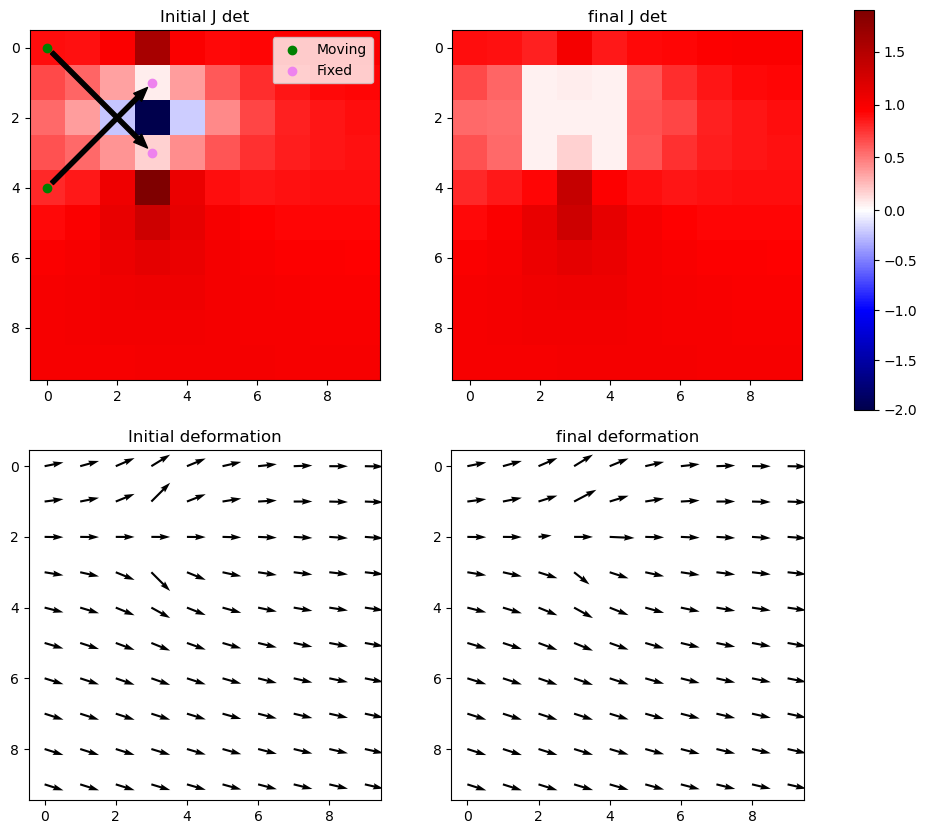

In [12]:
msample = np.array([
    [0, 0, 0],
    [0, 4, 0],
])
fsample = np.array([
    [0, 3, 3],
    [0, 1, 3],
])

fixed_sample = np.zeros((1, 10, 10))
#run_lapl_and_correction(fixed_sample, msample, fsample)
deformation_i, A, Zd, Yd, Xd = laplacian.sliceToSlice3DLaplacian(fixed_sample, msample, fsample)
print(f'deformation shape: {deformation_i.shape}')
print(deformation_i)
phi_corrected, jacobians = iterative_with_jacobians2(deformation_i, methodName='SLSQP')
plot_jacobians_iteratively(jacobians, msample, fsample, methodName='SLSQP')
plot_deformations(msample, fsample, deformation_i, phi_corrected, figsize=(10,10))
print(jacobian_det2D(deformation_i[1:]))

deformation shape: (3, 1, 10, 10)
deformation_i shape: (3, 1, 10, 10), phi_init shape: (2, 10, 10)
Iter 1: Fixing index (1, 3)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.8589860005543305
            Iterations: 13
            Function evaluations: 676
            Gradient evaluations: 13
Iter 1: For index (1, 3), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 0.9043351246327849
            Iterations: 7
            Function evaluations: 693
            Gradient evaluations: 7
Iter 1 with 0 -ve jacs
Deviation from initial = 0.904335124632785
Chang

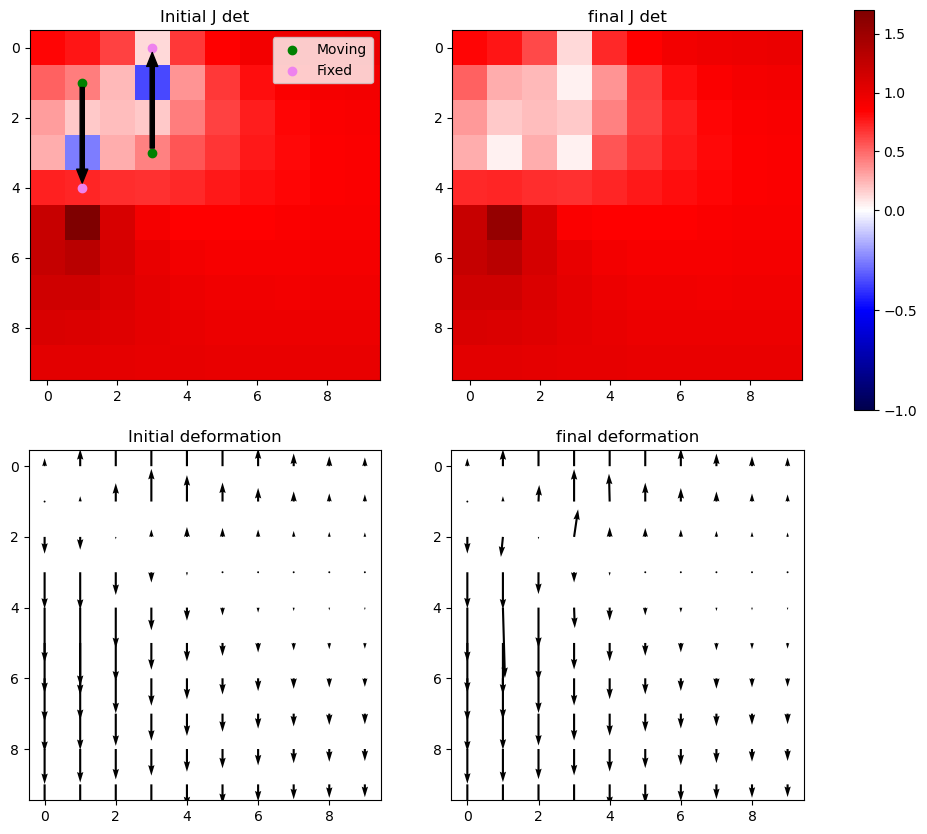

In [13]:
msample = np.array([
    [0, 1, 1],
    [0, 3, 3],
])
fsample = np.array([
    [0, 4, 1],
    [0, 0, 3],
])

fixed_sample = np.zeros((1, 10, 10))
#test_grad(fixed_sample, msample, fsample)
#test_scipy(fixed_sample, msample, fsample)
run_lapl_and_correction(fixed_sample, msample, fsample)

deformation shape: (3, 1, 10, 10)
deformation_i shape: (3, 1, 10, 10), phi_init shape: (2, 10, 10)
Deviation from initial = 0.0
Changed number of -ve jacobians from 0 to 0
Time taken for iter SLSQP optimisation: 0.003998279571533203s
            x-def          y-def       jacobian          
              min      max   min  max       min       max
initial -3.999719 -0.99993   0.0  0.0  0.008381  1.445456
final   -3.999719 -0.99993   0.0  0.0  0.008381  1.445456
meshgrid shape for plot: (10, 10)


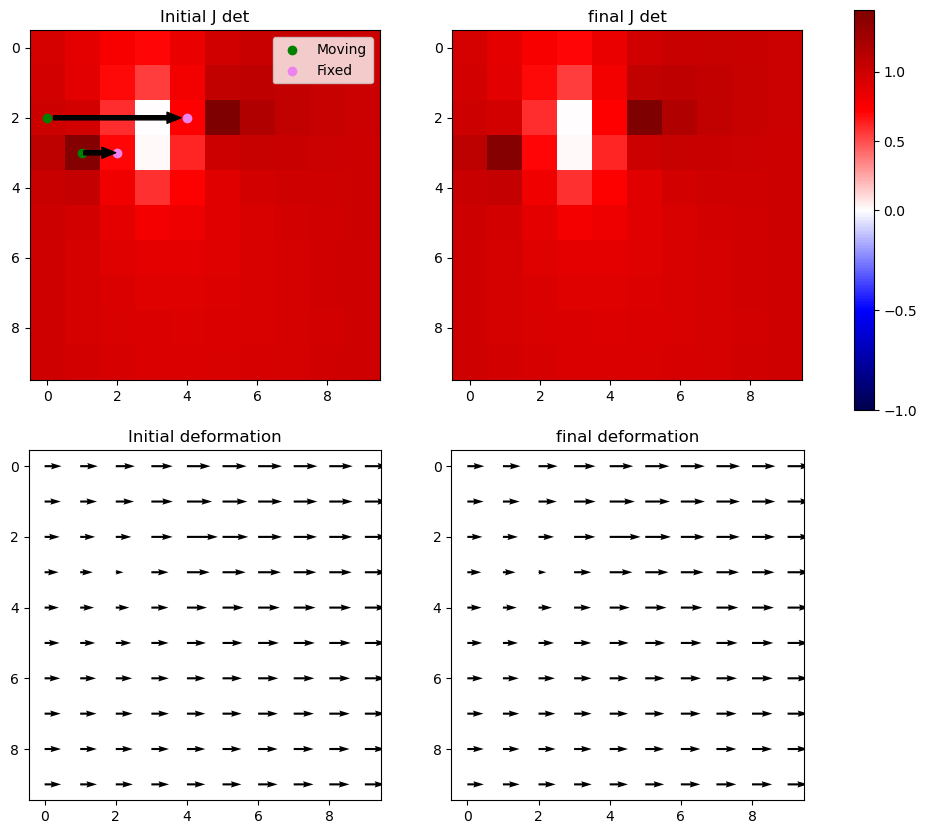

In [14]:
msample = np.array([
    [0, 2, 0],
    [0, 3, 1],
])
fsample = np.array([
    [0, 2, 4],
    [0, 3, 2],
])

fixed_sample = np.zeros((1, 10, 10))
#test_grad(fixed_sample, msample, fsample)
#test_scipy(fixed_sample, msample, fsample)
#red_test_scipy(fixed_sample, msample, fsample)
run_lapl_and_correction(fixed_sample, msample, fsample)

## Some more testcases

deformation shape: (3, 1, 20, 40)
deformation_i shape: (3, 1, 20, 40), phi_init shape: (2, 20, 40)
Iter 1: Fixing index (10, 36)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.53923038414589
            Iterations: 18
            Function evaluations: 929
            Gradient evaluations: 18
Iter 1: For index (10, 36), window size increased to 7 at iter 2
(98,) [0, 49, 1, 50, 2, 51, 3, 52, 4, 53, 5, 54, 6, 55, 7, 56, 13, 62, 14, 63, 20, 69, 21, 70, 27, 76, 28, 77, 34, 83, 35, 84, 41, 90, 42, 91, 43, 92, 44, 93, 45, 94, 46, 95, 47, 96, 48, 97]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.3746802993778986
            Iterations: 7
            Function evaluations: 693
            Gradient evaluations: 7
Iter 1 with 7 -ve jacs
Iter 2: Fixing index (11, 5)
(50,) [0, 25, 1, 

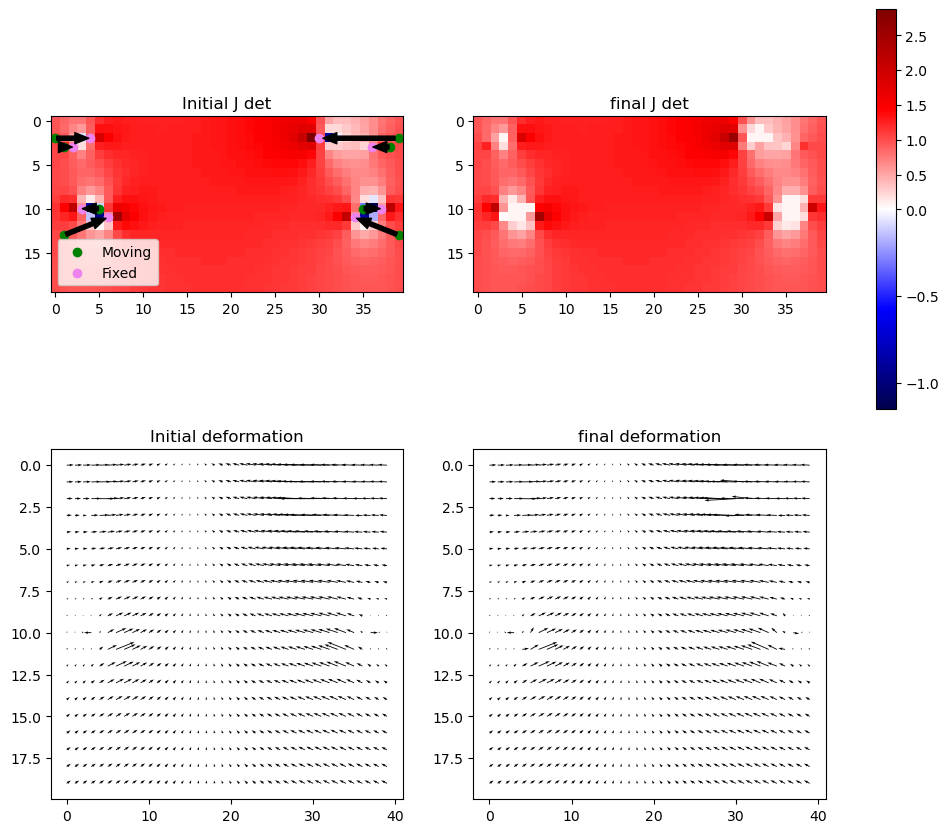

In [15]:
msample = np.array([
    [0, 2, 0],
    [0, 3, 1],
    [0, 10, 5],
    [0, 13, 1],
    [0, 2, 39],
    [0, 3, 38],
    [0, 10, 35],
    [0, 13, 39],
])
fsample = np.array([
    [0, 2, 4],
    [0, 3, 2],
    [0, 10, 3],
    [0, 11, 6],
    [0, 2, 30],
    [0, 3, 36],
    [0, 10, 37],
    [0, 11, 34]
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

## This one takes really long

deformation shape: (3, 1, 20, 40)
deformation_i shape: (3, 1, 20, 40), phi_init shape: (2, 20, 40)



Iter 1: Fixing index (15, 11)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.527517887782386
            Iterations: 28
            Function evaluations: 1429
            Gradient evaluations: 28
array([[0.01      , 0.01000002, 0.01      ],
       [0.00999984, 0.01000003, 0.01000013],
       [0.00999988, 0.01000002, 0.01000009]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -19.976474  15.699507 -10.784925 -8.633058 -3.309977  4.229225
meshgrid shape for plot: (20, 40)


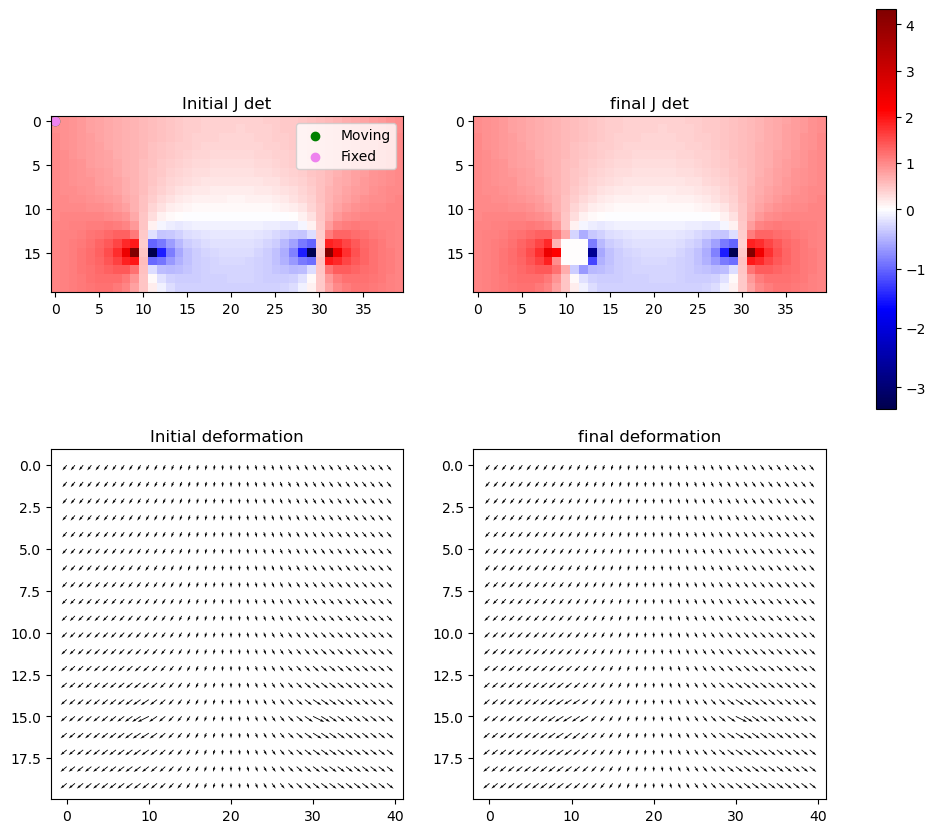

Iter 1 with 152 -ve jacs



Iter 2: Fixing index (15, 29)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.6316160720158015
            Iterations: 19
            Function evaluations: 970
            Gradient evaluations: 19
array([[0.00999995, 0.00999998, 0.01000004],
       [0.01000004, 0.01      , 0.00999998],
       [0.01      , 0.01      , 0.01      ]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -16.317055  15.699507 -10.805345 -7.913692 -2.836039  2.449451
meshgrid shape for plot: (20, 40)


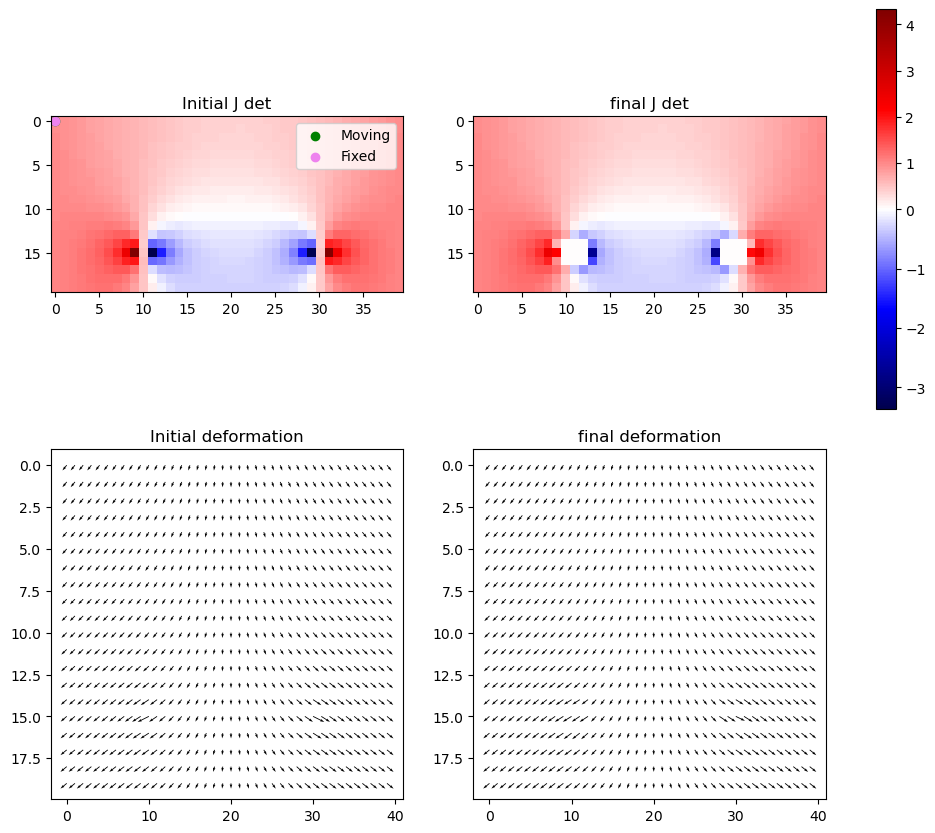

Iter 2 with 146 -ve jacs



Iter 3: Fixing index (15, 27)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 4.511838708526624
            Iterations: 53
            Function evaluations: 2746
            Gradient evaluations: 53
array([[0.01      , 0.0099998 , 0.01000007],
       [0.01000027, 0.00999994, 0.00999998],
       [0.00999998, 0.00999996, 0.01      ]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -16.317055  15.699507 -10.784925 -7.913692 -2.694465  2.449451
meshgrid shape for plot: (20, 40)


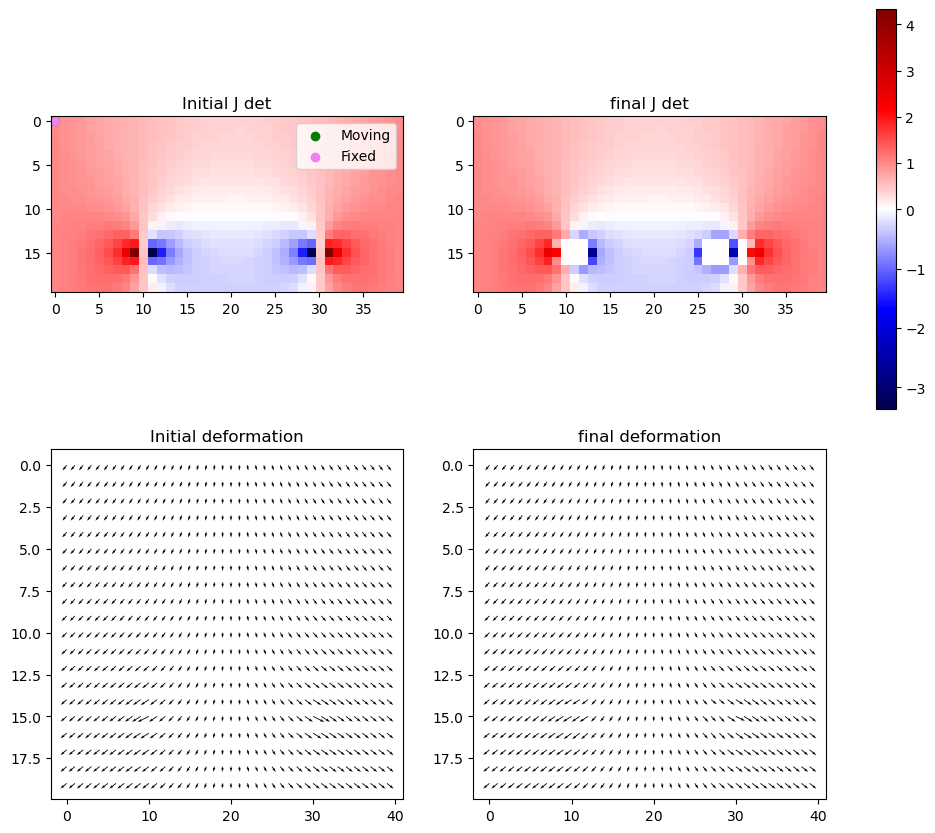

Iter 3 with 143 -ve jacs



Iter 4: Fixing index (15, 13)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 7.724774755000787
            Iterations: 22
            Function evaluations: 1127
            Gradient evaluations: 22
array([[0.01000018, 0.00999957, 0.00999993],
       [0.00999981, 0.00999989, 0.01000075],
       [0.00999995, 0.00999987, 0.01000004]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -16.317055  15.699507 -10.793841 -7.812714 -3.680259  2.449451
meshgrid shape for plot: (20, 40)


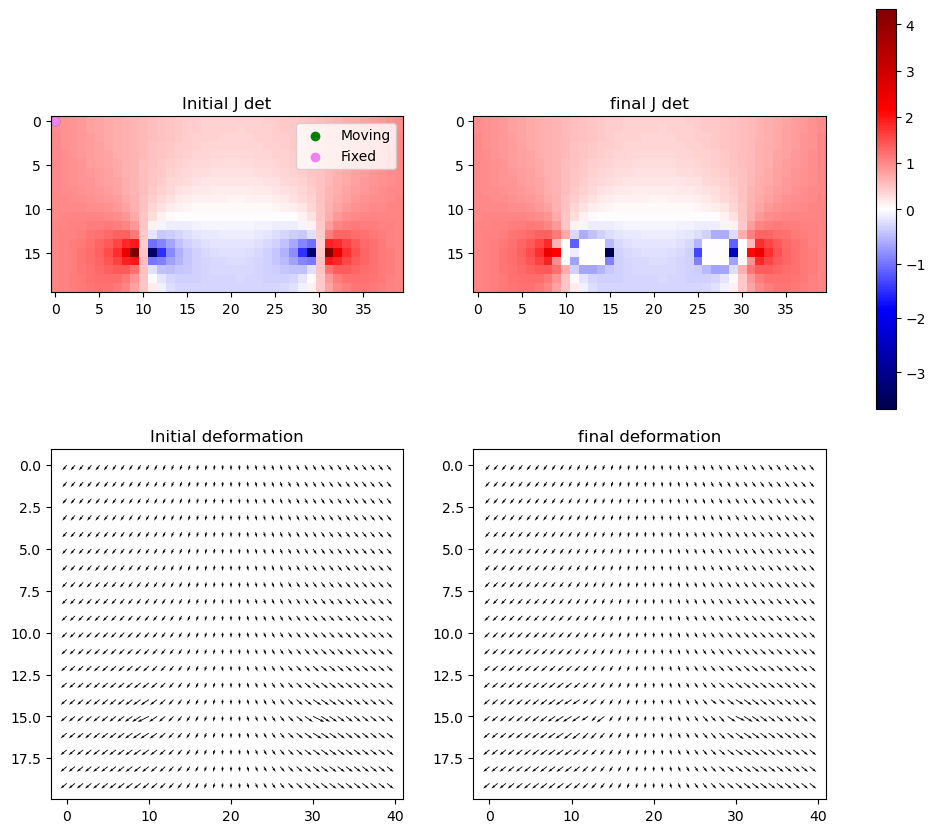

Iter 4 with 140 -ve jacs



Iter 5: Fixing index (15, 15)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 6.59212578766881
            Iterations: 20
            Function evaluations: 1025
            Gradient evaluations: 20
array([[0.01      , 0.01      , 0.00999999],
       [0.00999998, 0.01000001, 0.01000002],
       [0.01      , 0.01      , 0.01      ]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -16.317055  15.699507 -11.537946 -7.812714 -2.571816  2.449451
meshgrid shape for plot: (20, 40)


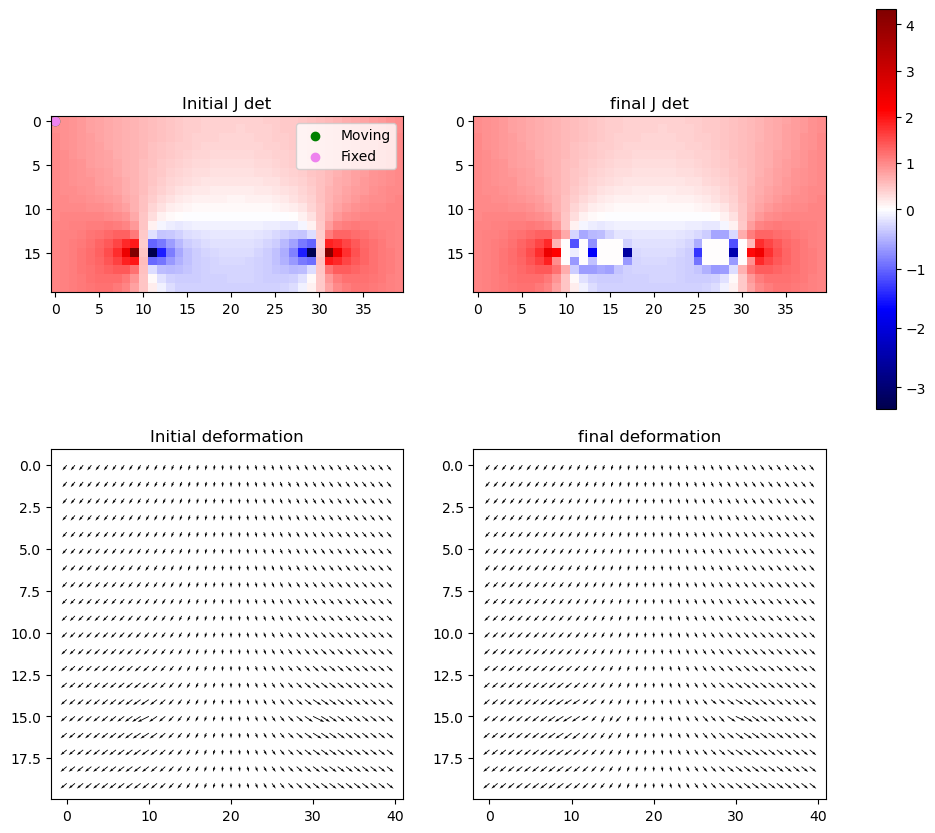

Iter 5 with 137 -ve jacs



Iter 6: Fixing index (15, 17)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 4.444561000137869
            Iterations: 21
            Function evaluations: 1072
            Gradient evaluations: 21
array([[0.00999998, 0.20797292, 0.01      ],
       [0.01000006, 0.01      , 0.00999985],
       [0.01000008, 0.01000003, 0.00999993]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -16.317055  15.699507 -11.537946 -7.188797 -2.444742  2.449451
meshgrid shape for plot: (20, 40)


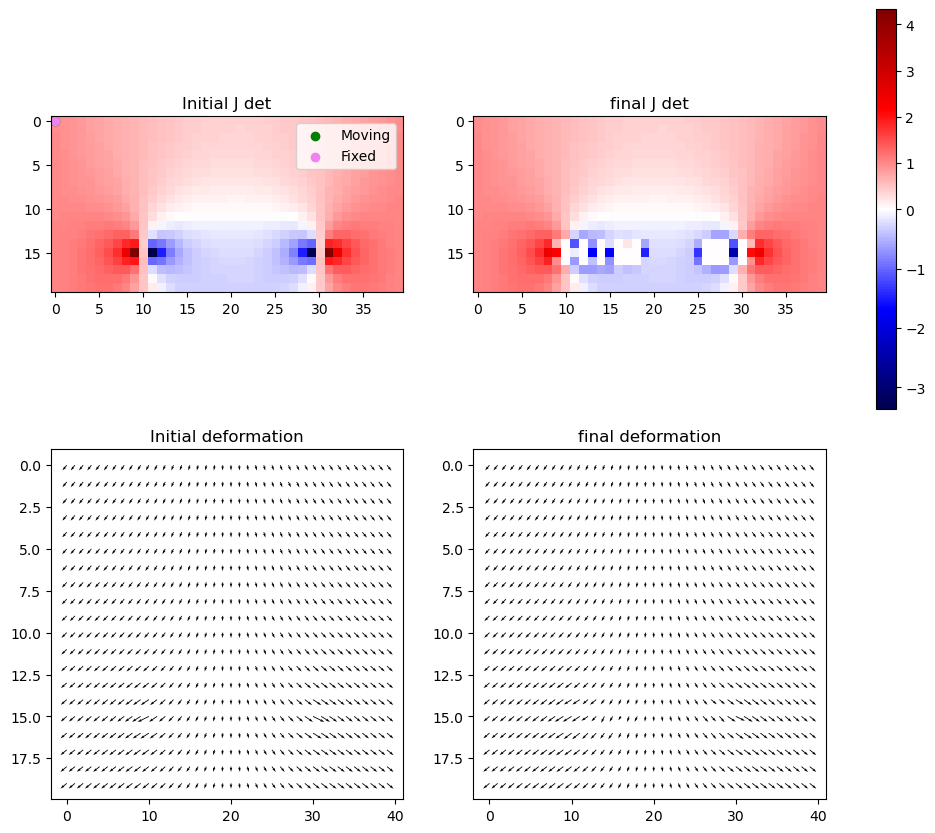

Iter 6 with 134 -ve jacs



Iter 7: Fixing index (15, 29)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 8.738158575469017
            Iterations: 25
            Function evaluations: 1286
            Gradient evaluations: 25
array([[0.01      , 0.01000008, 0.01      ],
       [0.01000014, 0.01000003, 0.00999979],
       [0.00999997, 0.00999999, 0.01      ]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -15.476165  15.699507 -11.537946 -7.130770 -1.725925  2.449451
meshgrid shape for plot: (20, 40)


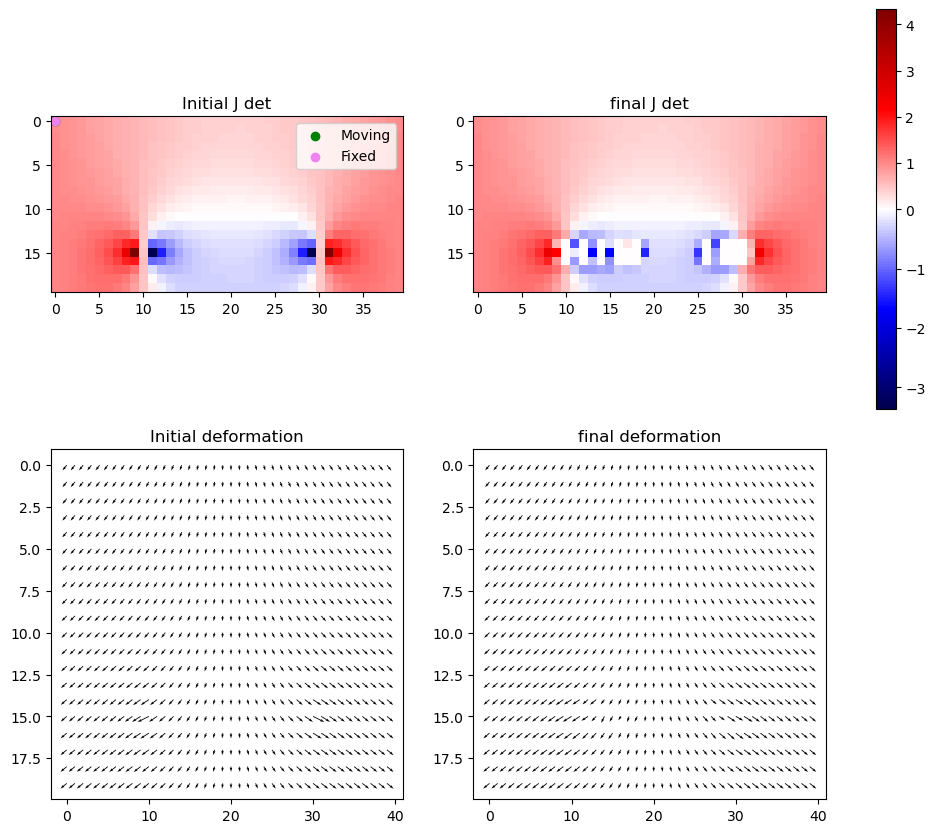

Iter 7 with 134 -ve jacs



Iter 8: Fixing index (15, 13)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 7.990808194265225
            Iterations: 38
            Function evaluations: 1966
            Gradient evaluations: 38
array([[0.01      , 0.01      , 0.01      ],
       [0.01      , 0.01      , 0.01000001],
       [0.01      , 0.01      , 0.01      ]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -15.476165  15.699507 -13.432332 -6.059520 -2.507135  2.449451
meshgrid shape for plot: (20, 40)


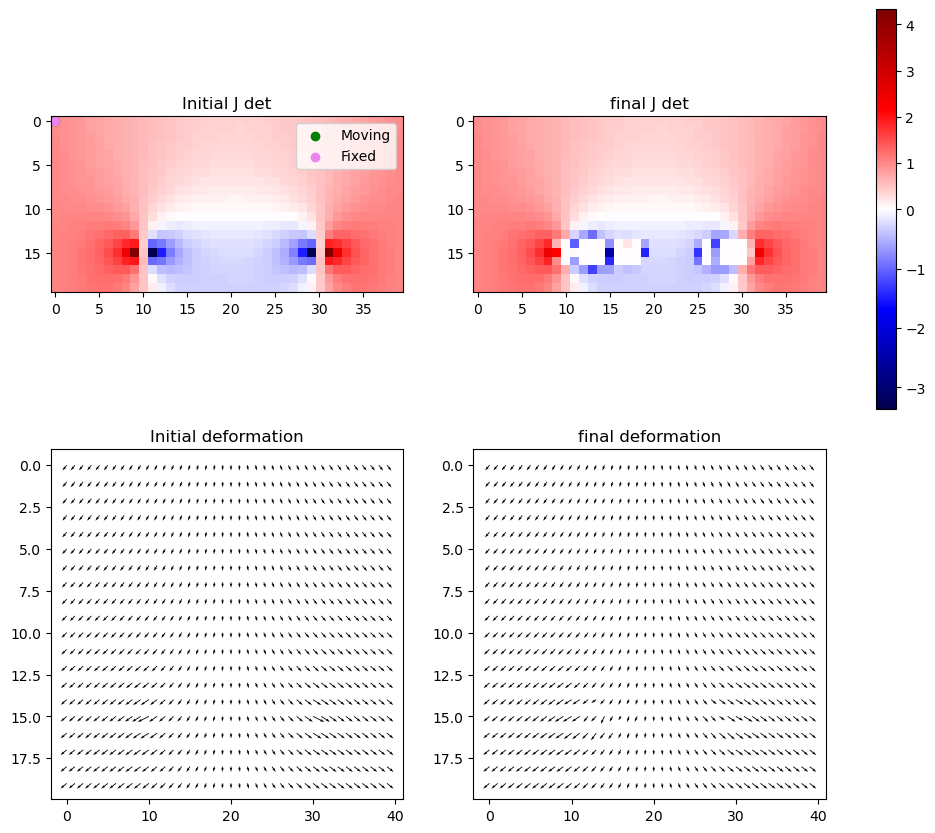

Iter 8 with 130 -ve jacs



Iter 9: Fixing index (15, 15)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 5.729337049872148
            Iterations: 28
            Function evaluations: 1431
            Gradient evaluations: 28
array([[0.01000002, 0.00999995, 0.37430681],
       [0.00999996, 0.01000009, 0.01000005],
       [0.01      , 0.01000004, 0.00999999]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -15.476165  15.699507 -12.925827 -6.059520 -3.065178  2.449451
meshgrid shape for plot: (20, 40)


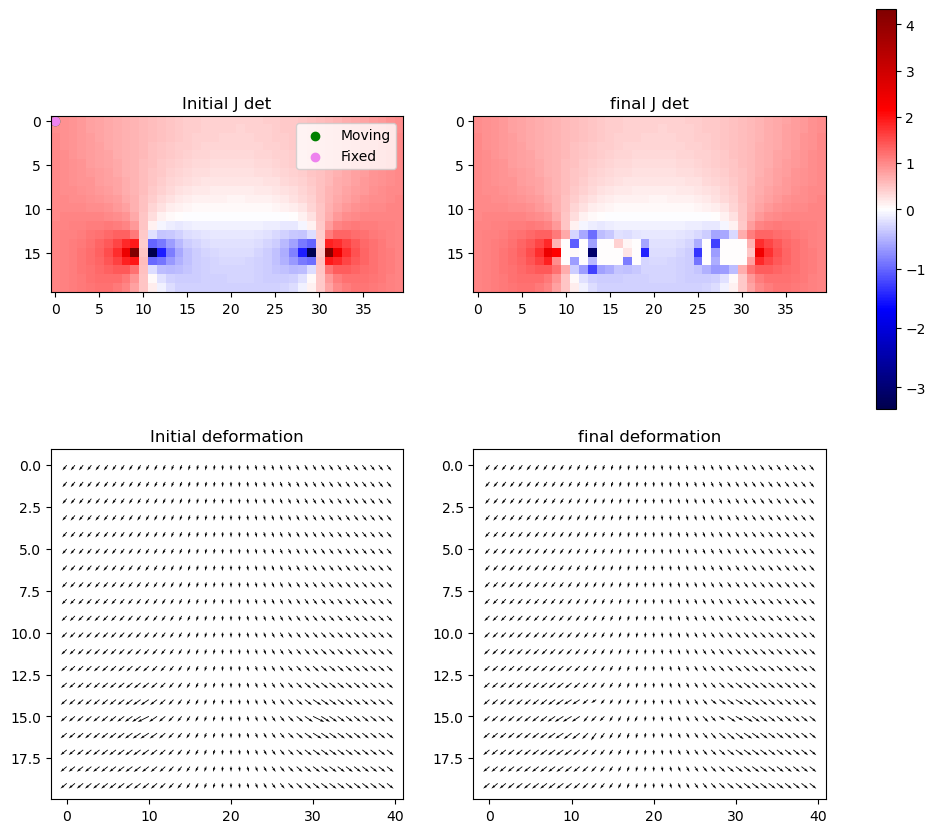

Iter 9 with 131 -ve jacs



Iter 10: Fixing index (15, 13)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 15.289501599711379
            Iterations: 78
            Function evaluations: 4064
            Gradient evaluations: 78
array([[0.0099998 , 0.01      , 0.00999997],
       [0.01      , 0.01000037, 0.01      ],
       [0.00999954, 0.01      , 0.01000033]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -15.476165  15.699507 -21.197503 -2.347797 -3.181483  2.449451
meshgrid shape for plot: (20, 40)


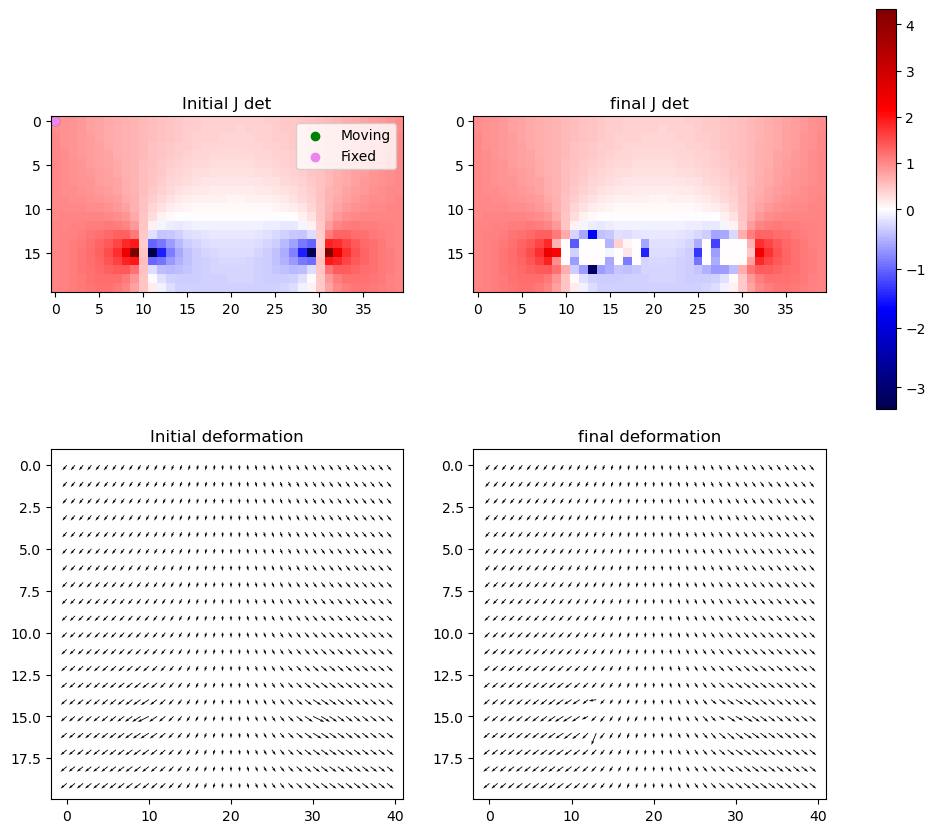

Iter 10 with 132 -ve jacs



Iter 11: Fixing index (17, 13)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 5.416859384491745
            Iterations: 25
            Function evaluations: 1276
            Gradient evaluations: 25
array([[2.0866415 , 0.00999995, 0.01000032],
       [0.01000019, 0.00999976, 0.00999983],
       [0.01      , 0.01000003, 0.00999999]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -15.476165  15.699507 -11.509213 -2.347797 -4.318217  2.449451
meshgrid shape for plot: (20, 40)


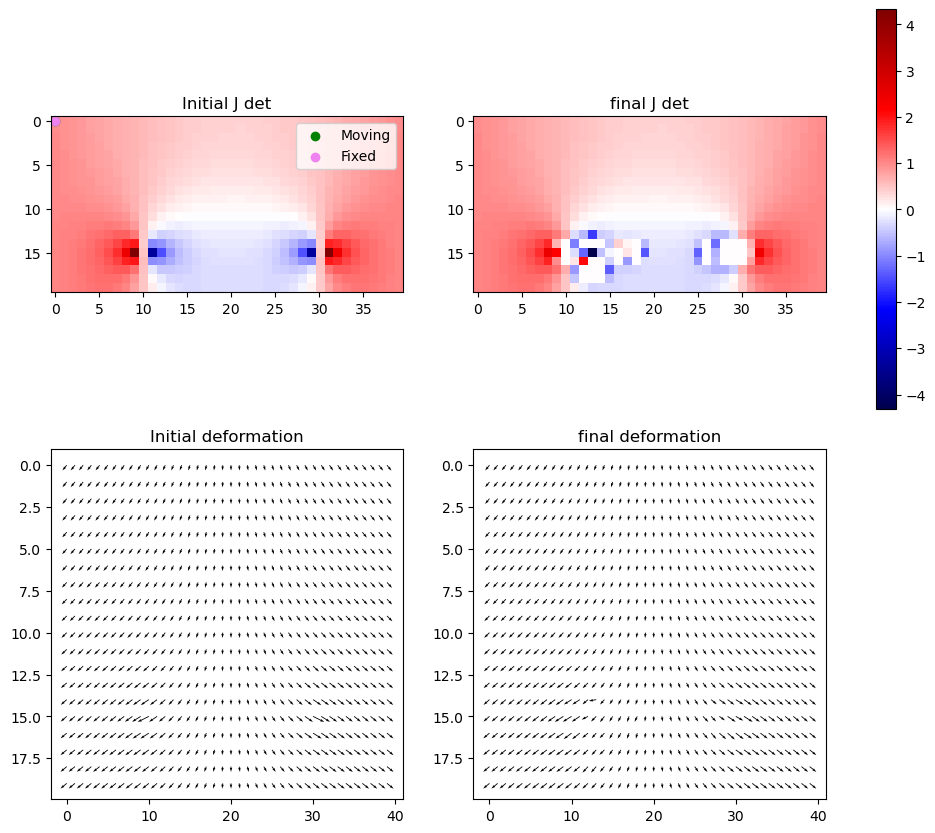

Iter 11 with 129 -ve jacs



Iter 12: Fixing index (15, 13)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 12.80260194112525
            Iterations: 44
            Function evaluations: 2271
            Gradient evaluations: 44
array([[0.01      , 0.01      , 0.01      ],
       [0.01      , 0.01000001, 0.01      ],
       [0.01      , 0.01      , 0.01      ]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -15.476165  15.699507 -11.509213  0.246733 -2.864935  2.449451
meshgrid shape for plot: (20, 40)


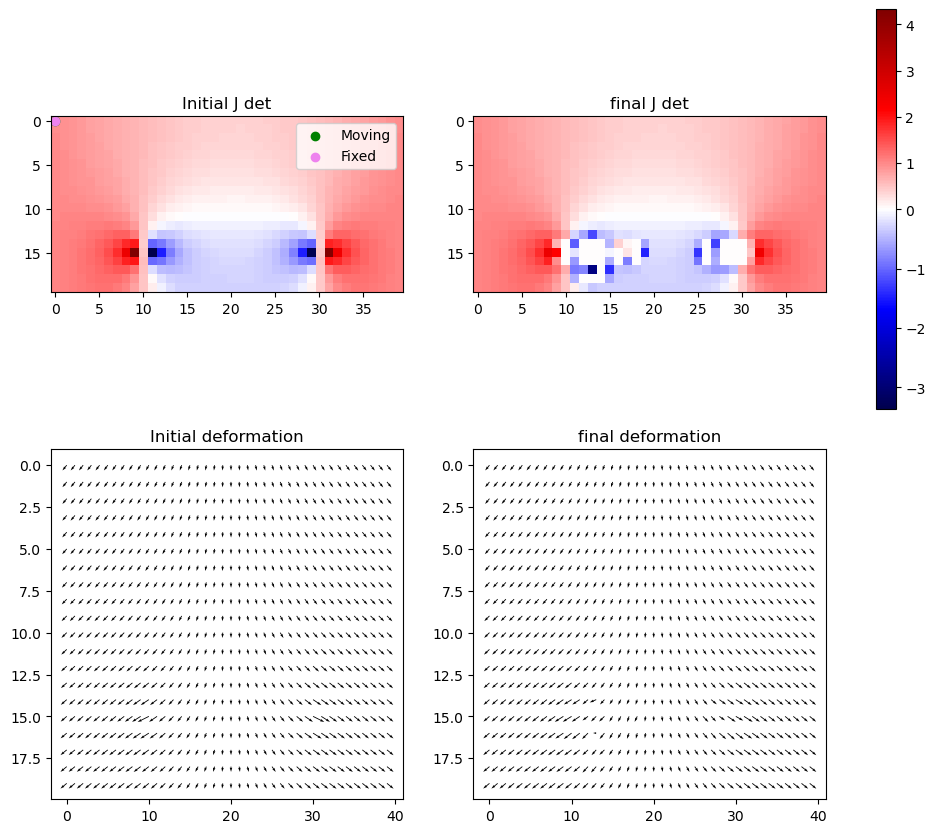

Iter 12 with 129 -ve jacs



Iter 13: Fixing index (17, 13)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 5.044308400702706
            Iterations: 23
            Function evaluations: 1175
            Gradient evaluations: 23
array([[0.14250601, 0.00999999, 0.01000004],
       [0.00999999, 0.00999995, 0.01000002],
       [0.00999999, 0.00999999, 0.00999998]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -15.476165  15.699507 -11.509213 -4.929526 -3.175981  2.449451
meshgrid shape for plot: (20, 40)


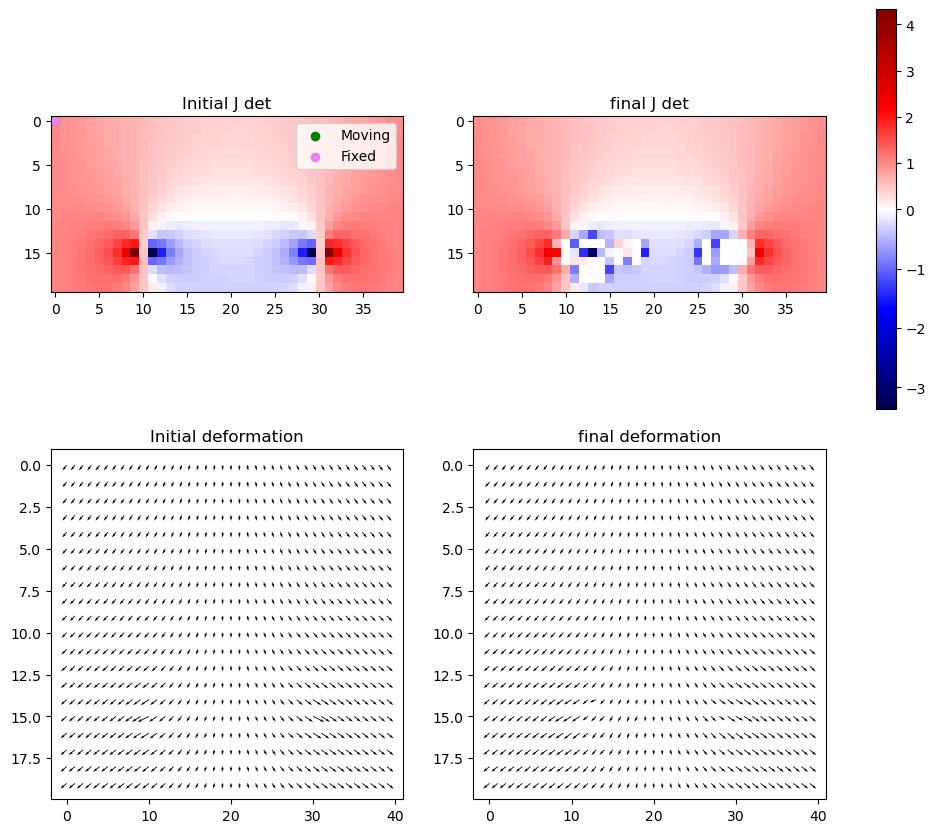

Iter 13 with 129 -ve jacs



Iter 14: Fixing index (15, 13)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 13.442216837020922
            Iterations: 31
            Function evaluations: 1603
            Gradient evaluations: 31
array([[0.00999991, 0.0099997 , 0.01      ],
       [0.00999991, 0.01000013, 0.01000039],
       [0.00999997, 0.00999999, 0.01      ]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -15.476165  15.699507 -11.509213 -0.605275 -3.013113  2.449451
meshgrid shape for plot: (20, 40)


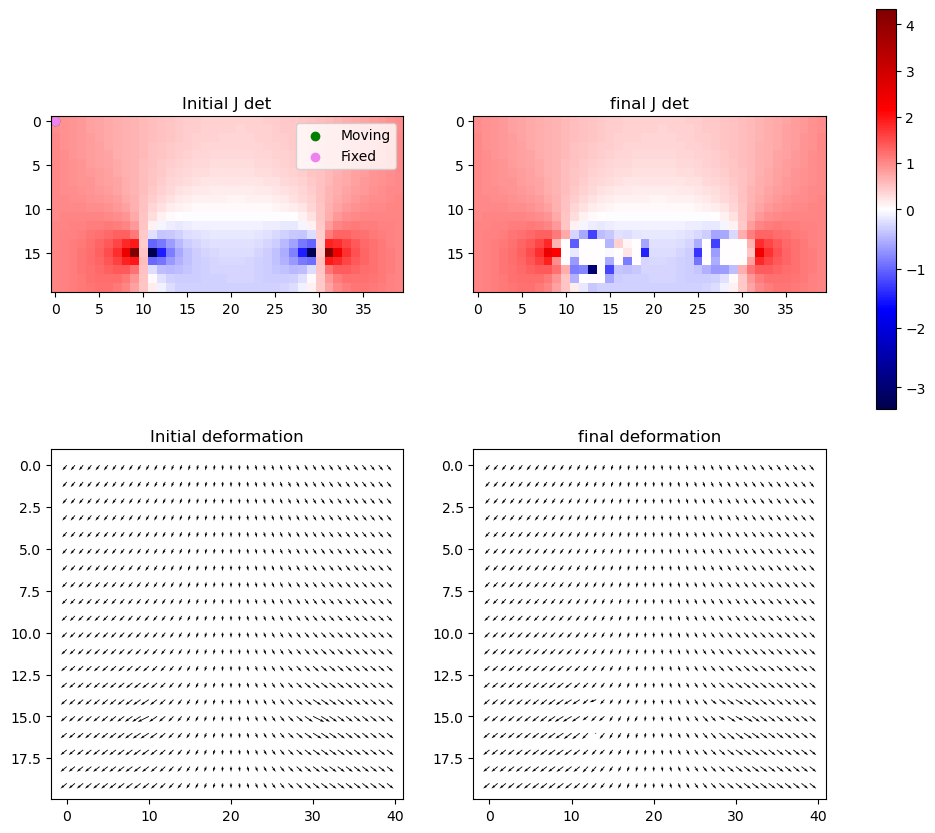

Iter 14 with 129 -ve jacs



Iter 15: Fixing index (17, 13)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 5.219863817509451
            Iterations: 24
            Function evaluations: 1226
            Gradient evaluations: 24
array([[0.1270252 , 0.01      , 0.0100001 ],
       [0.01000001, 0.00999999, 0.01000002],
       [0.01000003, 0.00999998, 0.00999991]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -15.476165  15.699507 -11.509213 -4.588143 -3.208738  2.449451
meshgrid shape for plot: (20, 40)


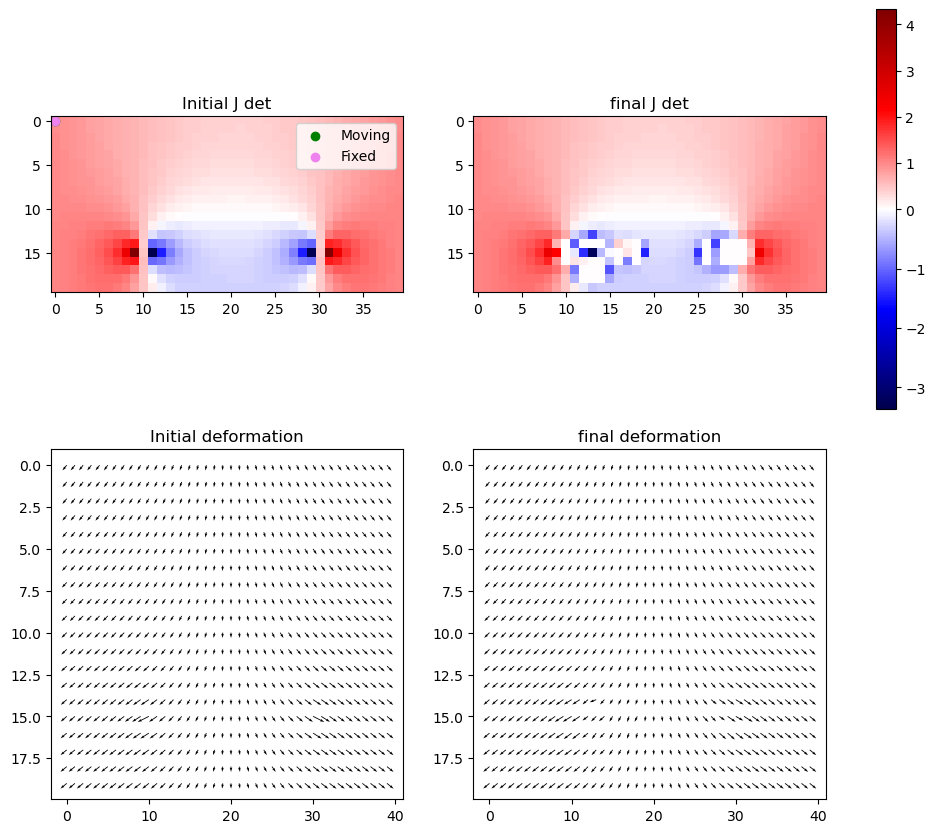

Iter 15 with 129 -ve jacs



Iter 16: Fixing index (15, 13)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]
Optimization terminated successfully    (Exit mode 0)
            Current function value: 13.69910344376166
            Iterations: 32
            Function evaluations: 1655
            Gradient evaluations: 32
array([[0.01      , 0.00999994, 0.01      ],
       [0.00999999, 0.01      , 0.01000007],
       [0.00999999, 0.01      , 0.01000001]])
             x-def                 y-def            jacobian          
               min        max        min       max       min       max
initial -19.976474  19.976474 -10.001746 -9.289016 -3.369923  4.326747
final   -15.476165  15.699507 -11.509213 -1.567445 -3.067258  2.449451
meshgrid shape for plot: (20, 40)


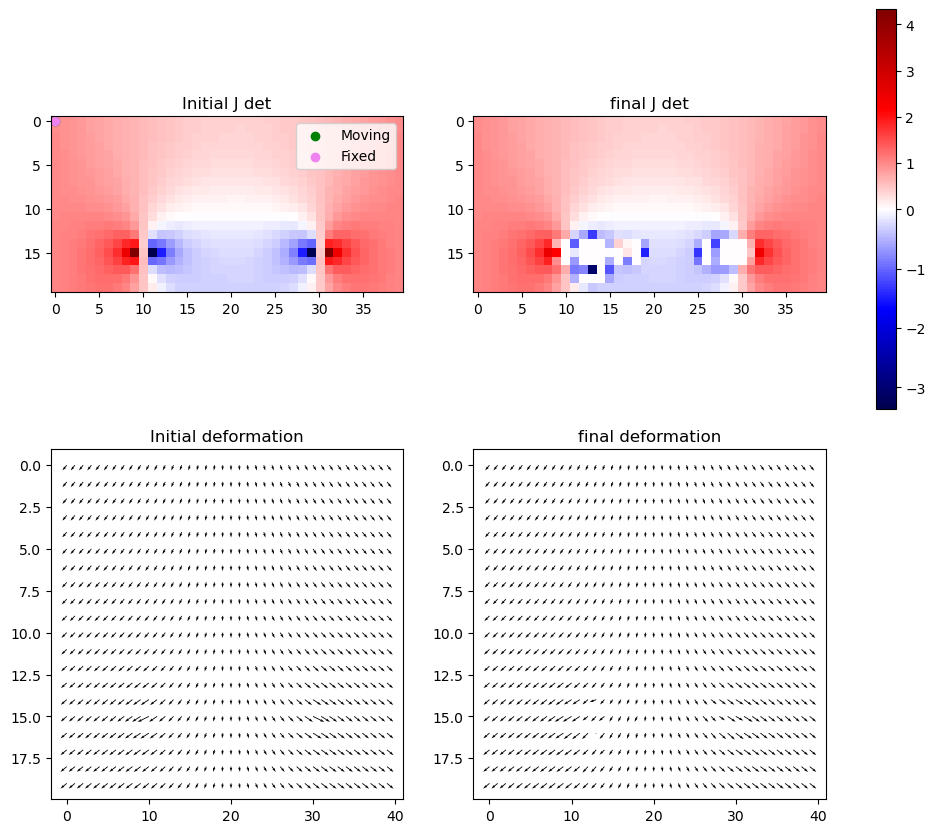

Iter 16 with 129 -ve jacs



Iter 17: Fixing index (17, 13)
(50,) [0, 25, 1, 26, 2, 27, 3, 28, 4, 29, 5, 30, 9, 34, 10, 35, 14, 39, 15, 40, 19, 44, 20, 45, 21, 46, 22, 47, 23, 48, 24, 49]


In [ ]:
msample = np.array([
    [0, 5, 10],
    [0, 5, 30],
])
fsample = np.array([
    [0, 15, 30],
    [0, 15, 10],
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

# 600 iterations
# 83min - final size 9x9

In [ ]:
msample = np.array([
    [0, 5, 10],
    [0, 15, 10],
])
fsample = np.array([
    [0, 15, 30],
    [0, 5, 30],
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

In [ ]:
msample = np.array([
    [0, 5, 10],
    [0, 5, 30],
])
fsample = np.array([
    [0, 15, 30],
    [0, 15, 10],
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

# not all iterations take the same time?
# Iter 1 Optimisation for index 611 completed in 0.7802479267120361s
# Iter 635 Optimisation for index 693 completed in 278.3064708709717s
# Iter 573 Optimisation for index 494 completed in 63.11005783081055s
# total time 175m - unfinished

In [ ]:
msample = np.array([
    [0, 2, 10],
    [0, 3, 5],
    [0, 6, 4],
    [0, 11, 5],
    [0, 15, 7],
    [0, 19, 12],
    [0, 15, 15],
    [0, 13, 22],
    [0, 19, 22],
    [0, 19, 27],
    [0, 15, 30],
    [0, 12, 33],
    [0, 10, 38],
    [0, 4, 37],
    [0, 6, 30],
    [0, 1, 33],
    [0, 5, 26],
    [0, 2, 23],
    [0, 1, 19],
    [0, 2, 14],
])
fsample = np.array([
    [0, 1, 7],
    [0, 5, 11],
    [0, 6, 1],
    [0, 15, 1],
    [0, 12, 2],
    [0, 16, 14],
    [0, 18, 17],
    [0, 15, 20],
    [0, 16, 24],
    [0, 19, 27],
    [0, 18, 34],
    [0, 17, 40],
    [0, 10, 35],
    [0, 6, 35],
    [0, 2, 34],
    [0, 3, 30],
    [0, 2, 26],
    [0, 2, 23],
    [0, 3, 20],
    [0, 2, 14],
])

fixed_sample = np.zeros((1, 20, 40))

run_lapl_and_correction(fixed_sample, msample, fsample)

In [ ]:
# data analysis

# Create sample set of points
mpoints_path = "data/corrected_correspondences_count_touching/mpoints.npy"
fpoints_path = "data/corrected_correspondences_count_touching/fpoints.npy"

mpoints, fpoints = correspondences.downsample_points(mpoints_path, fpoints_path, debug=False)
#print(mpoints.shape, fpoints.shape) 

fixed_sample = np.zeros((1, 20, 40))

# z values in mpoints, fpoints are for 3 slices numbered 0,1,2
slice_no = 1

# use 
mask = mpoints[:,0]==slice_no
new_mpoints = mpoints[mask].copy()
new_mpoints[:,0] = 0

mask = fpoints[:,0]==slice_no
new_fpoints = fpoints[mask].copy()
new_fpoints[:,0] = 0

print(new_mpoints.shape, new_fpoints.shape)


#test_grad(fixed_sample, msample, fsample)
#red_test_scipy(fixed_sample, new_mpoints[:5], new_fpoints[:5])
run_lapl_and_correction(fixed_sample, new_mpoints, new_fpoints)

## Real slice

In [ ]:
# data analysis

# Create sample set of points
mpoints_path = "data/corrected_correspondences_count_touching/mpoints.npy"
fpoints_path = "data/corrected_correspondences_count_touching/fpoints.npy"

mpoints, fpoints = correspondences.downsample_points(mpoints_path, fpoints_path, debug=False)
#print(mpoints.shape, fpoints.shape) 

deformation_field_path = "data/base_unique_correspondences/registered_output/deformation3d.npy"
deformation_field = np.load(deformation_field_path)

# select a slice
def_shape = deformation_field.shape
print(def_shape)
deformation_i = deformation_field[:, 349].reshape((def_shape[0], 1, def_shape[2], def_shape[3]))
print(deformation_i.shape)
# z values in mpoints, fpoints are for 3 slices numbered 0,1,2
slice_no = 0

# use 
mask = mpoints[:,0]==slice_no
new_mpoints = mpoints[mask].copy()
new_mpoints[:,0] = 0

mask = fpoints[:,0]==slice_no
new_fpoints = fpoints[mask].copy()
new_fpoints[:,0] = 0

print(new_mpoints.shape, new_fpoints.shape)

phi_corrected, jacobians = iterative_with_jacobians2(deformation_i)
plot_jacobians_iteratively(jacobians, msample, fsample, methodName='SLSQP')
plot_deformations(msample, fsample, deformation_i, phi_corrected, figsize=(10,10))
# kept running for 450min

## Jdet function testing

In [ ]:
# global val list
print(list_dev)
print('===')
print(num_neg_jac)
print('=====')
print(time_taken)

# L2
list_dev_L2 = [2.680895253076589, 69.80633869969029, 9.418067274643581, 69.80633869969029, 5.197075330527052, 1.8231005476373714, 2.2589086079637837, 2.8612431766103588, 0.0, 27.945036523729176]

num_neg_jac_init_L2 = [12, 158, 28, 158, 29, 5, 3, 2, 0, 129]

num_neg_jac_L2 = [0, 132, 15, 132, 0, 0, 0, 0, 0, 115]

# L2s
list_dev_L2s = [4.768607942055218, 26.252278493509536, 10026.7948106916, 26.252278493509536, 9.104921565888146, 2.379737612461383, 3.019209538644817, 3.1687868005130904, 0.0, 25.14703328621248]

num_neg_jac_L2s = [0, 137, 15, 137, 0, 0, 0, 0, 0, 109]

# L1

list_dev_L1 = [3.1452826411439276, 49.78213374285741, 12.373348412316172, 49.78213374285741, 12.224721045040889, 2.2478387386726184, 2.419587408528433, 3.1974909624498786, 0.0, 22.553299646732658]

num_neg_jac_L1 = [0, 135, 7, 135, 2, 0, 0, 0, 0, 106]

# L1s
list_dev_L1s = [3.8200316274887136, 27.98726389799386, 11.400909181236925, 27.98726389799386, 7.421816327869949, 2.3274873804728444, 2.952056050877296, 3.112671741644684, 0.0, 21.352944007229933]

num_neg_jac_L1s = [0, 132, 11, 132, 0, 0, 0, 0, 0, 110]

#L2wr
list_dev_L2wr = [1.3388562022484387e-06, 2.1911745978666906, 0.5583311141489217, 2.1911745978666906, 0.00010905921377629281, 8.880030350916757e-08, 8.065887478278329e-07, 8.93188013674346e-08, 0.0, 1.4515563532878142]

num_neg_jac_L2wr = [12, 156, 27, 156, 29, 5, 3, 2, 0, 125]

#L1wr - this
list_dev_L1wr = [1.8719204800182033e-05, 2.800815958456984, 0.6335240860765275, 2.800815958456984, 0.01548376720517454, 3.821057987703311e-05, 2.2714245365299625e-05, 3.223513937255436e-05, 0.0, 2.2229220010626967]

num_neg_jac_L1wr = [12, 156, 29, 156, 29, 5, 3, 2, 0, 123]

#L2swr
list_dev_L2swr = [6.347496024011014, 6.0603622126465195, 8.073554663868867, 6.0603622126465195, 9.805082662138908, 2.4315062468207964, 3.329061274139249, 1.7311478095318673, 0.0, 19.893147478504304]

num_neg_jac_L2swr = [0, 162, 30, 162, 6, 0, 0, 0, 0, 127]
tt_L2swr = [[1.0550048351287842, 15.897326946258545, 5.623910903930664, 16.062530040740967, 12.120941877365112, 0.3773469924926758, 0.3408081531524658, 0.3339860439300537, 0.15784001350402832, 8.772908926010132]
]
ttt_L2swr = 71.68918776512146

#L1swr
list_dev_L1swr = [3.300356140988371, 5.219200883030088, 3.8569020877225846, 5.219200883030088, 4.37866602840255, 1.4021137590566208, 2.0081703705493297, 1.228014013747989, 0.0, 11.192059918711248]

num_neg_jac_L1swr = [11, 156, 28, 156, 19, 4, 3, 0, 0, 121]
tt_L1swr = [38.703429222106934, 85.19641089439392, 57.048078775405884, 85.34915089607239, 37.369688749313354, 21.995036840438843, 18.338409185409546, 3.49845290184021, 0.16025185585021973, 81.12396311759949]

ttt_L1swr = 437.7158851623535

full_end = time.time()
print("time taken is", full_end-full_start)